In [1]:
from gaia_tools import query
import matplotlib
#matplotlib.use("AGG")
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from astropy.table import Table
import pyexcel
from astropy import units as u
from astropy.coordinates import SkyCoord

import sklearn
from sklearn import cluster
from astropy import units as u
from astropy.coordinates import SkyCoord
from matplotlib.patches import Circle
#from matplotlib import patches

from PyPDF2 import PdfFileWriter, PdfFileReader

%pylab inline

import pywt
from galpy.util import bovy_plot

Created TAP+ (v1.0.1) - Connection:
	Host: gea.esac.esa.int
	Use HTTPS: False
	Port: 80
	SSL Port: 443
Populating the interactive namespace from numpy and matplotlib


In [2]:
# csv-pd set up for DBSCANN
GlobClust_Log_ra_dec = pd.read_csv('~/GlobClust_ra-dec.csv')
GlobClust_Log_r_t = GlobClust_Log_ra_dec.loc[0:0,"r_t"]
GlobClust_Log_radec = GlobClust_Log_ra_dec.loc[0:0,"RA":"DEC"]
GlobClust_Log_ID = GlobClust_Log_ra_dec.loc[0:0,"ID"]
GlobClust_Log_r_c = GlobClust_Log_ra_dec.loc[0:0,"r_c"]
GlobClust_Log_r_t = GlobClust_Log_ra_dec.loc[0:0,"r_t"]
#GlobClust_Log_dec = GlobClust_Log_ra_dec.loc[:,"dec"]
#GlobClust_Log_RA = GlobClust_Log_ra_dec.loc[0:7,"RA"]
#GlobClust_Log_DEC = GlobClust_Log_ra_dec.loc[0:7,"DEC"]
#print(GlobClust_Log_r_t)

GlobClust_Log_2 = pd.read_csv('~/out_NGC 288_full_15rt_ra_dec.csv')
GlobClust_Log_pmra = GlobClust_Log_2.loc[:,"pmra"]
GlobClust_Log_pmdec = GlobClust_Log_2.loc[:,"pmdec"]
GlobClust_Log_pmra_error = GlobClust_Log_2.loc[:,"pmra_error"]
GlobClust_Log_pmdec_error = GlobClust_Log_2.loc[:,"pmdec_error"]
GlobClust_Log_ra = GlobClust_Log_2.loc[:,"ra"]
GlobClust_Log_dec = GlobClust_Log_2.loc[:,"dec"]
GlobClust_Log_ra_error = GlobClust_Log_2.loc[:,"ra_error"]
GlobClust_Log_dec_error = GlobClust_Log_2.loc[:,"dec_error"]

GlobClust_Log_g = GlobClust_Log_2.loc[:,"phot_g_mean_mag"]
GlobClust_Log_rp = GlobClust_Log_2.loc[:,"phot_rp_mean_mag"]
GlobClust_Log_bp = GlobClust_Log_2.loc[:,"phot_bp_mean_mag"]
GlobClust_Log_rpbp = GlobClust_Log_bp - GlobClust_Log_rp
GlobClust_Log_ra_out = GlobClust_Log_2.loc[:,"ra"]
GlobClust_Log_dec_out = GlobClust_Log_2.loc[:,"dec"]
GlobClust_Log_pmdec_out = GlobClust_Log_2.loc[:,"pmdec"]
GlobClust_Log_pmra_out = GlobClust_Log_2.loc[:,"pmra"]

GlobClust_Log_vpu = GlobClust_Log_2.loc[:,"visibility_periods_used"]
GlobClust_Log_aen = GlobClust_Log_2.loc[:,"astrometric_excess_noise"]

#GlobClust_Log_pmra = GlobClust_Log_pmra.as_matrix()
#GlobClust_Log_pmdec = GlobClust_Log_pmdec.as_matrix()
#GlobClust_Log_ra = GlobClust_Log_ra.as_matrix()
#GlobClust_Log_dec = GlobClust_Log_dec.as_matrix()

GlobClust_Log_parallax_out = GlobClust_Log_2.loc[:,"parallax"]
GlobClust_Log_parallaxerror_out = GlobClust_Log_2.loc[:,"parallax_error"]
GlobClust_Log_parallaxe_out = GlobClust_Log_2.loc[:,"parallax":"parallax_error"]

# DBSCANN - parallax before scan
GlobClust_Log_parallaxover_out = GlobClust_Log_parallaxerror_out/GlobClust_Log_parallax_out

#parallax_indx = (GC_parallaxover>0.20) | ((1/GC_parallax>5.)*(GC_parallaxover<0.20)), /3600000
parallax_indx=((1/(GlobClust_Log_parallax_out)<5.)*(GlobClust_Log_parallaxover_out<0.10))
parallax_indx=[not i for i in parallax_indx]

coord_ra_dec_deg=[]
coord_ra_dec = SkyCoord(GlobClust_Log_radec.loc[:,"RA"], GlobClust_Log_radec.loc[:,"DEC"], frame='icrs')

Clust_Edge = GlobClust_Log_r_c[0]
print(Clust_Edge)
Tidal_Edge = GlobClust_Log_r_t[0]
print(Tidal_Edge)
d_pc=8900

#M=m-5(log(d)-1)
GlobClust_Log_M = GlobClust_Log_g-5*((np.log10(d_pc)) - 1)

indx = (np.sqrt((np.fabs(GlobClust_Log_ra_out-coord_ra_dec.ra.deg)**2+np.fabs(GlobClust_Log_dec_out-coord_ra_dec.de\
c.deg)**2))<Clust_Edge/60)

GlobClust_Log_2

/home/kaderali/.local/lib/python3.6/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  unsupported[op_str]))

1.35
13.19270248


,Unnamed: 0,ra,dec,ra_error,dec_error,l,b,pmra,pmdec,pmra_error,pmdec_error,phot_g_mean_mag,phot_rp_mean_mag,phot_bp_mean_mag,parallax,parallax_error,a_g_val,visibility_periods_used,astrometric_excess_noise
0,0,13.325432,-26.545833,0.331644,0.237084,158.559035,-89.284410,4.194062,-5.560228,0.574645,0.443512,19.4395,18.8721,19.5355,0.220473,0.452169,NaN,14,0.000000
1,1,13.216021,-24.853873,0.432092,0.351204,131.031316,-87.703160,-0.330350,-3.468581,0.823164,0.664431,19.9567,18.8183,20.9157,1.315476,0.633346,NaN,14,1.226143
2,2,10.978007,-24.156311,2.645801,1.611511,92.804991,-86.578262,NaN,NaN,NaN,NaN,20.8426,19.7541,21.5386,NaN,NaN,NaN,8,2.341806
3,3,10.937143,-29.287150,1.050683,0.693727,340.602226,-87.255928,42.139770,18.245363,1.694499,1.299002,20.5741,19.1477,20.9284,5.104771,1.388325,NaN,12,4.064091
4,4,12.276909,-25.781061,0.537746,0.436475,101.637459,-88.555379,-1.064531,-0.516065,1.150878,0.863598,20.2779,19.9292,20.3378,0.237608,0.614988,NaN,14,0.000000
5,5,12.092129,-28.699341,0.478994,0.370067,326.097939,-88.288844,5.069834,-0.410721,1.038293,0.662812,20.0819,19.4527,20.3273,-0.520283,0.665516,NaN,12,0.000000
6,6,11.635107,-28.750855,0.066094,0.049423,336.335199,-88.049952,2.974431,1.151691,0.118747,0.088762,16.7164,16.2474,17.0175,0.373838,0.089348,0.0170,13,0.000000
7,7,15.189868,-25.116791,4.094024,1.847164,169.579706,-87.097759,NaN,NaN,NaN,NaN,20.5616,18.6726,20.2897,NaN,NaN,NaN,9,11.987707
8,8,14.134471,-28.189705,0.869072,1.388731,256.452653,-88.450190,-5.359363,4.598085,2.109812,2.273184,20.7963,19.6628,21.4165,1.294907,1.963326,NaN,10,0.000000
9,9,10.187083,-25.802942,10.822460,18.967922,61.316960,-87.265213,NaN,NaN,NaN,NaN,21.2989,NaN,NaN,NaN,NaN,NaN,5,0.000000


In [3]:
shape(GlobClust_Log_2)

(117480, 19)

In [8]:
fig=plt.figure(figsize=(16,12))
plt.hist(GlobClust_Log_M[parallax_indx][clust_edge2]/6, bins=100)#, range=[-1.5,4.5])
plt.title('M')

fig=plt.figure(figsize=(16,12))
plt.hist(GlobClust_Log_rpbp[parallax_indx][clust_edge2].dropna()/3, bins=100)#, range=[0.1,1.3])
plt.title('rpbp')

fig=plt.figure(figsize=(16,12))
plt.hist(GlobClust_Log_pmra[parallax_indx][clust_edge2].dropna()/40, bins=100, range=[-2.5,2.5])
plt.title('pmra')

fig=plt.figure(figsize=(16,12))
plt.hist(GlobClust_Log_pmdec[parallax_indx][clust_edge2].dropna()/40, bins=100, range=[-2.5,2.5])
plt.title('pmdec')

plt.show()

NameError: name 'clust_edge2' is not defined

/home/kaderali/.local/lib/python3.6/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  unsupported[op_str]))

pmra core min: 3.0328442010670202
pmra core max: 20.8335457082035
pmdec core min: -27.464489959419797
pmdec core max: -3.63935086255252
pmra tidal min: -10.6288320627877
pmra tidal max: 28.856227117491397
pmdec tidal min: -74.02444837331241
pmdec tidal max: 14.904509312425
core count: 292
tidal count: 2495


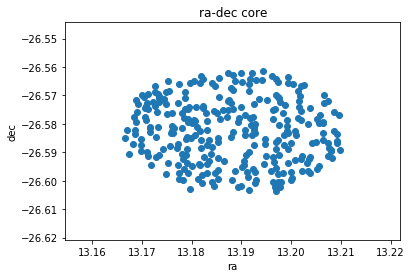

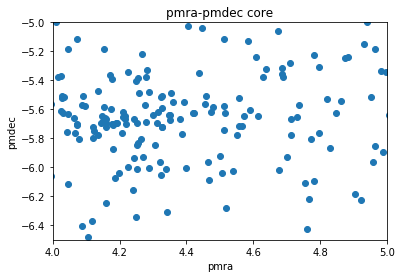

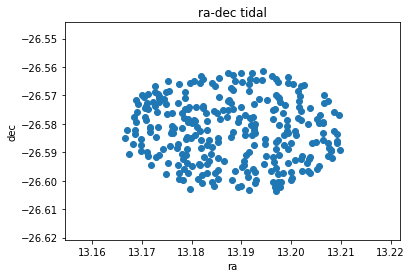

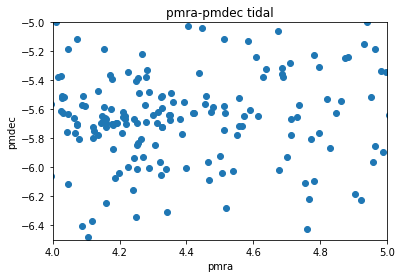

In [3]:
pm_indx=(GlobClust_Log_pmra_error[parallax_indx]/np.fabs(GlobClust_Log_pmra[parallax_indx]) < 0.20) * \
        (GlobClust_Log_pmdec_error[parallax_indx]/np.fabs(GlobClust_Log_pmdec[parallax_indx]) < 0.20) *\
        (GlobClust_Log_vpu[parallax_indx] > 8) * (GlobClust_Log_aen[parallax_indx] == 0)
        
core_indx = (np.sqrt((np.fabs(GlobClust_Log_ra[parallax_indx][pm_indx].as_matrix()-coord_ra_dec.ra.deg)**2+\
                       np.fabs(GlobClust_Log_dec[parallax_indx][pm_indx].as_matrix()-coord_ra_dec.dec.deg)**2)) <= GlobClust_Log_r_c[0]/60)

tidal_indx = (np.sqrt((np.fabs(GlobClust_Log_ra[parallax_indx][pm_indx].as_matrix()-coord_ra_dec.ra.deg)**2+\
                       np.fabs(GlobClust_Log_dec[parallax_indx][pm_indx].as_matrix()-coord_ra_dec.dec.deg)**2)) <= GlobClust_Log_r_t[0]/60)

a = GlobClust_Log_pmra[parallax_indx][pm_indx][core_indx].dropna().min()
aa = GlobClust_Log_pmra[parallax_indx][pm_indx][core_indx].dropna().max()
b = GlobClust_Log_pmdec[parallax_indx][pm_indx][core_indx].dropna().min()
bb = GlobClust_Log_pmdec[parallax_indx][pm_indx][core_indx].dropna().max()
c = GlobClust_Log_pmra[parallax_indx][pm_indx][tidal_indx].dropna().min()
cc = GlobClust_Log_pmra[parallax_indx][pm_indx][tidal_indx].dropna().max()
d = GlobClust_Log_pmdec[parallax_indx][pm_indx][tidal_indx].dropna().min()
dd = GlobClust_Log_pmdec[parallax_indx][pm_indx][tidal_indx].dropna().max()


print('pmra core min:', a)
print('pmra core max:', aa)
print('pmdec core min:', b)
print('pmdec core max:', bb)
print('pmra tidal min:', c)
print('pmra tidal max:', cc)
print('pmdec tidal min:', d)
print('pmdec tidal max:', dd)
print('core count:', core_indx.sum())
print('tidal count:', tidal_indx.sum())

figure()
plt.scatter(GlobClust_Log_ra[parallax_indx][pm_indx][core_indx], GlobClust_Log_dec[parallax_indx][pm_indx][core_indx])
#plt.gca().set_xlim([11,17])
#plt.gca().set_ylim([-30,-23])
plt.title('ra-dec core')
plt.xlabel('ra')
plt.ylabel('dec')

figure()
plt.scatter(GlobClust_Log_pmra[parallax_indx][pm_indx][core_indx], GlobClust_Log_pmdec[parallax_indx][pm_indx][core_indx])
plt.gca().set_xlim([4,5])
plt.gca().set_ylim([-6.5,-5])
plt.title('pmra-pmdec core')
plt.xlabel('pmra')
plt.ylabel('pmdec')

figure()
plt.scatter(GlobClust_Log_ra[parallax_indx][pm_indx][core_indx], GlobClust_Log_dec[parallax_indx][pm_indx][core_indx])
#plt.gca().set_xlim([11,17])
#plt.gca().set_ylim([-30,-23])
plt.title('ra-dec tidal')
plt.xlabel('ra')
plt.ylabel('dec')

figure()
plt.scatter(GlobClust_Log_pmra[parallax_indx][pm_indx][core_indx], GlobClust_Log_pmdec[parallax_indx][pm_indx][core_indx])
plt.gca().set_xlim([4,5])
plt.gca().set_ylim([-6.5,-5])
plt.title('pmra-pmdec tidal')
plt.xlabel('pmra')
plt.ylabel('pmdec')


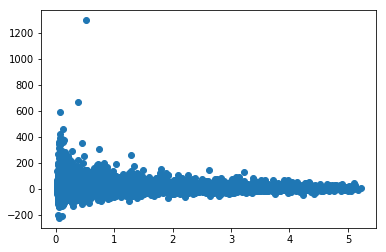

In [4]:
plt.scatter(GlobClust_Log_pmra_error, GlobClust_Log_pmra)

0.8271291868721219
0.6382973814842595


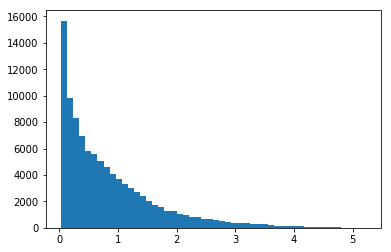

(array([1.8084e+04, 1.0611e+04, 8.8570e+03, 7.4860e+03, 6.6100e+03,
        6.0490e+03, 5.2220e+03, 4.3920e+03, 3.9080e+03, 3.6390e+03,
        3.2710e+03, 2.9920e+03, 2.4760e+03, 2.0220e+03, 1.7710e+03,
        1.5350e+03, 1.2720e+03, 1.0970e+03, 9.6100e+02, 8.2100e+02,
        7.5300e+02, 6.7300e+02, 6.3000e+02, 5.1100e+02, 4.2400e+02,
        3.9000e+02, 3.1500e+02, 2.8700e+02, 2.1900e+02, 1.9900e+02,
        2.0000e+02, 1.7600e+02, 1.1600e+02, 1.1100e+02, 7.4000e+01,
        8.3000e+01, 6.3000e+01, 3.8000e+01, 4.8000e+01, 2.2000e+01,
        2.2000e+01, 2.7000e+01, 1.7000e+01, 9.0000e+00, 1.2000e+01,
        1.1000e+01, 2.0000e+00, 4.0000e+00, 2.0000e+00, 2.0000e+00]),
 array([0.02025589, 0.11483741, 0.20941893, 0.30400046, 0.39858198,
        0.4931635 , 0.58774503, 0.68232655, 0.77690807, 0.8714896 ,
        0.96607112, 1.06065265, 1.15523417, 1.24981569, 1.34439722,
        1.43897874, 1.53356026, 1.62814179, 1.72272331, 1.81730483,
        1.91188636, 2.00646788, 2.10104941, 2.

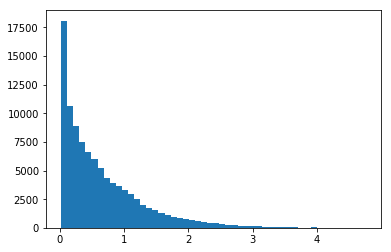

In [5]:
print(np.std(GlobClust_Log_pmra_error.dropna()))
print(np.std(GlobClust_Log_pmdec_error.dropna()))
plt.hist(GlobClust_Log_pmra_error.dropna(), bins=50)
plt.show()

plt.hist(GlobClust_Log_pmdec_error.dropna(), bins=50)

/home/kaderali/.local/lib/python3.6/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  unsupported[op_str]))

(3984, 4)
[0 0 0 ... 0 0 0]
(3984,)
Estimated number of Subgroups: 3


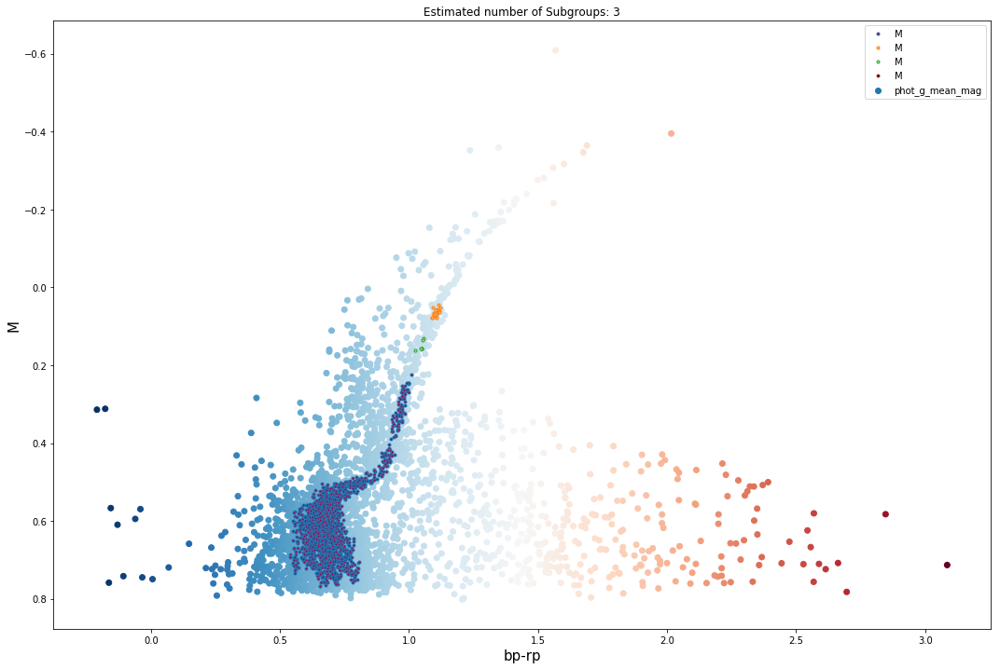

(1704, 1)

 pmra    4.318667
dtype: float64 


 pmdec   -5.691233
dtype: float64


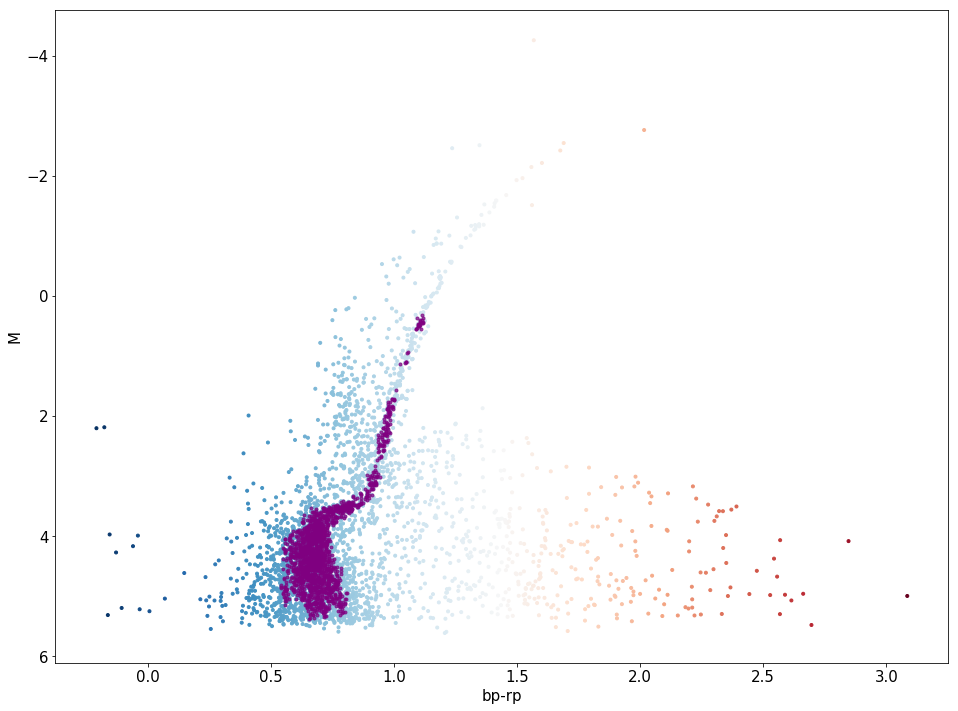

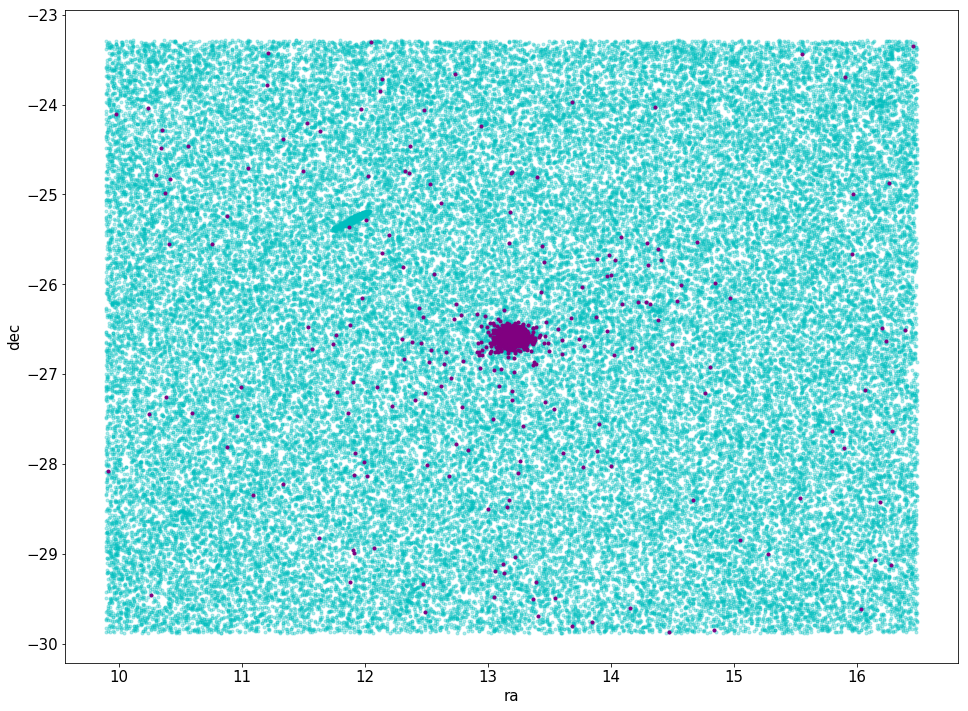

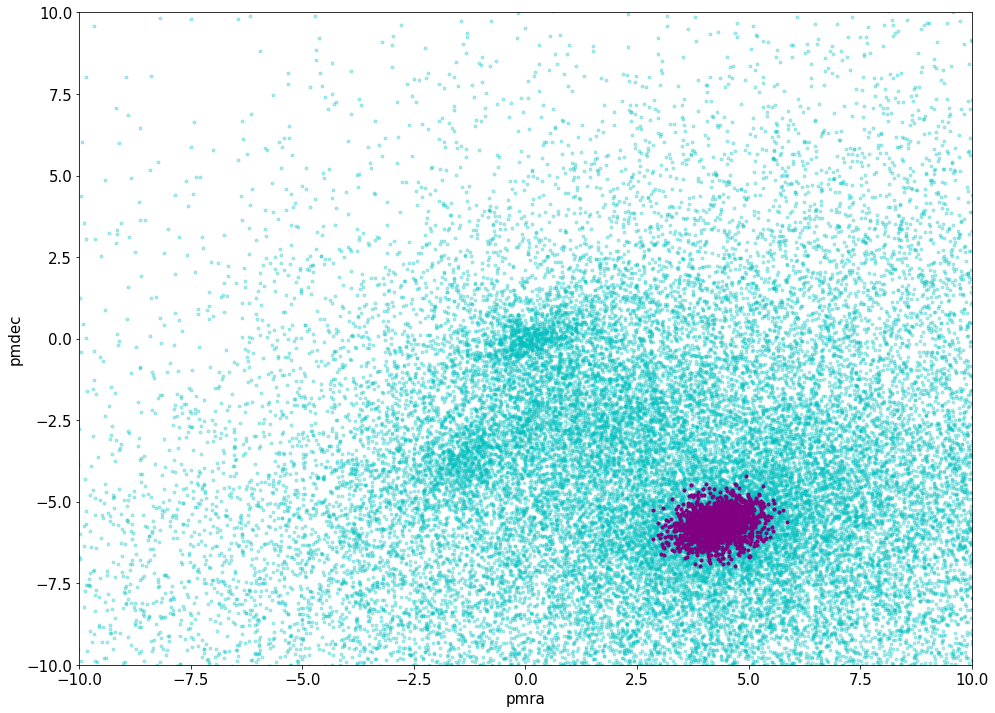

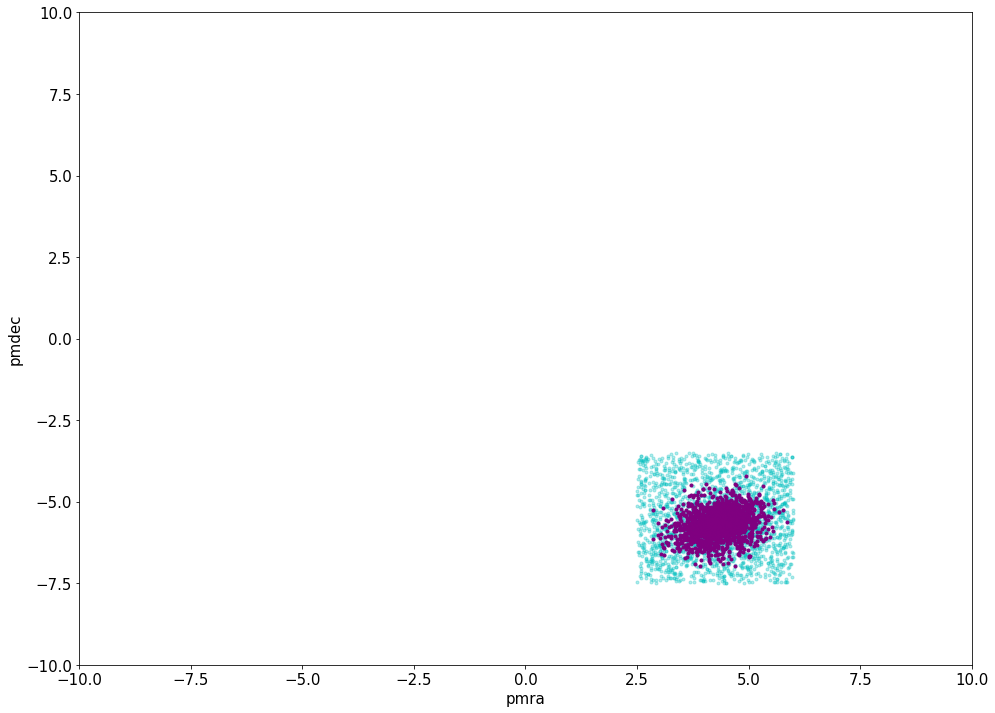

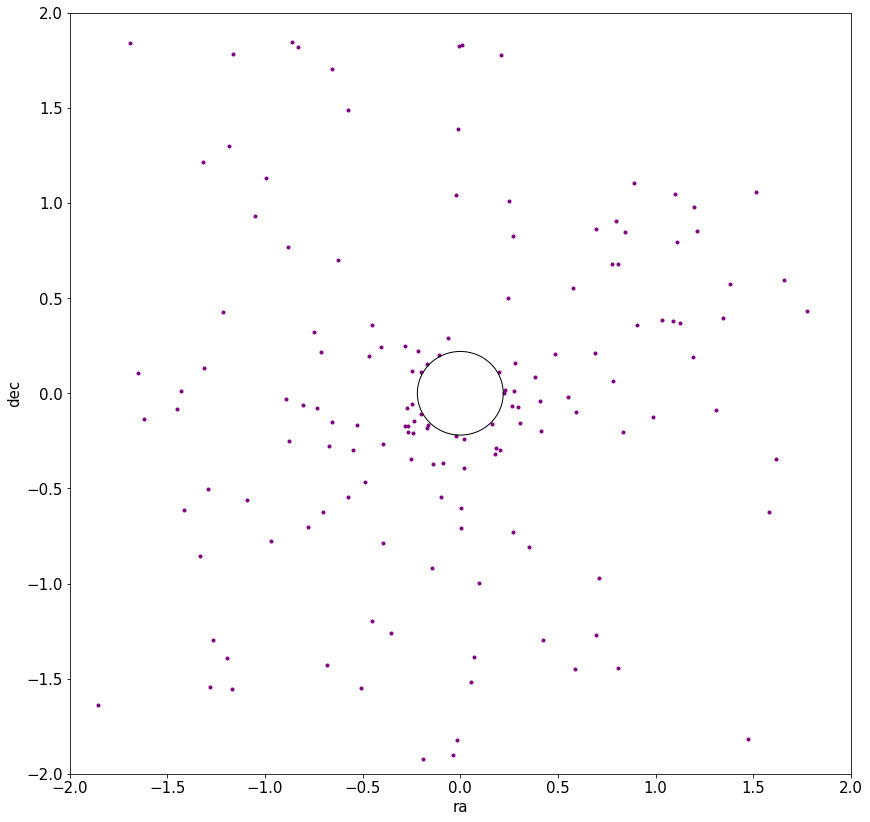

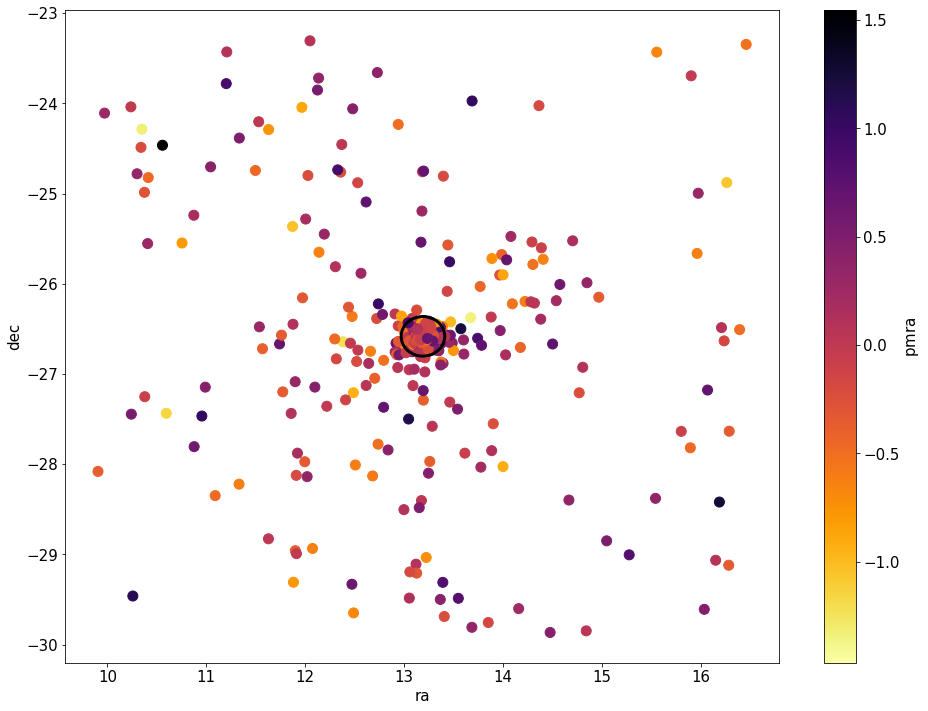

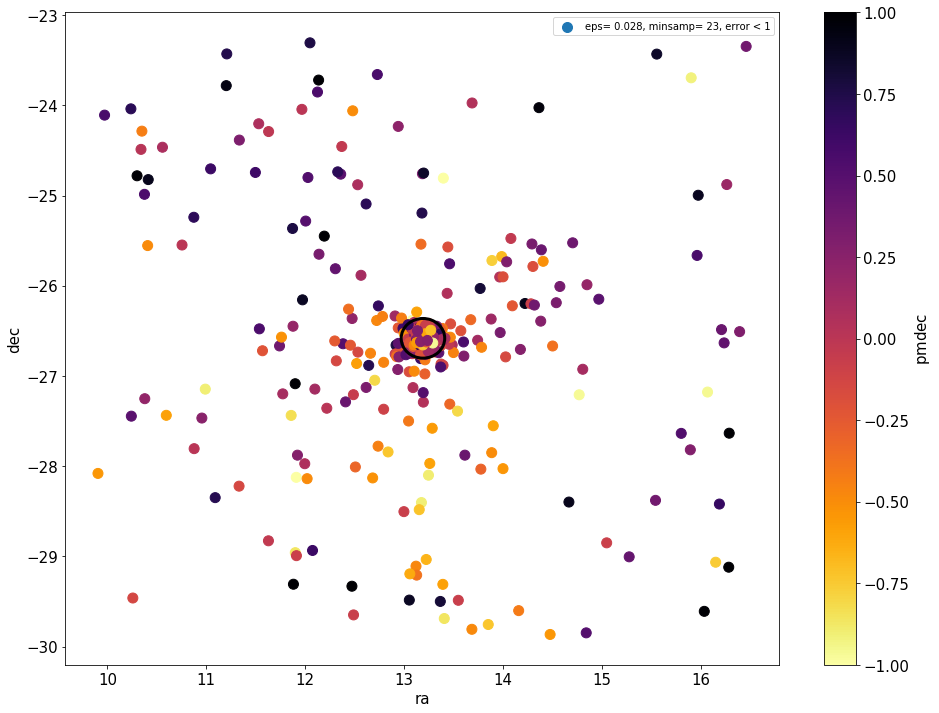

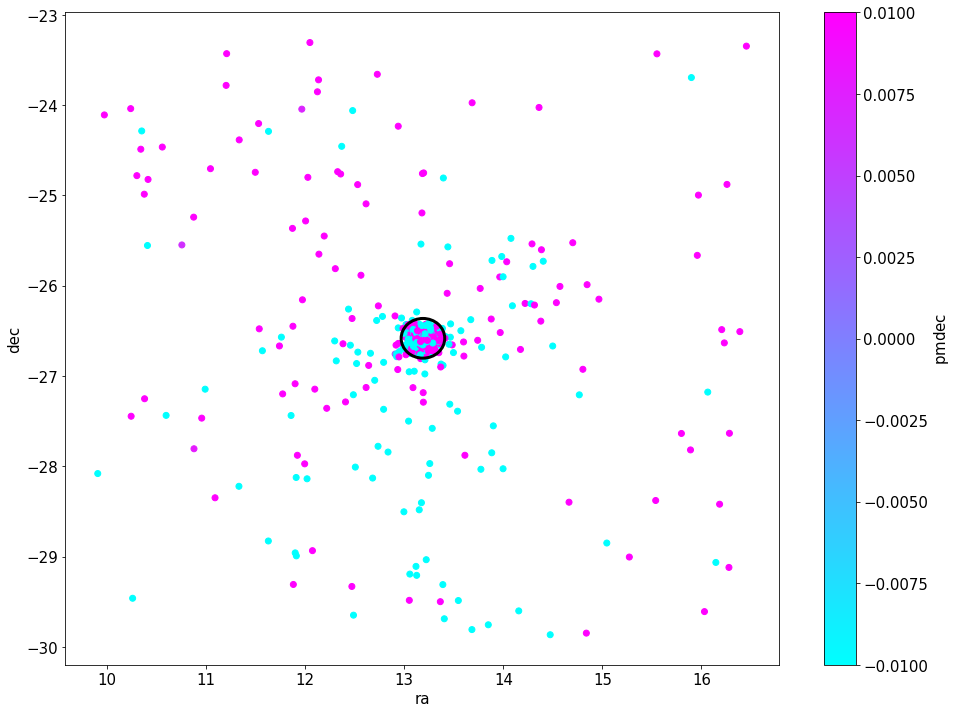

1704 1704
(1704,)
(223, 1)
(223, 1)
[0.    0.006 0.012 0.018 0.024 0.03  0.036 0.042 0.048 0.054 0.06  0.066
 0.072 0.078 0.084 0.09  0.096]
(1704, 1)
/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:489: RuntimeWarning: invalid value encountered in log10

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:490: RuntimeWarning: invalid value encountered in log10

(223,)


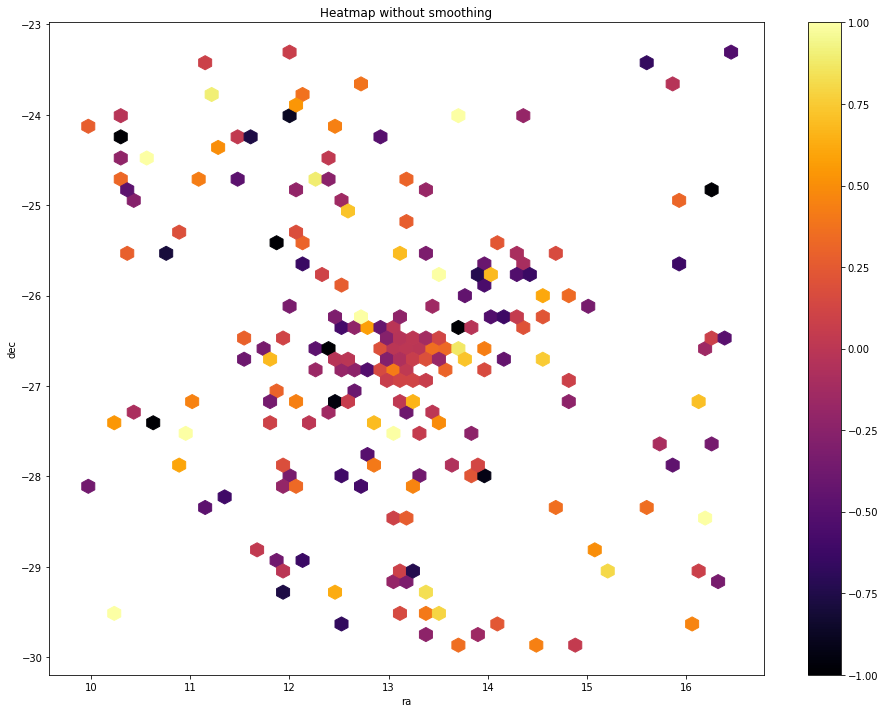

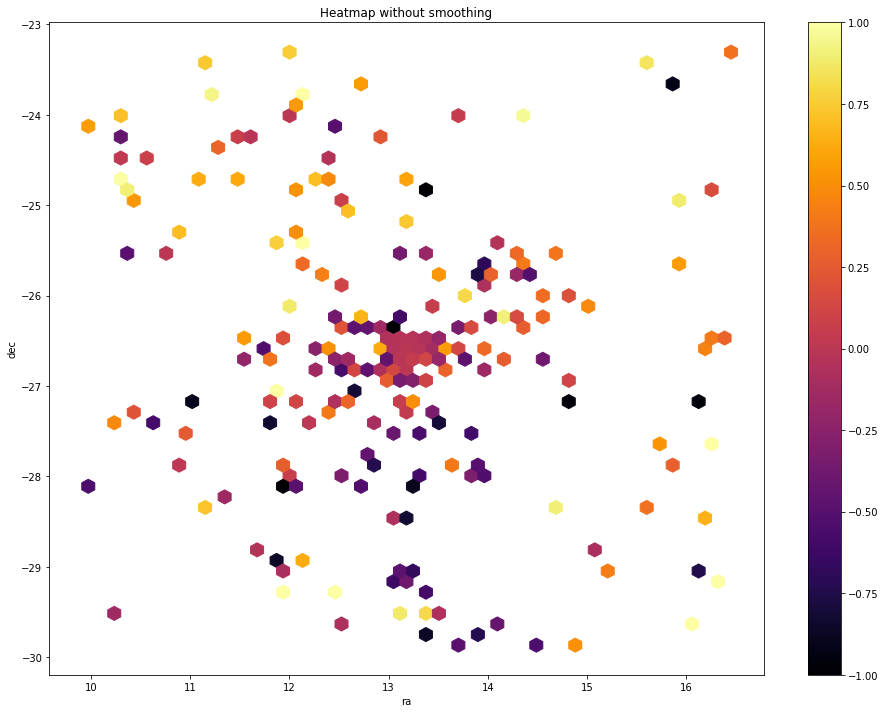

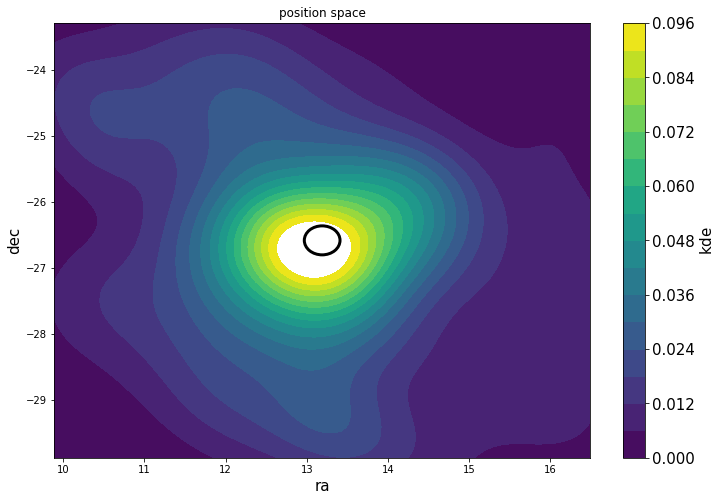

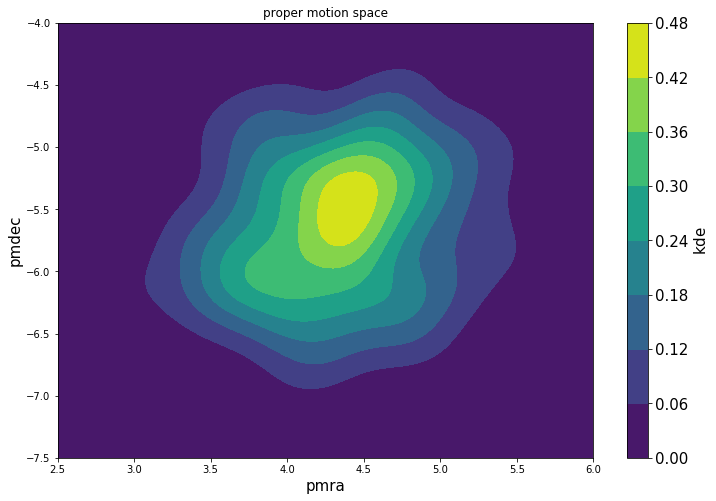

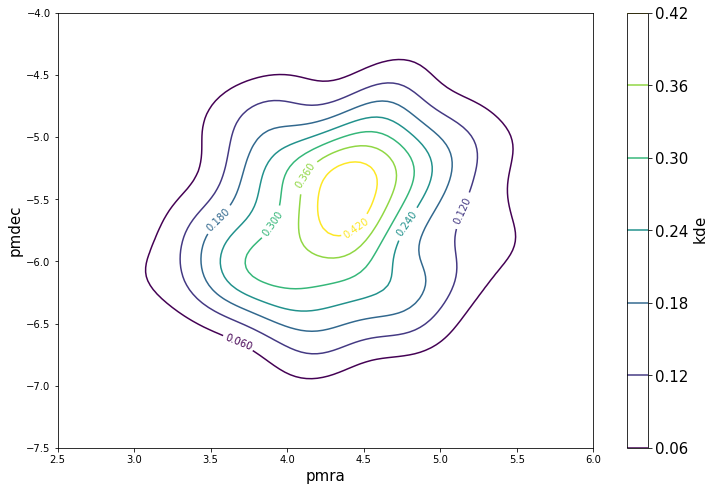

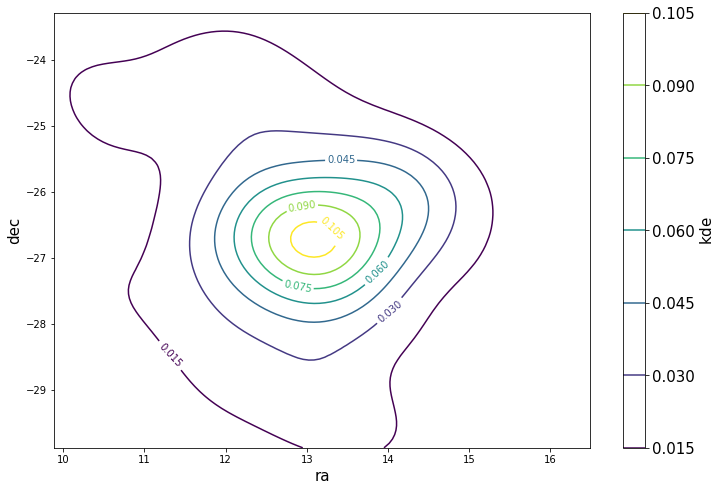

In [6]:
# DBSCAN
DB_Params =[]
DB_Params=np.transpose(DB_Params)

clust_edge2 = (np.sqrt((np.fabs(GlobClust_Log_ra_out[parallax_indx].as_matrix()-coord_ra_dec.ra.deg)**2+
                        np.fabs(GlobClust_Log_dec_out[parallax_indx].as_matrix()-coord_ra_dec.dec.deg)**2))
              >Tidal_Edge/60)

pm_indx=(GlobClust_Log_pmra_error[parallax_indx] < 1) * (GlobClust_Log_pmdec_error[parallax_indx] < 1) *\
        (GlobClust_Log_vpu[parallax_indx] > 8) * (GlobClust_Log_aen[parallax_indx] == 0) *\
        (GlobClust_Log_pmra[parallax_indx] > 2.5) * (GlobClust_Log_pmra[parallax_indx] < 6) *\
        (GlobClust_Log_pmdec[parallax_indx] > -7.5) * (GlobClust_Log_pmdec[parallax_indx] < -3.5)
        
#plt.gca().set_ylim([-7.5, -4.5])
#plt.gca().set_xlim([2.5,6])

eps = 0.028
minsamp = 23

DF={'M': GlobClust_Log_M[parallax_indx][pm_indx]/7, 
    'rpbp': GlobClust_Log_rpbp[parallax_indx][pm_indx], 
    'pmra': GlobClust_Log_pmra[parallax_indx][pm_indx]/50, 'pmdec': GlobClust_Log_pmdec[parallax_indx][pm_indx]/50}

DB_Params = pd.DataFrame(data=DF)
DB_Params=DB_Params.dropna()

print(shape(DB_Params))

# 5% - possibly best
#db=sklearn.cluster.DBSCAN(eps=0.0285, min_samples=19, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

# 5%
#db=sklearn.cluster.DBSCAN(eps=0.0295, min_samples=21, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

# 10% - very few
#db=sklearn.cluster.DBSCAN(eps=0.0295, min_samples=21, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

# 10% - fewer
#db=sklearn.cluster.DBSCAN(eps=0.027, min_samples=20, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

# 10% - possibly best
#db=sklearn.cluster.DBSCAN(eps=0.03, min_samples=20, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

# 10% - 
#db=sklearn.cluster.DBSCAN(eps=0.031, min_samples=13, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

# 15%
#db=sklearn.cluster.DBSCAN(eps=0.028, min_samples=13, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

# 20% - very few
#db=sklearn.cluster.DBSCAN(eps=0.024, min_samples=20, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

# 20%
#db=sklearn.cluster.DBSCAN(eps=0.028, min_samples=18, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

#20%  - THIS ONE 
#db=sklearn.cluster.DBSCAN(eps=0.026, min_samples=19, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

#20%  - THIS ONE 
db=sklearn.cluster.DBSCAN(eps=eps, min_samples=minsamp, metric='euclidean', metric_params=None, algorithm='auto', 
                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

# 25% - fewer
#db=sklearn.cluster.DBSCAN(eps=0.026, min_samples=24, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

# 25% - more
#db=sklearn.cluster.DBSCAN(eps=0.029, min_samples=19, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625


#db=sklearn.cluster.DBSCAN(eps=0.03, min_samples=20, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

#db=sklearn.cluster.DBSCAN(eps=0.026, min_samples=24, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625
#db=sklearn.cluster.DBSCAN(eps=0.027, min_samples=20, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

print(db.labels_)
print(shape(db.labels_))

fig=plt.figure(figsize=(18,12))
plt.scatter(GlobClust_Log_rpbp[parallax_indx][pm_indx]/1, GlobClust_Log_M[parallax_indx][pm_indx]/7, c=GlobClust_Log_rpbp[parallax_indx][pm_indx]/1, cmap='RdBu_r')
#plt.scatter(db,DB_Params)
#plt.show()

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

print('Estimated number of Subgroups: %d' % n_clusters_)

x_param3=[]
y_param3=[]

x_param4=[]
y_param4=[]

# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)
    
    #NOISE
    #xy = DB_Params[class_member_mask & ~core_samples_mask]
    #plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
    #         markeredgecolor='k', markersize=6)
    
    #CLEANED DATA
    xy = DB_Params[class_member_mask & core_samples_mask]
    
    plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], '.', markerfacecolor=tuple(col),)
     #       )#markeredgecolor='k')#, markersize=14)
    
    x_param3.append(xy.loc[:, "rpbp"])
    #y_param3=x_param3
    y_param3.append(xy.loc[:, "M"]*7)

    #x_param4.append(xy.loc[:, "pmra"]*0.35)
    #y_param4.append(xy.loc[:, "pmdec"]*0.3)
    
    #x_param5.append(xy.loc[:, "ra"]*0.35)
    #y_param5.append(xy.loc[:, "dec"]*0.3)

plt.gca().invert_yaxis()
plt.title('Estimated number of Subgroups: %d' % n_clusters_)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)

plt.legend()
plt.show()
#fig.savefig('GC_DBSCAN'+ GlobClust_Log_ID[0] +'eps0p165-mins10_coreCMD-fullsetiponfullcmd.png')

x_out3 = pd.DataFrame(x_param3)#, index=None)#, mangle_dupe_cols=True)
#x_out3.reset_index()
x_out3 = x_out3.transpose() 
x_out3 = x_out3.loc[:,~x_out3.columns.duplicated()]
#x_out3 = x_out3["rpbp"].as_matrix()
x_out3

y_out3 = pd.DataFrame(y_param3)#, index=None)#, mangle_dupe_cols=True)
#y_out3.reset_index()
y_out3 = y_out3.transpose() 
y_out3 = y_out3.loc[:,~y_out3.columns.duplicated()]
#y_out3 = y_out3["M"].as_matrix()
print(shape(y_out3))

GC_ra = pd.DataFrame({'ra':GlobClust_Log_ra})
GC_dec = pd.DataFrame({'dec':GlobClust_Log_dec})
GC_pmra = pd.DataFrame({'pmra':GlobClust_Log_pmra})
GC_pmdec = pd.DataFrame({'pmdec':GlobClust_Log_pmdec})

ra_DB = GC_ra.reindex(x_out3.index)
dec_DB = GC_dec.reindex(y_out3.index)
pmra_DB = GC_pmra.reindex(x_out3.index)
pmdec_DB = GC_pmdec.reindex(y_out3.index)
M_DB = GlobClust_Log_M.reindex(y_out3.index)
rpbp_DB = GlobClust_Log_rpbp.reindex(y_out3.index)

pmra_DB_norm = (pmra_DB-pmra_DB.mean())#/(pmra_DB.mean())
pmdec_DB_norm = (pmdec_DB-pmdec_DB.mean())#/(pmdec_DB.mean())

print('\n', pmra_DB.mean(), '\n')
print('\n', pmdec_DB.mean())


fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp[parallax_indx][pm_indx], y=GlobClust_Log_M[parallax_indx][pm_indx], c=GlobClust_Log_rpbp[parallax_indx][pm_indx], cmap='RdBu_r', marker='.')
plt.scatter(x=rpbp_DB, y=M_DB, c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().invert_yaxis()
plt.show()

fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_ra_out[parallax_indx], y=GlobClust_Log_dec_out[parallax_indx], c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB, y=dec_DB, c='purple', marker='.')#, alpha=0.2)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

fig=plt.figure(figsize=(16,12))
#plt.hexbin(GlobClust_Log_pmdec_out, GlobClust_Log_pmra_out, extent=[-10,10, -10,10], bins='log',gridsize=200)
plt.scatter(x=GlobClust_Log_pmra_out[parallax_indx], y=GlobClust_Log_pmdec_out[parallax_indx], c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(y=pmdec_DB, x=pmra_DB, c='purple', marker='.')#, alpha=0.2)
plt.xlabel('pmra', fontsize=15)
plt.ylabel('pmdec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
#plt.gca().set_ylim([-7.5, -4.5])
#plt.gca().set_xlim([2.5,6])
plt.gca().set_ylim([-10,10])
plt.gca().set_xlim([-10,10])
#plt.gca().set_ylim([3.2, 4.7])
#plt.gca().set_xlim([-7.5,-3])
plt.show()

fig=plt.figure(figsize=(16,12))
#plt.hexbin(GlobClust_Log_pmdec_out, GlobClust_Log_pmra_out, extent=[-10,10, -10,10], bins='log',gridsize=200)
plt.scatter(x=GlobClust_Log_pmra_out[parallax_indx][pm_indx] , y=GlobClust_Log_pmdec_out[parallax_indx][pm_indx], c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(y=pmdec_DB, x=pmra_DB, c='purple', marker='.')#, alpha=0.2)
plt.xlabel('pmra', fontsize=15)
plt.ylabel('pmdec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
#plt.gca().set_ylim([-7.5, -4.5])
#plt.gca().set_xlim([2.5,6])
plt.gca().set_ylim([-10,10])
plt.gca().set_xlim([-10,10])
#plt.gca().set_ylim([3.2, 4.7])
#plt.gca().set_xlim([-7.5,-3])
plt.show()

clust_indx = (np.sqrt((np.fabs(ra_DB.as_matrix()-coord_ra_dec.ra.deg)**2+np.fabs(dec_DB.as_matrix()-coord_ra_dec.dec.deg)**2))
              >Tidal_Edge/60)
#(np.sqrt(np.fabs((ra_DB-coord_ra_dec.ra.deg)**2+(dec_DB-coord_ra_dec.dec.deg)**2))<Clust_Edge/60)


fig=plt.figure(figsize=(14,14))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_pmra_out, y=GlobClust_Log_pmdec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB[clust_indx]-coord_ra_dec.ra.deg, y=dec_DB[clust_indx]-coord_ra_dec.dec.deg, c='purple', marker='.')#, alpha=0.2)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
circle = plt.Circle((0,0), GlobClust_Log_r_t/60*4, color='b', fill=False, lw=2)
#ax.add_artist(circle)
circle2 = plt.Circle((0,0), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=1)
ax.add_artist(circle2)
circle3 = plt.Circle((0,0), 5/60, color='pink', fill=False, lw=2)
#ax.add_artist(circle3)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().set_ylim([-2, 2])
plt.gca().set_xlim([-2,2])
plt.gca().tick_params(labelsize=15)
plt.show()


fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB, y=dec_DB, c=pmra_DB_norm, cmap='inferno_r', marker='o', s=100)#, vmin=-1, vmax=1)#, alpha=0.2)
#plt.scatter(x=ra_DB, y=dec_DB, c=pmdec_DB_norm, cmap='inferno', marker='.', vmin=-1, vmax=1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60*4, color='b', fill=False, lw=5)
#ax.add_artist(circle)
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=3)
ax.add_artist(circle2)
circle3 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), 5/60, color='pink', fill=False, lw=2)
#ax.add_artist(circle3)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB, y=dec_DB, c=pmdec_DB_norm, cmap='inferno_r', marker='o', s=100, 
            label='eps= %.3f, minsamp= %d, error < 1' %(eps, minsamp), vmin=-1, vmax=1)#vmin=-0.1, vmax=.1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60*4, color='b', fill=False, lw=5)
#ax.add_artist(circle)
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=3)
ax.add_artist(circle2)
circle3 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), 5/60, color='pink', fill=False, lw=2)
#ax.add_artist(circle3)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
plt.legend()
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB, y=dec_DB, c=pmdec_DB_norm, cmap='cool', marker='o', vmin=-0.01, vmax=0.01)#vmin=-0.1, vmax=.1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60*4, color='b', fill=False, lw=5)
#ax.add_artist(circle)
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=3)
ax.add_artist(circle2)
circle3 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), 5/60, color='pink', fill=False, lw=2)
#ax.add_artist(circle3)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

x=ra_DB[~numpy.isnan(ra_DB)]
y=dec_DB[~numpy.isnan(dec_DB)]
x=np.array(x)
y=np.array(y)
print(len(x),len(y))
print(x[:,0].shape)

fig=plt.figure(figsize=(16,12))
# normal distribution center at x=0 and y=5
plt.hexbin(x[:,0], y[:,0], C=pmra_DB_norm, cmap='inferno', gridsize=50,vmin=-1,vmax=1)#, extent=[11,17,  -23,-29])
plt.colorbar()
plt.title('Heatmap without smoothing')
plt.ylabel("dec")
plt.xlabel("ra")
fig=plt.figure(figsize=(16,12))
# normal distribution center at x=0 and y=5
plt.hexbin(x[:,0], y[:,0], C=pmdec_DB_norm, cmap='inferno', gridsize=50,vmin=-1,vmax=1)#, extent=[11,17,  -23,-29])
plt.colorbar()
plt.title('Heatmap without smoothing')
plt.ylabel("dec")
plt.xlabel("ra")

pmra_kde=pmra_DB[clust_indx].as_matrix()
pmdec_kde=pmdec_DB[clust_indx].as_matrix()
print(shape(pmdec_kde))
#pmra_kde=pmra_DB.as_matrix()
#pmdec_kde=pmdec_DB.as_matrix()
#print(shape(pmdec_kde))

ra_kde=ra_DB[clust_indx].as_matrix()
dec_kde=dec_DB[clust_indx].as_matrix()
print(shape(pmdec_kde))
#ra_kde=ra_DB.as_matrix()
#dec_kde=dec_DB.as_matrix()
#print(shape(pmdec_kde))

pmra_kde_1 = 0-10 
pmra_kde_2 = 0+10
pmdec_kde_1 = 0-10
pmdec_kde_2 = 0+10


findx=(np.isfinite(pmra_kde))*(np.isfinite(pmdec_kde))*(pmra_kde<pmra_kde_2)*(pmra_kde>pmra_kde_1)*(pmdec_kde>pmdec_kde_1)*(pmdec_kde<pmdec_kde_2)

from scipy import stats
from matplotlib import colors, ticker, cm

#pmra_kde=pmra_DB.as_matrix()[findx]
#pmdec_kde=pmdec_DB.as_matrix()[findx]

#pmra_kde=pmra_DB.dropna().as_matrix()
#pmdec_kde=pmdec_DB.dropna().as_matrix()

r_t = GlobClust_Log_r_t.as_matrix()
r_t = r_t[0]

ra_kde_1 = coord_ra_dec.ra.deg-r_t/60*15
ra_kde_2 = coord_ra_dec.ra.deg+r_t/60*15
dec_kde_1 = coord_ra_dec.dec.deg-r_t/60*15
dec_kde_2 = coord_ra_dec.dec.deg+r_t/60*15


#KDE part
k = stats.gaussian_kde([ra_kde[findx], dec_kde[findx]], )
xi, yi = np.mgrid[ra_kde_1:ra_kde_2:100*1j, 
                  dec_kde_1:dec_kde_2:100*1j]
#xi, yi = np.mgrid[12:14:100*1j, 
#                  -28:-26:100*1j]
#print(xi,yi,k)
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
zii=zi.reshape(xi.shape)

contours = np.arange(0,0.1, 0.006)
print(contours)

fig=plt.figure(figsize=(12,8))
ax=plt.gca()
plt.contourf(xi, yi, zii , levels=contours)#[0,0.025,0.05,0.075,0.1])# locator=ticker.LogLocator())
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=3)
ax.add_artist(circle2)
plt.title('position space')
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{kde}$',fontsize=15)

#KDE part
k = stats.gaussian_kde([pmra_kde[findx], pmdec_kde[findx]], )
xi, yi = np.mgrid[2.5:6:100*1j, 
                  -7.5:-4:100*1j]
#print(xi,yi,k)
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
zii=zi.reshape(xi.shape)

fig=plt.figure(figsize=(12,8))
plt.contourf(xi, yi, zii ,)# locator=ticker.LogLocator())
plt.title('proper motion space')
plt.xlabel('pmra', fontsize=15)
plt.ylabel('pmdec', fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{kde}$',fontsize=15)


pmra_kde=pmra_DB[clust_indx].as_matrix()
pmdec_kde=pmdec_DB[clust_indx].as_matrix()

print(shape(clust_indx))

#pmra_kde=pmra_DB.as_matrix()
#pmdec_kde=pmdec_DB.as_matrix()

#pmra_kde_1 = 0-10 
#pmra_kde_2 = 0+10
#pmdec_kde_1 = 0-10
#pmdec_kde_2 = 0+10

findx=(np.isfinite(pmra_kde))*(np.isfinite(pmdec_kde))#*(pmra_kde<2.*np.pi)*(pmra_kde>0.)*(pmdec_kde>-1.)*(pmdec_kde<1.)

from scipy import stats
from matplotlib import colors, ticker, cm

#pmra_kde=pmra_DB.as_matrix()[findx]
#pmdec_kde=pmdec_DB.as_matrix()[findx]

#pmra_kde=pmra_DB.dropna().as_matrix()
#pmdec_kde=pmdec_DB.dropna().as_matrix()

r_t = GlobClust_Log_r_t.as_matrix()
r_t = r_t[0]

#ra_kde_1 = 0-r_t/60*15
#ra_kde_2 = 0+r_t/60*15
#dec_kde_1 = 0-r_t/60*15
#dec_kde_2 = 0+r_t/60*15

lev_exp = np.arange(np.floor(np.log10(pmra_DB_norm[~numpy.isnan(pmra_DB_norm)]).min()-1),
                    np.ceil(np.log10(pmra_DB_norm[~numpy.isnan(pmra_DB_norm)]).max()+1))
levs = np.power(10, lev_exp)

print(shape(pmra_kde[findx]))


#KDE part
k = stats.gaussian_kde([pmra_kde[findx], pmdec_kde[findx]], )
xi, yi = np.mgrid[2.5:6:100*1j, 
                  -7.5:-4:100*1j]
#print(xi,yi,k)
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
zii=zi.reshape(xi.shape)

fig=plt.figure(figsize=(12,8))
CS=plt.contour(xi, yi, zii, )# levs, norm=colors.LogNorm())#locator=ticker.LogLocator())
plt.xlabel('pmra', fontsize=15)
plt.ylabel('pmdec', fontsize=15)
plt.clabel(CS, inline=1, fontsize=10, )
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{kde}$',fontsize=15)

#KDE part
k = stats.gaussian_kde([ra_kde[findx], dec_kde[findx]], )
xi, yi = np.mgrid[ra_kde_1:ra_kde_2:100*1j, 
                  dec_kde_1:dec_kde_2:100*1j]
#print(xi,yi,k)
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
zii=zi.reshape(xi.shape)

fig=plt.figure(figsize=(12,8))
CS=plt.contour(xi, yi, zii )#, levs, norm=colors.LogNorm())#locator=ticker.LogLocator())
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
plt.clabel(CS, inline=1, fontsize=10, )
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{kde}$',fontsize=15)

In [5]:
shape(clust_indx)
clust_indx.sum()
shape(ra_DB)
shape(ra_DB[clust_indx])

(224, 1)

/usr/local/lib/python3.6/site-packages/matplotlib/figure.py:403: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "



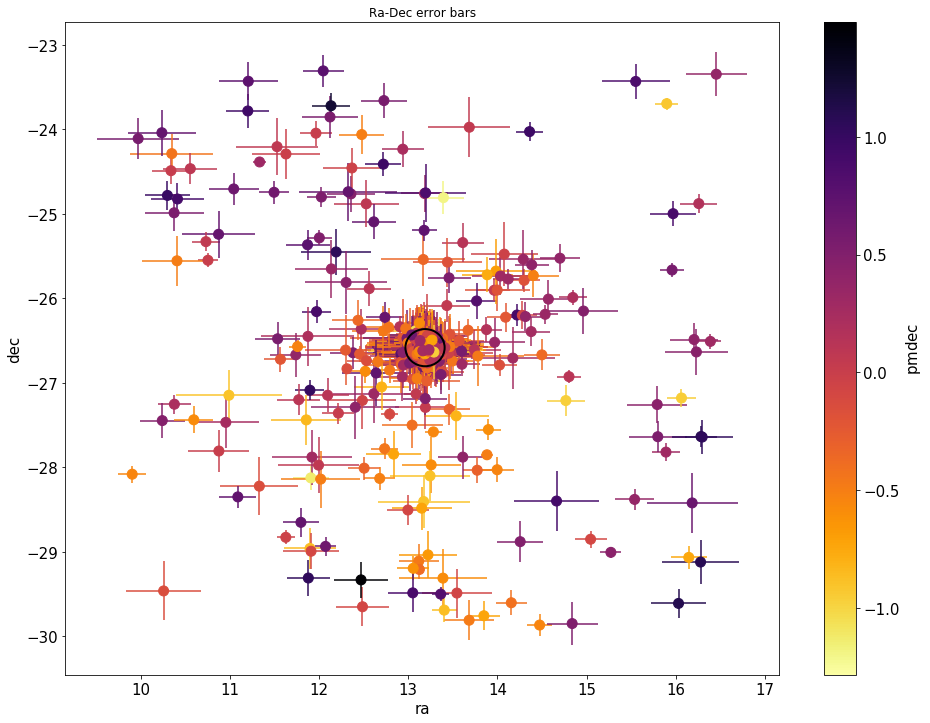

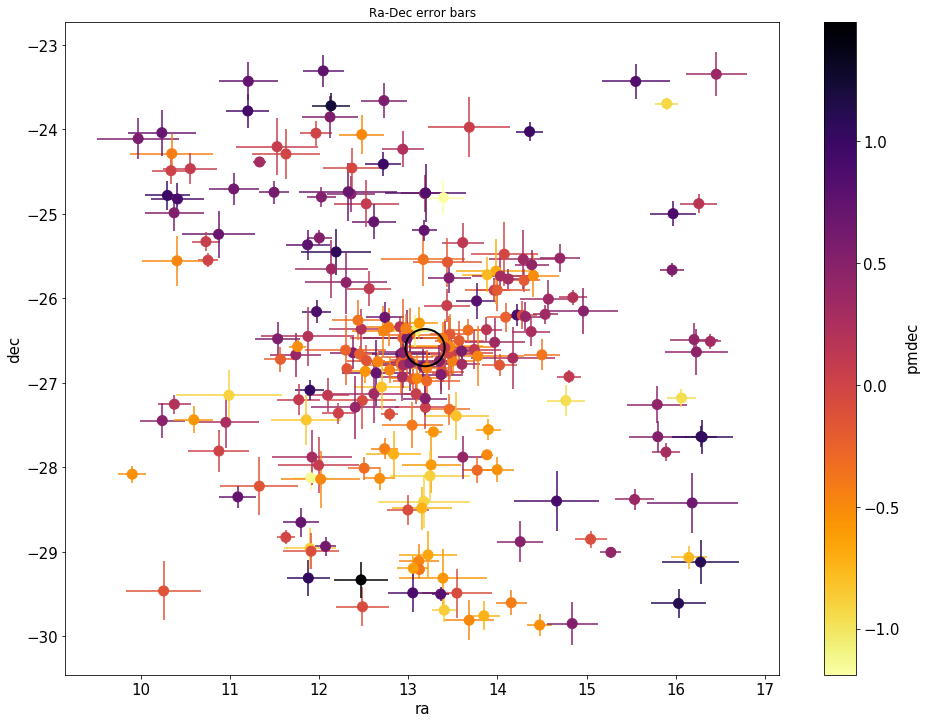

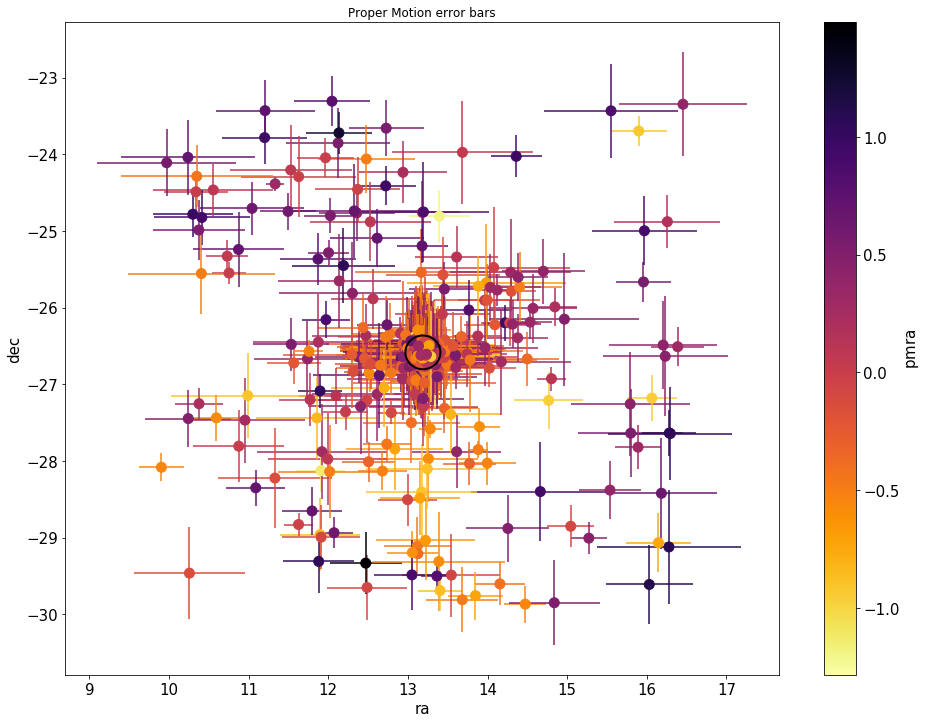

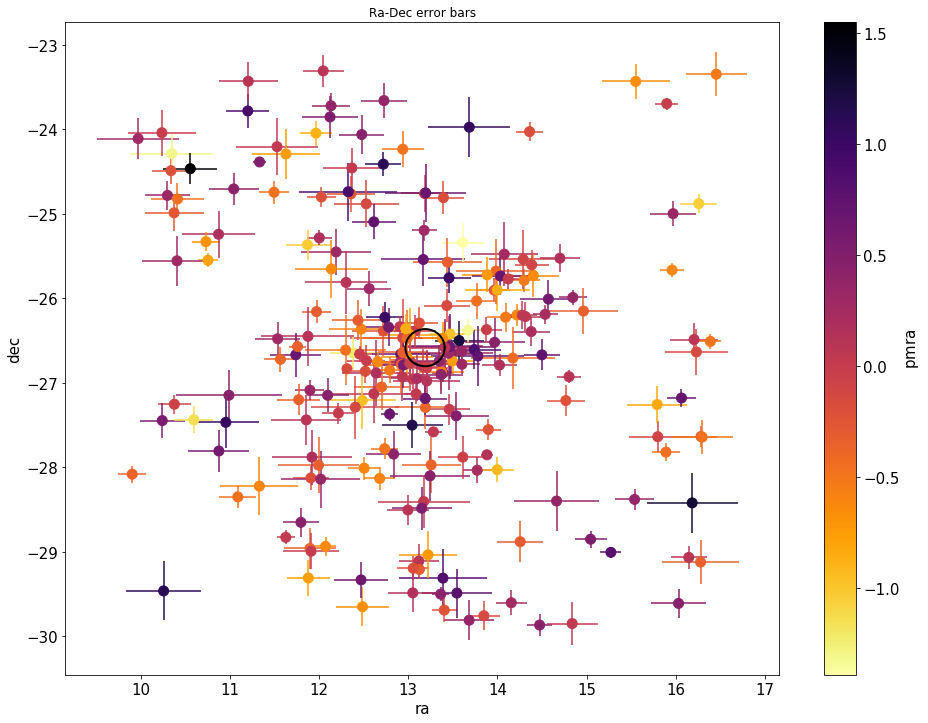

In [26]:
GC_pmra_error = pd.DataFrame({'pmra_error':GlobClust_Log_pmra_error})
GC_pmdec_error = pd.DataFrame({'pmdec_error':GlobClust_Log_pmdec_error})
GC_ra_error = pd.DataFrame({'ra_error':GlobClust_Log_ra_error})
GC_dec_error = pd.DataFrame({'dec_error':GlobClust_Log_dec_error})

ra_error_DB = GC_ra_error.reindex(x_out3.index)
dec_error_DB = GC_dec_error.reindex(y_out3.index)
pmra_error_DB = GC_pmra_error.reindex(x_out3.index)
pmdec_error_DB = GC_pmdec_error.reindex(y_out3.index)

vpu_DB = GlobClust_Log_vpu.reindex(y_out3.index)
aen_DB = GlobClust_Log_aen.reindex(y_out3.index)

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
sc = plt.scatter(x=ra_DB, y=dec_DB, c=pmdec_DB_norm, cmap='inferno_r', marker='o', zorder=3, s=100, )#vmin=-1, vmax=1)#vmin=-0.1, vmax=.1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60, color='k', fill=False, lw=2, zorder=4)
ax.add_artist(circle)

a,b,c=plt.errorbar(ra_DB.as_matrix(),dec_DB.as_matrix(), xerr=ra_error_DB.as_matrix()[:,0], linestyle="None", zorder=1) #ecolor=pmdec_DB_norm,
a,b,d=plt.errorbar(ra_DB.as_matrix(),dec_DB.as_matrix(), yerr=dec_error_DB.as_matrix()[:,0], linestyle="None", zorder=1) #ecolor=pmdec_DB_norm,
cb=plt.colorbar(sc)
pmdec_colour = cb.to_rgba(pmdec_DB_norm.as_matrix()[:,0])
c[0].set_color(pmdec_colour)
d[0].set_color(pmdec_colour)
#pmra_colour = cb.to_rgba(pmra_DB_norm.as_matrix()[:,0])
#d[0].set_color(pmra_colour)

plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
plt.title('Ra-Dec error bars')
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
fig.show()


fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
sc = plt.scatter(x=ra_DB[clust_indx], y=dec_DB[clust_indx], c=pmdec_DB_norm[clust_indx], cmap='inferno_r', marker='o', zorder=3, s=100, )#vmin=-1, vmax=1)#vmin=-0.1, vmax=.1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60, color='k', fill=False, lw=2, zorder=4)
ax.add_artist(circle)

a,b,c=plt.errorbar(ra_DB[clust_indx].as_matrix(),dec_DB[clust_indx].as_matrix(), xerr=ra_error_DB[clust_indx].as_matrix()[:,0], linestyle="None", zorder=1) #ecolor=pmdec_DB_norm,
a,b,d=plt.errorbar(ra_DB[clust_indx].as_matrix(),dec_DB[clust_indx].as_matrix(), yerr=dec_error_DB[clust_indx].as_matrix()[:,0], linestyle="None", zorder=1) #ecolor=pmdec_DB_norm,
cb=plt.colorbar(sc)
pmdec_colour = cb.to_rgba(pmdec_DB_norm[clust_indx].as_matrix()[:,0])
c[0].set_color(pmdec_colour)
d[0].set_color(pmdec_colour)
#pmra_colour = cb.to_rgba(pmra_DB_norm.as_matrix()[:,0])
#d[0].set_color(pmra_colour)

plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
plt.title('Ra-Dec error bars')
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
fig.show()



fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
sc = plt.scatter(x=ra_DB, y=dec_DB, c=pmdec_DB_norm, cmap='inferno_r', marker='o', zorder=3, s=100, )#vmin=-1, vmax=1)#vmin=-0.1, vmax=.1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60, color='k', fill=False, lw=2, zorder=4)
ax.add_artist(circle)

a,b,c=plt.errorbar(ra_DB.as_matrix(),dec_DB.as_matrix(), xerr=pmra_error_DB.as_matrix()[:,0], linestyle="None", zorder=1) #ecolor=pmdec_DB_norm,
a,b,d=plt.errorbar(ra_DB.as_matrix(),dec_DB.as_matrix(), yerr=pmdec_error_DB.as_matrix()[:,0], linestyle="None", zorder=1) #ecolor=pmdec_DB_norm,
cb=plt.colorbar(sc)
pmdec_colour = cb.to_rgba(pmdec_DB_norm.as_matrix()[:,0])
c[0].set_color(pmdec_colour)
d[0].set_color(pmdec_colour)
#pmra_colour = cb.to_rgba(pmra_DB_norm.as_matrix()[:,0])
#d[0].set_color(pmra_colour)

plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
plt.title('Proper Motion error bars')
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
fig.show()


fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
sc = plt.scatter(x=ra_DB[clust_indx], y=dec_DB[clust_indx], c=pmra_DB_norm[clust_indx], cmap='inferno_r', marker='o', zorder=3, s=100, )#vmin=-1, vmax=1)#vmin=-0.1, vmax=.1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60, color='k', fill=False, lw=2, zorder=4)
ax.add_artist(circle)

a,b,c=plt.errorbar(ra_DB[clust_indx].as_matrix(),dec_DB[clust_indx].as_matrix(), xerr=ra_error_DB[clust_indx].as_matrix()[:,0], linestyle="None", zorder=1) #ecolor=pmdec_DB_norm,
a,b,d=plt.errorbar(ra_DB[clust_indx].as_matrix(),dec_DB[clust_indx].as_matrix(), yerr=dec_error_DB[clust_indx].as_matrix()[:,0], linestyle="None", zorder=1) #ecolor=pmdec_DB_norm,
cb=plt.colorbar(sc)
pmra_colour = cb.to_rgba(pmra_DB_norm[clust_indx].as_matrix()[:,0])
c[0].set_color(pmra_colour)
d[0].set_color(pmra_colour)
#pmra_colour = cb.to_rgba(pmra_DB_norm.as_matrix()[:,0])
#d[0].set_color(pmra_colour)

plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
plt.title('Ra-Dec error bars')
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
fig.show()

In [66]:
shape(pmra_DB.as_matrix()[:,0])
#d_pc
shape(clust_indx)

(1758, 1)

/usr/local/lib/python3.6/site-packages/matplotlib/figure.py:403: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "



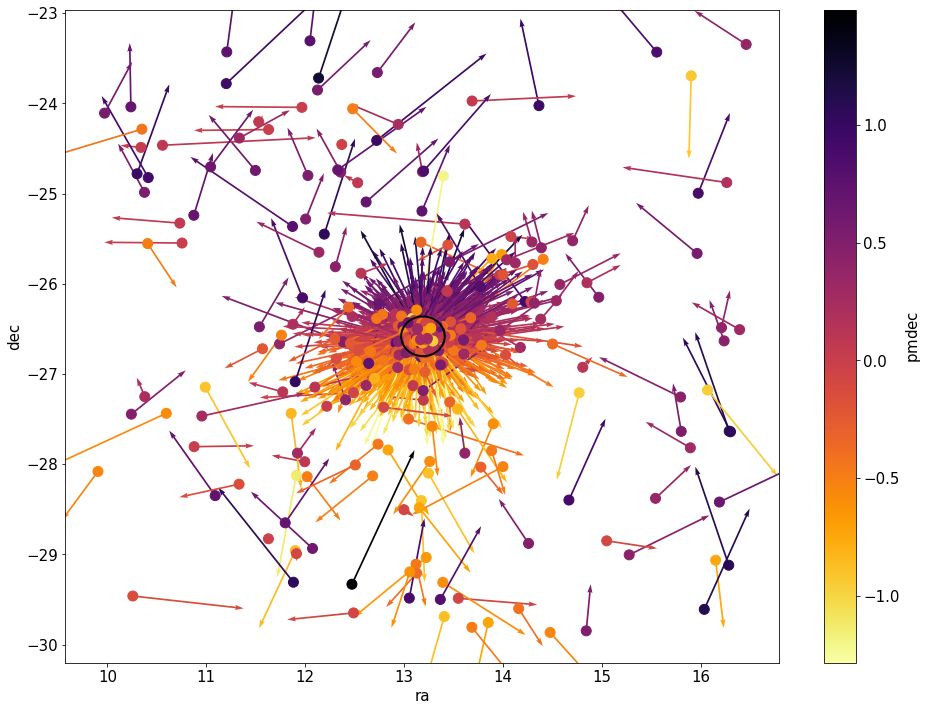

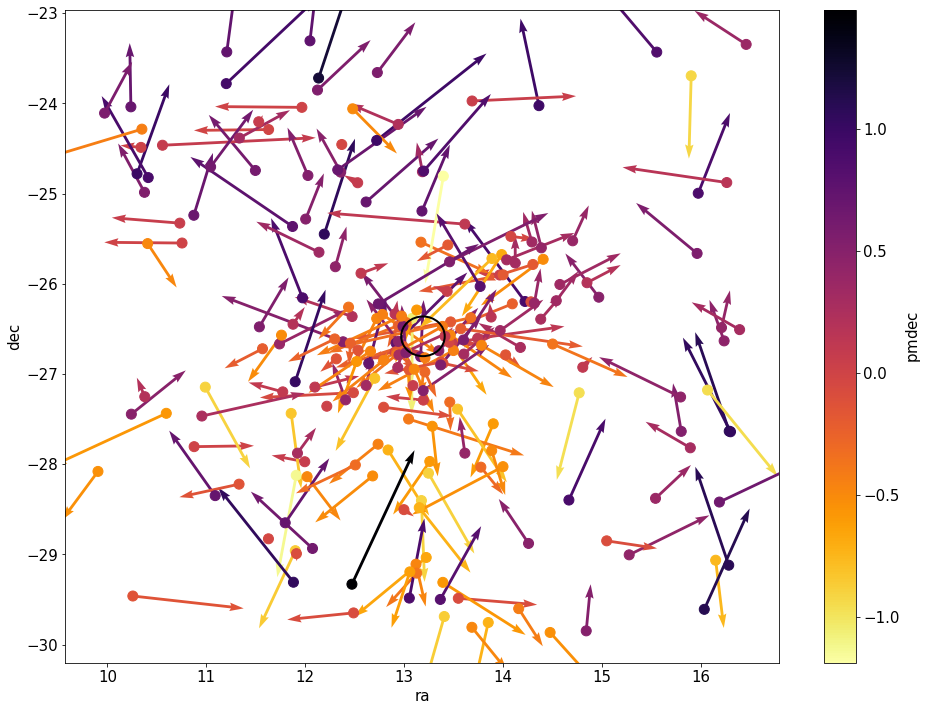

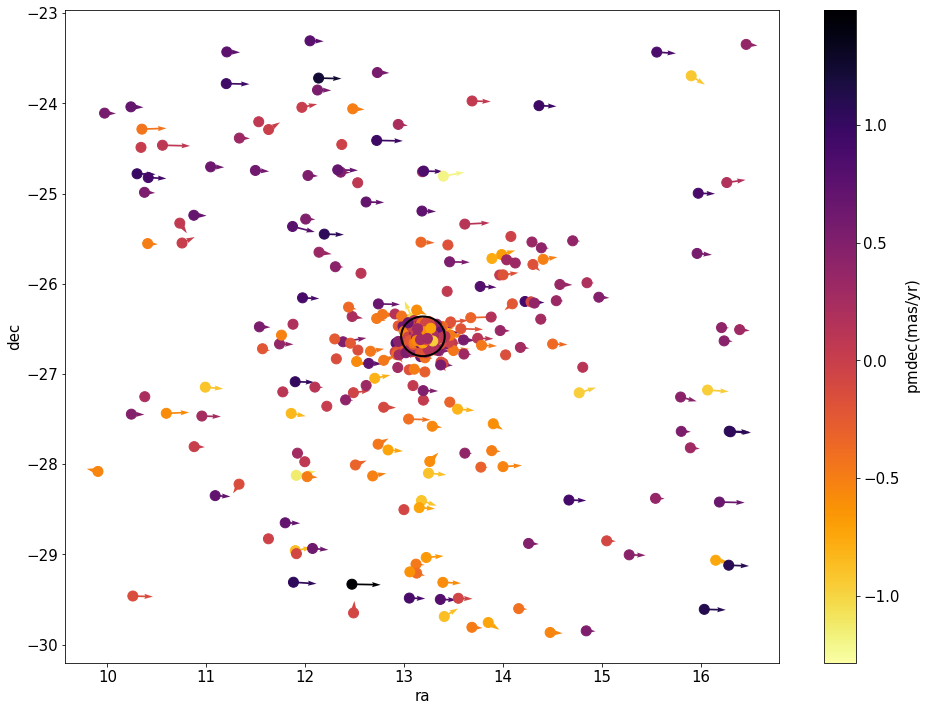

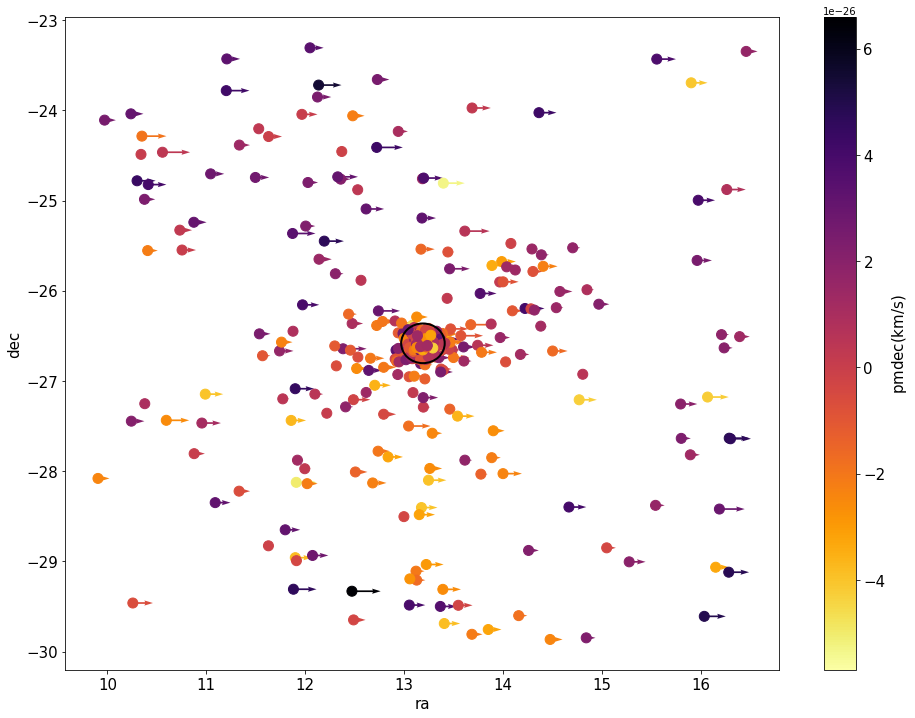

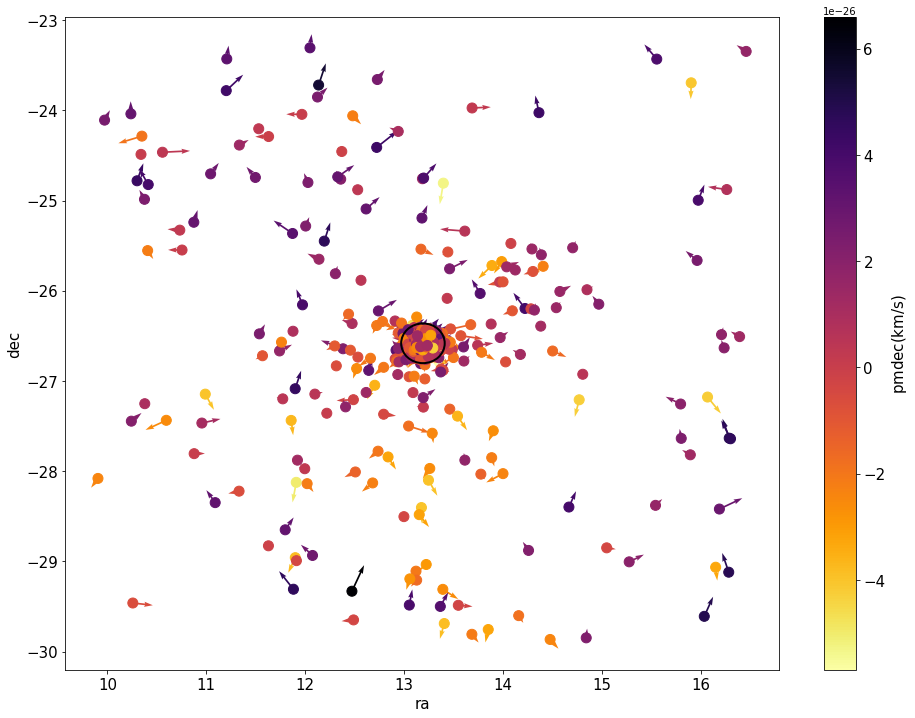

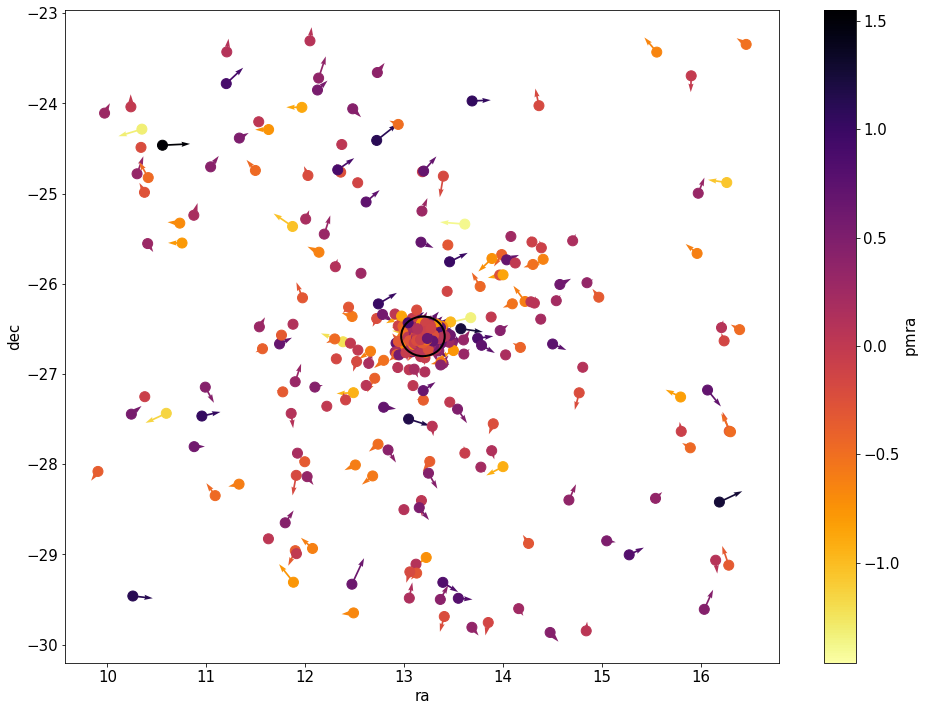

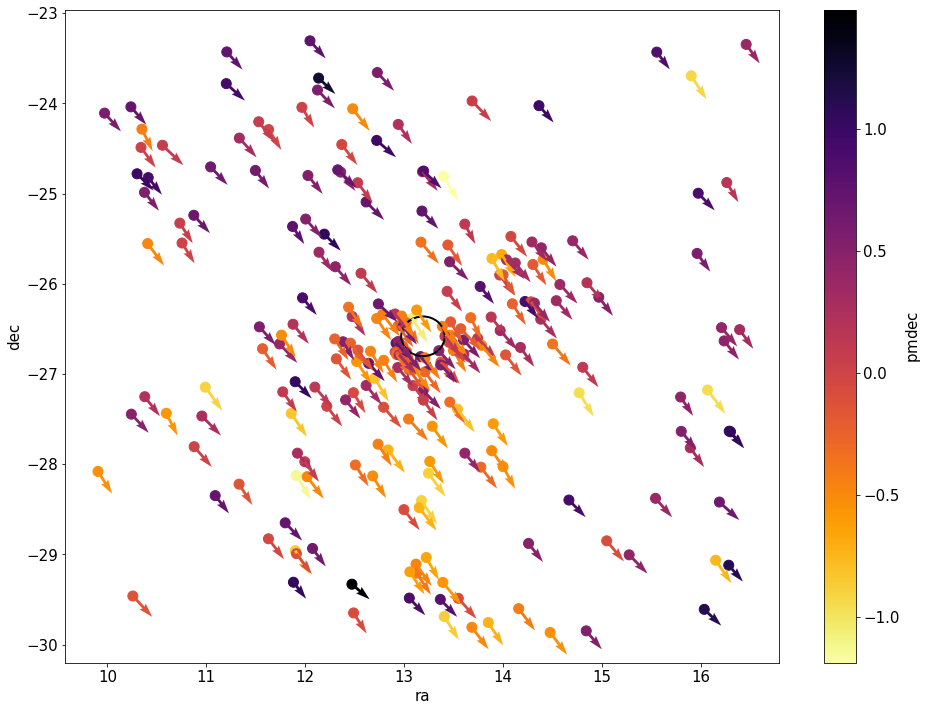

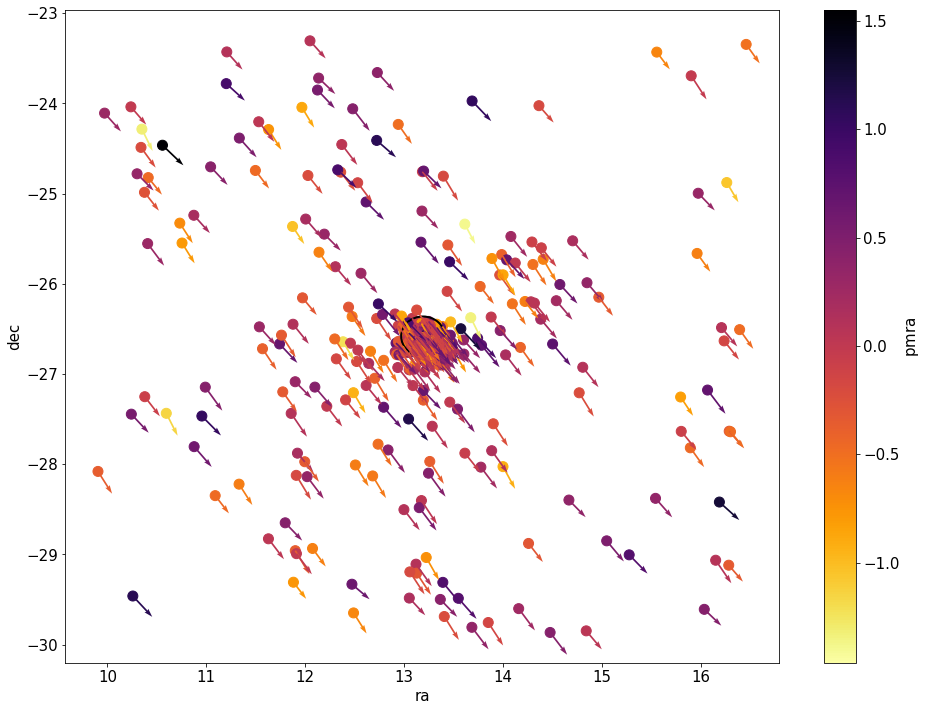

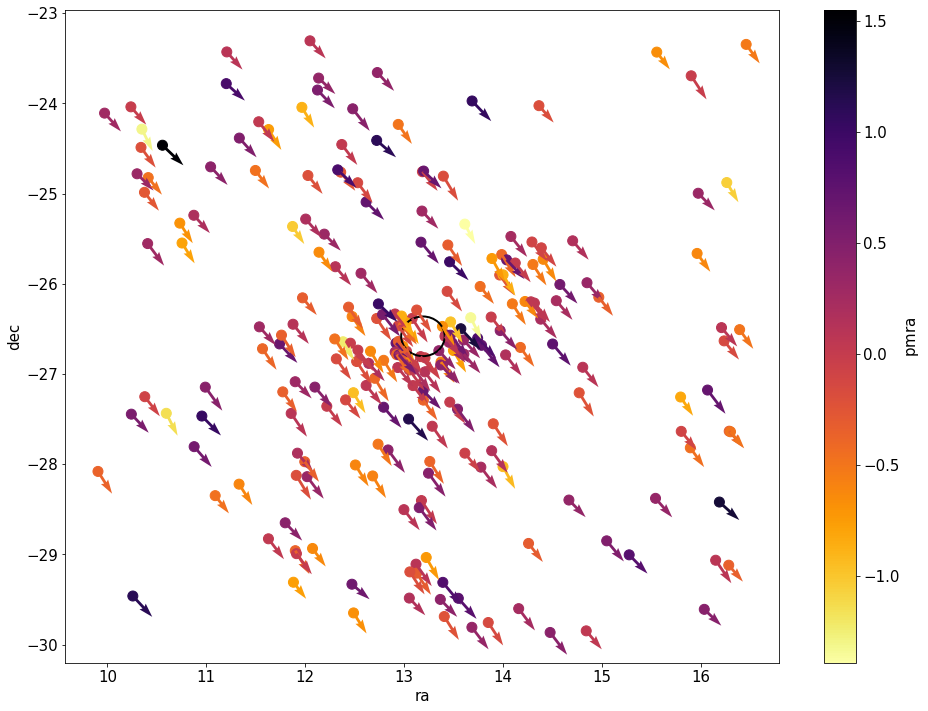

In [68]:
GC_pmra_error = pd.DataFrame({'pmra_error':GlobClust_Log_pmra_error})
GC_pmdec_error = pd.DataFrame({'pmdec_error':GlobClust_Log_pmdec_error})
GC_ra_error = pd.DataFrame({'ra_error':GlobClust_Log_ra_error})
GC_dec_error = pd.DataFrame({'dec_error':GlobClust_Log_dec_error})

ra_error_DB = GC_ra_error.reindex(x_out3.index)
dec_error_DB = GC_dec_error.reindex(y_out3.index)
pmra_error_DB = GC_pmra_error.reindex(x_out3.index)
pmdec_error_DB = GC_pmdec_error.reindex(y_out3.index)

vpu_DB = GlobClust_Log_vpu.reindex(y_out3.index)
aen_DB = GlobClust_Log_aen.reindex(y_out3.index)

a = ra_DB.as_matrix()[:,0]
b = dec_DB.as_matrix()[:,0]
aa = ra_DB[clust_indx].as_matrix()[:,0]
bb = dec_DB[clust_indx].as_matrix()[:,0]
c = pmra_DB_norm.as_matrix()[:,0]#*cos(pmra_DB_norm.as_matrix()[:,0])
d = pmdec_DB_norm.as_matrix()[:,0]#*sin(pmdec_DB_norm.as_matrix()[:,0])
cc = pmra_DB_norm[clust_indx].as_matrix()[:,0]#*cos(pmra_DB_norm.as_matrix()[:,0])
dd = pmdec_DB_norm[clust_indx].as_matrix()[:,0]#*sin(pmdec_DB_norm.as_matrix()[:,0])

angles = tan(pmdec_DB.as_matrix()[:,0]/pmra_DB.as_matrix()[:,0])

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
sc = plt.scatter(ra_DB, dec_DB, c=pmdec_DB_norm, cmap='inferno_r', marker='o', zorder=3, s=100, )#vmin=-1, vmax=1)#vmin=-0.1, vmax=.1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60, color='k', fill=False, lw=2, zorder=4)
ax.add_artist(circle)
Q = plt.quiver(a,b,c,d, pmdec_DB_norm, cmap='inferno_r', angles='xy', scale_units='xy', scale=1.)#, scale=1/0.05, zorder=5)
#qk = plt.quiverkey(Q, 0.9, 0.9, 1, r'$1 \frac{m}{s}$', labelpos='E',coordinates='figure')
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.title('Ra-Dec error bars')
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
fig.show()

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
sc = plt.scatter(ra_DB[clust_indx], dec_DB[clust_indx], c=pmdec_DB_norm[clust_indx], cmap='inferno_r', marker='o', zorder=3, s=100, )#vmin=-1, vmax=1)#vmin=-0.1, vmax=.1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60, color='k', fill=False, lw=2, zorder=4)
ax.add_artist(circle)
Q = plt.quiver(aa,bb,cc,dd, pmdec_DB_norm[clust_indx], cmap='inferno_r', angles='xy', scale_units='xy', scale=1.)#, scale=1/0.05, zorder=5)
#qk = plt.quiverkey(Q, 0.9, 0.9, 1, r'$1 \frac{m}{s}$', labelpos='E',coordinates='figure')
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.title('Ra-Dec error bars')
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
fig.show()

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
sc = plt.scatter(ra_DB, dec_DB, c=pmdec_DB_norm, cmap='inferno_r', marker='o', zorder=3, s=100, )#vmin=-1, vmax=1)#vmin=-0.1, vmax=.1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60, color='k', fill=False, lw=2, zorder=4)
ax.add_artist(circle)
Q = plt.quiver(a,b,c,d, pmdec_DB_norm, cmap='inferno_r', angles=angles, )# angles='xy', scale_units='xy', scale=1)#, scale=1/0.05, zorder=5)
#qk = plt.quiverkey(Q, 0.9, 0.9, 1, r'$1 \frac{m}{s}$', labelpos='E',coordinates='figure')
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.title('Ra-Dec error bars')
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec (mas/yr)}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
fig.show()

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
sc = plt.scatter(ra_DB, dec_DB, c=pmdec_DB_norm, cmap='inferno_r', marker='o', zorder=3, s=100, )#vmin=-1, vmax=1)#vmin=-0.1, vmax=.1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60, color='k', fill=False, lw=2, zorder=4)
ax.add_artist(circle)
Q = plt.quiver(a,b,(pmra_DB_norm/3600000.*np.pi/180./31557600.*3.24077928966636E-14*d_pc).as_matrix()[:,0],
               (pmdec_DB_norm/3600000.*np.pi/180./31557600.*3.24077928966636E-14*d_pc).as_matrix()[:,0], 
               (pmdec_DB_norm/3600000.*np.pi/180./31557600.*3.24077928966636E-14*d_pc).as_matrix()[:,0], 
               cmap='inferno_r', angles='xy', )#scale_units='xy', scale=1)#, scale=1/0.05, zorder=5)
#qk = plt.quiverkey(Q, 0.9, 0.9, 1, r'$1 \frac{m}{s}$', labelpos='E',coordinates='figure')
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.title('Ra-Dec error bars')
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec (km/s)}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
fig.show()

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
sc = plt.scatter(ra_DB, dec_DB, c=pmdec_DB_norm, cmap='inferno_r', marker='o', zorder=3, s=100, )#vmin=-1, vmax=1)#vmin=-0.1, vmax=.1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60, color='k', fill=False, lw=2, zorder=4)
ax.add_artist(circle)
Q = plt.quiver(a,b,c,d, (pmdec_DB_norm/3600000.*np.pi/180./31557600.*3.24077928966636E-14*d_pc).as_matrix()[:,0], 
               cmap='inferno_r', angles='xy', )#scale_units='xy', scale=1)#, scale=1/0.05, zorder=5)
#qk = plt.quiverkey(Q, 0.9, 0.9, 1, r'$1 \frac{m}{s}$', labelpos='E',coordinates='figure')
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.title('Ra-Dec error bars')
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec (km/s)}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
fig.show()

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
sc = plt.scatter(ra_DB, dec_DB, c=pmra_DB_norm, cmap='inferno_r', marker='o', zorder=3, s=100, )#vmin=-1, vmax=1)#vmin=-0.1, vmax=.1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60, color='k', fill=False, lw=2, zorder=4)
ax.add_artist(circle)
Q = plt.quiver(a,b,c,d, pmra_DB_norm, cmap='inferno_r', angles='xy')#, scale=1/0.05, zorder=5)
#qk = plt.quiverkey(Q, 0.9, 0.9, 1, r'$1 \frac{m}{s}$', labelpos='E',coordinates='figure')
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.title('Ra-Dec error bars')
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
fig.show()

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
sc = plt.scatter(x=ra_DB[clust_indx], y=dec_DB[clust_indx], c=pmdec_DB_norm[clust_indx], cmap='inferno_r', marker='o', zorder=3, s=100, )#vmin=-1, vmax=1)#vmin=-0.1, vmax=.1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60, color='k', fill=False, lw=2, zorder=4)
ax.add_artist(circle)
plt.quiver(ra_DB[clust_indx], dec_DB[clust_indx], pmra_DB[clust_indx], pmdec_DB[clust_indx], pmdec_DB_norm[clust_indx], 
           cmap='inferno_r', scale=1/0.005, zorder=5)#, width=0.005)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.title('Ra-Dec error bars')
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
fig.show()


fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
sc = plt.scatter(x=ra_DB, y=dec_DB, c=pmra_DB_norm, cmap='inferno_r', marker='o', zorder=3, s=100, )#vmin=-1, vmax=1)#vmin=-0.1, vmax=.1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60, color='k', fill=False, lw=2, zorder=4)
ax.add_artist(circle)
plt.quiver(ra_DB, dec_DB, pmra_DB, pmdec_DB, pmra_DB_norm, cmap='inferno_r', scale=1/0.005, zorder=5)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.title('Ra-Dec error bars')
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
fig.show()

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
sc = plt.scatter(x=ra_DB[clust_indx], y=dec_DB[clust_indx], c=pmra_DB_norm[clust_indx], cmap='inferno_r', marker='o', zorder=3, s=100, )#vmin=-1, vmax=1)#vmin=-0.1, vmax=.1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60, color='k', fill=False, lw=2, zorder=4)
ax.add_artist(circle)
plt.quiver(ra_DB[clust_indx], dec_DB[clust_indx], pmra_DB[clust_indx], pmdec_DB[clust_indx], pmra_DB_norm[clust_indx], 
           cmap='inferno_r', scale=1/0.005, zorder=5)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.title('Ra-Dec error bars')
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
fig.show()


In [47]:
print(pmdec_DB_norm/3600000.*np.pi/180./31557600.*3.24077928966636E-14*d_pc)

               pmdec
0       5.871301e-27
97      1.965577e-27
216     1.337706e-26
234     5.213421e-27
361    -1.240073e-26
516    -1.993106e-26
659    -2.560814e-27
734     1.165158e-26
752    -5.939593e-27
760    -4.623796e-27
787    -2.830875e-26
1085   -1.224311e-26
1193    4.866694e-27
1259    1.503597e-26
1267   -2.633586e-26
1272   -3.094593e-26
1321    4.190385e-27
1324    2.724337e-26
1385    4.953030e-27
1521    1.958960e-26
1634    2.959462e-27
1715   -2.346781e-27
1738    1.050685e-27
1834   -1.230093e-26
1835   -1.082952e-26
1836    1.137523e-26
2028    1.724034e-26
2037   -2.187943e-26
2064   -2.640200e-26
2280   -2.080099e-26
...              ...
115609  7.827428e-27
115684 -1.720134e-26
115738  1.844739e-27
115793  9.346927e-27
115804 -4.068513e-26
115862 -1.464206e-26
115955  2.521548e-26
115993 -2.172684e-27
116029  1.055251e-26
116201  7.920094e-28
116226 -3.131695e-26
116278  1.277535e-26
116298 -6.575705e-28
116337 -8.844584e-27
116392  2.829609e-26
116533 -3.131

In [15]:
print((2.*u.mas/u.yr*3.*u.kpc).to(u.km/u.s))

UnitConversionError: 'kpc mas / yr' and 'km / s' (speed) are not convertible

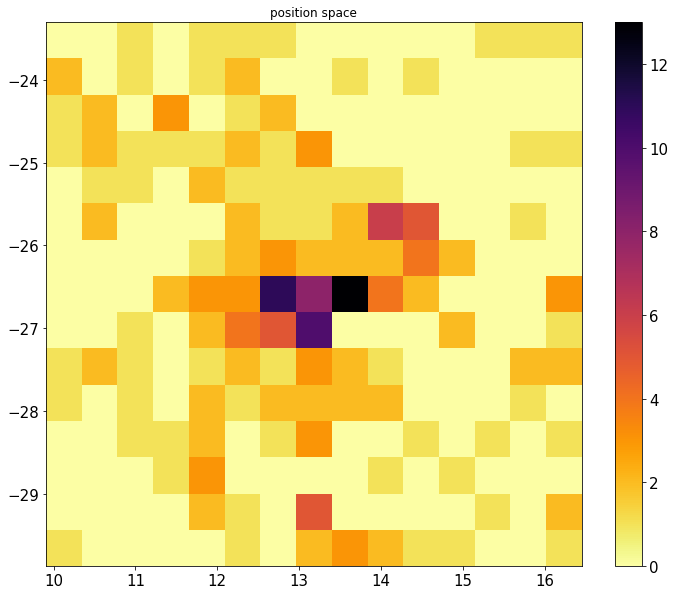

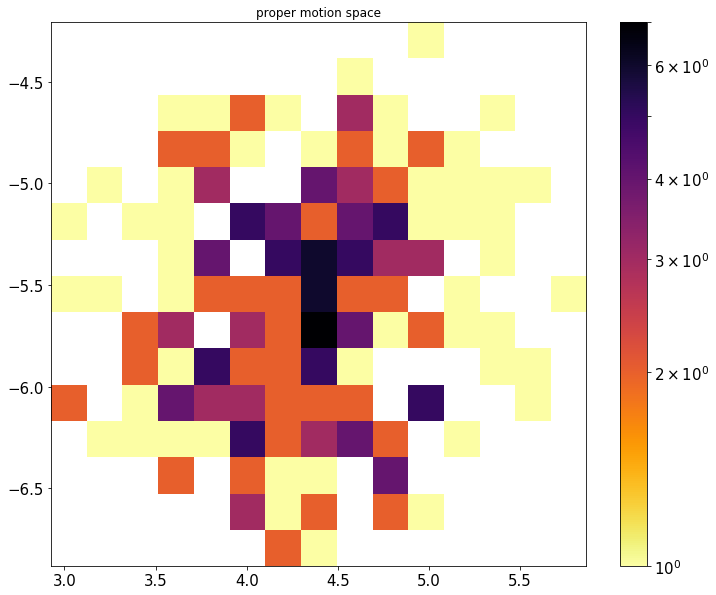

In [49]:
fig=plt.figure(figsize=(12,10))
[h, xedges, yedges, image]=plt.hist2d(ra_DB[clust_indx].dropna().loc[:,"ra"],dec_DB[clust_indx].dropna().loc[:,"dec"], 
                            bins=(15,15), # C=pmdec_DB.dropna().loc[:,"pmdec"],
                            cmap='inferno_r', )#)norm=colors.LogNorm())# ,norm=colors.LogNormalize())#vmin=GlobClust_Log_ra_out.min(), vmax=GlobClust_Log_ra_out.max()))#, normed=True)#, cmin=5, cmax=20)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
plt.gca().tick_params(labelsize=15)
plt.title('position space')
#plt.gca().set_ylim([-26.65,-26.50])
#plt.gca().set_xlim([13.10,13.25])
plt.show()

fig=plt.figure(figsize=(12,10))
[h, xedges, yedges, image]=plt.hist2d(pmra_DB[clust_indx].dropna().loc[:,"pmra"],pmdec_DB[clust_indx].dropna().loc[:,"pmdec"], 
                            bins=(15,15), cmap='inferno_r',
                                      norm=colors.LogNorm(), ) 
                                      #norm=colors.LogNormalize())#vmin=GlobClust_Log_ra_out.min(), vmax=GlobClust_Log_ra_out.max()))#, normed=True)#, cmin=5, cmax=20)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
plt.gca().tick_params(labelsize=15)
plt.title('proper motion space')
#plt.gca().set_ylim([-26.65,-26.50])
#plt.gca().set_xlim([13.10,13.25])
plt.show()

[[ 0.5       -0.8660254]
 [ 0.8660254  0.5      ]]


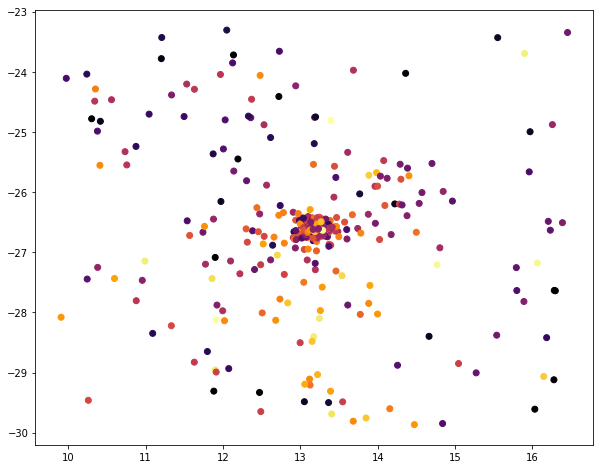

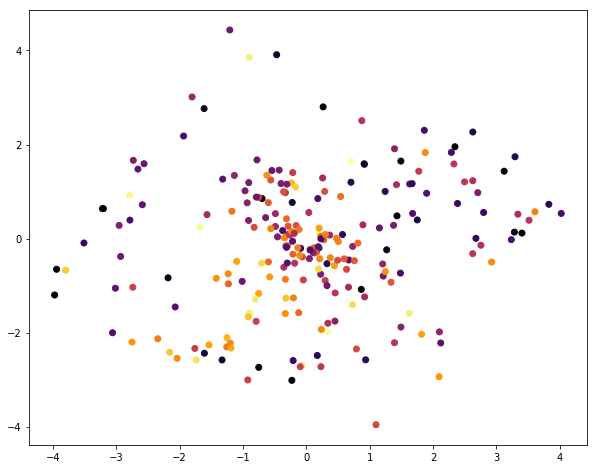

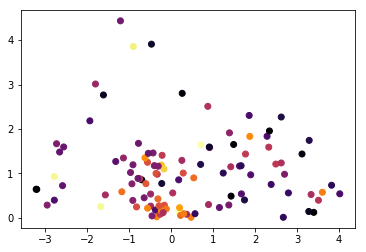

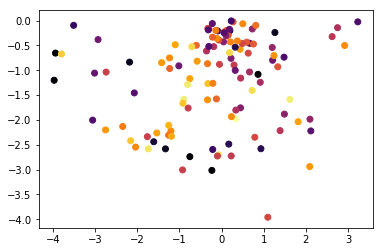

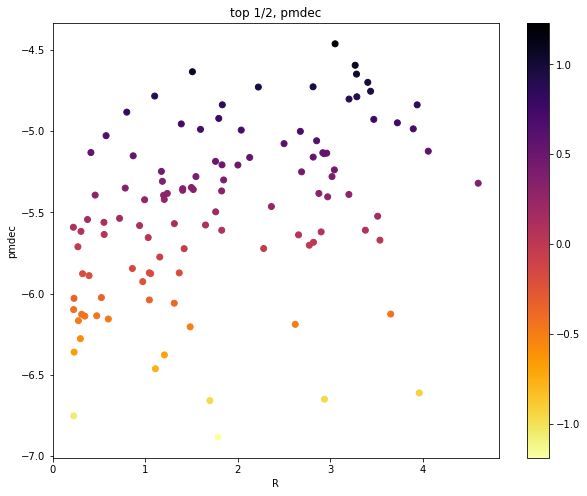

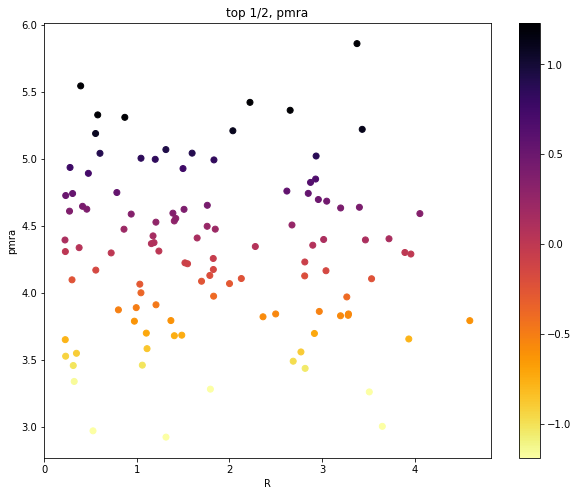

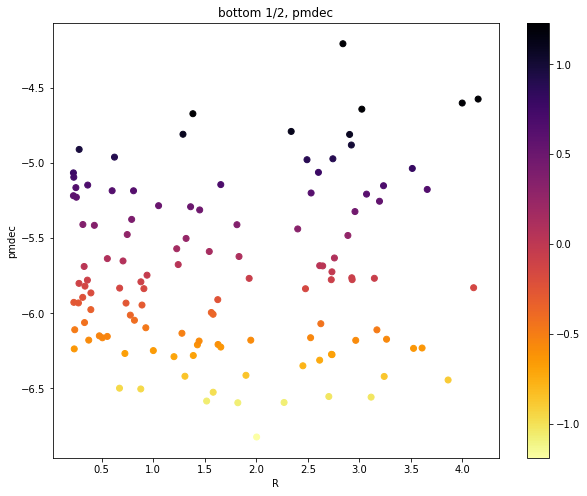

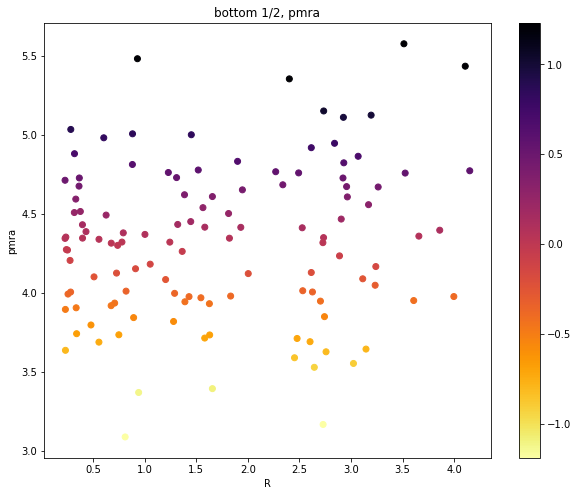

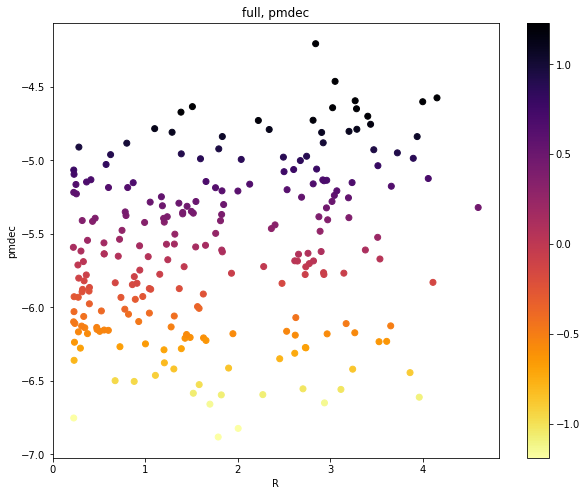

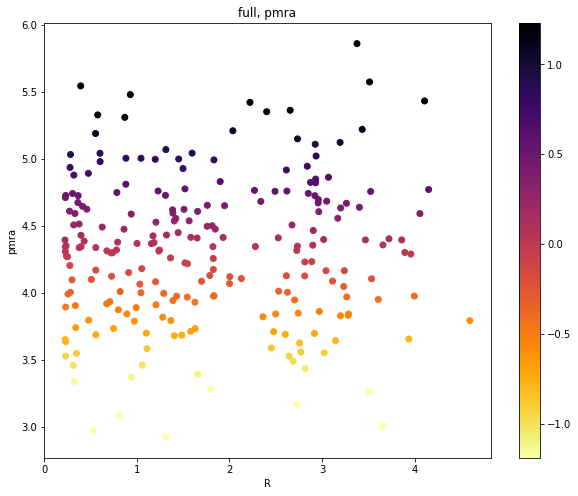

In [51]:
pmra_DB_norm = (pmra_DB-pmra_DB.mean())#/(pmra_DB.mean())
pmdec_DB_norm = (pmdec_DB-pmdec_DB.mean())#/(pmdec_DB.mean())

theta = np.radians(60)
c, s = np.cos(theta), np.sin(theta)
Rot = np.array(((c,-s), (s, c)))
print(Rot) 

ra_DB_c = ra_DB[clust_indx]-coord_ra_dec.ra.deg
dec_DB_c = dec_DB[clust_indx]-coord_ra_dec.dec.deg

ra_dec = ra_DB_c.join(dec_DB_c)#pd.DataFrame({'ra': ra_DB-coord_ra_dec.ra.deg, 'dec': dec_DB-coord_ra_dec.dec.deg})
shape(ra_dec)
ra_dec.T
ra_dec_rot=ra_dec.dot(Rot)
#np.transpose([data_pd.loc[:,"ra"],data_pd.loc[:,"dec"]])*Rot 

plt.figure(figsize=(10,8))
#plt.scatter(ra_dec_rot.loc[:,1], ra_dec_rot.loc[:,0], c=pmdec_DB_norm, cmap='inferno_r', vmin=-1, vmax=1)
plt.scatter(ra_DB, dec_DB, c=pmdec_DB_norm, cmap='inferno_r', vmin=-1, vmax=1)

plt.figure(figsize=(10,8))
plt.scatter(ra_dec_rot.loc[:,1], ra_dec_rot.loc[:,0], c=pmdec_DB_norm[clust_indx], cmap='inferno_r', vmin=-1, vmax=1)
#plt.scatter(ra_DB, dec_DB, c=pmdec_DB_norm, cmap='inferno_r', vmin=-1, vmax=1)

top_indx = (ra_dec_rot.loc[:,0] > 0)
bot_indx = (ra_dec_rot.loc[:,0] < 0)

plt.figure()
plt.scatter(ra_dec_rot.loc[:,1][top_indx], ra_dec_rot.loc[:,0][top_indx], c=pmdec_DB_norm[clust_indx][top_indx], cmap='inferno_r', vmin=-1, vmax=1)

fig=plt.figure()
plt.scatter(ra_dec_rot.loc[:,1][bot_indx], ra_dec_rot.loc[:,0][bot_indx], c=pmdec_DB_norm[clust_indx][bot_indx], cmap='inferno_r', vmin=-1, vmax=1)


R_clust = np.sqrt((np.fabs(ra_dec_rot.loc[:,0]))**2+(np.fabs(ra_dec_rot.loc[:,1])**2))

plt.figure(figsize=(10,8))
sc=plt.scatter(R_clust[top_indx], pmdec_DB[clust_indx][top_indx], c=pmdec_DB_norm[clust_indx][top_indx], cmap='inferno_r')#, vmin=-1, vmax=1)
#a,b,c=plt.errorbar(R_clust[top_indx],pmdec_DB[clust_indx][top_indx].as_matrix(), 
#                   yerr=pmdec_error_DB[clust_indx][top_indx].as_matrix()[:,0], linestyle="None", zorder=1) #ecolor=pmdec_DB_norm,
plt.colorbar(sc)
#pmdec_colour = cb.to_rgba(pmdec_DB_norm[clust_indx][top_indx].as_matrix()[:,0])
#c[0].set_color(pmdec_colour)
plt.title('top 1/2, pmdec')
plt.xlabel('R')
plt.ylabel('pmdec')


plt.figure(figsize=(10,8))
plt.scatter(R_clust[top_indx], pmra_DB[clust_indx][top_indx], c=pmra_DB_norm[clust_indx][top_indx], cmap='inferno_r', vmin=-1, vmax=1)
#a,b,c=plt.errorbar(R_clust[top_indx],pmra_DB[clust_indx][top_indx].as_matrix(), 
#                   yerr=pmra_error_DB[clust_indx][top_indx].as_matrix()[:,0], linestyle="None", zorder=1) #ecolor=pmdec_DB_norm,
plt.colorbar(sc)
#pmra_colour = cb.to_rgba(pmra_DB_norm[clust_indx][top_indx].as_matrix()[:,0])
#c[0].set_color(pmra_colour)
plt.title('top 1/2, pmra')
plt.xlabel('R')
plt.ylabel('pmra')

plt.figure(figsize=(10,8))
plt.scatter(R_clust[bot_indx], pmdec_DB[clust_indx][bot_indx], c=pmdec_DB_norm[clust_indx][bot_indx], cmap='inferno_r', vmin=-1, vmax=1)
#a,b,c=plt.errorbar(R_clust[bot_indx],pmdec_DB[clust_indx][bot_indx].as_matrix(), 
#                   yerr=pmdec_error_DB[clust_indx][bot_indx].as_matrix()[:,0], linestyle="None", zorder=1) #ecolor=pmdec_DB_norm,
plt.colorbar(sc)
#pmdec_colour = cb.to_rgba(pmdec_DB_norm[clust_indx][bot_indx].as_matrix()[:,0])
#c[0].set_color(pmdec_colour)
plt.title('bottom 1/2, pmdec')
plt.xlabel('R')
plt.ylabel('pmdec')

plt.figure(figsize=(10,8))
plt.scatter(R_clust[bot_indx], pmra_DB[clust_indx][bot_indx], c=pmra_DB_norm[clust_indx][bot_indx], cmap='inferno_r', vmin=-1, vmax=1)
#a,b,c=plt.errorbar(R_clust[bot_indx],pmra_DB[clust_indx][bot_indx].as_matrix(), 
#                   yerr=pmra_error_DB[clust_indx][bot_indx].as_matrix()[:,0], linestyle="None", zorder=1) #ecolor=pmdec_DB_norm,
plt.colorbar(sc)
#pmra_colour = cb.to_rgba(pmra_DB_norm[clust_indx][bot_indx].as_matrix()[:,0])
#c[0].set_color(pmra_colour)
plt.title('bottom 1/2, pmra')
plt.xlabel('R')
plt.ylabel('pmra')

plt.figure(figsize=(10,8))
plt.scatter(R_clust, pmdec_DB[clust_indx], c=pmdec_DB_norm[clust_indx], cmap='inferno_r', vmin=-1, vmax=1)
#a,b,c=plt.errorbar(R_clust,pmdec_DB[clust_indx].as_matrix(), yerr=pmdec_error_DB[clust_indx].as_matrix()[:,0], linestyle="None", zorder=1) #ecolor=pmdec_DB_norm,
plt.colorbar(sc)
#pmdec_colour = cb.to_rgba(pmdec_DB_norm[clust_indx][top_indx].as_matrix()[:,0])
#c[0].set_color(pmdec_colour)
plt.title('full, pmdec')
plt.xlabel('R')
plt.ylabel('pmdec')

plt.figure(figsize=(10,8))
plt.scatter(R_clust, pmra_DB[clust_indx], c=pmra_DB_norm[clust_indx], cmap='inferno_r', vmin=-1, vmax=1)
#a,b,c=plt.errorbar(R_clust,pmra_DB[clust_indx].as_matrix(), yerr=pmra_error_DB[clust_indx].as_matrix()[:,0], linestyle="None", zorder=1) #ecolor=pmdec_DB_norm,
plt.colorbar(sc)
#pmra_colour = cb.to_rgba(pmra_DB_norm[clust_indx][top_indx].as_matrix()[:,0])
#c[0].set_color(pmra_colour)
plt.title('full, pmra')
plt.xlabel('R')
plt.ylabel('pmra')

In [11]:
shape(clust_indx)
clust_indx.sum()

#ra_DB[clust_indx]

231

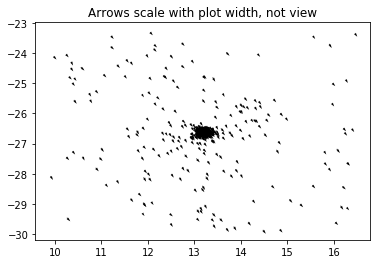

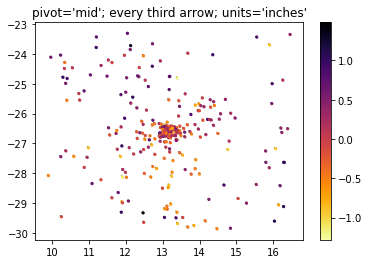

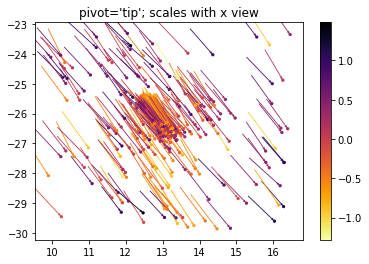

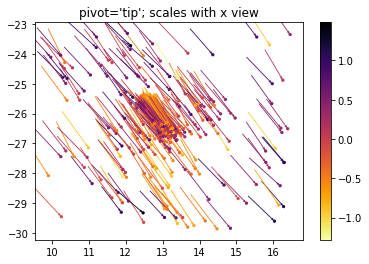

In [12]:
from numpy import ma

#pmra_kde_1 = 0-10 
#pmra_kde_2 = 0+10
#pmdec_kde_1 = 0-10
#pmdec_kde_2 = 0+10

#ra_kde_1 = coord_ra_dec.ra.deg-r_t/60*15
#ra_kde_2 = coord_ra_dec.ra.deg+r_t/60*15
#dec_kde_1 = coord_ra_dec.dec.deg-r_t/60*15
#dec_kde_2 = coord_ra_dec.dec.deg+r_t/60*15

W, Z = np.meshgrid(np.arange(ra_kde_1, ra_kde_2, .5), np.arange(dec_kde_1, dec_kde_2, .5))
X = ra_DB
Y = dec_DB
U = pmra_DB
V = pmdec_DB

plt.figure()
plt.title('Arrows scale with plot width, not view')
Q = plt.quiver(X, Y, U, V, units='width')
#qk = plt.quiverkey(Q, 0.9, 0.9, 2, r'$2 \frac{m}{s}$', labelpos='E',
#                   coordinates='figure')

plt.figure()
plt.title("pivot='mid'; every third arrow; units='inches'")
Q = plt.quiver(X, Y, U, V,
               pivot='mid', units='inches')
#qk = plt.quiverkey(Q, 0.9, 0.9, 1, r'$1 \frac{m}{s}$', labelpos='E',
#                   coordinates='figure')
plt.scatter(X, Y, c=pmdec_DB_norm, cmap='inferno_r', s=5)
plt.colorbar()

plt.figure()
plt.title("pivot='tip'; scales with x view")
M = np.hypot(U, V)
Q = plt.quiver(X, Y, U, V, pmdec_DB_norm, cmap='inferno_r', units='x', pivot='tip', width=0.022,
              scale=1 / 0.15)
#qk = plt.quiverkey(Q, 0.9, 0.9, 1, r'$1 \frac{m}{s}$', labelpos='E',
#                   coordinates='figure')
sc = plt.scatter(X, Y, c=pmdec_DB_norm, cmap='inferno_r', s=5)
plt.colorbar(sc)

plt.figure()
plt.title("pivot='tip'; scales with x view")
M = np.hypot(U, V)
Q = plt.quiver(X, Y, U, V, pmdec_DB_norm, cmap='inferno_r', units='x', pivot='tip', width=0.022,
              scale=1 / 0.15)
#qk = plt.quiverkey(Q, 0.9, 0.9, 1, r'$1 \frac{m}{s}$', labelpos='E',
#                   coordinates='figure')
sc = plt.scatter(X, Y, c=pmdec_DB_norm, cmap='inferno_r', s=5)
plt.colorbar(sc)



#plt.figure()
#plt.title("pivot='mid'; every third arrow; units='inches'")
#Q = plt.quiver(W[::3, ::3], Z[::3, ::3], U[::3, ::3], V[::3, ::3],
#               pivot='mid', units='inches')
##qk = plt.quiverkey(Q, 0.9, 0.9, 1, r'$1 \frac{m}{s}$', labelpos='E',
##                   coordinates='figure')
#plt.scatter(W[::3, ::3], Z[::3, ::3], color='r', s=5)

plt.show()



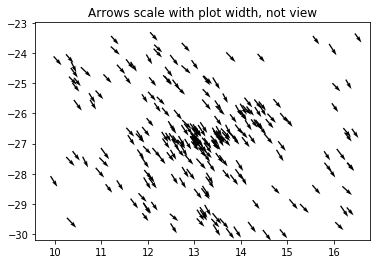

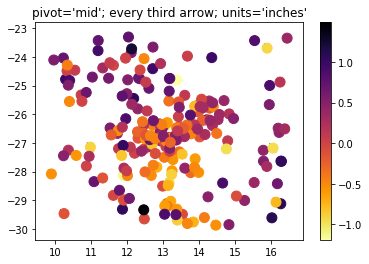

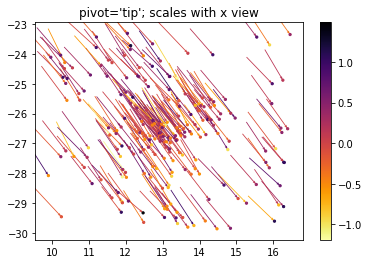

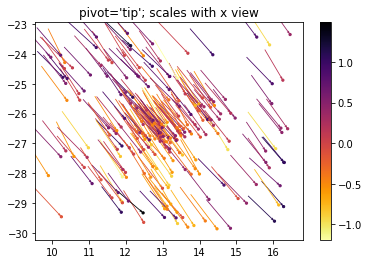

In [13]:
from numpy import ma

#pmra_kde_1 = 0-10 
#pmra_kde_2 = 0+10
#pmdec_kde_1 = 0-10
#pmdec_kde_2 = 0+10

#ra_kde_1 = coord_ra_dec.ra.deg-r_t/60*15
#ra_kde_2 = coord_ra_dec.ra.deg+r_t/60*15
#dec_kde_1 = coord_ra_dec.dec.deg-r_t/60*15
#dec_kde_2 = coord_ra_dec.dec.deg+r_t/60*15

W, Z = np.meshgrid(np.arange(ra_kde_1, ra_kde_2, .5), np.arange(dec_kde_1, dec_kde_2, .5))
X = ra_DB[clust_indx].as_matrix()
Y = dec_DB[clust_indx].as_matrix()
U = pmra_DB.as_matrix()[clust_indx]
V = pmdec_DB.as_matrix()[clust_indx]

plt.figure()
plt.title('Arrows scale with plot width, not view')
Q = plt.quiver(X, Y, U, V, units='width')
#qk = plt.quiverkey(Q, 0.9, 0.9, 2, r'$2 \frac{m}{s}$', labelpos='E',
#                   coordinates='figure')

plt.figure()
plt.title("pivot='mid'; every third arrow; units='inches'")
Q = plt.quiver(X, Y, U, V,
               pivot='mid', units='inches')
#qk = plt.quiverkey(Q, 0.9, 0.9, 1, r'$1 \frac{m}{s}$', labelpos='E',
#                   coordinates='figure')
plt.scatter(X, Y, c=pmdec_DB_norm[clust_indx], cmap='inferno_r', s=100)
plt.colorbar()

plt.figure()
plt.title("pivot='tip'; scales with x view")
M = np.hypot(U, V)
Q = plt.quiver(X, Y, U, V, pmdec_DB_norm, cmap='inferno_r', units='x', pivot='tip', width=0.022,
              scale=1 / 0.15)
#qk = plt.quiverkey(Q, 0.9, 0.9, 1, r'$1 \frac{m}{s}$', labelpos='E',
#                   coordinates='figure')
sc = plt.scatter(X, Y, c=pmdec_DB_norm[clust_indx], cmap='inferno_r', s=5)
plt.colorbar(sc)

plt.figure()
plt.title("pivot='tip'; scales with x view")
M = np.hypot(U, V)
Q = plt.quiver(X, Y, U, V, pmdec_DB_norm[clust_indx], cmap='inferno_r', units='x', pivot='tip', width=0.022,
              scale=1 / 0.15)
#qk = plt.quiverkey(Q, 0.9, 0.9, 1, r'$1 \frac{m}{s}$', labelpos='E',
#                   coordinates='figure')
sc = plt.scatter(X, Y, c=pmdec_DB_norm[clust_indx], cmap='inferno_r', s=5)
plt.colorbar(sc)



#plt.figure()
#plt.title("pivot='mid'; every third arrow; units='inches'")
#Q = plt.quiver(W[::3, ::3], Z[::3, ::3], U[::3, ::3], V[::3, ::3],
#               pivot='mid', units='inches')
##qk = plt.quiverkey(Q, 0.9, 0.9, 1, r'$1 \frac{m}{s}$', labelpos='E',
##                   coordinates='figure')
#plt.scatter(W[::3, ::3], Z[::3, ::3], color='r', s=5)

plt.show()



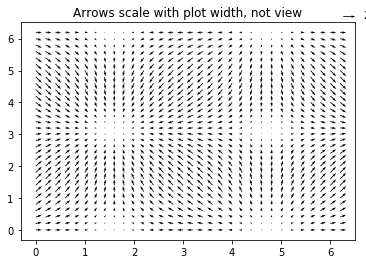

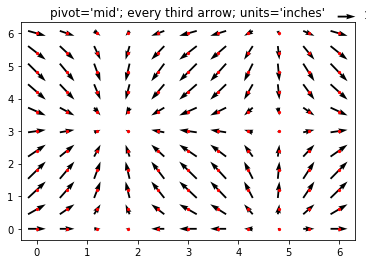

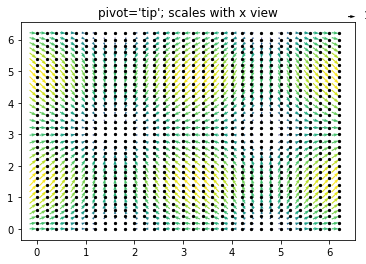

In [14]:
from numpy import ma

X, Y = np.meshgrid(np.arange(0, 2 * np.pi, .2), np.arange(0, 2 * np.pi, .2))
U = np.cos(X)
V = np.sin(Y)

plt.figure()
plt.title('Arrows scale with plot width, not view')
Q = plt.quiver(X, Y, U, V, units='width')
qk = plt.quiverkey(Q, 0.9, 0.9, 2, r'$2 \frac{m}{s}$', labelpos='E',
                   coordinates='figure')

plt.figure()
plt.title("pivot='mid'; every third arrow; units='inches'")
Q = plt.quiver(X[::3, ::3], Y[::3, ::3], U[::3, ::3], V[::3, ::3],
               pivot='mid', units='inches')
qk = plt.quiverkey(Q, 0.9, 0.9, 1, r'$1 \frac{m}{s}$', labelpos='E',
                   coordinates='figure')
plt.scatter(X[::3, ::3], Y[::3, ::3], color='r', s=5)

plt.figure()
plt.title("pivot='tip'; scales with x view")
M = np.hypot(U, V)
Q = plt.quiver(X, Y, U, V, M, units='x', pivot='tip', width=0.022,
               scale=1 / 0.15)
qk = plt.quiverkey(Q, 0.9, 0.9, 1, r'$1 \frac{m}{s}$', labelpos='E',
                   coordinates='figure')
plt.scatter(X, Y, color='k', s=5)

plt.show()


(1758, 1)
/home/kaderali/.local/lib/python3.6/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  unsupported[op_str]))

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:57: RuntimeWarning: divide by zero encountered in log



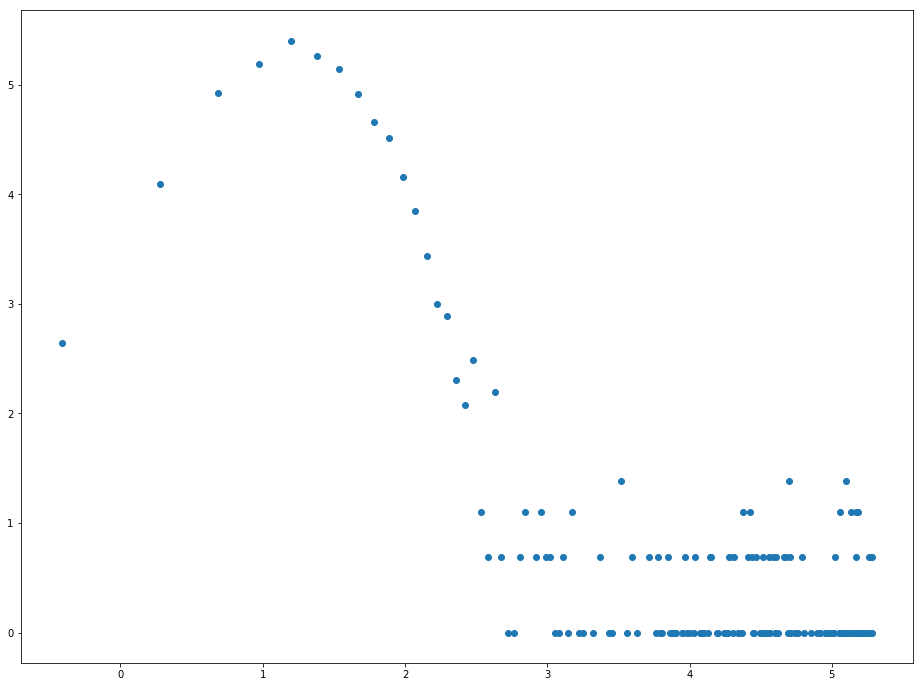

In [15]:
#ra_DB2-coord_ra_dec.ra.deg
x_out3_2 = pd.DataFrame(x_param3)#, index=None)#, mangle_dupe_cols=True)
#x_out3.reset_index()
x_out3_2 = x_out3_2.transpose() 
x_out3_2 = x_out3_2.loc[:,~x_out3_2.columns.duplicated()]
#x_out3 = x_out3["rpbp"].as_matrix()
x_out3_2

y_out3_2 = pd.DataFrame(y_param3)#, index=None)#, mangle_dupe_cols=True)
#y_out3.reset_index()
y_out3_2 = y_out3_2.transpose() 
y_out3_2 = y_out3_2.loc[:,~y_out3_2.columns.duplicated()]
#y_out3 = y_out3["M"].as_matrix()
print(shape(y_out3_2))

ra_DB2 = GlobClust_Log_ra_out.reindex(x_out3_2.index)
dec_DB2 = GlobClust_Log_dec_out.reindex(y_out3_2.index)
pmra_DB2 = GlobClust_Log_pmra_out.reindex(x_out3_2.index)
pmdec_DB2 = GlobClust_Log_pmdec_out.reindex(y_out3_2.index)
rpbp_DB2 = GlobClust_Log_rpbp.reindex(x_out3_2.index)
M_DB2 = GlobClust_Log_M.reindex(y_out3_2.index)

#radii=linspace(0, ra_DB.max(),3)

radii=linspace(0, 15*GlobClust_Log_r_t[0]/60, 300)

c_a = []

for i in range(1,len(radii)):
    indx_r = (sqrt((np.fabs(ra_DB2-coord_ra_dec.ra.deg)**2)+\
                  np.fabs(dec_DB2-coord_ra_dec.dec.deg)**2)<radii[i])*\
    (sqrt((np.fabs(ra_DB2-coord_ra_dec.ra.deg)**2+\
                  np.fabs(dec_DB2-coord_ra_dec.dec.deg)**2))>radii[i-1])
    
    ra_count = len(ra_DB2[indx_r])
    dec_count = len(dec_DB2[indx_r])
    
    r_area_outer = np.pi*radii[i]**2
    r_area_inner = np.pi*radii[i-1]**2
    r_area_ring = r_area_outer-r_area_inner
    
    count_area = ra_count#/r_area_ring
    count_area2 = dec_count#/r_area_ring
    #print('debug',count_area)
    c_a = append(c_a, count_area)
    
    #print([i], [radii[i]],': ', r_area, count_area, count_area2)


#radius=radii[indx]*60

#fig=plt.figure(figsize(16,12))
#plt.scatter(radii[1:]*60,c_a)
#ax = plt.gca()
#circle = plt.Circle((0, 0), 0.1, color='k', fill=False, lw=2)
#ax.add_artist(circle)
#plt.show()

fig=plt.figure(figsize(16,12))
plt.scatter(log(radii[1:]*60),log(c_a[~numpy.isnan(c_a)]))
ax = plt.gca()
#circle = plt.Circle((0, 0), 0.1, color='k', fill=False, lw=2)
#ax.add_artist(circle)
plt.show()
    
    

/home/kaderali/.local/lib/python3.6/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  unsupported[op_str]))



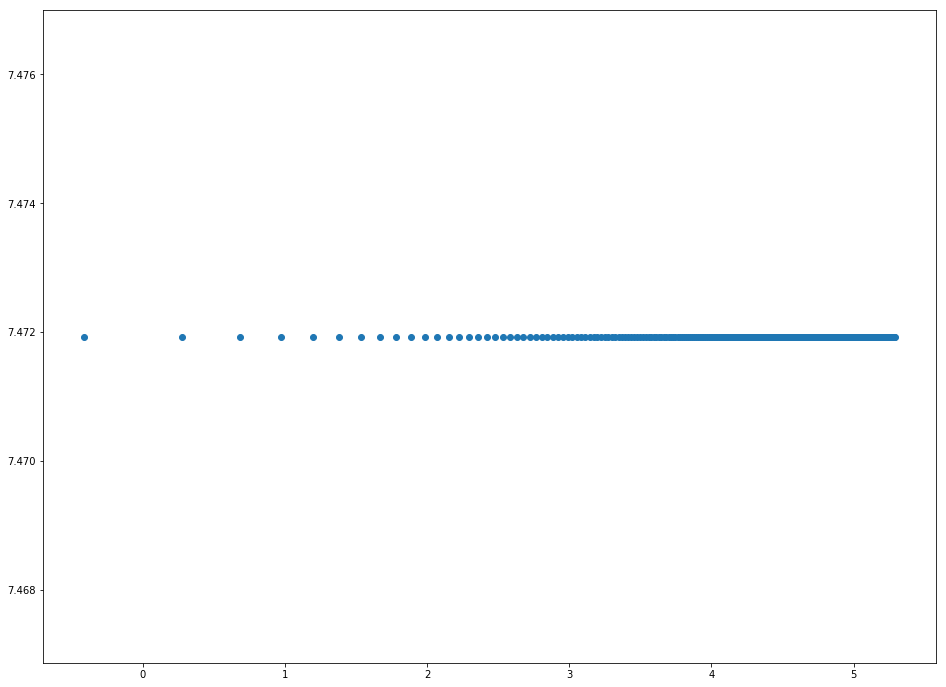

In [16]:
radii=linspace(0, 15*GlobClust_Log_r_t[0]/60, 300)

c_a = []

for i in range(1,len(radii)):
    indx_r = (sqrt((np.fabs(ra_DB-coord_ra_dec.ra.deg)**2)+\
                  np.fabs(dec_DB-coord_ra_dec.dec.deg)**2)<radii[i])*\
    (sqrt((np.fabs(ra_DB-coord_ra_dec.ra.deg)**2+\
                  np.fabs(dec_DB-coord_ra_dec.dec.deg)**2))>radii[i-1])
    
    ra_count = len(ra_DB[indx_r])
    dec_count = len(dec_DB[indx_r])
    
    r_area_outer = np.pi*radii[i]**2
    r_area_inner = np.pi*radii[i-1]**2
    r_area_ring = r_area_outer-r_area_inner
    
    count_area = ra_count#/r_area_ring
    count_area2 = dec_count#/r_area_ring
    #print('debug',count_area)
    c_a = append(c_a, count_area)
    
    #print([i], [radii[i]],': ', r_area, count_area, count_area2)


#radius=radii[indx]*60

#fig=plt.figure(figsize(16,12))
#plt.scatter(radii[1:]*60,c_a)
#ax = plt.gca()
#circle = plt.Circle((0, 0), 0.1, color='k', fill=False, lw=2)
#ax.add_artist(circle)
#plt.show()

fig=plt.figure(figsize(16,12))
plt.scatter(log(radii[1:]*60),log(c_a[~numpy.isnan(c_a)]))
ax = plt.gca()
#circle = plt.Circle((0, 0), 0.1, color='k', fill=False, lw=2)
#ax.add_artist(circle)
plt.show()
    
    

/usr/local/lib/python3.6/site-packages/matplotlib/figure.py:403: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "



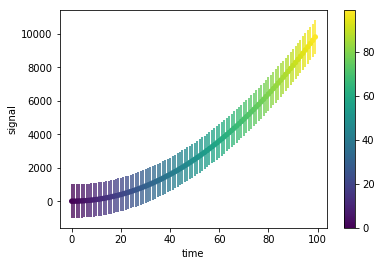

In [66]:
from pylab import *

#data
time = arange(100.)
signal = time**2
error = ones(len(time))*1000

figure(1)
#create a scatter plot
sc = scatter(time,signal,s=20,c=time)

#create colorbar according to the scatter plot
clb = colorbar(sc)

#create errorbar plot and return the outputs to a,b,c
a,b,c = errorbar(time,signal,yerr=error,marker='',ls='',zorder=0)

#convert time to a color tuple using the colormap used for scatter
time_color = clb.to_rgba(time)

#adjust the color of c[0], which is a LineCollection, to the colormap
c[0].set_color(time_color)

fig = gcf()
fig.show()
xlabel('time')
ylabel('signal')

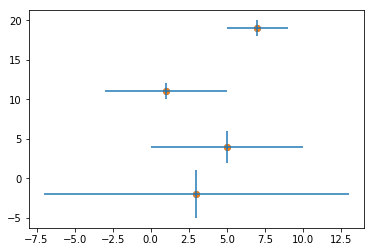

[[0.33164411]
 [0.15800023]
 [0.19629652]
 ...
 [0.26294349]
 [0.39160969]
 [0.16302945]] [[0.23708382]
 [0.11811063]
 [0.1525218 ]
 ...
 [0.17764286]
 [0.28384507]
 [0.11928552]]
(1511, 1) (1511, 1) (1511, 1) (1511, 1)


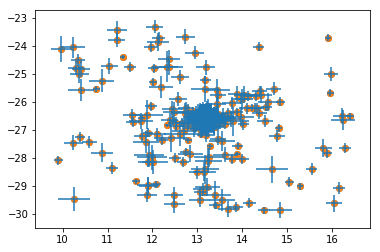

[[0.57464508]
 [0.27233543]
 [0.33395956]
 ...
 [0.47747239]
 [0.64800784]
 [0.30192137]] [[0.44351168]
 [0.23818287]
 [0.28944656]
 ...
 [0.34498164]
 [0.53476033]
 [0.23018732]]
(1511, 1) (1511, 1) (1511, 1) (1511, 1)


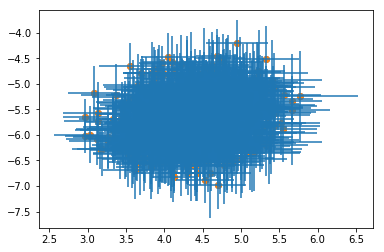

In [45]:
#import matplotlib.pyplot as plt
a = [1,3,5,7]
b = [11,-2,4,19]
plt.scatter(a,b)
plt.scatter(a,b)
#plt.show()
c = [1,3,2,1]
d = [4,10,5,2]
plt.errorbar(a,b,yerr=c, xerr=d, linestyle="None")
plt.show()
#import matplotlib.pyplot as plt
a = ra_DB.as_matrix()
b = dec_DB.as_matrix()
plt.scatter(a[:,0],b[:,0])
plt.scatter(a[:,0],b[:,0])
#plt.show()
c = ra_error_DB.as_matrix()
d = dec_error_DB.as_matrix()
print(c,d)
print(shape(a),shape(b), shape(c), shape(d))
plt.errorbar(a[:,0],b[:,0],yerr=c[:,0], xerr=d[:,0], linestyle="None")
plt.show()

a = pmra_DB.as_matrix()
b = pmdec_DB.as_matrix()
plt.scatter(a[:,0],b[:,0])
plt.scatter(a[:,0],b[:,0])
#plt.show()
c = pmra_error_DB.as_matrix()
d = pmdec_error_DB.as_matrix()
print(c,d)
print(shape(a),shape(b), shape(c), shape(d))
plt.errorbar(a[:,0],b[:,0],yerr=c[:,0], xerr=d[:,0], linestyle="None")
plt.show()

In [31]:
shape(ra_error_DB)

(1511, 1)

/home/kaderali/.local/lib/python3.6/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  unsupported[op_str]))

(19049, 4)
[-1 -1 -1 ... -1 -1 -1]
(19049,)
Estimated number of Subgroups: 3


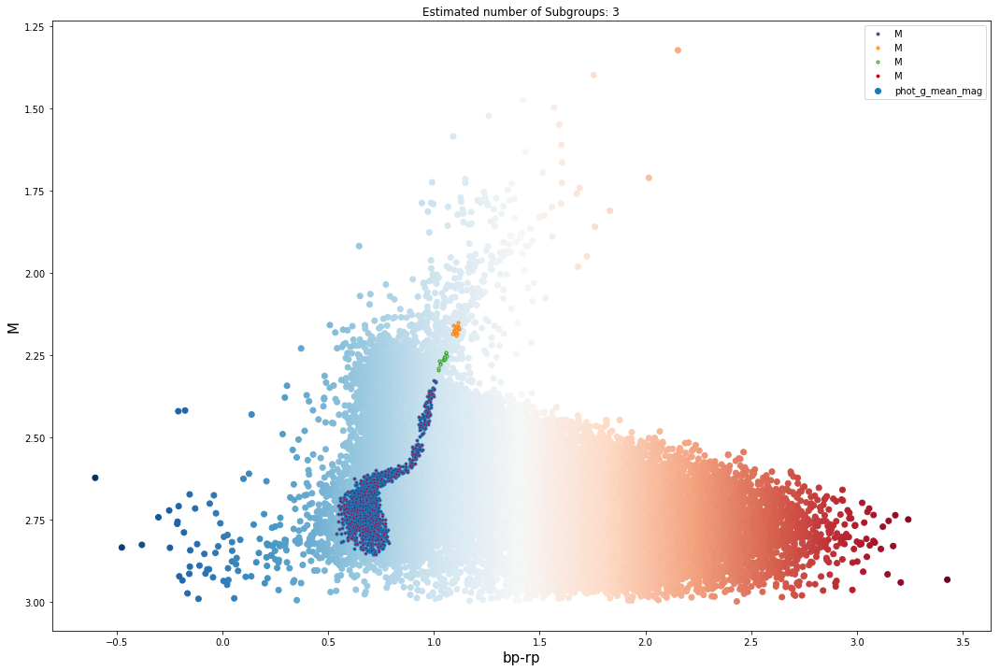

(1511, 1)

 pmra    4.351847
dtype: float64 


 pmdec   -5.675561
dtype: float64


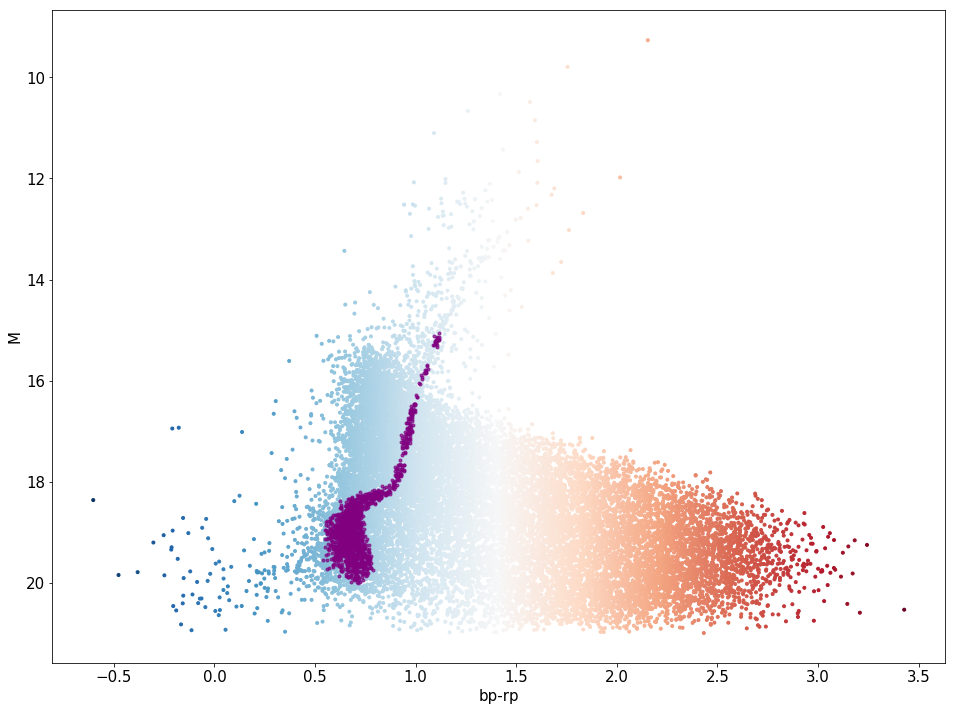

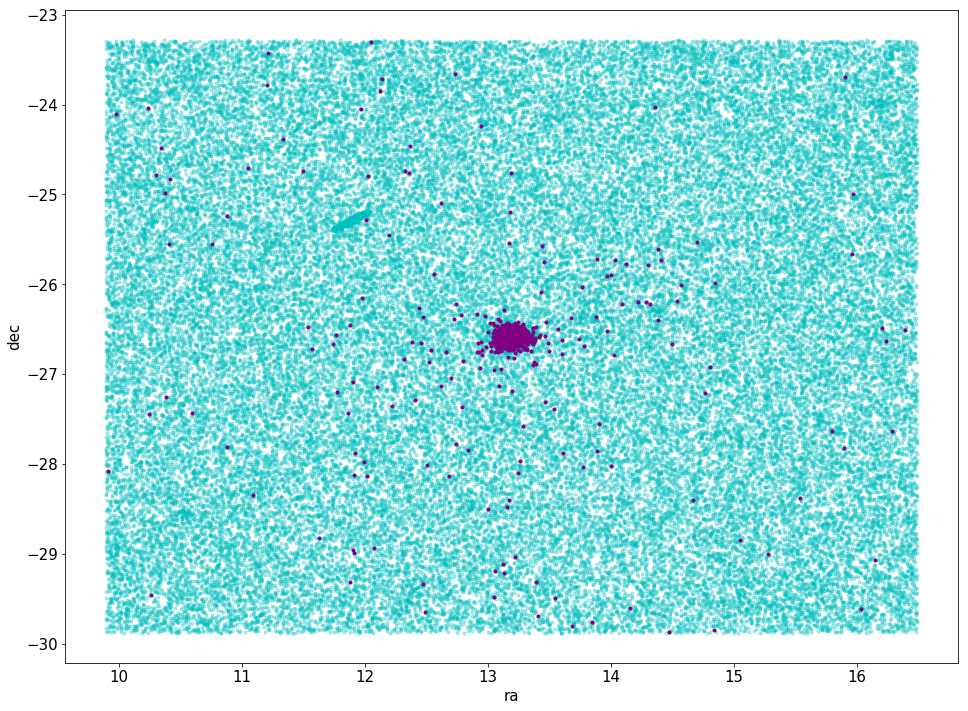

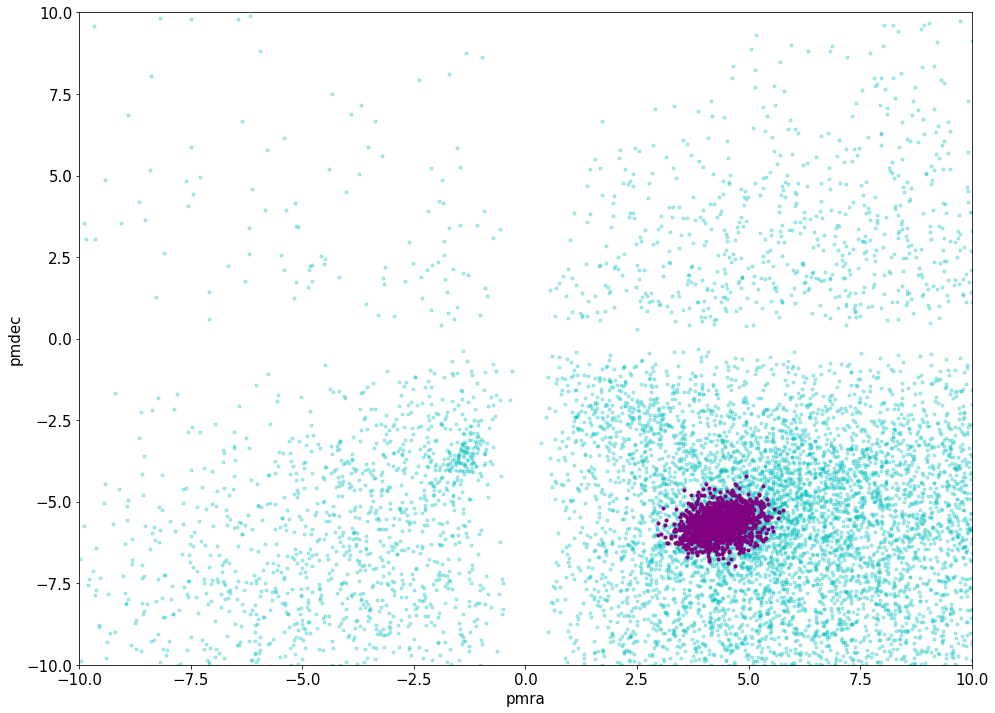

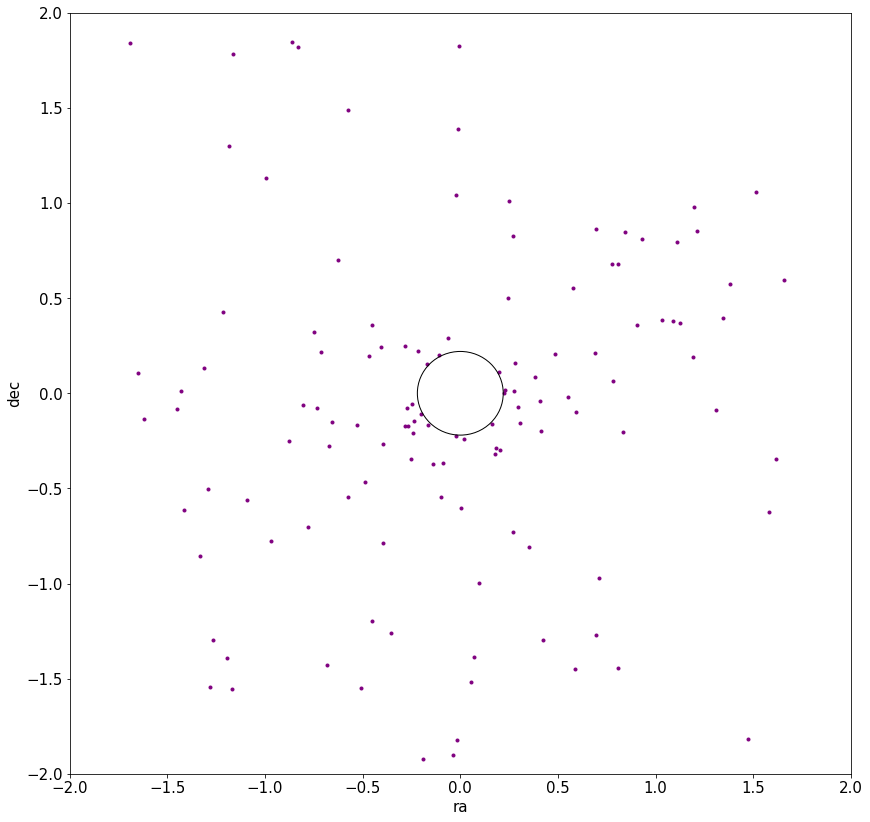

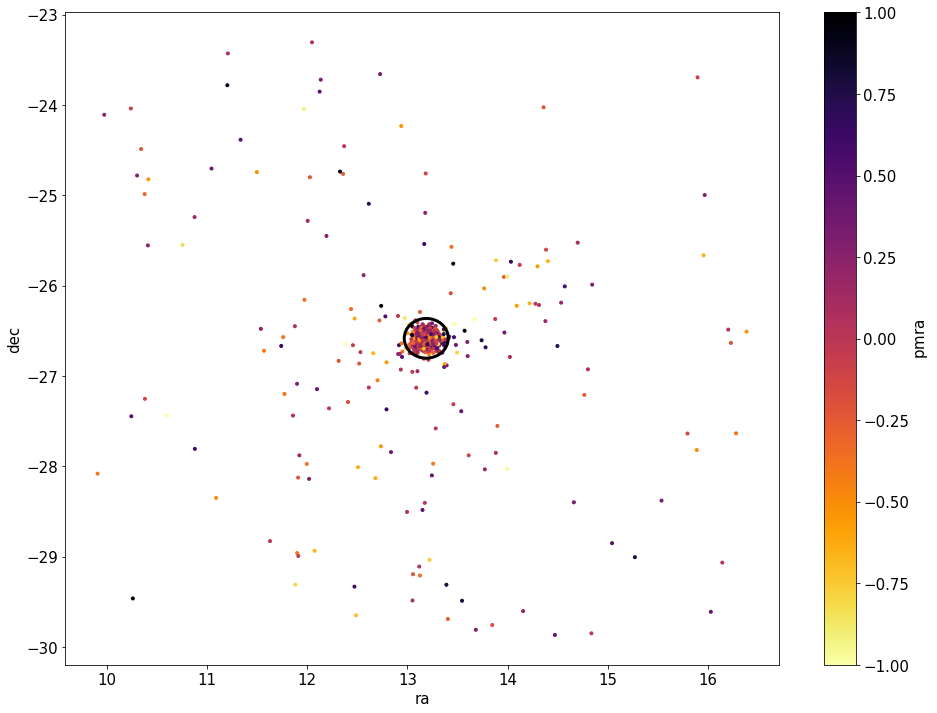

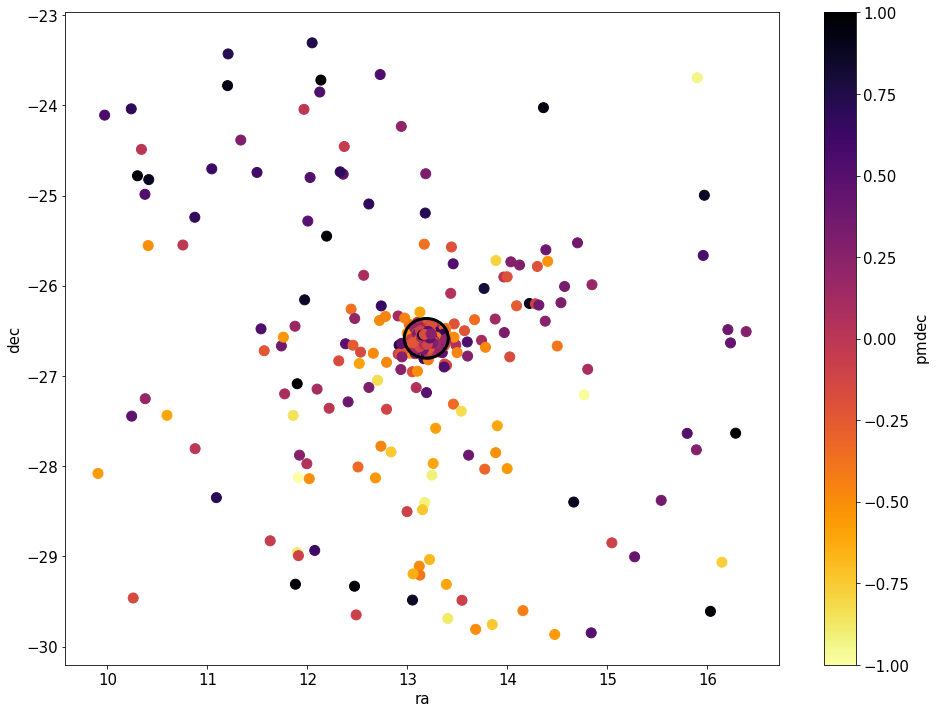

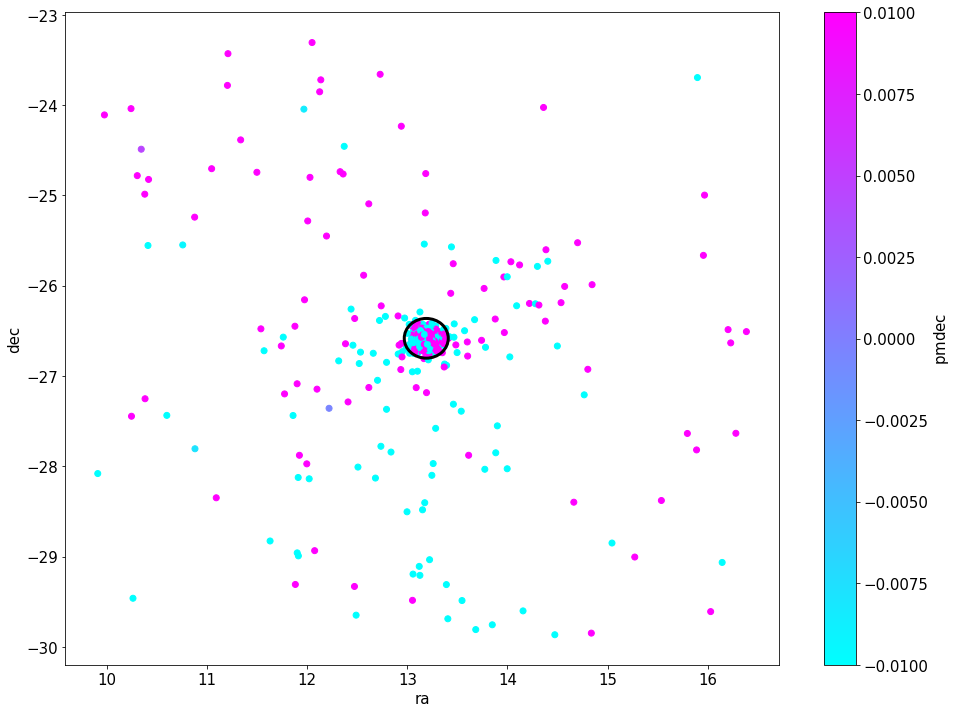

1511 1511
(1511,)
(186, 1)
(186, 1)
[0.    0.006 0.012 0.018 0.024 0.03  0.036 0.042 0.048 0.054 0.06  0.066
 0.072 0.078 0.084 0.09  0.096]
(1511, 1)
/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:456: RuntimeWarning: invalid value encountered in log10

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:457: RuntimeWarning: invalid value encountered in log10

(186,)


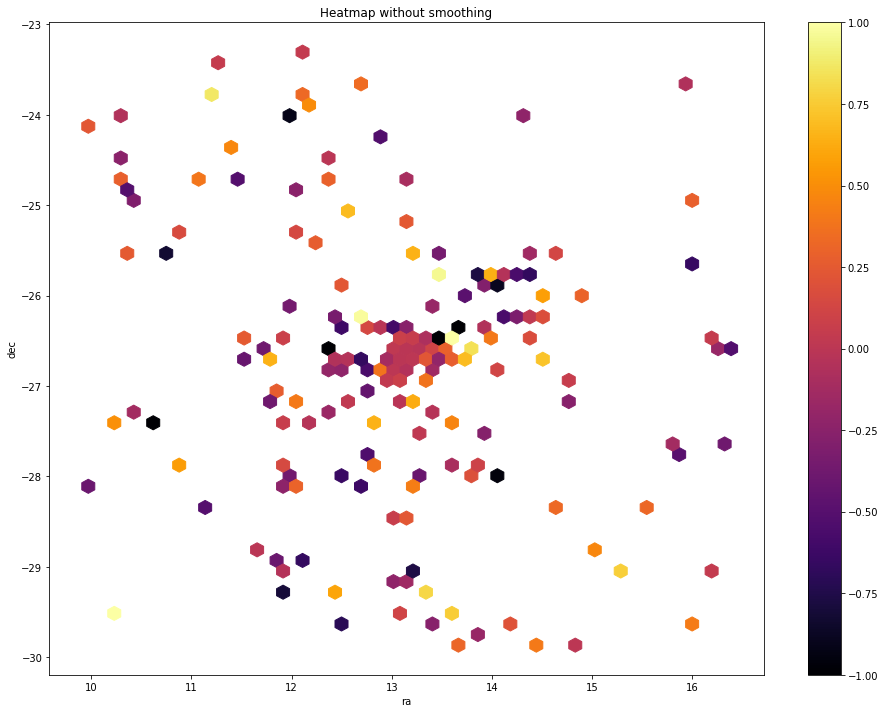

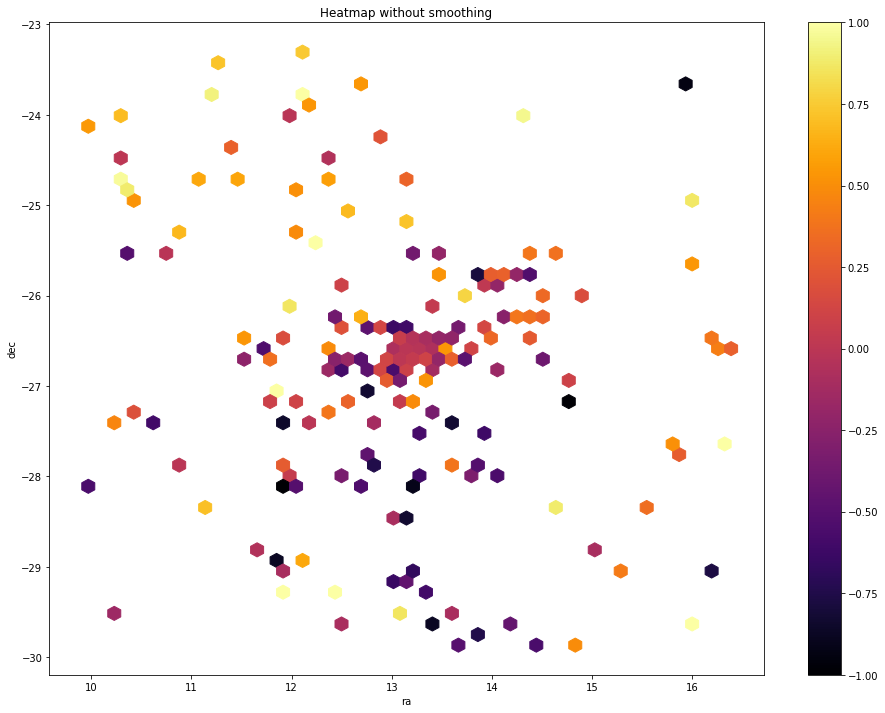

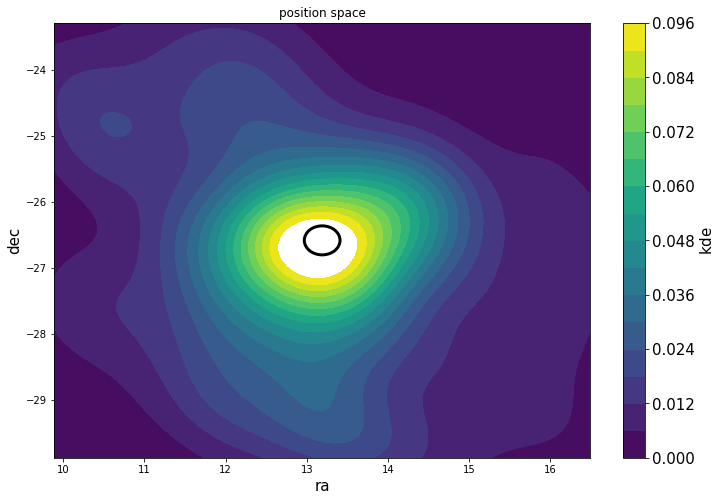

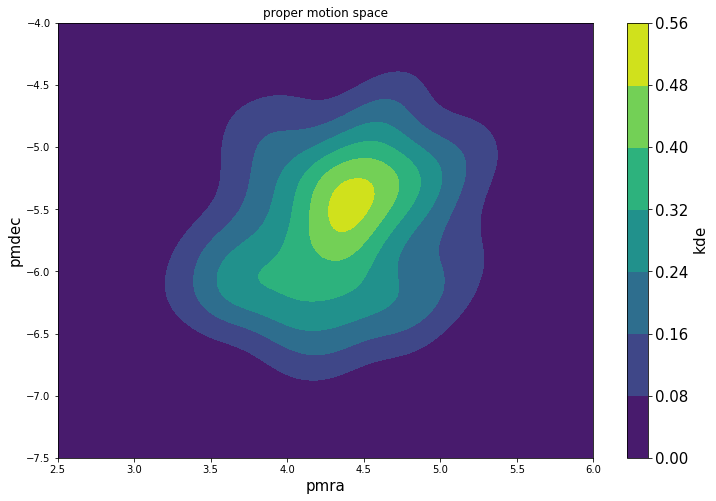

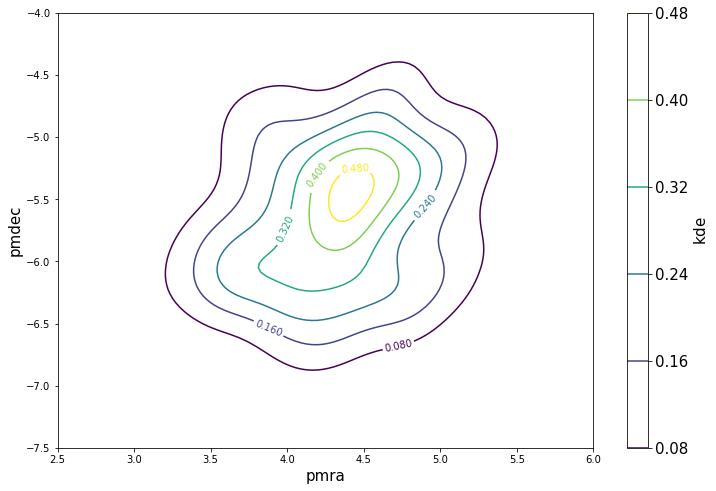

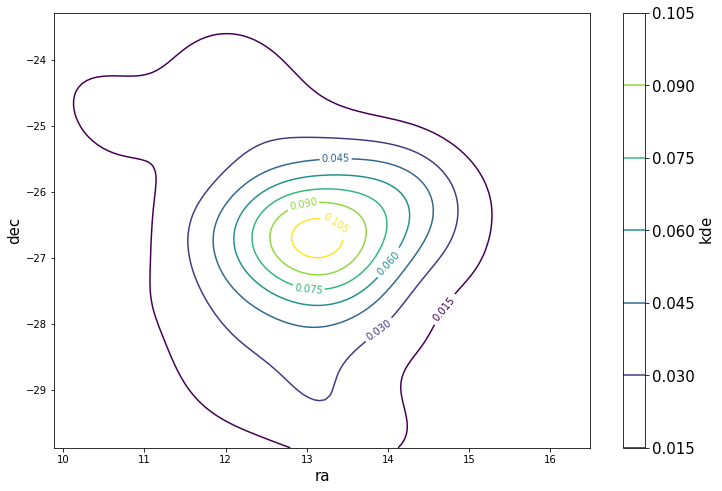

In [7]:
# DBSCAN
DB_Params =[]
DB_Params=np.transpose(DB_Params)

clust_edge2 = (np.sqrt((np.fabs(GlobClust_Log_ra_out[parallax_indx].as_matrix()-coord_ra_dec.ra.deg)**2+
                        np.fabs(GlobClust_Log_dec_out[parallax_indx].as_matrix()-coord_ra_dec.dec.deg)**2))
              >Tidal_Edge/60)

pm_indx=(GlobClust_Log_pmra_error[parallax_indx]/np.fabs(GlobClust_Log_pmra[parallax_indx]) < 0.20) * \
        (GlobClust_Log_pmdec_error[parallax_indx]/np.fabs(GlobClust_Log_pmdec[parallax_indx]) < 0.20) *\
        (GlobClust_Log_vpu[parallax_indx] > 8) * (GlobClust_Log_aen[parallax_indx] == 0)

DF={'M': GlobClust_Log_g[parallax_indx][pm_indx]/7, 
    'rpbp': GlobClust_Log_rpbp[parallax_indx][pm_indx], 
    'pmra': GlobClust_Log_pmra[parallax_indx][pm_indx]/50, 'pmdec': GlobClust_Log_pmdec[parallax_indx][pm_indx]/50}

DB_Params = pd.DataFrame(data=DF)
DB_Params=DB_Params.dropna()

print(shape(DB_Params))

# 5% - possibly best
#db=sklearn.cluster.DBSCAN(eps=0.0285, min_samples=19, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

# 5%
#db=sklearn.cluster.DBSCAN(eps=0.0295, min_samples=21, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

# 10% - very few
#db=sklearn.cluster.DBSCAN(eps=0.0295, min_samples=21, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

# 10% - fewer
#db=sklearn.cluster.DBSCAN(eps=0.027, min_samples=20, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

# 10% - possibly best
#db=sklearn.cluster.DBSCAN(eps=0.03, min_samples=20, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

# 10% - 
#db=sklearn.cluster.DBSCAN(eps=0.031, min_samples=13, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

# 15%
#db=sklearn.cluster.DBSCAN(eps=0.028, min_samples=13, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

# 20% - very few
#db=sklearn.cluster.DBSCAN(eps=0.024, min_samples=20, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

# 20%
#db=sklearn.cluster.DBSCAN(eps=0.028, min_samples=18, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

#20%  - THIS ONE 
db=sklearn.cluster.DBSCAN(eps=0.026, min_samples=19, metric='euclidean', metric_params=None, algorithm='auto', 
                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

# 25% - fewer
#db=sklearn.cluster.DBSCAN(eps=0.026, min_samples=24, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

# 25% - more
#db=sklearn.cluster.DBSCAN(eps=0.029, min_samples=19, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625


#db=sklearn.cluster.DBSCAN(eps=0.03, min_samples=20, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

#db=sklearn.cluster.DBSCAN(eps=0.026, min_samples=24, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625
#db=sklearn.cluster.DBSCAN(eps=0.027, min_samples=20, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

print(db.labels_)
print(shape(db.labels_))

fig=plt.figure(figsize=(18,12))
plt.scatter(GlobClust_Log_rpbp[parallax_indx][pm_indx]/1, GlobClust_Log_g[parallax_indx][pm_indx]/7, c=GlobClust_Log_rpbp[parallax_indx][pm_indx]/1, cmap='RdBu_r')
#plt.scatter(db,DB_Params)
#plt.show()

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

print('Estimated number of Subgroups: %d' % n_clusters_)

x_param3=[]
y_param3=[]

x_param4=[]
y_param4=[]

# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)
    
    #NOISE
    #xy = DB_Params[class_member_mask & ~core_samples_mask]
    #plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
    #         markeredgecolor='k', markersize=6)
    
    #CLEANED DATA
    xy = DB_Params[class_member_mask & core_samples_mask]
    
    plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], '.', markerfacecolor=tuple(col),)
     #       )#markeredgecolor='k')#, markersize=14)
    
    x_param3.append(xy.loc[:, "rpbp"])
    #y_param3=x_param3
    y_param3.append(xy.loc[:, "M"]*7)

    #x_param4.append(xy.loc[:, "pmra"]*0.35)
    #y_param4.append(xy.loc[:, "pmdec"]*0.3)
    
    #x_param5.append(xy.loc[:, "ra"]*0.35)
    #y_param5.append(xy.loc[:, "dec"]*0.3)

plt.gca().invert_yaxis()
plt.title('Estimated number of Subgroups: %d' % n_clusters_)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)

plt.legend()
plt.show()
#fig.savefig('GC_DBSCAN'+ GlobClust_Log_ID[0] +'eps0p165-mins10_coreCMD-fullsetiponfullcmd.png')

x_out3 = pd.DataFrame(x_param3)#, index=None)#, mangle_dupe_cols=True)
#x_out3.reset_index()
x_out3 = x_out3.transpose() 
x_out3 = x_out3.loc[:,~x_out3.columns.duplicated()]
#x_out3 = x_out3["rpbp"].as_matrix()
x_out3

y_out3 = pd.DataFrame(y_param3)#, index=None)#, mangle_dupe_cols=True)
#y_out3.reset_index()
y_out3 = y_out3.transpose() 
y_out3 = y_out3.loc[:,~y_out3.columns.duplicated()]
#y_out3 = y_out3["M"].as_matrix()
print(shape(y_out3))

GC_ra = pd.DataFrame({'ra':GlobClust_Log_ra})
GC_dec = pd.DataFrame({'dec':GlobClust_Log_dec})
GC_pmra = pd.DataFrame({'pmra':GlobClust_Log_pmra})
GC_pmdec = pd.DataFrame({'pmdec':GlobClust_Log_pmdec})

ra_DB = GC_ra.reindex(x_out3.index)
dec_DB = GC_dec.reindex(y_out3.index)
pmra_DB = GC_pmra.reindex(x_out3.index)
pmdec_DB = GC_pmdec.reindex(y_out3.index)
M_DB = GlobClust_Log_g.reindex(y_out3.index)
rpbp_DB = GlobClust_Log_rpbp.reindex(y_out3.index)

pmra_DB_norm = (pmra_DB-pmra_DB.mean())#/(pmra_DB.mean())
pmdec_DB_norm = (pmdec_DB-pmdec_DB.mean())#/(pmdec_DB.mean())

print('\n', pmra_DB.mean(), '\n')
print('\n', pmdec_DB.mean())


fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp[parallax_indx][pm_indx], y=GlobClust_Log_g[parallax_indx][pm_indx], c=GlobClust_Log_rpbp[parallax_indx][pm_indx], cmap='RdBu_r', marker='.')
plt.scatter(x=rpbp_DB, y=M_DB, c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().invert_yaxis()
plt.show()

fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_ra_out[parallax_indx], y=GlobClust_Log_dec_out[parallax_indx], c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB, y=dec_DB, c='purple', marker='.')#, alpha=0.2)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

fig=plt.figure(figsize=(16,12))
#plt.hexbin(GlobClust_Log_pmdec_out, GlobClust_Log_pmra_out, extent=[-10,10, -10,10], bins='log',gridsize=200)
plt.scatter(x=GlobClust_Log_pmra_out[parallax_indx][pm_indx] , y=GlobClust_Log_pmdec_out[parallax_indx][pm_indx], c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(y=pmdec_DB, x=pmra_DB, c='purple', marker='.')#, alpha=0.2)
plt.xlabel('pmra', fontsize=15)
plt.ylabel('pmdec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
#plt.gca().set_ylim([-7.5, -4.5])
#plt.gca().set_xlim([2.5,6])
plt.gca().set_ylim([-10,10])
plt.gca().set_xlim([-10,10])
#plt.gca().set_ylim([3.2, 4.7])
#plt.gca().set_xlim([-7.5,-3])
plt.show()

clust_indx = (np.sqrt((np.fabs(ra_DB.as_matrix()-coord_ra_dec.ra.deg)**2+np.fabs(dec_DB.as_matrix()-coord_ra_dec.dec.deg)**2))
              >Tidal_Edge/60)
#(np.sqrt(np.fabs((ra_DB-coord_ra_dec.ra.deg)**2+(dec_DB-coord_ra_dec.dec.deg)**2))<Clust_Edge/60)


fig=plt.figure(figsize=(14,14))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_pmra_out, y=GlobClust_Log_pmdec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB[clust_indx]-coord_ra_dec.ra.deg, y=dec_DB[clust_indx]-coord_ra_dec.dec.deg, c='purple', marker='.')#, alpha=0.2)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
circle = plt.Circle((0,0), GlobClust_Log_r_t/60*4, color='b', fill=False, lw=2)
#ax.add_artist(circle)
circle2 = plt.Circle((0,0), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=1)
ax.add_artist(circle2)
circle3 = plt.Circle((0,0), 5/60, color='pink', fill=False, lw=2)
#ax.add_artist(circle3)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().set_ylim([-2, 2])
plt.gca().set_xlim([-2,2])
plt.gca().tick_params(labelsize=15)
plt.show()


fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB, y=dec_DB, c=pmra_DB_norm, cmap='inferno_r', marker='.', vmin=-1, vmax=1)#, alpha=0.2)
#plt.scatter(x=ra_DB, y=dec_DB, c=pmdec_DB_norm, cmap='inferno', marker='.', vmin=-1, vmax=1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60*4, color='b', fill=False, lw=5)
#ax.add_artist(circle)
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=3)
ax.add_artist(circle2)
circle3 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), 5/60, color='pink', fill=False, lw=2)
#ax.add_artist(circle3)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB, y=dec_DB, c=pmdec_DB_norm, cmap='inferno_r', marker='o', s=100, vmin=-1, vmax=1)#vmin=-0.1, vmax=.1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60*4, color='b', fill=False, lw=5)
#ax.add_artist(circle)
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=3)
ax.add_artist(circle2)
circle3 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), 5/60, color='pink', fill=False, lw=2)
#ax.add_artist(circle3)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB, y=dec_DB, c=pmdec_DB_norm, cmap='cool', marker='o', vmin=-0.01, vmax=0.01)#vmin=-0.1, vmax=.1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60*4, color='b', fill=False, lw=5)
#ax.add_artist(circle)
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=3)
ax.add_artist(circle2)
circle3 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), 5/60, color='pink', fill=False, lw=2)
#ax.add_artist(circle3)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

x=ra_DB[~numpy.isnan(ra_DB)]
y=dec_DB[~numpy.isnan(dec_DB)]
x=np.array(x)
y=np.array(y)
print(len(x),len(y))
print(x[:,0].shape)

fig=plt.figure(figsize=(16,12))
# normal distribution center at x=0 and y=5
plt.hexbin(x[:,0], y[:,0], C=pmra_DB_norm, cmap='inferno', gridsize=50,vmin=-1,vmax=1)#, extent=[11,17,  -23,-29])
plt.colorbar()
plt.title('Heatmap without smoothing')
plt.ylabel("dec")
plt.xlabel("ra")
fig=plt.figure(figsize=(16,12))
# normal distribution center at x=0 and y=5
plt.hexbin(x[:,0], y[:,0], C=pmdec_DB_norm, cmap='inferno', gridsize=50,vmin=-1,vmax=1)#, extent=[11,17,  -23,-29])
plt.colorbar()
plt.title('Heatmap without smoothing')
plt.ylabel("dec")
plt.xlabel("ra")

pmra_kde=pmra_DB[clust_indx].as_matrix()
pmdec_kde=pmdec_DB[clust_indx].as_matrix()
print(shape(pmdec_kde))
#pmra_kde=pmra_DB.as_matrix()
#pmdec_kde=pmdec_DB.as_matrix()
#print(shape(pmdec_kde))

ra_kde=ra_DB[clust_indx].as_matrix()
dec_kde=dec_DB[clust_indx].as_matrix()
print(shape(pmdec_kde))
#ra_kde=ra_DB.as_matrix()
#dec_kde=dec_DB.as_matrix()
#print(shape(pmdec_kde))

pmra_kde_1 = 0-10 
pmra_kde_2 = 0+10
pmdec_kde_1 = 0-10
pmdec_kde_2 = 0+10


findx=(np.isfinite(pmra_kde))*(np.isfinite(pmdec_kde))*(pmra_kde<pmra_kde_2)*(pmra_kde>pmra_kde_1)*(pmdec_kde>pmdec_kde_1)*(pmdec_kde<pmdec_kde_2)

from scipy import stats
from matplotlib import colors, ticker, cm

#pmra_kde=pmra_DB.as_matrix()[findx]
#pmdec_kde=pmdec_DB.as_matrix()[findx]

#pmra_kde=pmra_DB.dropna().as_matrix()
#pmdec_kde=pmdec_DB.dropna().as_matrix()

r_t = GlobClust_Log_r_t.as_matrix()
r_t = r_t[0]

ra_kde_1 = coord_ra_dec.ra.deg-r_t/60*15
ra_kde_2 = coord_ra_dec.ra.deg+r_t/60*15
dec_kde_1 = coord_ra_dec.dec.deg-r_t/60*15
dec_kde_2 = coord_ra_dec.dec.deg+r_t/60*15


#KDE part
k = stats.gaussian_kde([ra_kde[findx], dec_kde[findx]], )
xi, yi = np.mgrid[ra_kde_1:ra_kde_2:100*1j, 
                  dec_kde_1:dec_kde_2:100*1j]
#xi, yi = np.mgrid[12:14:100*1j, 
#                  -28:-26:100*1j]
#print(xi,yi,k)
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
zii=zi.reshape(xi.shape)

contours = np.arange(0,0.1, 0.006)
print(contours)

fig=plt.figure(figsize=(12,8))
ax=plt.gca()
plt.contourf(xi, yi, zii , levels=contours)#[0,0.025,0.05,0.075,0.1])# locator=ticker.LogLocator())
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=3)
ax.add_artist(circle2)
plt.title('position space')
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{kde}$',fontsize=15)

#KDE part
k = stats.gaussian_kde([pmra_kde[findx], pmdec_kde[findx]], )
xi, yi = np.mgrid[2.5:6:100*1j, 
                  -7.5:-4:100*1j]
#print(xi,yi,k)
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
zii=zi.reshape(xi.shape)

fig=plt.figure(figsize=(12,8))
plt.contourf(xi, yi, zii ,)# locator=ticker.LogLocator())
plt.title('proper motion space')
plt.xlabel('pmra', fontsize=15)
plt.ylabel('pmdec', fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{kde}$',fontsize=15)


pmra_kde=pmra_DB[clust_indx].as_matrix()
pmdec_kde=pmdec_DB[clust_indx].as_matrix()

print(shape(clust_indx))

#pmra_kde=pmra_DB.as_matrix()
#pmdec_kde=pmdec_DB.as_matrix()

#pmra_kde_1 = 0-10 
#pmra_kde_2 = 0+10
#pmdec_kde_1 = 0-10
#pmdec_kde_2 = 0+10

findx=(np.isfinite(pmra_kde))*(np.isfinite(pmdec_kde))#*(pmra_kde<2.*np.pi)*(pmra_kde>0.)*(pmdec_kde>-1.)*(pmdec_kde<1.)

from scipy import stats
from matplotlib import colors, ticker, cm

#pmra_kde=pmra_DB.as_matrix()[findx]
#pmdec_kde=pmdec_DB.as_matrix()[findx]

#pmra_kde=pmra_DB.dropna().as_matrix()
#pmdec_kde=pmdec_DB.dropna().as_matrix()

r_t = GlobClust_Log_r_t.as_matrix()
r_t = r_t[0]

#ra_kde_1 = 0-r_t/60*15
#ra_kde_2 = 0+r_t/60*15
#dec_kde_1 = 0-r_t/60*15
#dec_kde_2 = 0+r_t/60*15

lev_exp = np.arange(np.floor(np.log10(pmra_DB_norm[~numpy.isnan(pmra_DB_norm)]).min()-1),
                    np.ceil(np.log10(pmra_DB_norm[~numpy.isnan(pmra_DB_norm)]).max()+1))
levs = np.power(10, lev_exp)

print(shape(pmra_kde[findx]))


#KDE part
k = stats.gaussian_kde([pmra_kde[findx], pmdec_kde[findx]], )
xi, yi = np.mgrid[2.5:6:100*1j, 
                  -7.5:-4:100*1j]
#print(xi,yi,k)
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
zii=zi.reshape(xi.shape)

fig=plt.figure(figsize=(12,8))
CS=plt.contour(xi, yi, zii, )# levs, norm=colors.LogNorm())#locator=ticker.LogLocator())
plt.xlabel('pmra', fontsize=15)
plt.ylabel('pmdec', fontsize=15)
plt.clabel(CS, inline=1, fontsize=10, )
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{kde}$',fontsize=15)

#KDE part
k = stats.gaussian_kde([ra_kde[findx], dec_kde[findx]], )
xi, yi = np.mgrid[ra_kde_1:ra_kde_2:100*1j, 
                  dec_kde_1:dec_kde_2:100*1j]
#print(xi,yi,k)
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
zii=zi.reshape(xi.shape)

fig=plt.figure(figsize=(12,8))
CS=plt.contour(xi, yi, zii )#, levs, norm=colors.LogNorm())#locator=ticker.LogLocator())
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
plt.clabel(CS, inline=1, fontsize=10, )
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{kde}$',fontsize=15)

In [26]:
from hdbscan import HDBSCAN
import seaborn as sns

clusterer = hdbscan.HDBSCAN()
#We can then use this clustering object and fit it to the data we have. This will return the clusterer object back to you – just in case you want do some method chaining.

clusterer.fit(DB_Params)
HDBSCAN(min_cluster_size=5, min_samples=None)
    #algorithm='best', alpha=1.0, approx_min_span_tree=True,
#    gen_min_span_tree=False, leaf_size=40, memory=Memory(cachedir=None),
#    metric='euclidean', min_cluster_size=5, min_samples=None, p=None)
#At this point we are actually done! We’ve done the clustering! But where are the results? How do I get the clusters? The clusterer object knows, and stores the result in an attribute labels_.

clusterer.labels_

clusterer = hdbscan.HDBSCAN(min_cluster_size=15).fit(DB_Params)
color_palette = sns.color_palette('deep', 8)
cluster_colors = [color_palette[x] if x >= 0
                  else (0.5, 0.5, 0.5)
                  for x in clusterer.labels_]
cluster_member_colors = [sns.desaturate(x, p) for x, p in
                         zip(cluster_colors, clusterer.probabilities_)]


In [ ]:
plt.scatter(*DB_Params.T, *DB_Params, linewidth=0, c=cluster_member_colors, alpha=0.25)

(59203, 4)
[1 1 1 ... 1 1 1]
(59203,)


AttributeError: 'HDBSCAN' object has no attribute 'core_sample_indices_'

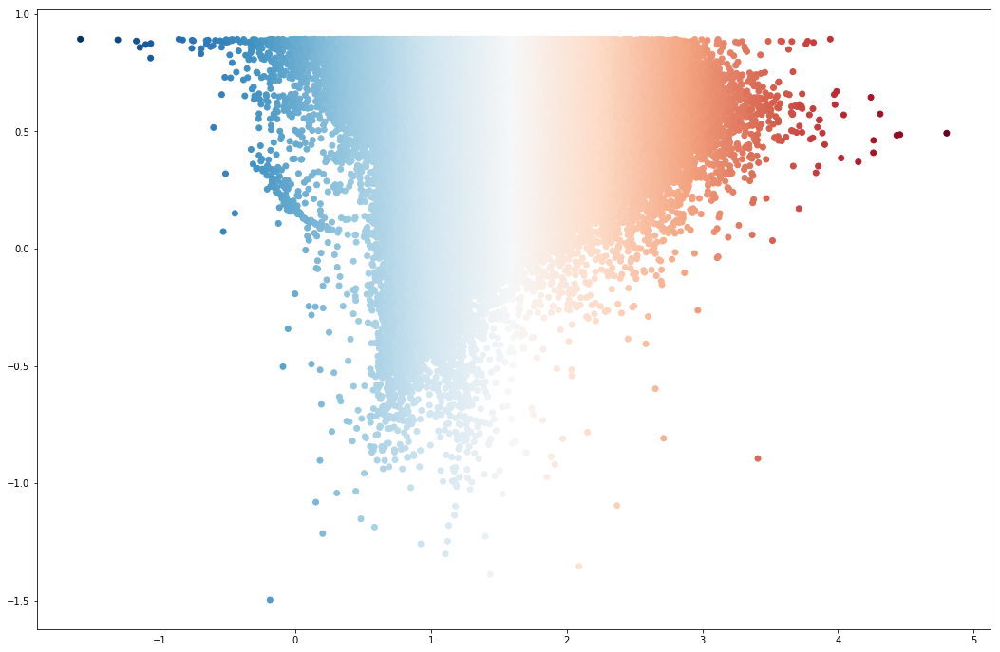

In [18]:
# DBSCAN

DB_Params =[]
DB_Params=np.transpose(DB_Params)

clust_edge2 = (np.sqrt((np.fabs(GlobClust_Log_ra_out[parallax_indx].as_matrix()-coord_ra_dec.ra.deg)**2+
                        np.fabs(GlobClust_Log_dec_out[parallax_indx].as_matrix()-coord_ra_dec.dec.deg)**2))
              >Tidal_Edge/60)

DF={'M': GlobClust_Log_M[parallax_indx]/7, 
    'rpbp': GlobClust_Log_rpbp[parallax_indx], 
    'pmra': GlobClust_Log_pmra[parallax_indx]/50, 'pmdec': GlobClust_Log_pmdec[parallax_indx]/50}

DB_Params = pd.DataFrame(data=DF)
DB_Params=DB_Params.dropna()

print(shape(DB_Params))

db=clusterer.fit(DB_Params)
HDBSCAN(min_cluster_size=5, min_samples=None)

#db=sklearn.cluster.DBSCAN(eps=0.026, min_samples=24, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625
#db=sklearn.cluster.DBSCAN(eps=0.013, min_samples=25, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

print(db.labels_)
print(shape(db.labels_))

fig=plt.figure(figsize=(18,12))
plt.scatter(GlobClust_Log_rpbp/1, GlobClust_Log_M/7, c=GlobClust_Log_rpbp/1, cmap='RdBu_r')
#plt.scatter(db,DB_Params)
#plt.show()

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

print('Estimated number of Subgroups: %d' % n_clusters_)

x_param3=[]
y_param3=[]

x_param4=[]
y_param4=[]

# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)
    
    #NOISE
    #xy = DB_Params[class_member_mask & ~core_samples_mask]
    #plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
    #         markeredgecolor='k', markersize=6)
    
    #CLEANED DATA
    xy = DB_Params[class_member_mask & core_samples_mask]
    
    plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], '.', markerfacecolor=tuple(col),)
     #       )#markeredgecolor='k')#, markersize=14)
    
    x_param3.append(xy.loc[:, "rpbp"])
    #y_param3=x_param3
    y_param3.append(xy.loc[:, "M"]*7)

    #x_param4.append(xy.loc[:, "pmra"]*0.35)
    #y_param4.append(xy.loc[:, "pmdec"]*0.3)
    
    #x_param5.append(xy.loc[:, "ra"]*0.35)
    #y_param5.append(xy.loc[:, "dec"]*0.3)

plt.gca().invert_yaxis()
plt.title('Estimated number of Subgroups: %d' % n_clusters_)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)

plt.legend()
plt.show()
#fig.savefig('GC_DBSCAN'+ GlobClust_Log_ID[0] +'eps0p165-mins10_coreCMD-fullsetiponfullcmd.png')

x_out3 = pd.DataFrame(x_param3)#, index=None)#, mangle_dupe_cols=True)
#x_out3.reset_index()
x_out3 = x_out3.transpose() 
x_out3 = x_out3.loc[:,~x_out3.columns.duplicated()]
#x_out3 = x_out3["rpbp"].as_matrix()
x_out3

y_out3 = pd.DataFrame(y_param3)#, index=None)#, mangle_dupe_cols=True)
#y_out3.reset_index()
y_out3 = y_out3.transpose() 
y_out3 = y_out3.loc[:,~y_out3.columns.duplicated()]
#y_out3 = y_out3["M"].as_matrix()
print(shape(y_out3))

GC_ra = pd.DataFrame({'ra':GlobClust_Log_ra})
GC_dec = pd.DataFrame({'dec':GlobClust_Log_dec})
GC_pmra = pd.DataFrame({'pmra':GlobClust_Log_pmra})
GC_pmdec = pd.DataFrame({'pmdec':GlobClust_Log_pmdec})

ra_DB = GC_ra.reindex(x_out3.index)
dec_DB = GC_dec.reindex(y_out3.index)
pmra_DB = GC_pmra.reindex(x_out3.index)
pmdec_DB = GC_pmdec.reindex(y_out3.index)
M_DB = GlobClust_Log_M.reindex(y_out3.index)
rpbp_DB = GlobClust_Log_rpbp.reindex(y_out3.index)

pmra_DB_norm = (pmra_DB-pmra_DB.mean())#/(pmra_DB.mean())
pmdec_DB_norm = (pmdec_DB-pmdec_DB.mean())#/(pmdec_DB.mean())

print('\n', pmra_DB.mean(), '\n')
print('\n', pmdec_DB.mean())


fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r', marker='.')
plt.scatter(x=rpbp_DB, y=M_DB, c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().invert_yaxis()
plt.show()

fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB, y=dec_DB, c='purple', marker='.')#, alpha=0.2)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

fig=plt.figure(figsize=(16,12))
#plt.hexbin(GlobClust_Log_pmdec_out, GlobClust_Log_pmra_out, extent=[-10,10, -10,10], bins='log',gridsize=200)
plt.scatter(x=GlobClust_Log_pmra_out[parallax_indx] , y=GlobClust_Log_pmdec_out[parallax_indx], c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(y=pmdec_DB, x=pmra_DB, c='purple', marker='.')#, alpha=0.2)
plt.xlabel('pmra', fontsize=15)
plt.ylabel('pmdec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
#plt.gca().set_ylim([-7.5, -4.5])
#plt.gca().set_xlim([2.5,6])
plt.gca().set_ylim([-10,10])
plt.gca().set_xlim([-10,10])
#plt.gca().set_ylim([3.2, 4.7])
#plt.gca().set_xlim([-7.5,-3])
plt.show()

clust_indx = (np.sqrt((np.fabs(ra_DB.as_matrix()-coord_ra_dec.ra.deg)**2+np.fabs(dec_DB.as_matrix()-coord_ra_dec.dec.deg)**2))
              >Tidal_Edge/60)
#(np.sqrt(np.fabs((ra_DB-coord_ra_dec.ra.deg)**2+(dec_DB-coord_ra_dec.dec.deg)**2))<Clust_Edge/60)


fig=plt.figure(figsize=(14,14))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_pmra_out, y=GlobClust_Log_pmdec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB[clust_indx]-coord_ra_dec.ra.deg, y=dec_DB[clust_indx]-coord_ra_dec.dec.deg, c='purple', marker='.')#, alpha=0.2)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
circle = plt.Circle((0,0), GlobClust_Log_r_t/60*4, color='b', fill=False, lw=2)
#ax.add_artist(circle)
circle2 = plt.Circle((0,0), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=1)
ax.add_artist(circle2)
circle3 = plt.Circle((0,0), 5/60, color='pink', fill=False, lw=2)
#ax.add_artist(circle3)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().set_ylim([-2, 2])
plt.gca().set_xlim([-2,2])
plt.gca().tick_params(labelsize=15)
plt.show()


fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB, y=dec_DB, c=pmra_DB_norm, cmap='inferno_r', marker='.', vmin=-1, vmax=1)#, alpha=0.2)
#plt.scatter(x=ra_DB, y=dec_DB, c=pmdec_DB_norm, cmap='inferno', marker='.', vmin=-1, vmax=1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60*4, color='b', fill=False, lw=5)
#ax.add_artist(circle)
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=3)
ax.add_artist(circle2)
circle3 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), 5/60, color='pink', fill=False, lw=2)
#ax.add_artist(circle3)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB, y=dec_DB, c=pmdec_DB_norm, cmap='inferno_r', marker='.', vmin=-1, vmax=1)#vmin=-0.1, vmax=.1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60*4, color='b', fill=False, lw=5)
#ax.add_artist(circle)
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=3)
ax.add_artist(circle2)
circle3 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), 5/60, color='pink', fill=False, lw=2)
#ax.add_artist(circle3)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB, y=dec_DB, c=pmdec_DB_norm, cmap='cool', marker='.', vmin=-0.01, vmax=0.01)#vmin=-0.1, vmax=.1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60*4, color='b', fill=False, lw=5)
#ax.add_artist(circle)
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=3)
ax.add_artist(circle2)
circle3 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), 5/60, color='pink', fill=False, lw=2)
#ax.add_artist(circle3)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

x=ra_DB[~numpy.isnan(ra_DB)]
y=dec_DB[~numpy.isnan(dec_DB)]
x=np.array(x)
y=np.array(y)
print(len(x),len(y))
print(x[:,0].shape)

fig=plt.figure(figsize=(16,12))
# normal distribution center at x=0 and y=5
plt.hexbin(x[:,0], y[:,0], C=pmra_DB_norm, cmap='inferno', gridsize=50,vmin=-1,vmax=1)#, extent=[11,17,  -23,-29])
plt.colorbar()
plt.title('Heatmap without smoothing')
plt.ylabel("dec")
plt.xlabel("ra")
fig=plt.figure(figsize=(16,12))
# normal distribution center at x=0 and y=5
plt.hexbin(x[:,0], y[:,0], C=pmdec_DB_norm, cmap='inferno', gridsize=50,vmin=-1,vmax=1)#, extent=[11,17,  -23,-29])
plt.colorbar()
plt.title('Heatmap without smoothing')
plt.ylabel("dec")
plt.xlabel("ra")

pmra_kde=pmra_DB[clust_indx].as_matrix()
pmdec_kde=pmdec_DB[clust_indx].as_matrix()
print(shape(pmdec_kde))
#pmra_kde=pmra_DB.as_matrix()
#pmdec_kde=pmdec_DB.as_matrix()
#print(shape(pmdec_kde))

ra_kde=ra_DB[clust_indx].as_matrix()
dec_kde=dec_DB[clust_indx].as_matrix()
print(shape(pmdec_kde))
#ra_kde=ra_DB.as_matrix()
#dec_kde=dec_DB.as_matrix()
#print(shape(pmdec_kde))

pmra_kde_1 = 0-10 
pmra_kde_2 = 0+10
pmdec_kde_1 = 0-10
pmdec_kde_2 = 0+10


findx=(np.isfinite(pmra_kde))*(np.isfinite(pmdec_kde))*(pmra_kde<pmra_kde_2)*(pmra_kde>pmra_kde_1)*(pmdec_kde>pmdec_kde_1)*(pmdec_kde<pmdec_kde_2)

from scipy import stats
from matplotlib import colors, ticker, cm

#pmra_kde=pmra_DB.as_matrix()[findx]
#pmdec_kde=pmdec_DB.as_matrix()[findx]

#pmra_kde=pmra_DB.dropna().as_matrix()
#pmdec_kde=pmdec_DB.dropna().as_matrix()

r_t = GlobClust_Log_r_t.as_matrix()
r_t = r_t[0]

ra_kde_1 = coord_ra_dec.ra.deg-r_t/60*15
ra_kde_2 = coord_ra_dec.ra.deg+r_t/60*15
dec_kde_1 = coord_ra_dec.dec.deg-r_t/60*15
dec_kde_2 = coord_ra_dec.dec.deg+r_t/60*15


#KDE part
k = stats.gaussian_kde([ra_kde[findx], dec_kde[findx]], )
xi, yi = np.mgrid[ra_kde_1:ra_kde_2:100*1j, 
                  dec_kde_1:dec_kde_2:100*1j]
#xi, yi = np.mgrid[12:14:100*1j, 
#                  -28:-26:100*1j]
#print(xi,yi,k)
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
zii=zi.reshape(xi.shape)

contours = np.arange(0,0.1, 0.006)
print(contours)

fig=plt.figure(figsize=(12,8))
ax=plt.gca()
plt.contourf(xi, yi, zii , levels=contours)#[0,0.025,0.05,0.075,0.1])# locator=ticker.LogLocator())
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=3)
ax.add_artist(circle2)
plt.title('position space')
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{kde}$',fontsize=15)

#KDE part
k = stats.gaussian_kde([pmra_kde[findx], pmdec_kde[findx]], )
xi, yi = np.mgrid[2.5:6:100*1j, 
                  -7.5:-4:100*1j]
#print(xi,yi,k)
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
zii=zi.reshape(xi.shape)

fig=plt.figure(figsize=(12,8))
plt.contourf(xi, yi, zii ,)# locator=ticker.LogLocator())
plt.title('proper motion space')
plt.xlabel('pmra', fontsize=15)
plt.ylabel('pmdec', fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{kde}$',fontsize=15)


pmra_kde=pmra_DB[clust_indx].as_matrix()
pmdec_kde=pmdec_DB[clust_indx].as_matrix()

print(shape(clust_indx))

#pmra_kde=pmra_DB.as_matrix()
#pmdec_kde=pmdec_DB.as_matrix()

#pmra_kde_1 = 0-10 
#pmra_kde_2 = 0+10
#pmdec_kde_1 = 0-10
#pmdec_kde_2 = 0+10

findx=(np.isfinite(pmra_kde))*(np.isfinite(pmdec_kde))#*(pmra_kde<2.*np.pi)*(pmra_kde>0.)*(pmdec_kde>-1.)*(pmdec_kde<1.)

from scipy import stats
from matplotlib import colors, ticker, cm

#pmra_kde=pmra_DB.as_matrix()[findx]
#pmdec_kde=pmdec_DB.as_matrix()[findx]

#pmra_kde=pmra_DB.dropna().as_matrix()
#pmdec_kde=pmdec_DB.dropna().as_matrix()

r_t = GlobClust_Log_r_t.as_matrix()
r_t = r_t[0]

#ra_kde_1 = 0-r_t/60*15
#ra_kde_2 = 0+r_t/60*15
#dec_kde_1 = 0-r_t/60*15
#dec_kde_2 = 0+r_t/60*15

lev_exp = np.arange(np.floor(np.log10(pmra_DB_norm[~numpy.isnan(pmra_DB_norm)]).min()-1),
                    np.ceil(np.log10(pmra_DB_norm[~numpy.isnan(pmra_DB_norm)]).max()+1))
levs = np.power(10, lev_exp)

print(shape(pmra_kde[findx]))


#KDE part
k = stats.gaussian_kde([pmra_kde[findx], pmdec_kde[findx]], )
xi, yi = np.mgrid[2.5:6:100*1j, 
                  -7.5:-4:100*1j]
#print(xi,yi,k)
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
zii=zi.reshape(xi.shape)

fig=plt.figure(figsize=(12,8))
CS=plt.contour(xi, yi, zii, )# levs, norm=colors.LogNorm())#locator=ticker.LogLocator())
plt.xlabel('pmra', fontsize=15)
plt.ylabel('pmdec', fontsize=15)
plt.clabel(CS, inline=1, fontsize=10, )
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{kde}$',fontsize=15)

#KDE part
k = stats.gaussian_kde([ra_kde[findx], dec_kde[findx]], )
xi, yi = np.mgrid[ra_kde_1:ra_kde_2:100*1j, 
                  dec_kde_1:dec_kde_2:100*1j]
#print(xi,yi,k)
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
zii=zi.reshape(xi.shape)

fig=plt.figure(figsize=(12,8))
CS=plt.contour(xi, yi, zii )#, levs, norm=colors.LogNorm())#locator=ticker.LogLocator())
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
plt.clabel(CS, inline=1, fontsize=10, )
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{kde}$',fontsize=15)

(59203, 3)
[-1 -1 -1 ... -1 -1 -1]
(59203,)
Estimated number of Subgroups: 2


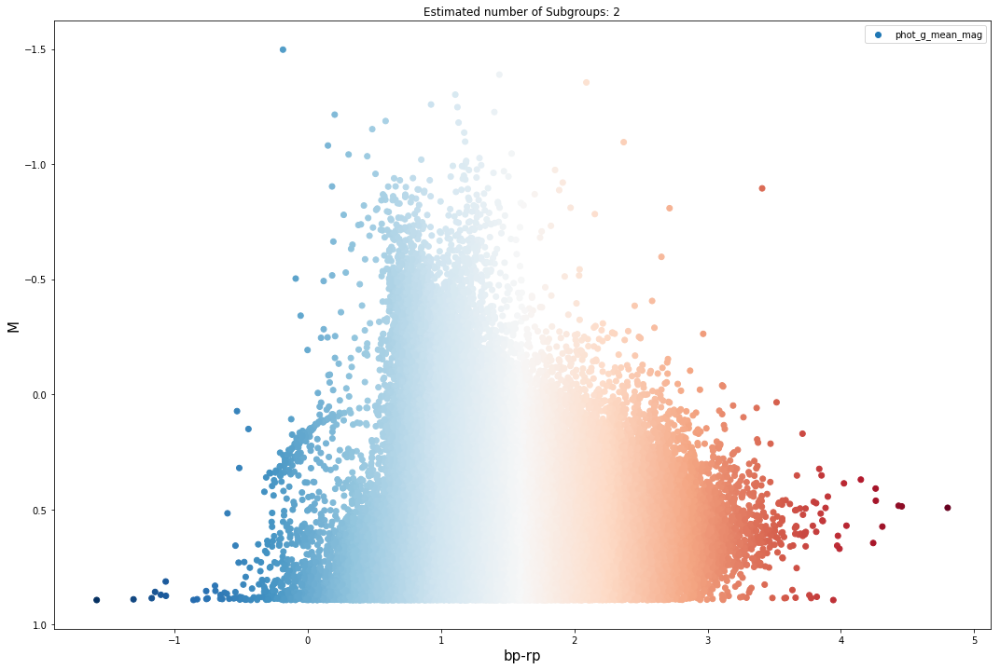

(2711, 1)

 pmra    4.306513
dtype: float64 


 pmdec   -5.692245
dtype: float64


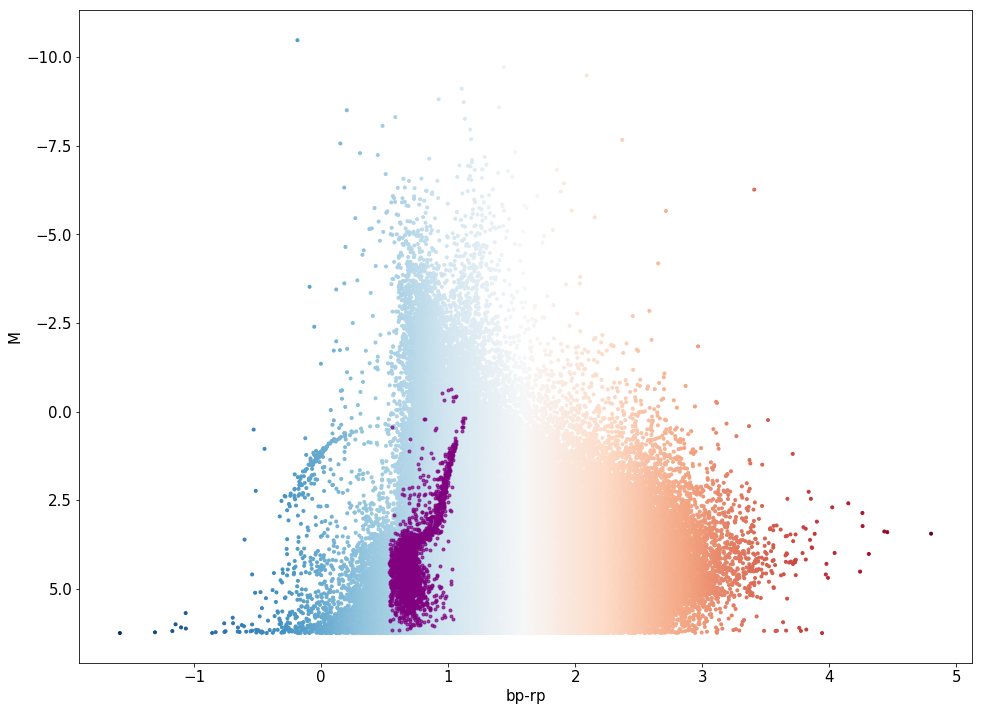

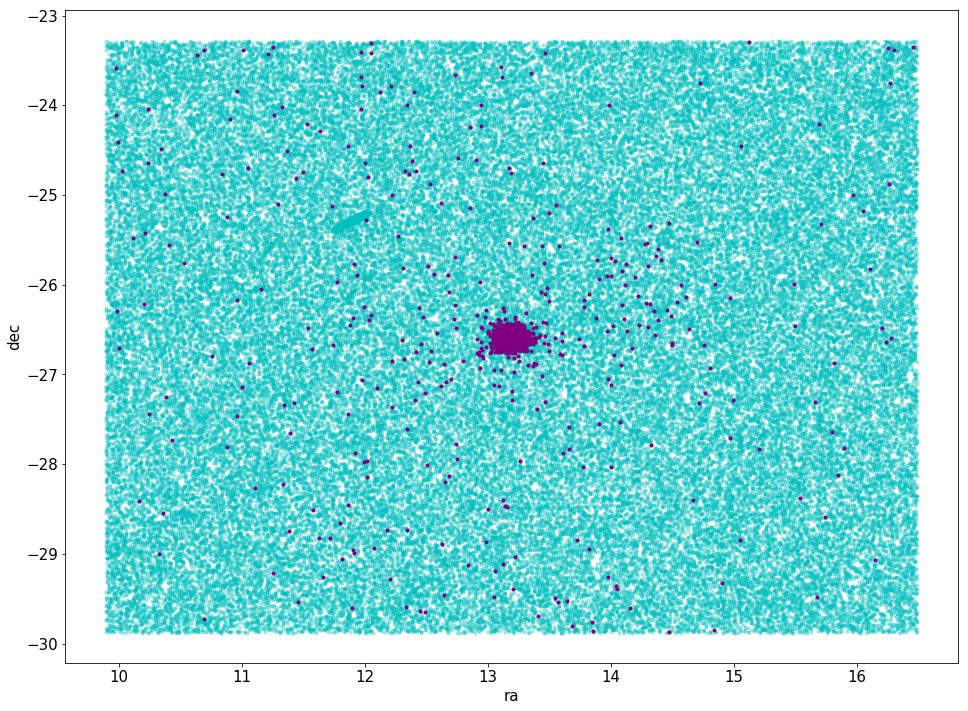

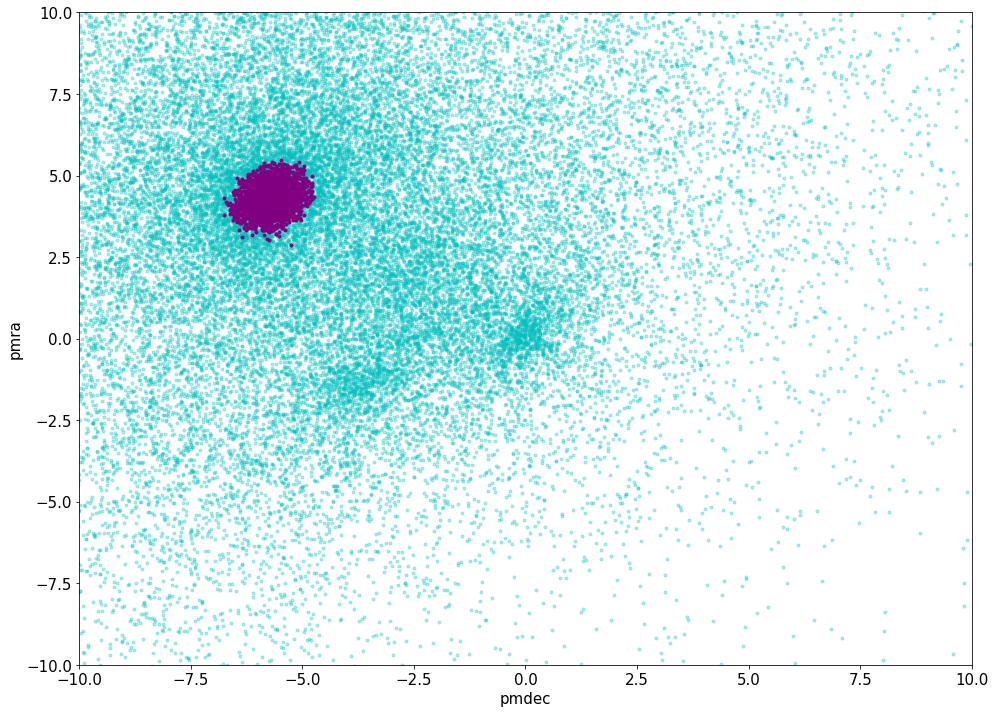

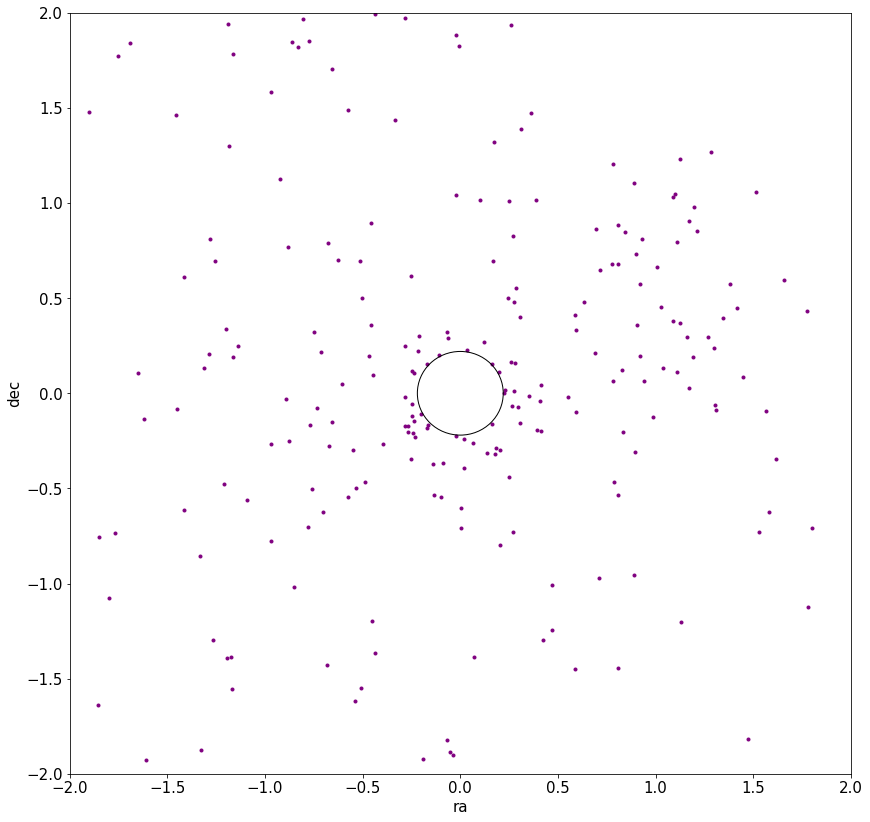

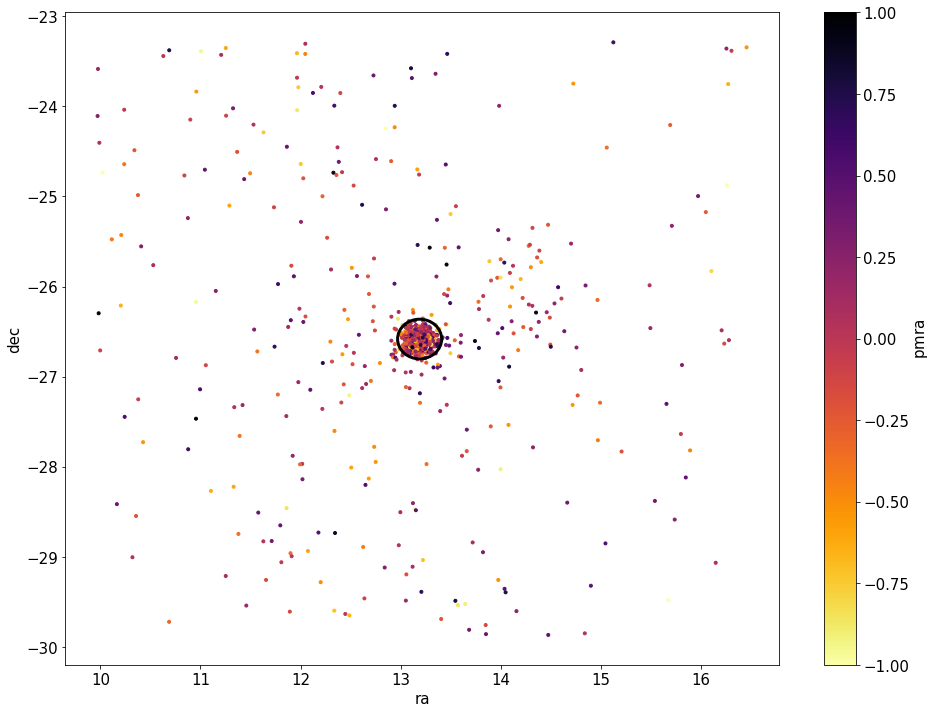

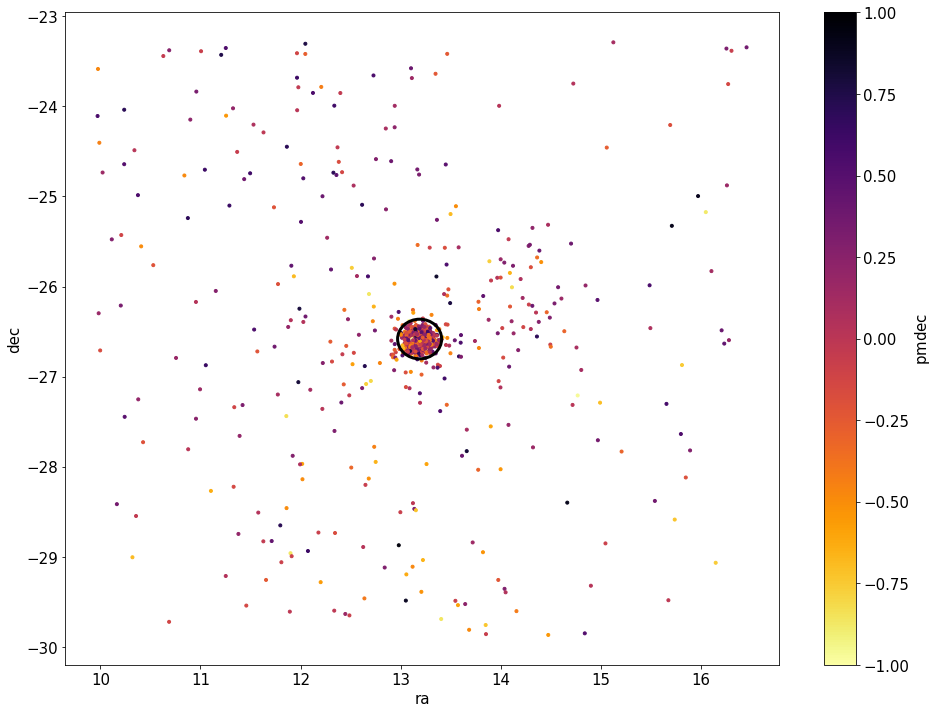

2711 2711
(2711,)
(364, 1)
(364, 1)
[0.    0.006 0.012 0.018 0.024 0.03  0.036 0.042 0.048 0.054 0.06  0.066
 0.072 0.078 0.084 0.09  0.096]
(2711, 1)
/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:379: RuntimeWarning: invalid value encountered in log10

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:380: RuntimeWarning: invalid value encountered in log10

(364,)


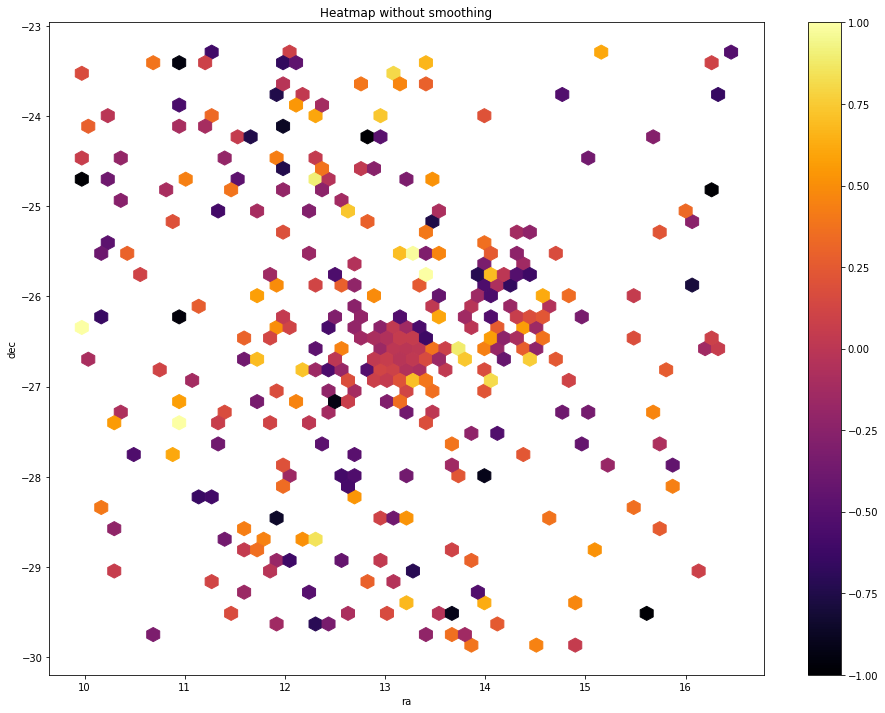

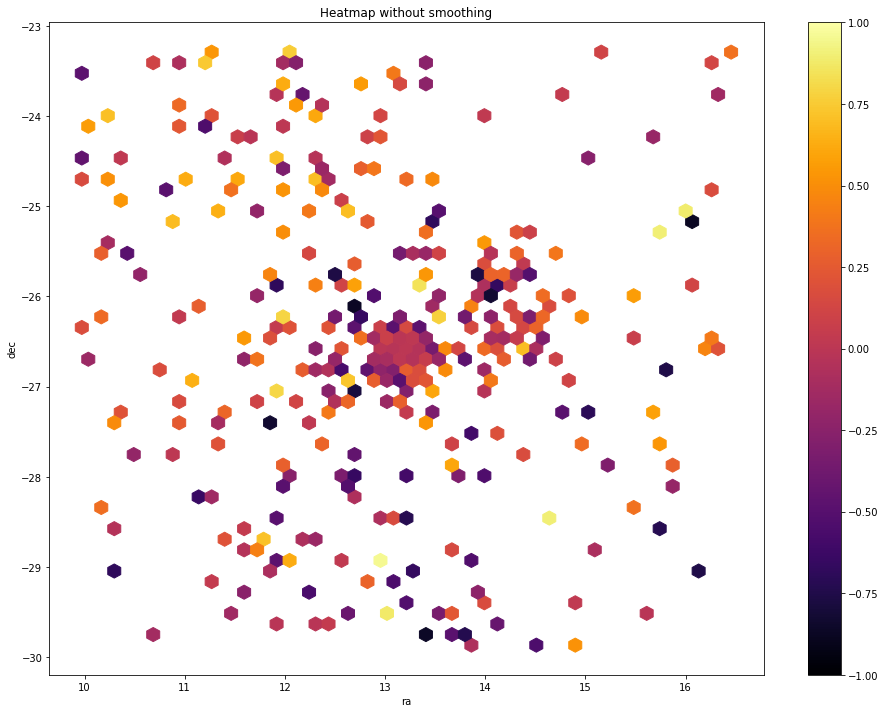

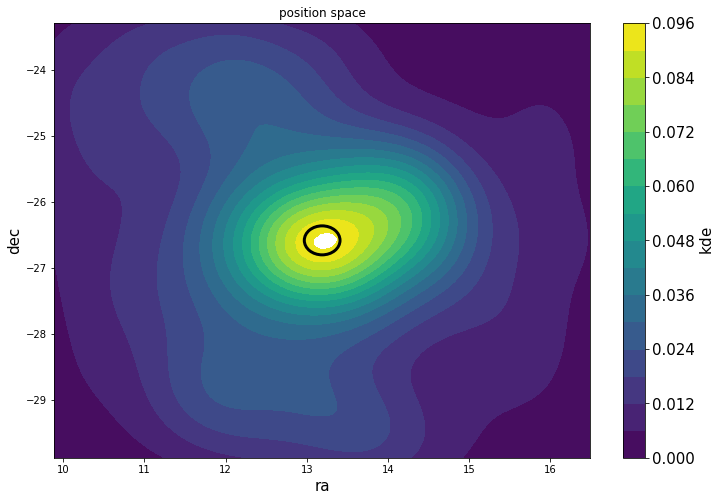

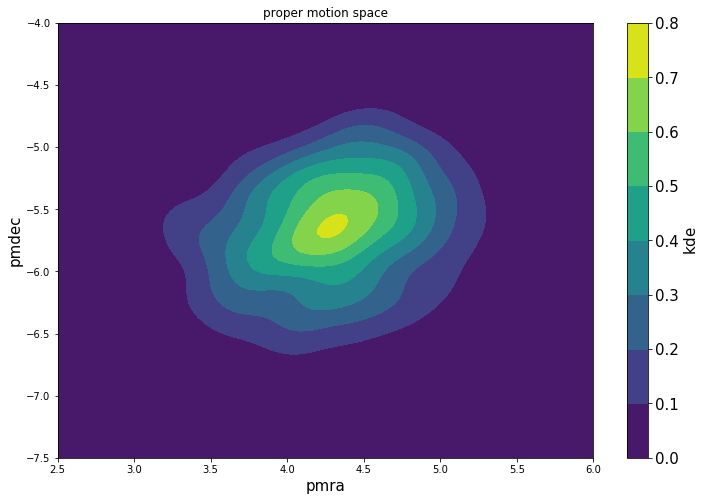

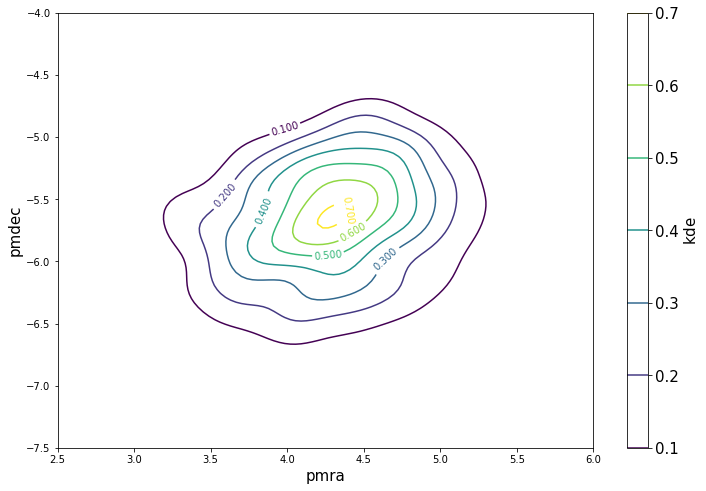

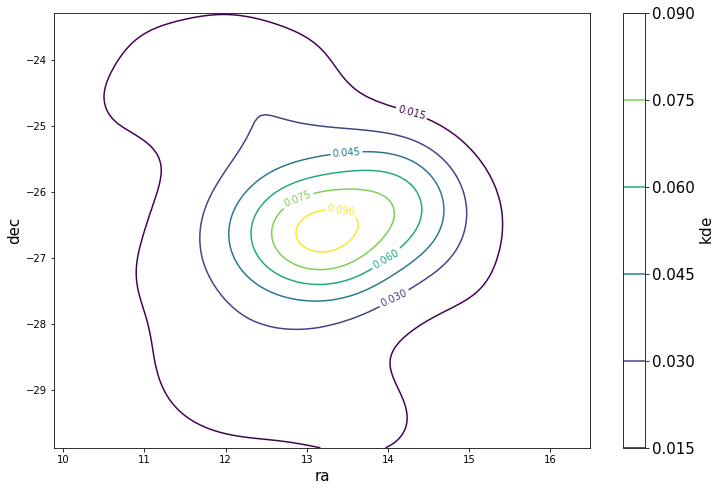

In [4]:
# DBSCAN
DB_Params =[]
DB_Params=np.transpose(DB_Params)

clust_edge2 = (np.sqrt((np.fabs(GlobClust_Log_ra_out[parallax_indx].as_matrix()-coord_ra_dec.ra.deg)**2+
                        np.fabs(GlobClust_Log_dec_out[parallax_indx].as_matrix()-coord_ra_dec.dec.deg)**2))
              >Tidal_Edge/60)

DF={#'M': GlobClust_Log_M[parallax_indx]/7, 
    'rpbp': GlobClust_Log_rpbp[parallax_indx], 
    'pmra': GlobClust_Log_pmra[parallax_indx]/40, 'pmdec': GlobClust_Log_pmdec[parallax_indx]/40}

DB_Params = pd.DataFrame(data=DF)
DB_Params=DB_Params.dropna()

print(shape(DB_Params))

#db=sklearn.cluster.DBSCAN(eps=0.028, min_samples=20, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625
db=sklearn.cluster.DBSCAN(eps=0.013, min_samples=25, metric='euclidean', metric_params=None, algorithm='auto', 
                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

print(db.labels_)
print(shape(db.labels_))

fig=plt.figure(figsize=(18,12))
plt.scatter(GlobClust_Log_rpbp/1, GlobClust_Log_M/7, c=GlobClust_Log_rpbp/1, cmap='RdBu_r')
#plt.scatter(db,DB_Params)
#plt.show()

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

print('Estimated number of Subgroups: %d' % n_clusters_)

x_param3=[]
y_param3=[]

x_param4=[]
y_param4=[]

# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)
    
    #NOISE
    #xy = DB_Params[class_member_mask & ~core_samples_mask]
    #plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
    #         markeredgecolor='k', markersize=6)
    
    #CLEANED DATA
    xy = DB_Params[class_member_mask & core_samples_mask]
    
    #plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], '.', markerfacecolor=tuple(col),)
     #       )#markeredgecolor='k')#, markersize=14)
    
    x_param3.append(xy.loc[:, "rpbp"])
    y_param3=x_param3
    #y_param3.append(xy.loc[:, "M"]*7)

    #x_param4.append(xy.loc[:, "pmra"]*0.35)
    #y_param4.append(xy.loc[:, "pmdec"]*0.3)
    
    #x_param5.append(xy.loc[:, "ra"]*0.35)
    #y_param5.append(xy.loc[:, "dec"]*0.3)

plt.gca().invert_yaxis()
plt.title('Estimated number of Subgroups: %d' % n_clusters_)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)

plt.legend()
plt.show()
#fig.savefig('GC_DBSCAN'+ GlobClust_Log_ID[0] +'eps0p165-mins10_coreCMD-fullsetiponfullcmd.png')

x_out3 = pd.DataFrame(x_param3)#, index=None)#, mangle_dupe_cols=True)
#x_out3.reset_index()
x_out3 = x_out3.transpose() 
x_out3 = x_out3.loc[:,~x_out3.columns.duplicated()]
#x_out3 = x_out3["rpbp"].as_matrix()
x_out3

y_out3 = pd.DataFrame(y_param3)#, index=None)#, mangle_dupe_cols=True)
#y_out3.reset_index()
y_out3 = y_out3.transpose() 
y_out3 = y_out3.loc[:,~y_out3.columns.duplicated()]
#y_out3 = y_out3["M"].as_matrix()
print(shape(y_out3))

GC_ra = pd.DataFrame({'ra':GlobClust_Log_ra})
GC_dec = pd.DataFrame({'dec':GlobClust_Log_dec})
GC_pmra = pd.DataFrame({'pmra':GlobClust_Log_pmra})
GC_pmdec = pd.DataFrame({'pmdec':GlobClust_Log_pmdec})

ra_DB = GC_ra.reindex(x_out3.index)
dec_DB = GC_dec.reindex(y_out3.index)
pmra_DB = GC_pmra.reindex(x_out3.index)
pmdec_DB = GC_pmdec.reindex(y_out3.index)
M_DB = GlobClust_Log_M.reindex(y_out3.index)
rpbp_DB = GlobClust_Log_rpbp.reindex(y_out3.index)

pmra_DB_norm = (pmra_DB-pmra_DB.mean())#/(pmra_DB.mean())
pmdec_DB_norm = (pmdec_DB-pmdec_DB.mean())#/(pmdec_DB.mean())

print('\n', pmra_DB.mean(), '\n')
print('\n', pmdec_DB.mean())


fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r', marker='.')
plt.scatter(x=rpbp_DB, y=M_DB, c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().invert_yaxis()
plt.show()

fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB, y=dec_DB, c='purple', marker='.')#, alpha=0.2)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

fig=plt.figure(figsize=(16,12))
#plt.hexbin(GlobClust_Log_pmdec_out, GlobClust_Log_pmra_out, extent=[-10,10, -10,10], bins='log',gridsize=200)
plt.scatter(x=GlobClust_Log_pmdec_out[parallax_indx], y=GlobClust_Log_pmra_out[parallax_indx], c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=pmdec_DB, y=pmra_DB, c='purple', marker='.')#, alpha=0.2)
plt.ylabel('pmra', fontsize=15)
plt.xlabel('pmdec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().set_ylim([-10,10])
plt.gca().set_xlim([-10,10])
#plt.gca().set_ylim([3.2, 4.7])
#plt.gca().set_xlim([-7.5,-3])
plt.show()

clust_indx = (np.sqrt((np.fabs(ra_DB.as_matrix()-coord_ra_dec.ra.deg)**2+np.fabs(dec_DB.as_matrix()-coord_ra_dec.dec.deg)**2))
              >Tidal_Edge/60)
#(np.sqrt(np.fabs((ra_DB-coord_ra_dec.ra.deg)**2+(dec_DB-coord_ra_dec.dec.deg)**2))<Clust_Edge/60)


fig=plt.figure(figsize=(14,14))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_pmra_out, y=GlobClust_Log_pmdec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB[clust_indx]-coord_ra_dec.ra.deg, y=dec_DB[clust_indx]-coord_ra_dec.dec.deg, c='purple', marker='.')#, alpha=0.2)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
circle = plt.Circle((0,0), GlobClust_Log_r_t/60*4, color='b', fill=False, lw=2)
#ax.add_artist(circle)
circle2 = plt.Circle((0,0), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=1)
ax.add_artist(circle2)
circle3 = plt.Circle((0,0), 5/60, color='pink', fill=False, lw=2)
#ax.add_artist(circle3)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().set_ylim([-2, 2])
plt.gca().set_xlim([-2,2])
plt.gca().tick_params(labelsize=15)
plt.show()


fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB, y=dec_DB, c=pmra_DB_norm, cmap='inferno_r', marker='.', vmin=-1, vmax=1)#, alpha=0.2)
#plt.scatter(x=ra_DB, y=dec_DB, c=pmdec_DB_norm, cmap='inferno', marker='.', vmin=-1, vmax=1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60*4, color='b', fill=False, lw=5)
#ax.add_artist(circle)
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=3)
ax.add_artist(circle2)
circle3 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), 5/60, color='pink', fill=False, lw=2)
#ax.add_artist(circle3)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB, y=dec_DB, c=pmdec_DB_norm, cmap='inferno_r', marker='.', vmin=-1, vmax=1)#vmin=-0.1, vmax=.1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60*4, color='b', fill=False, lw=5)
#ax.add_artist(circle)
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=3)
ax.add_artist(circle2)
circle3 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), 5/60, color='pink', fill=False, lw=2)
#ax.add_artist(circle3)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

x=ra_DB[~numpy.isnan(ra_DB)]
y=dec_DB[~numpy.isnan(dec_DB)]
x=np.array(x)
y=np.array(y)
print(len(x),len(y))
print(x[:,0].shape)

fig=plt.figure(figsize=(16,12))
# normal distribution center at x=0 and y=5
plt.hexbin(x[:,0], y[:,0], C=pmra_DB_norm, cmap='inferno', gridsize=50,vmin=-1,vmax=1)#, extent=[11,17,  -23,-29])
plt.colorbar()
plt.title('Heatmap without smoothing')
plt.ylabel("dec")
plt.xlabel("ra")
fig=plt.figure(figsize=(16,12))
# normal distribution center at x=0 and y=5
plt.hexbin(x[:,0], y[:,0], C=pmdec_DB_norm, cmap='inferno', gridsize=50,vmin=-1,vmax=1)#, extent=[11,17,  -23,-29])
plt.colorbar()
plt.title('Heatmap without smoothing')
plt.ylabel("dec")
plt.xlabel("ra")

pmra_kde=pmra_DB[clust_indx].as_matrix()
pmdec_kde=pmdec_DB[clust_indx].as_matrix()
print(shape(pmdec_kde))
#pmra_kde=pmra_DB.as_matrix()
#pmdec_kde=pmdec_DB.as_matrix()
#print(shape(pmdec_kde))

ra_kde=ra_DB[clust_indx].as_matrix()
dec_kde=dec_DB[clust_indx].as_matrix()
print(shape(pmdec_kde))
#ra_kde=ra_DB.as_matrix()
#dec_kde=dec_DB.as_matrix()
#print(shape(pmdec_kde))

pmra_kde_1 = 0-10 
pmra_kde_2 = 0+10
pmdec_kde_1 = 0-10
pmdec_kde_2 = 0+10


findx=(np.isfinite(pmra_kde))*(np.isfinite(pmdec_kde))*(pmra_kde<pmra_kde_2)*(pmra_kde>pmra_kde_1)*(pmdec_kde>pmdec_kde_1)*(pmdec_kde<pmdec_kde_2)

from scipy import stats
from matplotlib import colors, ticker, cm

#pmra_kde=pmra_DB.as_matrix()[findx]
#pmdec_kde=pmdec_DB.as_matrix()[findx]

#pmra_kde=pmra_DB.dropna().as_matrix()
#pmdec_kde=pmdec_DB.dropna().as_matrix()

r_t = GlobClust_Log_r_t.as_matrix()
r_t = r_t[0]

ra_kde_1 = coord_ra_dec.ra.deg-r_t/60*15
ra_kde_2 = coord_ra_dec.ra.deg+r_t/60*15
dec_kde_1 = coord_ra_dec.dec.deg-r_t/60*15
dec_kde_2 = coord_ra_dec.dec.deg+r_t/60*15


#KDE part
k = stats.gaussian_kde([ra_kde[findx], dec_kde[findx]], )
xi, yi = np.mgrid[ra_kde_1:ra_kde_2:100*1j, 
                  dec_kde_1:dec_kde_2:100*1j]
#xi, yi = np.mgrid[12:14:100*1j, 
#                  -28:-26:100*1j]
#print(xi,yi,k)
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
zii=zi.reshape(xi.shape)

contours = np.arange(0,0.1, 0.006)
print(contours)

fig=plt.figure(figsize=(12,8))
ax=plt.gca()
plt.contourf(xi, yi, zii , levels=contours)#[0,0.025,0.05,0.075,0.1])# locator=ticker.LogLocator())
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=3)
ax.add_artist(circle2)
plt.title('position space')
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{kde}$',fontsize=15)

#KDE part
k = stats.gaussian_kde([pmra_kde[findx], pmdec_kde[findx]], )
xi, yi = np.mgrid[2.5:6:100*1j, 
                  -7.5:-4:100*1j]
#print(xi,yi,k)
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
zii=zi.reshape(xi.shape)

fig=plt.figure(figsize=(12,8))
plt.contourf(xi, yi, zii ,)# locator=ticker.LogLocator())
plt.title('proper motion space')
plt.xlabel('pmra', fontsize=15)
plt.ylabel('pmdec', fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{kde}$',fontsize=15)


pmra_kde=pmra_DB[clust_indx].as_matrix()
pmdec_kde=pmdec_DB[clust_indx].as_matrix()

print(shape(clust_indx))

#pmra_kde=pmra_DB.as_matrix()
#pmdec_kde=pmdec_DB.as_matrix()

#pmra_kde_1 = 0-10 
#pmra_kde_2 = 0+10
#pmdec_kde_1 = 0-10
#pmdec_kde_2 = 0+10

findx=(np.isfinite(pmra_kde))*(np.isfinite(pmdec_kde))#*(pmra_kde<2.*np.pi)*(pmra_kde>0.)*(pmdec_kde>-1.)*(pmdec_kde<1.)

from scipy import stats
from matplotlib import colors, ticker, cm

#pmra_kde=pmra_DB.as_matrix()[findx]
#pmdec_kde=pmdec_DB.as_matrix()[findx]

#pmra_kde=pmra_DB.dropna().as_matrix()
#pmdec_kde=pmdec_DB.dropna().as_matrix()

r_t = GlobClust_Log_r_t.as_matrix()
r_t = r_t[0]

#ra_kde_1 = 0-r_t/60*15
#ra_kde_2 = 0+r_t/60*15
#dec_kde_1 = 0-r_t/60*15
#dec_kde_2 = 0+r_t/60*15

lev_exp = np.arange(np.floor(np.log10(pmra_DB_norm[~numpy.isnan(pmra_DB_norm)]).min()-1),
                    np.ceil(np.log10(pmra_DB_norm[~numpy.isnan(pmra_DB_norm)]).max()+1))
levs = np.power(10, lev_exp)

print(shape(pmra_kde[findx]))


#KDE part
k = stats.gaussian_kde([pmra_kde[findx], pmdec_kde[findx]], )
xi, yi = np.mgrid[2.5:6:100*1j, 
                  -7.5:-4:100*1j]
#print(xi,yi,k)
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
zii=zi.reshape(xi.shape)

fig=plt.figure(figsize=(12,8))
CS=plt.contour(xi, yi, zii, )# levs, norm=colors.LogNorm())#locator=ticker.LogLocator())
plt.xlabel('pmra', fontsize=15)
plt.ylabel('pmdec', fontsize=15)
plt.clabel(CS, inline=1, fontsize=10, )
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{kde}$',fontsize=15)

#KDE part
k = stats.gaussian_kde([ra_kde[findx], dec_kde[findx]], )
xi, yi = np.mgrid[ra_kde_1:ra_kde_2:100*1j, 
                  dec_kde_1:dec_kde_2:100*1j]
#print(xi,yi,k)
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
zii=zi.reshape(xi.shape)

fig=plt.figure(figsize=(12,8))
CS=plt.contour(xi, yi, zii )#, levs, norm=colors.LogNorm())#locator=ticker.LogLocator())
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
plt.clabel(CS, inline=1, fontsize=10, )
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{kde}$',fontsize=15)

In [ ]:
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.hexbin(GlobClust_Log_pmdec_out, GlobClust_Log_pmra_out, extent=[-10,10, -10,10], bins='log',gridsize=200)
circle = plt.Circle((0, 0), 2.5, color='w', fill=False, lw=5)
ax.add_artist(circle)
circle2 = plt.Circle((-3.75, -1.25), 2.5, color='w', fill=False, lw=3)
ax.add_artist(circle2)
#plt.gca().set_ylim([-10, 10])
#plt.gca().set_xlim([-10,10])
plt.xlabel('pmdec', fontsize=15)
plt.ylabel('pmra', fontsize=15)
plt.show()


fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.hexbin(GlobClust_Log_pmdec_out[parallax_indx], GlobClust_Log_pmra_out[parallax_indx], extent=[-10,10, -10,10], bins='log',gridsize=200)
circle = plt.Circle((0, 0), 2.5, color='w', fill=False, lw=5)
ax.add_artist(circle)
circle2 = plt.Circle((-3.75, -1.25), 2.5, color='w', fill=False, lw=3)
ax.add_artist(circle2)
#plt.gca().set_ylim([-10, 10])
#plt.gca().set_xlim([-10,10])
plt.xlabel('pmdec', fontsize=15)
plt.ylabel('pmra', fontsize=15)
plt.show()

pms_indx_1 = (sqrt((np.fabs(GlobClust_Log_pmra_out)**2+np.fabs(GlobClust_Log_pmdec_out)**2))<2.5)

pms_indx_2 = (sqrt((np.fabs(GlobClust_Log_pmra_out+1.25)**2+np.fabs(GlobClust_Log_pmdec_out+3.75)**2))<2.5)


ra1=GlobClust_Log_ra_out[pms_indx_1]
dec1=GlobClust_Log_dec_out[pms_indx_1]
ra1_2=GlobClust_Log_ra_out[parallax_indx][pms_indx_1]
dec1_2=GlobClust_Log_dec_out[parallax_indx][pms_indx_1]
pmra1=GlobClust_Log_pmra_out[pms_indx_1]
pmdec1=GlobClust_Log_pmdec_out[pms_indx_1]
pmra1_2=GlobClust_Log_pmra_out[parallax_indx][pms_indx_1]
pmdec1_2=GlobClust_Log_pmdec_out[parallax_indx][pms_indx_1]

ra2=GlobClust_Log_ra_out[pms_indx_2]
dec2=GlobClust_Log_dec_out[pms_indx_2]
ra2_2=GlobClust_Log_ra_out[parallax_indx][pms_indx_2]
dec2_2=GlobClust_Log_dec_out[parallax_indx][pms_indx_2]
pmra2=GlobClust_Log_pmra_out[pms_indx_2]
pmdec2=GlobClust_Log_pmdec_out[pms_indx_2]
pmra2_2=GlobClust_Log_pmra_out[parallax_indx][pms_indx_2]
pmdec2_2=GlobClust_Log_pmdec_out[parallax_indx][pms_indx_2]

fig=plt.figure(figsize=(16,12))
plt.hexbin(pmra1,pmdec1, bins='log',gridsize=200)
plt.xlabel('pmra1', fontsize=15)
plt.ylabel('pmdec1', fontsize=15)
#plt.gca().set_ylim([-10, 10])
#plt.gca().set_xlim([10,-10])
plt.show()

fig=plt.figure(figsize=(16,12))
plt.hexbin(pmra2,pmdec2, bins='log',gridsize=200)
plt.xlabel('pmra2', fontsize=15)
plt.ylabel('pmdec2', fontsize=15)
#plt.gca().set_ylim([-10, 10])
#plt.gca().set_xlim([10,-10])
plt.show()

fig=plt.figure(figsize=(16,12))
plt.hexbin(pmra1_2,pmdec1_2, bins='log',gridsize=200)
plt.xlabel('pmra1', fontsize=15)
plt.ylabel('pmdec1', fontsize=15)
#plt.gca().set_ylim([-10, 10])
#plt.gca().set_xlim([10,-10])
plt.show()

fig=plt.figure(figsize=(16,12))
plt.hexbin(pmra2_2,pmdec2_2, bins='log',gridsize=200)
plt.xlabel('pmra2', fontsize=15)
plt.ylabel('pmdec2', fontsize=15)
#plt.gca().set_ylim([-10, 10])
#plt.gca().set_xlim([10,-10])
plt.show()


fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.hexbin(ra1,dec1, bins='log',gridsize=200, extent=[12.3,13.7, -26,-27])
plt.scatter(coord_ra_dec.ra.deg, coord_ra_dec.dec.deg, c='r')
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='w', fill=False, lw=5)
ax.add_artist(circle)
#plt.gca().set_ylim([-10, 10])
#plt.gca().set_xlim([10,-10])
plt.show()

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.hexbin(ra2,dec2, bins='log',gridsize=200, extent=[12.3,13.7, -26,-27])
plt.scatter(coord_ra_dec.ra.deg, coord_ra_dec.dec.deg, c='r')
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60 , color='w', fill=False, lw=5)
ax.add_artist(circle)
#plt.gca().set_ylim([-10, 10])
#plt.gca().set_xlim([10,-10])
plt.show()

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.hexbin(ra1_2,dec1_2, bins='log',gridsize=200, extent=[12.3,13.7, -26,-27])
plt.scatter(coord_ra_dec.ra.deg, coord_ra_dec.dec.deg, c='r')
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='w', fill=False, lw=5)
ax.add_artist(circle)
#plt.gca().set_ylim([-10, 10])
#plt.gca().set_xlim([10,-10])
plt.show()

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.hexbin(ra2_2,dec2_2, bins='log',gridsize=200, extent=[12.3,13.7, -26,-27])
plt.scatter(coord_ra_dec.ra.deg, coord_ra_dec.dec.deg, c='r')
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60 , color='w', fill=False, lw=5)
ax.add_artist(circle)
#plt.gca().set_ylim([-10, 10])
#plt.gca().set_xlim([10,-10])
plt.show()


parallax_1 = GlobClust_Log_parallax_out[pms_indx_1]
parallaxerror_1 = GlobClust_Log_parallaxerror_out[pms_indx_1]

parallax_2 = GlobClust_Log_parallax_out[pms_indx_2]
parallaxerror_2 = GlobClust_Log_parallaxerror_out[pms_indx_2]


parallax_1_2 = GlobClust_Log_parallax_out[parallax_indx][pms_indx_1]
parallaxerror_1_2 = GlobClust_Log_parallaxerror_out[parallax_indx][pms_indx_1]

parallax_2_2 = GlobClust_Log_parallax_out[parallax_indx][pms_indx_2]
parallaxerror_2_2 = GlobClust_Log_parallaxerror_out[parallax_indx][pms_indx_2]


pm_blobs_pd = pd.DataFrame({'parallax1': parallax_1, 'parallax_error1': parallaxerror_1, 
                            'parallax2': parallax_2, 'parallax_error2': parallaxerror_2})
pm_blobs_pd

plt.figure(figsize(16,12))
plt.scatter(1/parallax_1, pmra1, marker='.', c=parallaxerror_1 , cmap='inferno')
plt.xlabel('1/parallax1', fontsize=15)
plt.ylabel('pmra1', fontsize=15)
plt.gca().tick_params(labelsize=15)
#plt.gca().set_ylim([-10, 10])
plt.gca().set_xlim([10,-10])
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{parallaxerror1}$',fontsize=15)
plt.show()

plt.figure(figsize(16,12))
plt.scatter(1/parallax_2, pmra2, marker='.', c=parallaxerror_2 , cmap='inferno')
plt.xlabel('1/parallax2', fontsize=15)
plt.ylabel('pmra2', fontsize=15)
plt.gca().tick_params(labelsize=15)
#plt.gca().set_ylim([-10, 10])
plt.gca().set_xlim([10,-10])
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{parallaxerror2}$',fontsize=15)
plt.show()


plt.figure(figsize(16,12))
plt.scatter(1/parallax_1_2, pmra1_2, marker='.', c=parallaxerror_1_2 , cmap='inferno')
plt.xlabel('1/parallax1', fontsize=15)
plt.ylabel('pmra1', fontsize=15)
plt.gca().tick_params(labelsize=15)
#plt.gca().set_ylim([-10, 10])
plt.gca().set_xlim([10,-10])
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{parallaxerror1}$',fontsize=15)
plt.show()

plt.figure(figsize(16,12))
plt.scatter(1/parallax_2_2, pmra2_2, marker='.', c=parallaxerror_2_2 , cmap='inferno')
plt.xlabel('1/parallax2', fontsize=15)
plt.ylabel('pmra2', fontsize=15)
plt.gca().tick_params(labelsize=15)
#plt.gca().set_ylim([-10, 10])
plt.gca().set_xlim([10,-10])
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{parallaxerror2}$',fontsize=15)
plt.show()

#print(M_1[0:3], '\n\n', GlobClust_Log_M[pms_indx_1][parallax_indx_1][0:3], '\n\n', 1/(parallax_1/3600000)[0:3])#1/GlobClust_Log_parallax_out)
#1/parallax_1
#print('\n\n',shape(GlobClust_Log_rpbp_1), shape(GlobClust_Log_M_1))

#M=m-5(log(d)-1)
#GlobClust_Log_M = GlobClust_Log_g-5*((np.log10(d_pc)) - 1)
#M_p = GlobClust_Log_g[pms_indx_1]-5*((np.log10(1/parallax_1*3600)) - 1)
#M_2_p = GlobClust_Log_g-5*((np.log10(1/parallax_2)) - 1)

#parallax_indx = (GC_parallaxover>0.20) | ((1/GC_parallax>5.)*(GC_parallaxover<0.20))
parallax_indx_1=(parallax_1>0.)
#parallax_indx2=[not i for i in parallax_indx2]

GlobClust_Log_M_1 = GlobClust_Log_g[pms_indx_1]-5*((log10(1/(parallax_1))) - 1)
#GlobClust_Log_g-5*((np.log10(d_pc)) - 1)

M_1 = GlobClust_Log_M[pms_indx_1][parallax_indx_1]
rpbp_1 = GlobClust_Log_rpbp[pms_indx_1][parallax_indx_1]

#M_2 = GlobClust_Log_M[pms_indx_2][parallax_indx2]
#rpbp_2 = GlobClust_Log_rpbp[pms_indx_2][parallax_indx2]

parallax_indx_2=(parallax_2>0.)

GlobClust_Log_M_2 = GlobClust_Log_g[pms_indx_2]-5*((log10(1/(parallax_2))) - 1)

M_2 = GlobClust_Log_M[pms_indx_2][parallax_indx_2]
rpbp_2 = GlobClust_Log_rpbp[pms_indx_2][parallax_indx_2]



fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r', marker='.')
plt.scatter(x=rpbp_1, y=M_1, c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.title('With parallax criteria', fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().invert_yaxis()
plt.show()

fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r', marker='.')
plt.scatter(x=rpbp_2, y=M_2, c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.title('With parallax criteria', fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().invert_yaxis()
plt.show()


#M=m-5(log(d)-1)
#GlobClust_Log_M = GlobClust_Log_g-5*((np.log10(d_pc)) - 1)
#M_p = GlobClust_Log_g[pms_indx_1]-5*((np.log10(1/parallax_1*3600)) - 1)
#M_2_p = GlobClust_Log_g-5*((np.log10(1/parallax_2)) - 1)

#parallax_indx = (GC_parallaxover>0.20) | ((1/GC_parallax>5.)*(GC_parallaxover<0.20))
parallax_indx_1=(parallax_1>0.)
#parallax_indx2=[not i for i in parallax_indx2]

#GlobClust_Log_M_1 = GlobClust_Log_g[pms_indx_1]-5*((log10(1/(parallax_1))) - 1)
GlobClust_Log_M_1 = GlobClust_Log_g-5*((log10(1/(GlobClust_Log_parallax_out))) - 1)
GlobClust_Log_rpbp_1 = GlobClust_Log_rpbp[pms_indx_1]
#GlobClust_Log_g-5*((np.log10(d_pc)) - 1)

M_1 = GlobClust_Log_M_1[pms_indx_1][parallax_indx_1]
rpbp_1 = GlobClust_Log_rpbp[pms_indx_1][parallax_indx_1]

#M_2 = GlobClust_Log_M[pms_indx_2][parallax_indx2]
#rpbp_2 = GlobClust_Log_rpbp[pms_indx_2][parallax_indx2]

parallax_indx_2=(parallax_2>0.)

GlobClust_Log_M_2 = GlobClust_Log_g[pms_indx_2]-5*((log10(1/(parallax_2))) - 1)

M_2 = GlobClust_Log_M[pms_indx_2][parallax_indx_2]
rpbp_2 = GlobClust_Log_rpbp[pms_indx_2][parallax_indx_2]


fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r', marker='.')
#plt.scatter(x=GlobClust_Log_rpbp_1, y=GlobClust_Log_M_1, c='purple', alpha=0.7, marker='.')
plt.scatter(x=GlobClust_Log_rpbp[pms_indx_1], y=GlobClust_Log_M[pms_indx_1], c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_1, y=M_1, c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.title('Original without parallax criteria', fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().invert_yaxis()
plt.show()

fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r', marker='.')
#plt.scatter(x=GlobClust_Log_rpbp_1, y=GlobClust_Log_M_1, c='purple', alpha=0.7, marker='.')
plt.scatter(x=GlobClust_Log_rpbp[pms_indx_2], y=GlobClust_Log_M[pms_indx_2], c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_1, y=M_1, c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.title('Original without parallax criteria', fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().invert_yaxis()
plt.show()


#fig=plt.figure(figsize=(16,12))
#plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r', marker='.')
#plt.scatter(x=GlobClust_Log_rpbp_1, y=GlobClust_Log_M_1[pms_indx_1], c='purple', alpha=0.7, marker='.')
##plt.scatter(x=GlobClust_Log_rpbp[pms_indx_1], y=GlobClust_Log_M[pms_indx_1], c='purple', alpha=0.7, marker='.')
##plt.scatter(x=rpbp_1, y=M_1, c='purple', alpha=0.7, marker='.')
##plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
#plt.xlabel('bp-rp', fontsize=15)
#plt.ylabel('M', fontsize=15)
##plt.title('CMD of ' + GC_IDs[i], fontsize=15)
##cb=plt.colorbar()
##cb.ax.tick_params(labelsize=15)
##cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
#plt.gca().tick_params(labelsize=15)
#plt.gca().invert_yaxis()
#plt.show()

#fig=plt.figure(figsize=(16,12))
#plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r', marker='.')
##plt.scatter(x=GlobClust_Log_rpbp_1, y=GlobClust_Log_M_1, c='purple', alpha=0.7, marker='.')
##plt.scatter(x=GlobClust_Log_rpbp[pms_indx_1], y=GlobClust_Log_M[pms_indx_1], c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_1, y=M_1, c='purple', alpha=0.7, marker='.')
##plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
#plt.xlabel('bp-rp', fontsize=15)
#plt.ylabel('M', fontsize=15)
##plt.title('CMD of ' + GC_IDs[i], fontsize=15)
##cb=plt.colorbar()
##cb.ax.tick_params(labelsize=15)
##cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
#plt.gca().tick_params(labelsize=15)
#plt.gca().invert_yaxis()
#plt.show()

#fig=plt.figure(figsize=(16,12))
#plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r', marker='.')
#plt.scatter(x=rpbp_2, y=M_2, c='purple', alpha=0.7, marker='.')
##plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
#plt.xlabel('bp-rp', fontsize=15)
#plt.ylabel('M', fontsize=15)
##plt.title('CMD of ' + GC_IDs[i], fontsize=15)
##cb=plt.colorbar()
##cb.ax.tick_params(labelsize=15)
##cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
#plt.gca().tick_params(labelsize=15)
#plt.gca().invert_yaxis()
#plt.show()


# DBSCAN
DB_Params =[]
DB_Params=np.transpose(DB_Params)

DF={'M': GlobClust_Log_M[pms_indx_1]/5, 'rpbp': GlobClust_Log_rpbp[pms_indx_1]/2.5, 
    'pmra': GlobClust_Log_pmra[pms_indx_1]/100, 'pmdec': GlobClust_Log_pmdec[pms_indx_1]/100}

DB_Params = pd.DataFrame(data=DF)
DB_Params=DB_Params.dropna()

print(shape(DB_Params))

db=sklearn.cluster.DBSCAN(eps=0.035, min_samples=18, metric='euclidean', metric_params=None, algorithm='auto', 
                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

print(db.labels_)
print(shape(db.labels_))

fig=plt.figure(figsize=(18,12))
plt.scatter(GlobClust_Log_rpbp/2.5, GlobClust_Log_M/5, c=GlobClust_Log_rpbp/2.5, cmap='RdBu_r')
#plt.scatter(db,DB_Params)
#plt.show()

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

print('Estimated number of Subgroups: %d' % n_clusters_)

x_param3=[]
y_param3=[]

x_param4=[]
y_param4=[]

# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)
    
    #NOISE
    #xy = DB_Params[class_member_mask & ~core_samples_mask]
    #plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
    #         markeredgecolor='k', markersize=6)
    
    #CLEANED DATA
    xy = DB_Params[class_member_mask & core_samples_mask]
    
    plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], '.', markerfacecolor=tuple(col),)
    #         markeredgecolor='k', markersize=12)
    
    x_param3.append(xy.loc[:, "rpbp"]*2.5)
    y_param3.append(xy.loc[:, "M"]*5)

    #x_param4.append(xy.loc[:, "pmra"]*0.35)
    #y_param4.append(xy.loc[:, "pmdec"]*0.3)
    
    #x_param5.append(xy.loc[:, "ra"]*0.35)
    #y_param5.append(xy.loc[:, "dec"]*0.3)

plt.gca().invert_yaxis()
plt.title('Estimated number of Subgroups: %d' % n_clusters_)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)

plt.legend()
plt.show()
#fig.savefig('GC_DBSCAN'+ GlobClust_Log_ID[0] +'eps0p165-mins10_coreCMD-fullsetiponfullcmd.png')



#######################
#######################
#######################


# DBSCAN
DB_Params =[]
DB_Params=np.transpose(DB_Params)

DF={'M': GlobClust_Log_M[pms_indx_2]/5, 'rpbp': GlobClust_Log_rpbp[pms_indx_2]/2.5, 
    'pmra': GlobClust_Log_pmra[pms_indx_2]/100, 'pmdec': GlobClust_Log_pmdec[pms_indx_2]/100}

DB_Params = pd.DataFrame(data=DF)
DB_Params=DB_Params.dropna()

print(shape(DB_Params))

db=sklearn.cluster.DBSCAN(eps=0.031, min_samples=18, metric='euclidean', metric_params=None, algorithm='auto', 
                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

print(db.labels_)
print(shape(db.labels_))

fig=plt.figure(figsize=(18,12))
plt.scatter(GlobClust_Log_rpbp/2.5, GlobClust_Log_M/5, c=GlobClust_Log_rpbp/2.5, cmap='RdBu_r')
#plt.scatter(db,DB_Params)
#plt.show()

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

print('Estimated number of Subgroups: %d' % n_clusters_)

#x_param3=[]
#y_param3=[]

x_param4=[]
y_param4=[]

# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)
    
    #NOISE
    #xy = DB_Params[class_member_mask & ~core_samples_mask]
    #plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
    #         markeredgecolor='k', markersize=6)
    
    #CLEANED DATA
    xy = DB_Params[class_member_mask & core_samples_mask]
    
    plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], '.', markerfacecolor=tuple(col),)
    #         markeredgecolor='k', markersize=12)
    
    x_param4.append(xy.loc[:, "rpbp"]*2.5)
    y_param4.append(xy.loc[:, "M"]*5)

    #x_param4.append(xy.loc[:, "pmra"]*0.35)
    #y_param4.append(xy.loc[:, "pmdec"]*0.3)
    
    #x_param5.append(xy.loc[:, "ra"]*0.35)
    #y_param5.append(xy.loc[:, "dec"]*0.3)

plt.gca().invert_yaxis()
plt.title('Estimated number of Subgroups: %d' % n_clusters_)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)

plt.legend()
plt.show()
#fig.savefig('GC_DBSCAN'+ GlobClust_Log_ID[0] +'eps0p165-mins10_coreCMD-fullsetiponfullcmd.png')

x_out3 = pd.DataFrame(x_param3)#, index=None)#, mangle_dupe_cols=True)
#x_out3.reset_index()
x_out3 = x_out3.transpose() 
x_out3 = x_out3.loc[:,~x_out3.columns.duplicated()]
#x_out3 = x_out3["rpbp"].as_matrix()
x_out3

y_out3 = pd.DataFrame(y_param3)#, index=None)#, mangle_dupe_cols=True)
#y_out3.reset_index()
y_out3 = y_out3.transpose() 
y_out3 = y_out3.loc[:,~y_out3.columns.duplicated()]
#y_out3 = y_out3["M"].as_matrix()
print(shape(y_out3))

#ra_DB = GC_ra.reindex(x_out3.index)
#dec_DB = GC_dec.reindex(y_out3.index)
#pmra_DB = GC_pmra.reindex(x_out3.index)
#pmdec_DB = GC_pmdec.reindex(y_out3.index)
M_1_DB = M_1.reindex(x_out3.index)
rpbp_1_DB = rpbp_1.reindex(x_out3.index)


CMD_indx_DB_1 = (rpbp_1_DB.as_matrix()/2.5 < 0.5) & (rpbp_1_DB.as_matrix()/2.5 > 0.15)


#fig=plt.figure(figsize=(16,12))
#plt.scatter(x=GlobClust_Log_rpbp/2.5, y=GlobClust_Log_M/5, c=GlobClust_Log_rpbp/2.5, cmap='RdBu_r', marker='.')
#plt.scatter(x=rpbp_1_DB[CMD_indx_DB_1]/2.5, y=M_1_DB[CMD_indx_DB_1]/5, c='purple', alpha=0.7, marker='.')
##plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
#plt.xlabel('bp-rp', fontsize=15)
#plt.ylabel('M', fontsize=15)
##plt.title('CMD of ' + GC_IDs[i], fontsize=15)
##cb=plt.colorbar()
##cb.ax.tick_params(labelsize=15)
##cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
#plt.gca().tick_params(labelsize=15)
#plt.gca().invert_yaxis()
#plt.show()



#####################
#####################
#####################

x_out4 = pd.DataFrame(x_param4)#, index=None)#, mangle_dupe_cols=True)
#x_out3.reset_index()
x_out4 = x_out4.transpose() 
x_out4 = x_out4.loc[:,~x_out4.columns.duplicated()]
#x_out3 = x_out3["rpbp"].as_matrix()
x_out4

y_out4 = pd.DataFrame(y_param3)#, index=None)#, mangle_dupe_cols=True)
#y_out3.reset_index()
y_out4 = y_out4.transpose() 
y_out4 = y_out4.loc[:,~y_out4.columns.duplicated()]
#y_out3 = y_out3["M"].as_matrix()
print(shape(y_out4))

#ra_DB = GC_ra.reindex(x_out3.index)
#dec_DB = GC_dec.reindex(y_out3.index)
#pmra_DB = GC_pmra.reindex(x_out3.index)
#pmdec_DB = GC_pmdec.reindex(y_out3.index)
M_2_DB = M_2.reindex(x_out4.index)
rpbp_2_DB = rpbp_2.reindex(x_out4.index)


CMD_indx_DB_2 = (rpbp_2_DB.as_matrix()/2.5 < 0.5) & (rpbp_2_DB.as_matrix()/2.5 > 0.15)


fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp/2.5, y=GlobClust_Log_M/5, c=GlobClust_Log_rpbp/2.5, cmap='RdBu_r', marker='.')
plt.scatter(x=rpbp_2_DB[CMD_indx_DB_2]/2.5, y=M_2_DB[CMD_indx_DB_2]/5, c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().invert_yaxis()
plt.show()


(59203, 3)
[-1 -1 -1 ... -1 -1 -1]
(59203,)
Estimated number of Subgroups: 2


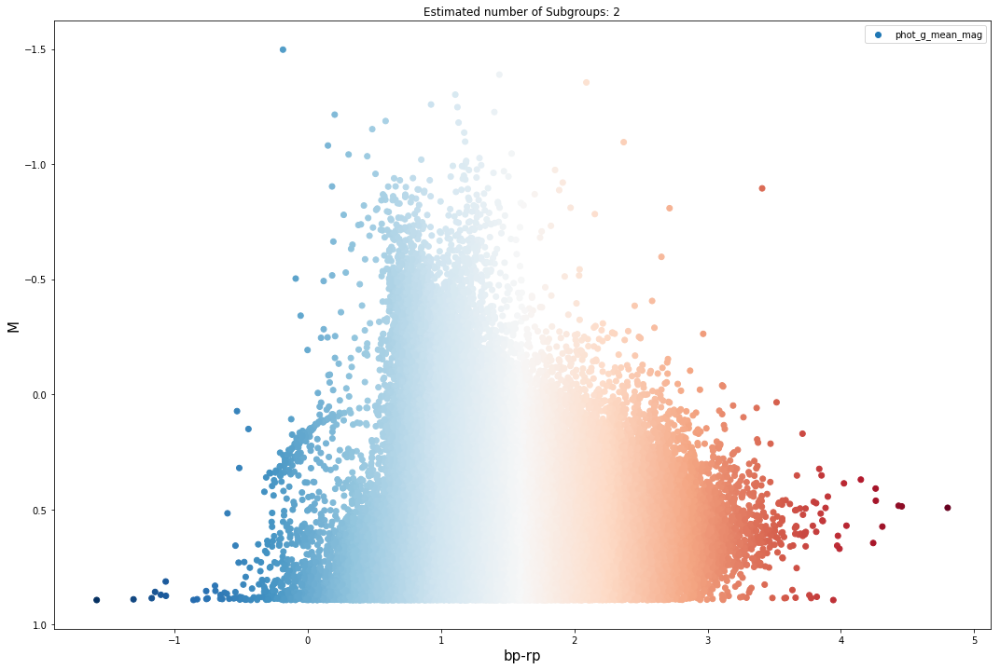

In [4]:
# DBSCAN
DB_Params =[]
DB_Params=np.transpose(DB_Params)

clust_edge2 = (np.sqrt((np.fabs(GlobClust_Log_ra_out[parallax_indx].as_matrix()-coord_ra_dec.ra.deg)**2+
                        np.fabs(GlobClust_Log_dec_out[parallax_indx].as_matrix()-coord_ra_dec.dec.deg)**2))
              >Tidal_Edge/60)

DF={#'M': GlobClust_Log_M[parallax_indx]/7, 
    'rpbp': GlobClust_Log_rpbp[parallax_indx], 
    'pmra': GlobClust_Log_pmra[parallax_indx]/40, 'pmdec': GlobClust_Log_pmdec[parallax_indx]/40}

DB_Params = pd.DataFrame(data=DF)
DB_Params=DB_Params.dropna()

print(shape(DB_Params))

#db=sklearn.cluster.DBSCAN(eps=0.028, min_samples=18, metric='euclidean', metric_params=None, algorithm='auto', 
#                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625
db=sklearn.cluster.DBSCAN(eps=0.013, min_samples=25, metric='euclidean', metric_params=None, algorithm='auto', 
                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

print(db.labels_)
print(shape(db.labels_))

fig=plt.figure(figsize=(18,12))
plt.scatter(GlobClust_Log_rpbp/1, GlobClust_Log_M/7, c=GlobClust_Log_rpbp/1, cmap='RdBu_r')
#plt.scatter(db,DB_Params)
#plt.show()

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

print('Estimated number of Subgroups: %d' % n_clusters_)

x_param3=[]
y_param3=[]

x_param4=[]
y_param4=[]

# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)
    
    #NOISE
    #xy = DB_Params[class_member_mask & ~core_samples_mask]
    #plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
    #         markeredgecolor='k', markersize=6)
    
    #CLEANED DATA
    xy = DB_Params[class_member_mask & core_samples_mask]
    
    #plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], '.', markerfacecolor=tuple(col),)
     #       )#markeredgecolor='k')#, markersize=14)
    
    x_param3.append(xy.loc[:, "rpbp"])
    y_param3=x_param3
    #y_param3.append(xy.loc[:, "M"]*7)

    #x_param4.append(xy.loc[:, "pmra"]*0.35)
    #y_param4.append(xy.loc[:, "pmdec"]*0.3)
    
    #x_param5.append(xy.loc[:, "ra"]*0.35)
    #y_param5.append(xy.loc[:, "dec"]*0.3)

plt.gca().invert_yaxis()
plt.title('Estimated number of Subgroups: %d' % n_clusters_)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)

plt.legend()
plt.show()
#fig.savefig('GC_DBSCAN'+ GlobClust_Log_ID[0] +'eps0p165-mins10_coreCMD-fullsetiponfullcmd.png')

In [5]:
x_out3 = pd.DataFrame(x_param3)#, index=None)#, mangle_dupe_cols=True)
#x_out3.reset_index()
x_out3 = x_out3.transpose() 
x_out3 = x_out3.loc[:,~x_out3.columns.duplicated()]
#x_out3 = x_out3["rpbp"].as_matrix()
x_out3

y_out3 = pd.DataFrame(y_param3)#, index=None)#, mangle_dupe_cols=True)
#y_out3.reset_index()
y_out3 = y_out3.transpose() 
y_out3 = y_out3.loc[:,~y_out3.columns.duplicated()]
#y_out3 = y_out3["M"].as_matrix()
print(shape(y_out3))

GC_ra = pd.DataFrame({'ra':GlobClust_Log_ra})
GC_dec = pd.DataFrame({'dec':GlobClust_Log_dec})
GC_pmra = pd.DataFrame({'pmra':GlobClust_Log_pmra})
GC_pmdec = pd.DataFrame({'pmdec':GlobClust_Log_pmdec})

ra_DB = GC_ra.reindex(x_out3.index)
dec_DB = GC_dec.reindex(y_out3.index)
pmra_DB = GC_pmra.reindex(x_out3.index)
pmdec_DB = GC_pmdec.reindex(y_out3.index)
M_DB = GlobClust_Log_M.reindex(y_out3.index)
rpbp_DB = GlobClust_Log_rpbp.reindex(y_out3.index)

pmra_DB_norm = (pmra_DB-pmra_DB.mean())#/(pmra_DB.mean())
pmdec_DB_norm = (pmdec_DB-pmdec_DB.mean())#/(pmdec_DB.mean())

print('\n', pmra_DB.mean(), '\n')
print('\n', pmdec_DB.mean())

(2711, 1)

 pmra    4.306513
dtype: float64 


 pmdec   -5.692245
dtype: float64


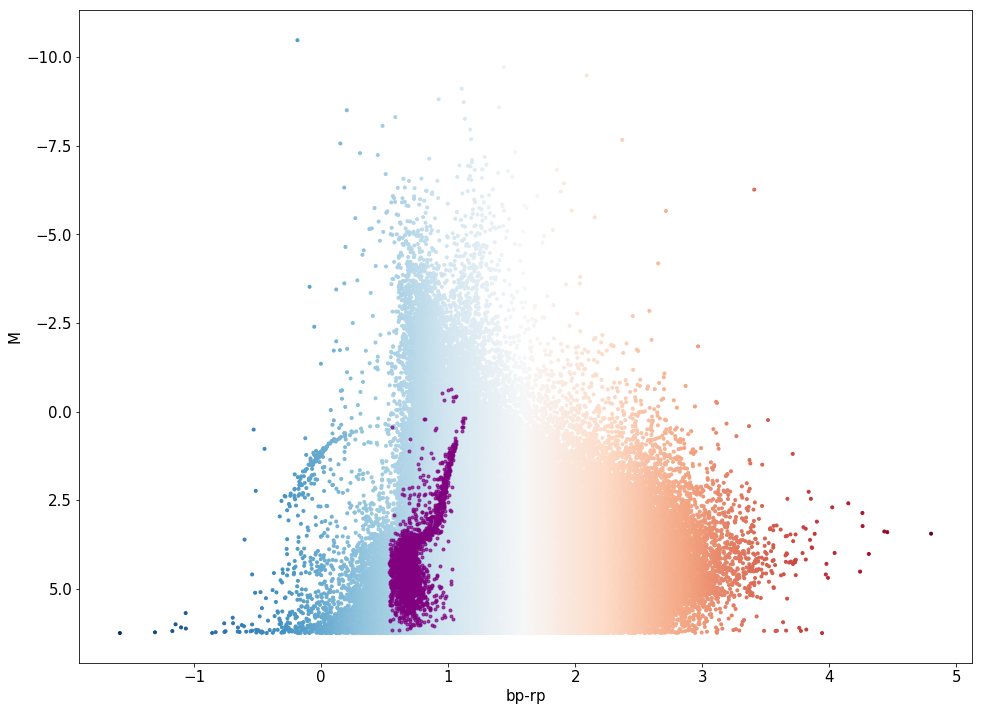

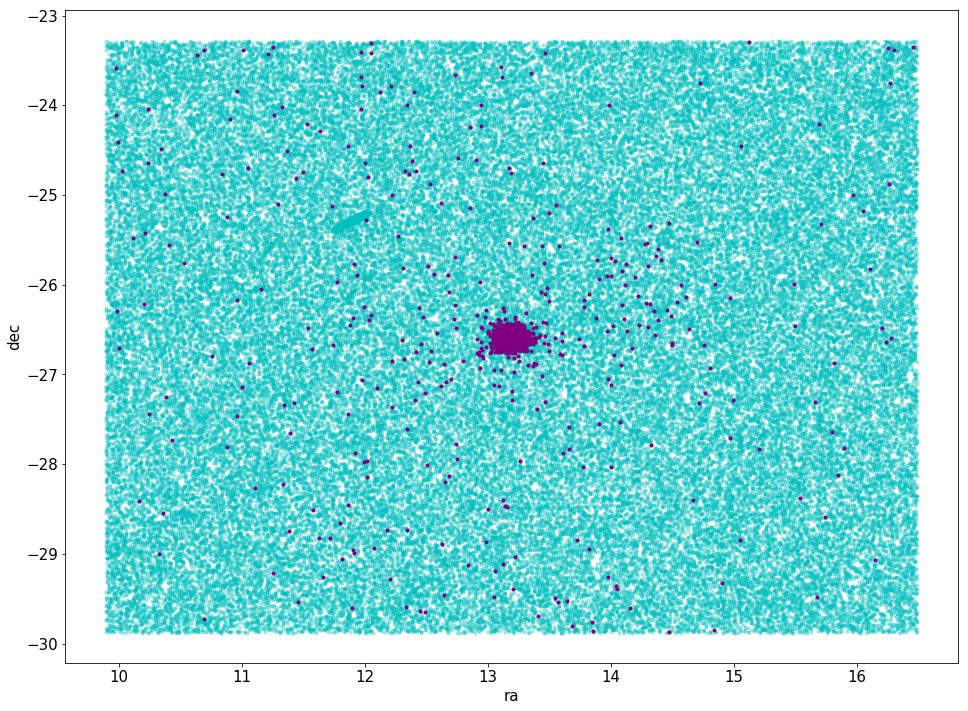

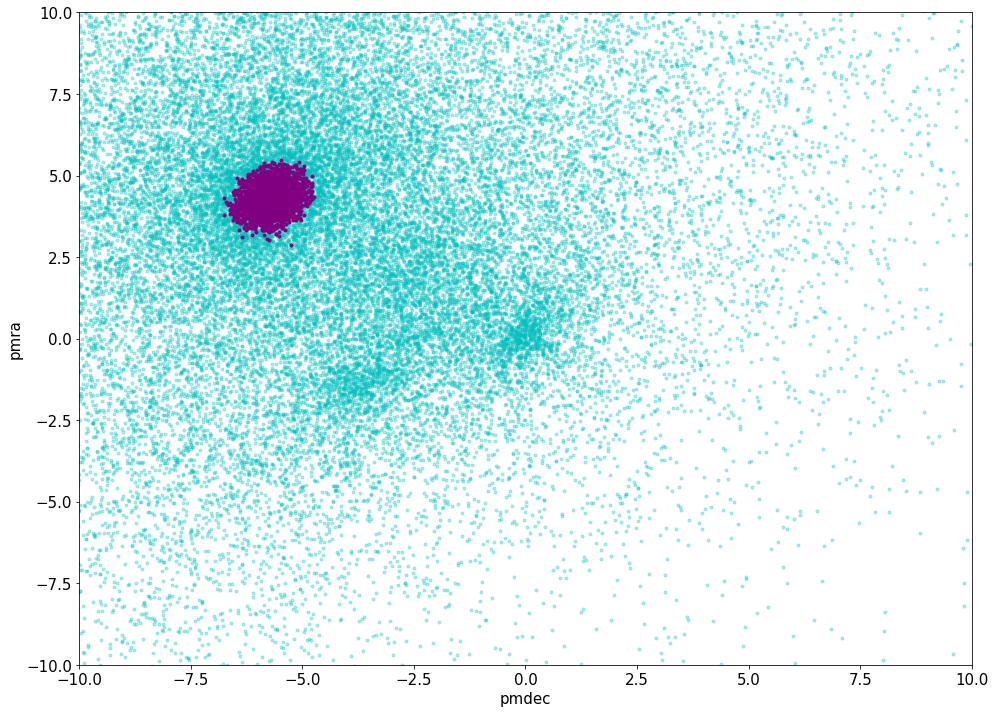

In [6]:
fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r', marker='.')
plt.scatter(x=rpbp_DB, y=M_DB, c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().invert_yaxis()
plt.show()

fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB, y=dec_DB, c='purple', marker='.')#, alpha=0.2)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

fig=plt.figure(figsize=(16,12))
#plt.hexbin(GlobClust_Log_pmdec_out, GlobClust_Log_pmra_out, extent=[-10,10, -10,10], bins='log',gridsize=200)
plt.scatter(x=GlobClust_Log_pmdec_out[parallax_indx], y=GlobClust_Log_pmra_out[parallax_indx], c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=pmdec_DB, y=pmra_DB, c='purple', marker='.')#, alpha=0.2)
plt.ylabel('pmra', fontsize=15)
plt.xlabel('pmdec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().set_ylim([-10,10])
plt.gca().set_xlim([-10,10])
#plt.gca().set_ylim([3.2, 4.7])
#plt.gca().set_xlim([-7.5,-3])
plt.show()

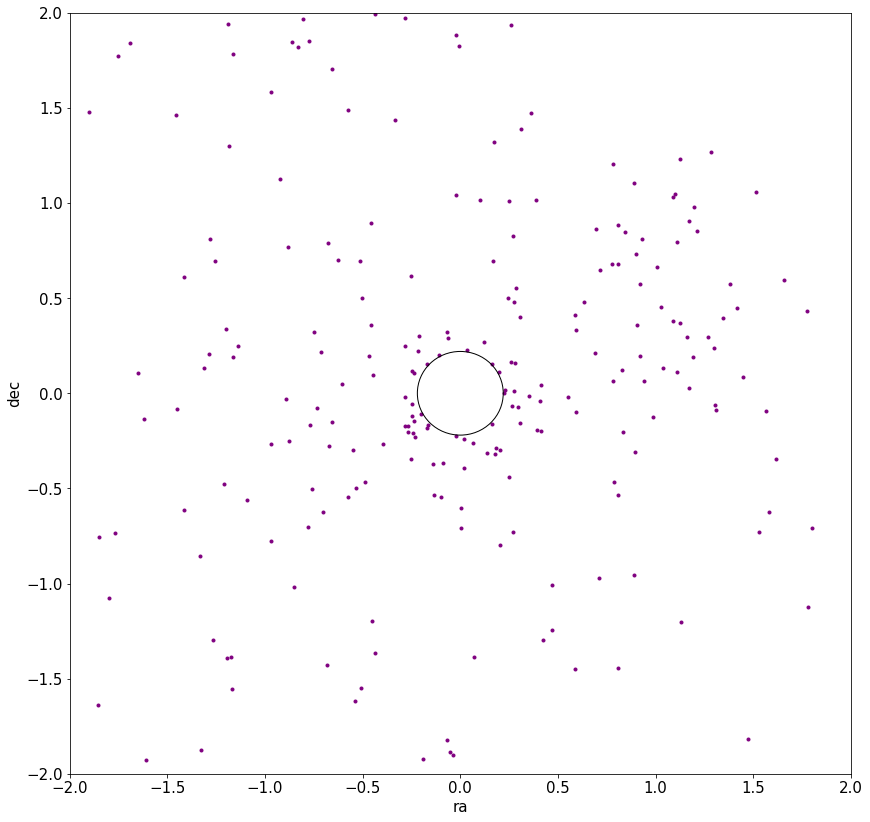

In [7]:
clust_indx = (np.sqrt((np.fabs(ra_DB.as_matrix()-coord_ra_dec.ra.deg)**2+np.fabs(dec_DB.as_matrix()-coord_ra_dec.dec.deg)**2))
              >Tidal_Edge/60)
#(np.sqrt(np.fabs((ra_DB-coord_ra_dec.ra.deg)**2+(dec_DB-coord_ra_dec.dec.deg)**2))<Clust_Edge/60)


fig=plt.figure(figsize=(14,14))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_pmra_out, y=GlobClust_Log_pmdec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB[clust_indx]-coord_ra_dec.ra.deg, y=dec_DB[clust_indx]-coord_ra_dec.dec.deg, c='purple', marker='.')#, alpha=0.2)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
circle = plt.Circle((0,0), GlobClust_Log_r_t/60*4, color='b', fill=False, lw=2)
#ax.add_artist(circle)
circle2 = plt.Circle((0,0), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=1)
ax.add_artist(circle2)
circle3 = plt.Circle((0,0), 5/60, color='pink', fill=False, lw=2)
#ax.add_artist(circle3)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().set_ylim([-2, 2])
plt.gca().set_xlim([-2,2])
plt.gca().tick_params(labelsize=15)
plt.show()

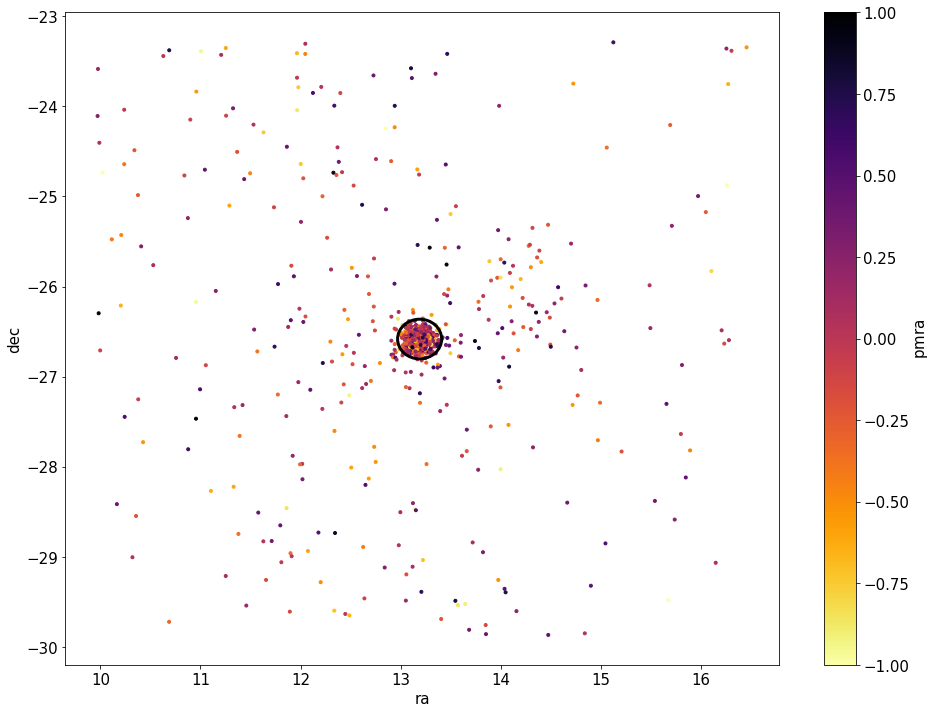

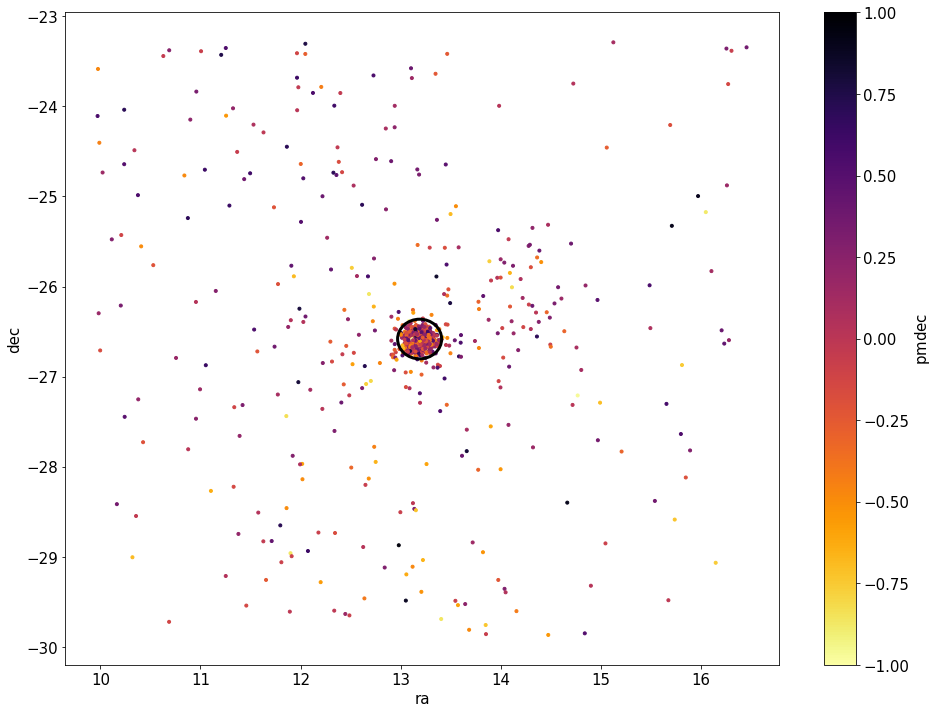

In [8]:
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB, y=dec_DB, c=pmra_DB_norm, cmap='inferno_r', marker='.', vmin=-1, vmax=1)#, alpha=0.2)
#plt.scatter(x=ra_DB, y=dec_DB, c=pmdec_DB_norm, cmap='inferno', marker='.', vmin=-1, vmax=1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60*4, color='b', fill=False, lw=5)
#ax.add_artist(circle)
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=3)
ax.add_artist(circle2)
circle3 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), 5/60, color='pink', fill=False, lw=2)
#ax.add_artist(circle3)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB, y=dec_DB, c=pmdec_DB_norm, cmap='inferno_r', marker='.', vmin=-1, vmax=1)#vmin=-0.1, vmax=.1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60*4, color='b', fill=False, lw=5)
#ax.add_artist(circle)
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=3)
ax.add_artist(circle2)
circle3 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), 5/60, color='pink', fill=False, lw=2)
#ax.add_artist(circle3)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

In [35]:
shape(x)

(3520, 1)

2711 2711
(2711,)


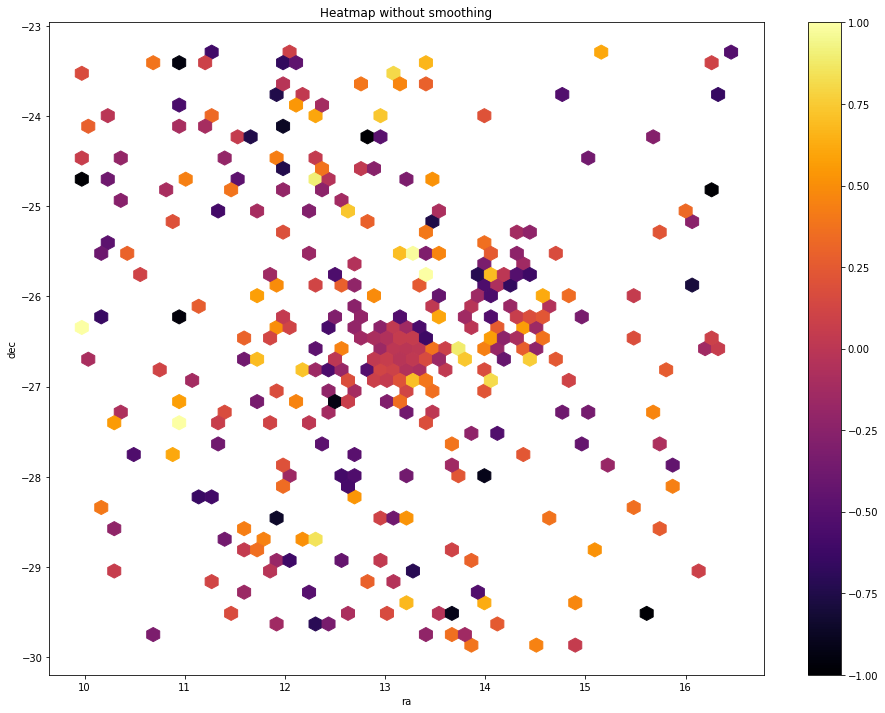

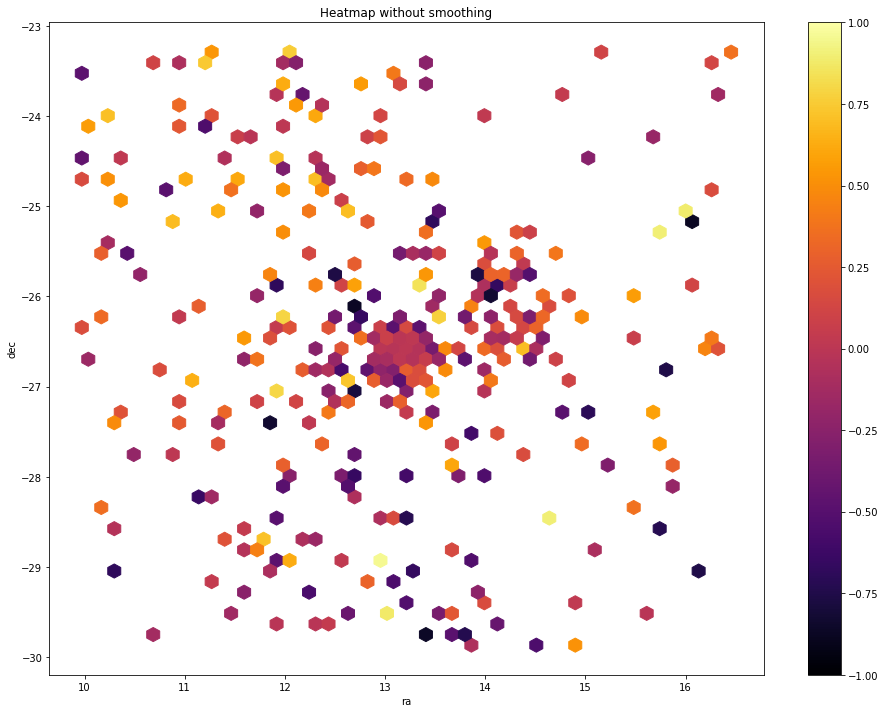

In [11]:
x=ra_DB[~numpy.isnan(ra_DB)]
y=dec_DB[~numpy.isnan(dec_DB)]
x=np.array(x)
y=np.array(y)
print(len(x),len(y))
print(x[:,0].shape)

fig=plt.figure(figsize=(16,12))
# normal distribution center at x=0 and y=5
plt.hexbin(x[:,0], y[:,0], C=pmra_DB_norm, cmap='inferno', gridsize=50,vmin=-1,vmax=1)#, extent=[11,17,  -23,-29])
plt.colorbar()
plt.title('Heatmap without smoothing')
plt.ylabel("dec")
plt.xlabel("ra")
fig=plt.figure(figsize=(16,12))
# normal distribution center at x=0 and y=5
plt.hexbin(x[:,0], y[:,0], C=pmdec_DB_norm, cmap='inferno', gridsize=50,vmin=-1,vmax=1)#, extent=[11,17,  -23,-29])
plt.colorbar()
plt.title('Heatmap without smoothing')
plt.ylabel("dec")
plt.xlabel("ra")

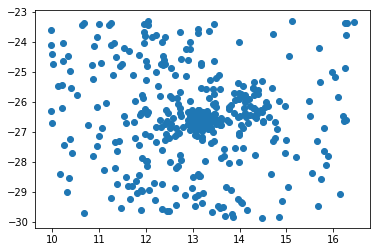

In [12]:
plt.scatter(ra_DB,dec_DB)

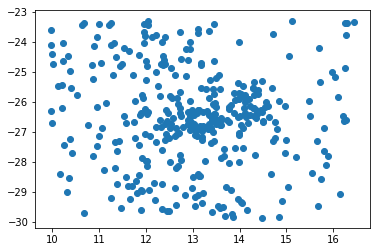

In [17]:
plt.scatter(ra_kde,dec_kde)
#plt.gca().set_xlim([13-0.2,13+0.2,])
#plt.gca().set_ylim([-26-0.2,-26+0.2,])

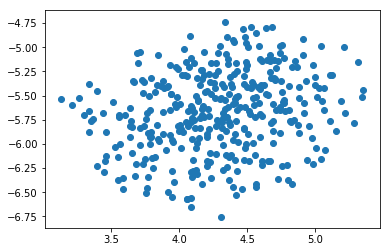

In [16]:
plt.scatter(pmra_kde,pmdec_kde)

(364, 1)
(364, 1)
[0.    0.006 0.012 0.018 0.024 0.03  0.036 0.042 0.048 0.054 0.06  0.066
 0.072 0.078 0.084 0.09  0.096]


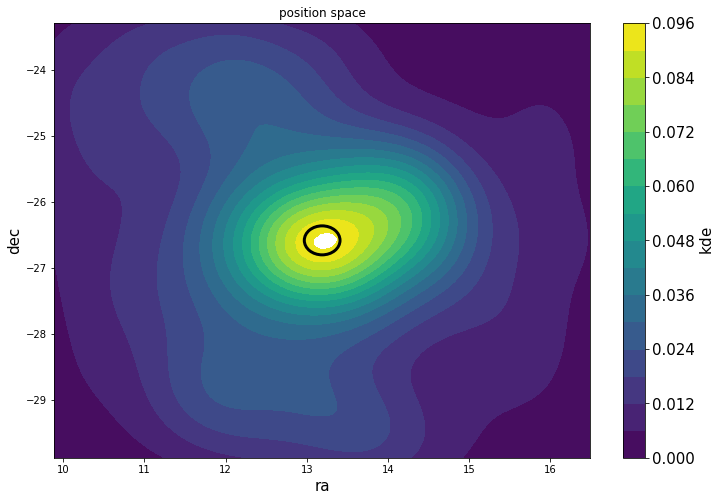

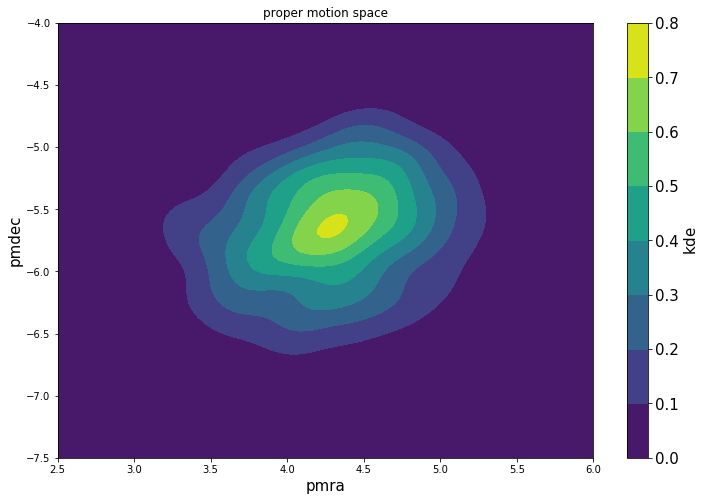

In [20]:
pmra_kde=pmra_DB[clust_indx].as_matrix()
pmdec_kde=pmdec_DB[clust_indx].as_matrix()
print(shape(pmdec_kde))
#pmra_kde=pmra_DB.as_matrix()
#pmdec_kde=pmdec_DB.as_matrix()
#print(shape(pmdec_kde))

ra_kde=ra_DB[clust_indx].as_matrix()
dec_kde=dec_DB[clust_indx].as_matrix()
print(shape(pmdec_kde))
#ra_kde=ra_DB.as_matrix()
#dec_kde=dec_DB.as_matrix()
#print(shape(pmdec_kde))

pmra_kde_1 = 0-10 
pmra_kde_2 = 0+10
pmdec_kde_1 = 0-10
pmdec_kde_2 = 0+10


findx=(np.isfinite(pmra_kde))*(np.isfinite(pmdec_kde))*(pmra_kde<pmra_kde_2)*(pmra_kde>pmra_kde_1)*(pmdec_kde>pmdec_kde_1)*(pmdec_kde<pmdec_kde_2)

from scipy import stats
from matplotlib import colors, ticker, cm

#pmra_kde=pmra_DB.as_matrix()[findx]
#pmdec_kde=pmdec_DB.as_matrix()[findx]

#pmra_kde=pmra_DB.dropna().as_matrix()
#pmdec_kde=pmdec_DB.dropna().as_matrix()

r_t = GlobClust_Log_r_t.as_matrix()
r_t = r_t[0]

ra_kde_1 = coord_ra_dec.ra.deg-r_t/60*15
ra_kde_2 = coord_ra_dec.ra.deg+r_t/60*15
dec_kde_1 = coord_ra_dec.dec.deg-r_t/60*15
dec_kde_2 = coord_ra_dec.dec.deg+r_t/60*15


#KDE part
k = stats.gaussian_kde([ra_kde[findx], dec_kde[findx]], )
xi, yi = np.mgrid[ra_kde_1:ra_kde_2:100*1j, 
                  dec_kde_1:dec_kde_2:100*1j]
#xi, yi = np.mgrid[12:14:100*1j, 
#                  -28:-26:100*1j]
#print(xi,yi,k)
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
zii=zi.reshape(xi.shape)

contours = np.arange(0,0.1, 0.006)
print(contours)

fig=plt.figure(figsize=(12,8))
ax=plt.gca()
plt.contourf(xi, yi, zii , levels=contours)#[0,0.025,0.05,0.075,0.1])# locator=ticker.LogLocator())
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=3)
ax.add_artist(circle2)
plt.title('position space')
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{kde}$',fontsize=15)

#KDE part
k = stats.gaussian_kde([pmra_kde[findx], pmdec_kde[findx]], )
xi, yi = np.mgrid[2.5:6:100*1j, 
                  -7.5:-4:100*1j]
#print(xi,yi,k)
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
zii=zi.reshape(xi.shape)

fig=plt.figure(figsize=(12,8))
plt.contourf(xi, yi, zii ,)# locator=ticker.LogLocator())
plt.title('proper motion space')
plt.xlabel('pmra', fontsize=15)
plt.ylabel('pmdec', fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{kde}$',fontsize=15)

(2711, 1)
/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:33: RuntimeWarning: invalid value encountered in log10

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:34: RuntimeWarning: invalid value encountered in log10

(364,)


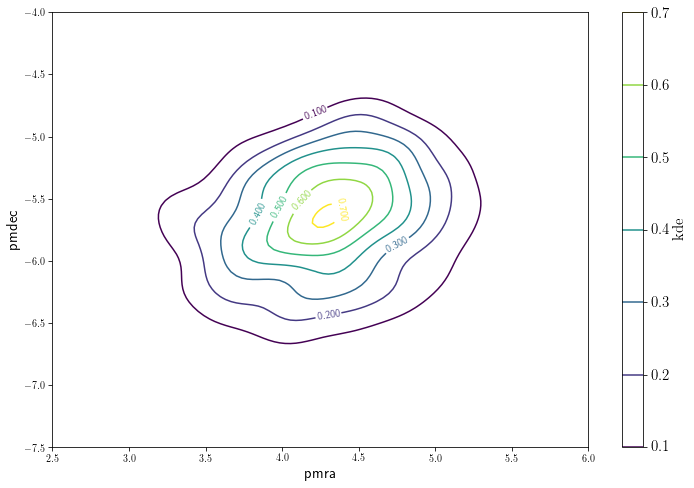

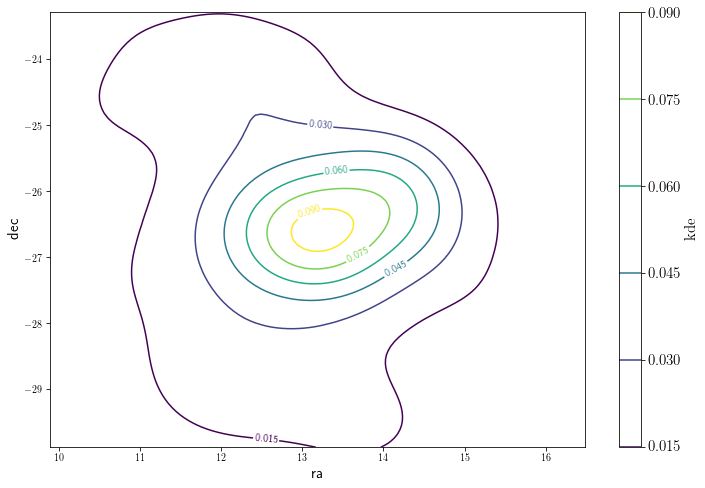

In [30]:
pmra_kde=pmra_DB[clust_indx].as_matrix()
pmdec_kde=pmdec_DB[clust_indx].as_matrix()

print(shape(clust_indx))

#pmra_kde=pmra_DB.as_matrix()
#pmdec_kde=pmdec_DB.as_matrix()

#pmra_kde_1 = 0-10 
#pmra_kde_2 = 0+10
#pmdec_kde_1 = 0-10
#pmdec_kde_2 = 0+10

findx=(np.isfinite(pmra_kde))*(np.isfinite(pmdec_kde))#*(pmra_kde<2.*np.pi)*(pmra_kde>0.)*(pmdec_kde>-1.)*(pmdec_kde<1.)

from scipy import stats
from matplotlib import colors, ticker, cm

#pmra_kde=pmra_DB.as_matrix()[findx]
#pmdec_kde=pmdec_DB.as_matrix()[findx]

#pmra_kde=pmra_DB.dropna().as_matrix()
#pmdec_kde=pmdec_DB.dropna().as_matrix()

r_t = GlobClust_Log_r_t.as_matrix()
r_t = r_t[0]

#ra_kde_1 = 0-r_t/60*15
#ra_kde_2 = 0+r_t/60*15
#dec_kde_1 = 0-r_t/60*15
#dec_kde_2 = 0+r_t/60*15

lev_exp = np.arange(np.floor(np.log10(pmra_DB_norm[~numpy.isnan(pmra_DB_norm)]).min()-1),
                    np.ceil(np.log10(pmra_DB_norm[~numpy.isnan(pmra_DB_norm)]).max()+1))
levs = np.power(10, lev_exp)

print(shape(pmra_kde[findx]))


#KDE part
k = stats.gaussian_kde([pmra_kde[findx], pmdec_kde[findx]], )
xi, yi = np.mgrid[2.5:6:100*1j, 
                  -7.5:-4:100*1j]
#print(xi,yi,k)
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
zii=zi.reshape(xi.shape)

fig=plt.figure(figsize=(12,8))
CS=plt.contour(xi, yi, zii, )# levs, norm=colors.LogNorm())#locator=ticker.LogLocator())
plt.xlabel('pmra', fontsize=15)
plt.ylabel('pmdec', fontsize=15)
plt.clabel(CS, inline=1, fontsize=10, )
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{kde}$',fontsize=15)

#KDE part
k = stats.gaussian_kde([ra_kde[findx], dec_kde[findx]], )
xi, yi = np.mgrid[ra_kde_1:ra_kde_2:100*1j, 
                  dec_kde_1:dec_kde_2:100*1j]
#print(xi,yi,k)
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
zii=zi.reshape(xi.shape)

fig=plt.figure(figsize=(12,8))
CS=plt.contour(xi, yi, zii )#, levs, norm=colors.LogNorm())#locator=ticker.LogLocator())
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
plt.clabel(CS, inline=1, fontsize=10, )
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{kde}$',fontsize=15)

In [39]:
shape(pmra_DB_norm.as_matrix())
#type(pmra_DB_norm)
pmra_DB_norm.as_matrix()
#pd.DataFrame({'prma': pmra_DB_norm.as_matrix()}, index=[0])
shape(pmra_DB_norm_a)
#pmra_DB_norm_a
shape(GC_pmra)
type(ra_DB)

pandas.core.frame.DataFrame

In [40]:
shape(pmra_DB_norm.as_matrix())
GC_pmradec["pmra"].dropna().min()

shape(pmra_DB_norm.as_matrix())
GC_pmradec["pmra"].dropna().min()

GC_pmradec.to_csv('GC_pmradec_NGC288.csv', index=True, header=True)

#CMD_raw = {'bprp': GlobClust_Log_rpbp, 'M': GlobClust_Log_M, 'ra': GlobClust_Log_ra_out, 'dec': GlobClust_Log_dec_out}
    #CMD_plot = pd.DataFrame(data=CMD_raw)
    #CMD_plot.to_csv('out_CMD_'+ GC_IDs[i] +'_rawplot.csv', index=True, header=True)
    
    #GC_StarsPlot = {'bprp indx': GlobClust_Log_rpbp[indx], 'M indx': GlobClust_Log_M[indx], 'ra': GlobClust_Log_ra_out,\
    #                'dec': GlobClust_Log_dec_out}
    #GC_StarscutPlot = pd.DataFrame(data=GC_StarsPlot)
    #GC_StarscutPlot.to_csv('out_GCStars_'+ GC_IDs[i] +'_cutplot_r_c.csv', index=True, header=True)

In [120]:
len(WT2_aa) > 1 and np.min(np.diff(WT2_aa)) <= 0.0
np.min(np.diff(WT2_aa))
np.diff(WT2_aa)

array([1.34444445e-01, 2.44887164e-03, 4.07320735e-03, 1.94363691e-02,
       1.21542191e-02, 2.77032893e-02, 6.63585763e-03, 4.64564540e-02,
       5.62473113e-03, 9.45425252e-03, 4.04155461e-02, 4.14918929e-02,
       2.99914111e-02, 2.34549478e-03, 6.75522203e-04, 2.02335746e-02,
       2.07066854e-02, 2.02969405e-02, 4.92178185e-03, 1.40522509e-02,
       8.84826702e-04, 2.00322747e-03, 2.14791665e-03, 6.07928955e-02,
       5.11781787e-03, 1.40027312e-02, 2.05184762e-02, 2.77367600e-03,
       1.30152601e-03, 3.76692983e-02, 3.00626158e-02, 1.30925536e-02,
       5.65960180e-03, 3.05288159e-02, 3.88625108e-03, 7.29971118e-03,
       4.09348270e-04, 8.31874144e-03, 1.16618187e-02, 9.42501344e-03,
       4.99101150e-03, 3.25438574e-02, 3.13163657e-03, 9.74694476e-03,
       2.28819515e-02, 1.25635007e-02, 2.13659250e-02, 5.23238555e-03,
       5.05419091e-03, 1.26764540e-02, 4.04746468e-03, 1.33342878e-03,
       5.24118811e-03, 5.41498292e-03, 3.17489788e-03, 1.35457174e-02,
      

pmra_DB: (2711, 1) 
 pmra norm a: (2711, 1)

 GC_pmradec_a 1: (256, 32)
GC_pmradec: (2711, 2)

 GC_pmradec_a 2: (256, 32)
(220,)
(220,)
(220,)
(220,)


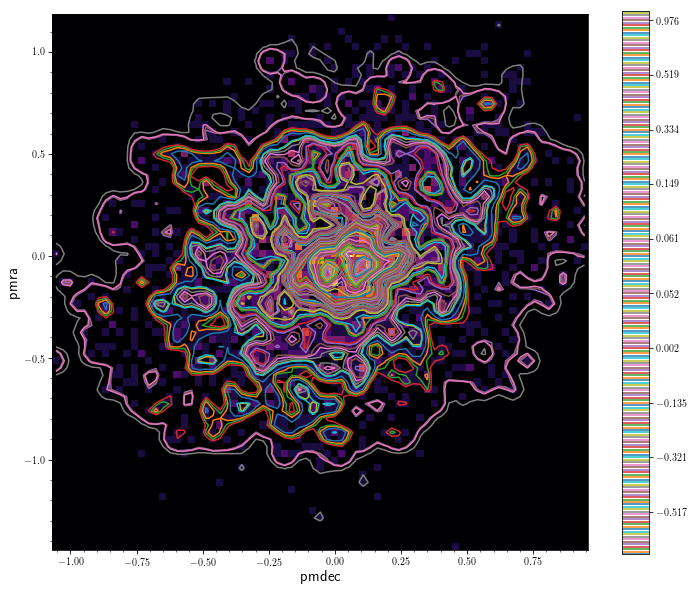

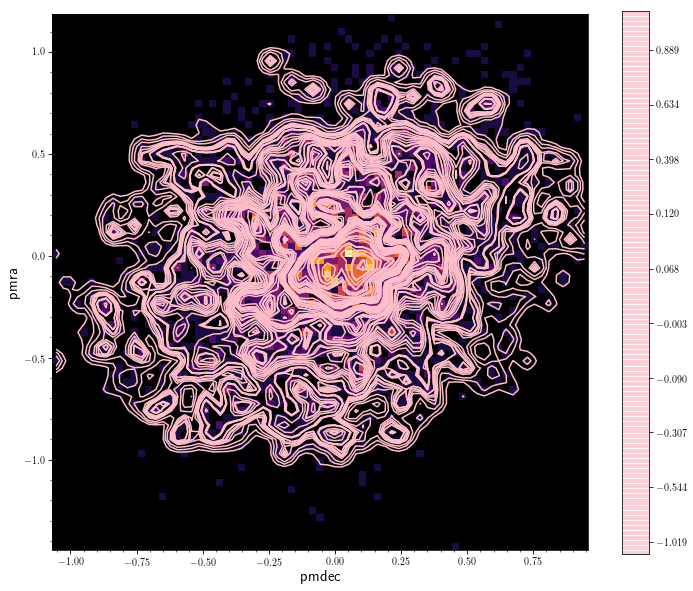

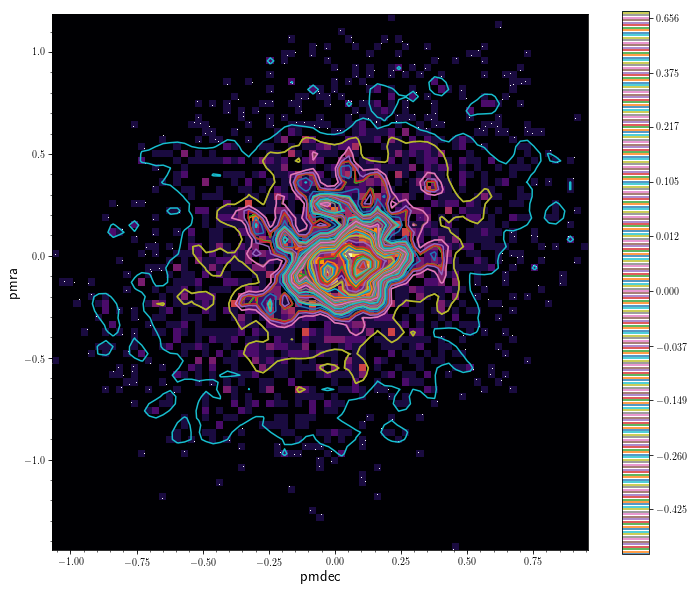

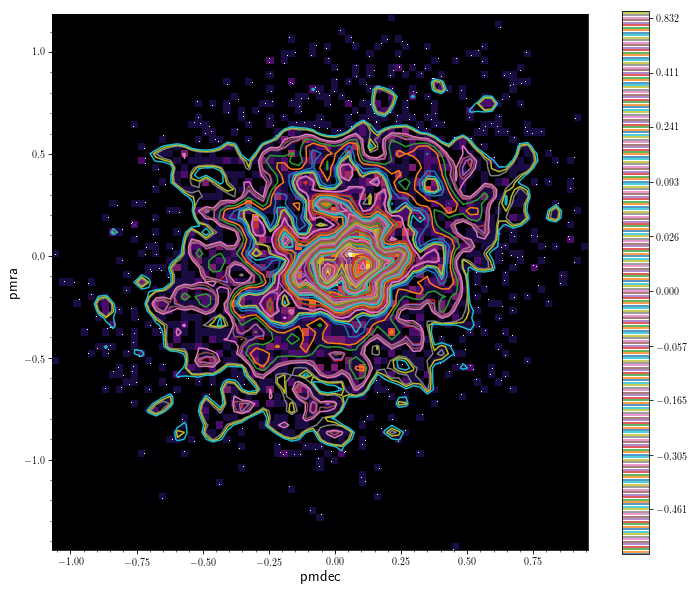

In [19]:
# Wavelet Transform plots for all 4 coefficients
# plots in proper motions

import pywt

pmra_DB_norm_a = (pmra_DB-pmra_DB.mean())#.as_matrix()#/(pmra_DB.mean())
pmdec_DB_norm_a = (pmdec_DB-pmdec_DB.mean())#.as_matrix()#/(pmra_DB.mean())

print('pmra_DB:',shape(pmra_DB), '\n pmra norm a:', shape(pmra_DB_norm_a))


#GC_pmra=pmra_DB_norm_a
#GC_pmra=append(GC_pmra,GC_pmra.mean())
#GC_pmdec=pmdec_DB_norm_a
#GC_pmdec=append(GC_pmdec,GC_pmdec.mean())
#GC_pmra = np.pad(GC_pmra, (288,), 'mean')
#GC_pmdec = np.pad(GC_pmdec, (288,), 'mean')
#GC_pmradec = {'pmra': GC_pmra, 'pmdec': GC_pmdec}
#GC_pmradec = pd.DataFrame(GC_pmradec, )
#GC_pmradec

#WT2 = pywt.swtn([GC_pmra, GC_pmdec], 'db4', level=1, start_level=0)
#WT2

#df=pd.DataFrame(pmra_DB.mean()).transpose()
#df=pd.concat([df]*992, ignore_index=True)
#df_pmra=df.append(pmra_DB).append(df)

#df=pd.DataFrame(pmdec_DB.mean()).transpose()
#df=pd.concat([df]*992, ignore_index=True)
#df_pmdec=df.append(pmdec_DB).append(df)

#df_pmradec=df_pmra.join(df_pmdec)

#GC_pmra=pmra_DB.as_matrix()
#GC_pmra=append(GC_pmra,GC_pmra.mean())
#GC_pmdec=pmdec_DB.as_matrix()
#GC_pmdec=append(GC_pmdec,GC_pmdec.mean())
#GC_pmra = np.pad(GC_pmra, (3000,), 'mean')
#GC_pmdec = np.pad(GC_pmdec, (992,), 'mean')
#GC_pmradec = {'pmra': GC_pmra, 'pmdec': GC_pmdec}
#GC_pmradec = pd.DataFrame(GC_pmradec)
#GC_pmradec

GC_pmradec=pmra_DB_norm_a.join(pmdec_DB_norm_a)
GC_pmra = pmra_DB_norm_a
GC_pmdec = pmdec_DB_norm_a
GC_pmradec_a = GC_pmradec.as_matrix()

#GC_pmradec_a = reshape(GC_pmradec.as_matrix(), (220,32))
#GC_pmradec_a = pad(GC_pmradec_a, [(4, 0), (0, 0)], 'mean')
GC_pmradec_a = pad(GC_pmradec_a, [(9, 0), (0, 0)], 'mean')
GC_pmradec_a = reshape(GC_pmradec_a, (170,32))
GC_pmradec_a = pad(GC_pmradec_a, [(86, 0), (0, 0)], 'mean')
#GC_pmradec_a = pad(GC_pmradec, [(1385, 0), (0, 0)], 'mean')
print('\n GC_pmradec_a 1:',shape(GC_pmradec_a))
#GC_pmradec_a = reshape(GC_pmradec_a, (256,32))
#GC_pmradec_a = reshape(GC_pmradec_a, (512,16))
#GC_pmradec_a = pad(GC_pmradec, [(1385, 0), (0, 0)], 'mean')
print('GC_pmradec:',shape(GC_pmradec))
print('\n GC_pmradec_a 2:',shape(GC_pmradec_a))

WT2 = pywt.swtn(GC_pmradec_a, 'db4', level=3, start_level=0)
WT2

WT2_aa=WT2[0].get("aa")[:,0]
WT2_aa=WT2_aa[~numpy.isnan(WT2_aa)]
WT2_aa.sort()
#print(WT2_aa)

WT2_ad=WT2[0].get("ad")[:,0]
WT2_ad=WT2_ad[~numpy.isnan(WT2_ad)]
WT2_ad.sort()
#print(WT2_ad)

WT2_da=WT2[0].get("da")[:,0]
WT2_da=WT2_da[~numpy.isnan(WT2_da)]
WT2_da.sort()
#print(WT2_da)

WT2_dd=WT2[0].get("dd")[:,0]
WT2_dd=WT2_dd[~numpy.isnan(WT2_dd)]
WT2_dd.sort()
#print(WT2_dd)

colours = arange(0.1,len(WT2_aa)+1,0.1)
prop_cycle = plt.rcParams['axes.prop_cycle']
colors = prop_cycle.by_key()['color']

WT_plus_aa = (np.diff(WT2_aa) != 0)#*(np.diff(WT2_aa)<0)
WT_plus_aa=np.append(WT_plus_aa, True)
print(shape(WT2_aa[WT_plus_aa]))
WT2_aa = WT2_aa[WT_plus_aa]
WT2_aa.sort()

WT_plus_ad = (np.diff(WT2_ad) != 0)#*(np.diff(WT2_aa)<0)
WT_plus_ad=np.append(WT_plus_ad, True)
print(shape(WT2_ad[WT_plus_ad]))
WT2_ad = WT2_ad[WT_plus_ad]
WT2_ad.sort()

WT_plus_da = (np.diff(WT2_da) != 0)#*(np.diff(WT2_aa)<0)
WT_plus_da=np.append(WT_plus_da, True)
print(shape(WT2_da[WT_plus_da]))
WT2_da = WT2_da[WT_plus_da]
WT2_da.sort()

WT_plus_dd = (np.diff(WT2_dd) != 0)#*(np.diff(WT2_aa)<0)
WT_plus_dd=np.append(WT_plus_dd, True)
print(shape(WT2_dd[WT_plus_dd]))
WT2_dd = WT2_dd[WT_plus_dd]
WT2_dd.sort()

fig=figure()
bovy_plot.bovy_print(fig_width=12, fig_height=10, )#axes_labelsize=16, text_fontsize=11, legend_fontsize=12, xtick_labelsize=10, ytick_labelsize=10, xtick_minor_size=2, ytick_minor_size=2, xtick_major_size=4, ytick_major_size=4)

# Proper Motion Space
bovy_plot.scatterplot(GC_pmradec["pmdec"].dropna().as_matrix(), GC_pmradec["pmra"].dropna().as_matrix(), 'w,',
                      cmap='inferno', cntrcolors=colors, levels=WT2_aa, bins=75, cntrSmooth=True)
cb=plt.colorbar()
plt.ylabel('pmra', fontsize=15)
plt.xlabel('pmdec', fontsize=15)

bovy_plot.scatterplot(GC_pmradec["pmdec"].dropna().as_matrix(), GC_pmradec["pmra"].dropna().as_matrix(), 'w,',
                      cmap='inferno', cntrcolors=['pink'], levels=WT2_ad, bins=75, cntrSmooth=True)
cb=plt.colorbar()
plt.ylabel('pmra', fontsize=15)
plt.xlabel('pmdec', fontsize=15)

bovy_plot.scatterplot(GC_pmradec["pmdec"].dropna().as_matrix(), GC_pmradec["pmra"].dropna().as_matrix(), 'w,',
                      cmap='inferno', cntrcolors=colors, levels=WT2_da, bins=75, cntrSmooth=True)
cb=plt.colorbar()
plt.ylabel('pmra', fontsize=15)
plt.xlabel('pmdec', fontsize=15)

bovy_plot.scatterplot(GC_pmradec["pmdec"].dropna().as_matrix(), GC_pmradec["pmra"].dropna().as_matrix(), 'w,',
                      cmap='inferno', cntrcolors=colors, levels=WT2_dd, bins=75, cntrSmooth=True)

cb=plt.colorbar()
plt.ylabel('pmra', fontsize=15)
plt.xlabel('pmdec', fontsize=15)


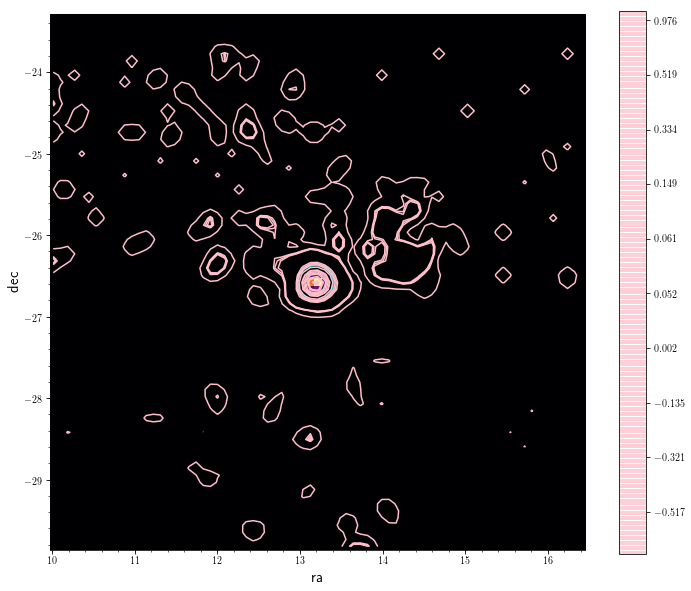

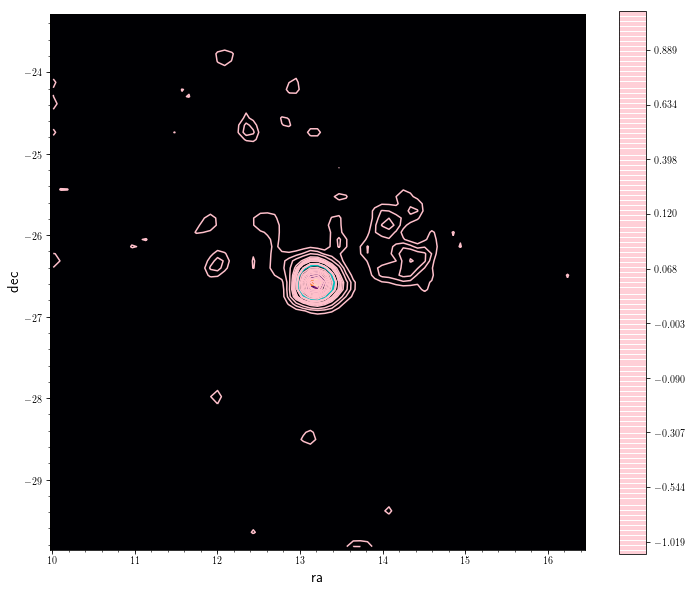

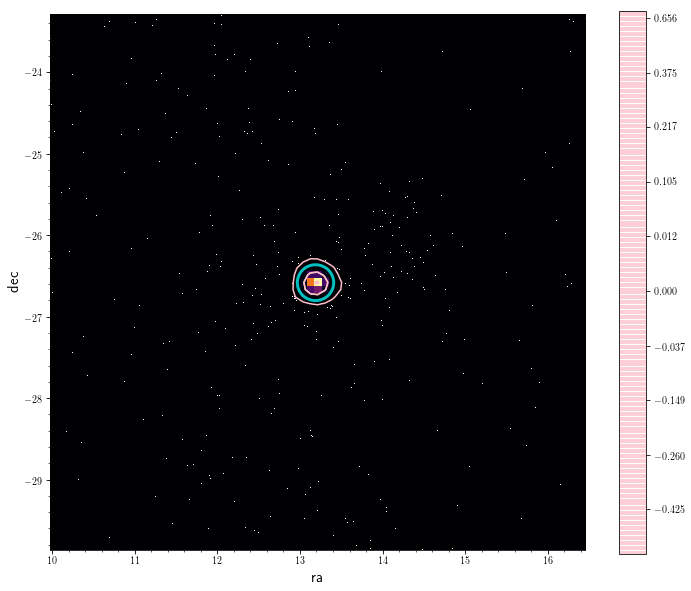

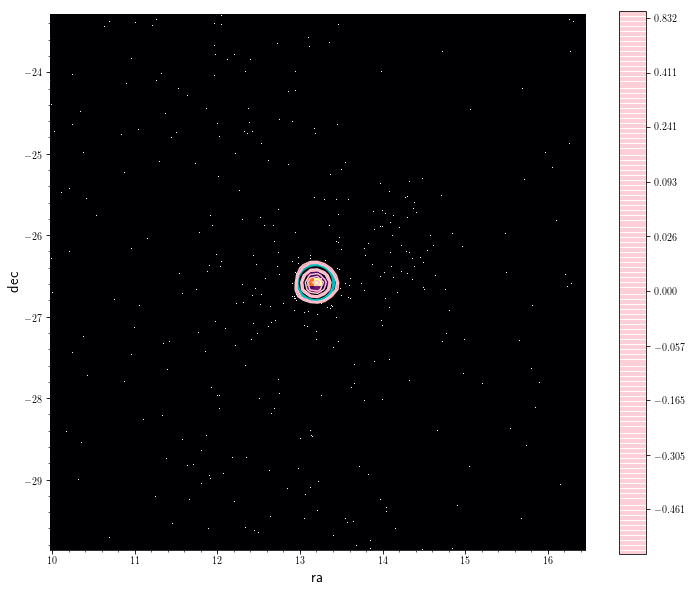

In [20]:
#Position Sapce
GC_radec=ra_DB.join(dec_DB)
fig=figure()
bovy_plot.bovy_print(fig_width=12, fig_height=10, )
bovy_plot.scatterplot(GC_radec["ra"].dropna().as_matrix(), GC_radec["dec"].dropna().as_matrix(), 'w,',
                      cmap='inferno', cntrcolors=['pink'], levels=WT2_aa, bins=75, cntrSmooth=True, gcf=True)
ax = plt.gca()
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='c', fill=False, lw=3)
ax.add_artist(circle2)
cb=plt.colorbar()
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)

fig=figure()
bovy_plot.bovy_print(fig_width=12, fig_height=10, )
bovy_plot.scatterplot(GC_radec["ra"].dropna().as_matrix(), GC_radec["dec"].dropna().as_matrix(), 'w,',
                      cmap='inferno', cntrcolors=['pink'], levels=WT2_ad, bins=75, cntrSmooth=True, gcf=True)
ax = plt.gca()
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='c', fill=False, lw=3)
ax.add_artist(circle2)
cb=plt.colorbar()
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)

fig=figure()
bovy_plot.bovy_print(fig_width=12, fig_height=10, )
bovy_plot.scatterplot(GC_radec["ra"].dropna().as_matrix(), GC_radec["dec"].dropna().as_matrix(), 'w,',
                      cmap='inferno', cntrcolors=['pink'], levels=WT2_da, bins=75, cntrSmooth=True, gcf=True)
ax = plt.gca()
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='c', fill=False, lw=3)
ax.add_artist(circle2)
cb=plt.colorbar()
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)

fig=figure()
bovy_plot.bovy_print(fig_width=12, fig_height=10, )
bovy_plot.scatterplot(GC_radec["ra"].dropna().as_matrix(), GC_radec["dec"].dropna().as_matrix(), 'w,',
                      cmap='inferno', cntrcolors=['pink'], levels=WT2_dd, bins=75, cntrSmooth=True, gcf=True)#, zorder = 0)
ax = plt.gca()
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='c', fill=False, lw=3)#, zorder=2)
ax.add_artist(circle2)

cb=plt.colorbar()
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)

plt.show()

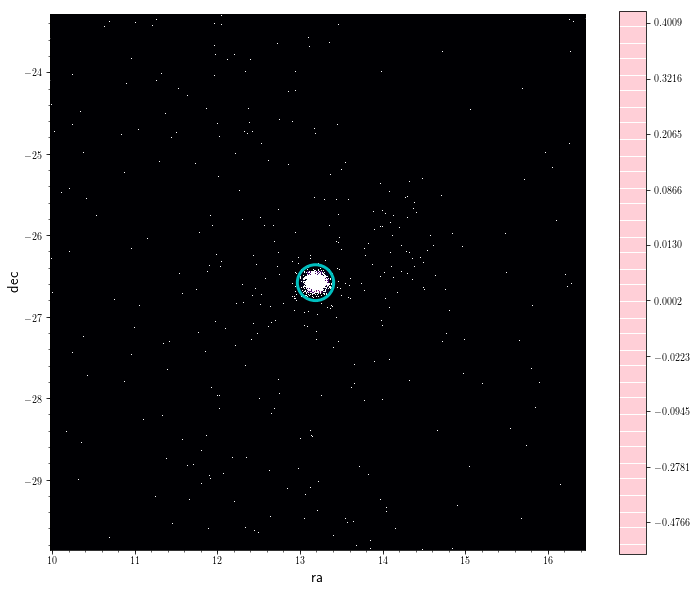

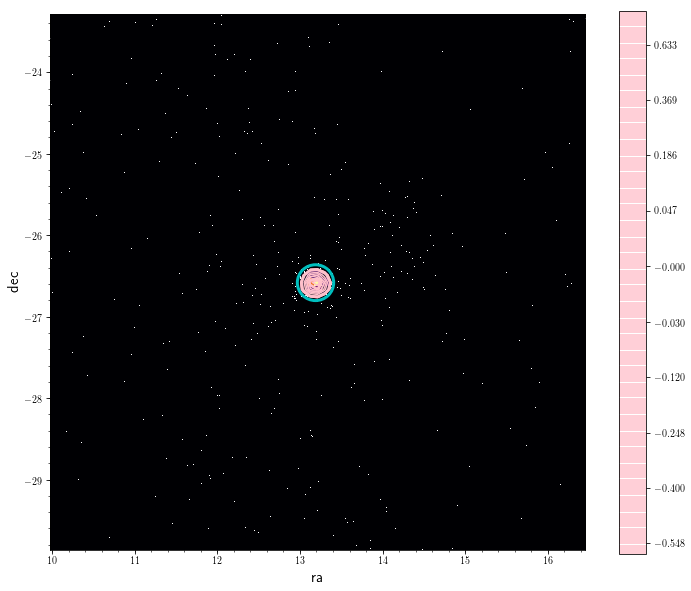

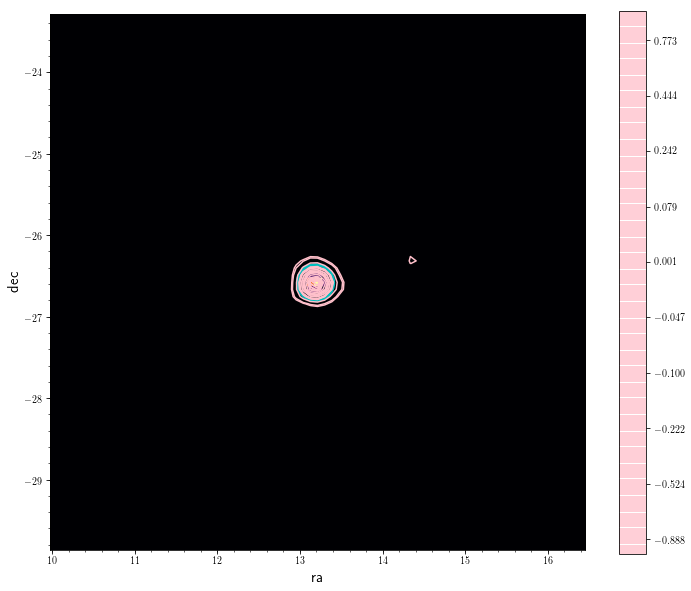

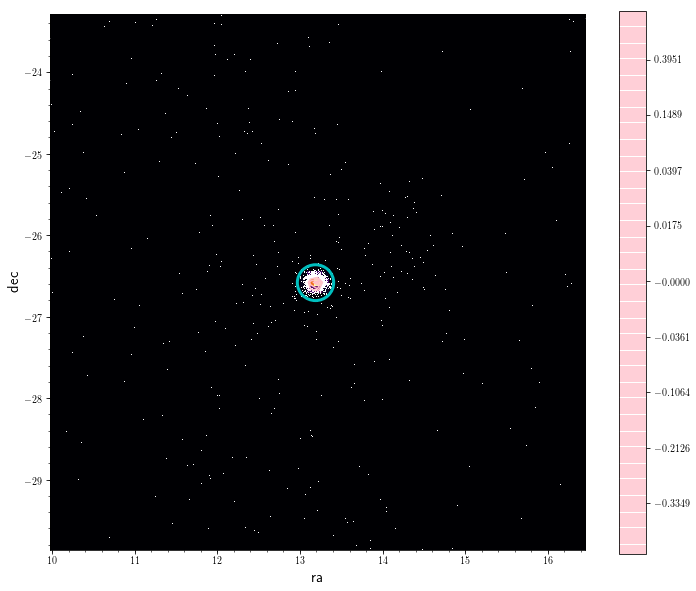

In [19]:
#Position Sapce
GC_radec=ra_DB.join(dec_DB)
fig=figure()
bovy_plot.bovy_print(fig_width=12, fig_height=10, )
bovy_plot.scatterplot(GC_radec["ra"].dropna().as_matrix(), GC_radec["dec"].dropna().as_matrix(), 'w,',
                      cmap='inferno', cntrcolors=['pink'], levels=WT2_aa, bins=75, cntrSmooth=True, gcf=True)
ax = plt.gca()
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='c', fill=False, lw=3)
ax.add_artist(circle2)
cb=plt.colorbar()
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)

fig=figure()
bovy_plot.bovy_print(fig_width=12, fig_height=10, )
bovy_plot.scatterplot(GC_radec["ra"].dropna().as_matrix(), GC_radec["dec"].dropna().as_matrix(), 'w,',
                      cmap='inferno', cntrcolors=['pink'], levels=WT2_ad, bins=75, cntrSmooth=True, gcf=True)
ax = plt.gca()
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='c', fill=False, lw=3)
ax.add_artist(circle2)
cb=plt.colorbar()
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)

fig=figure()
bovy_plot.bovy_print(fig_width=12, fig_height=10, )
bovy_plot.scatterplot(GC_radec["ra"].dropna().as_matrix(), GC_radec["dec"].dropna().as_matrix(), 'w,',
                      cmap='inferno', cntrcolors=['pink'], levels=WT2_da, bins=75, cntrSmooth=True, gcf=True)
ax = plt.gca()
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='c', fill=False, lw=3)
ax.add_artist(circle2)
cb=plt.colorbar()
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)

fig=figure()
bovy_plot.bovy_print(fig_width=12, fig_height=10, )
bovy_plot.scatterplot(GC_radec["ra"].dropna().as_matrix(), GC_radec["dec"].dropna().as_matrix(), 'w,',
                      cmap='inferno', cntrcolors=['pink'], levels=WT2_dd, bins=75, cntrSmooth=True, gcf=True)#, zorder = 0)
ax = plt.gca()
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='c', fill=False, lw=3)#, zorder=2)
ax.add_artist(circle2)

cb=plt.colorbar()
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)

plt.show()

In [69]:
WT2D = pywt.swt2(GC_pmradec_a, 'db4', level=5, start_level=0)
WT2D

/home/kaderali/.local/lib/python3.6/site-packages/pywt/_swt.py:200: FutureWarning: For consistency with the rest of PyWavelets, the order of the list returned by swt2 will be reversed in the next release. In other words, the levels will be sorted in descending rather than ascending order.
  "ascending order.", FutureWarning)



[(array([[ 0.72707025, -0.01948675, -0.43126399, ...,  0.19606302,
           0.15459187,  0.64521012],
         [ 0.25828117,  0.03482787,  0.0077401 , ...,  0.49562554,
           0.36803478,  0.28296758],
         [ 0.09745243,  0.10312588,  0.0549584 , ...,  0.15663418,
           0.06126558,  0.01379397],
         ...,
         [ 0.1914502 ,  0.6475443 ,  0.20885241, ...,  0.83237033,
          -0.05056102, -0.47657   ],
         [ 0.2961445 ,  0.26640295, -0.31169996, ...,  0.44514674,
          -0.4462915 , -0.38049946],
         [ 0.81952177,  0.05661961, -0.6810664 , ..., -0.28319453,
          -0.52320325,  0.36946068]]),
  (array([[-0.05208611, -0.05757851, -0.10175199, ...,  0.09558295,
           -0.01674511, -0.09921715],
          [-0.07926798,  0.14068766,  0.50154139, ..., -0.10554746,
            0.27550508,  0.2332516 ],
          [ 0.37565711, -0.20688293, -0.91476381, ..., -0.04434183,
           -0.64757438, -0.20692385],
          ...,
          [ 0.02815992,  0.

In [80]:
shape(WT2D)
#type(WT2D)

WT2D[1][1][1]

array([[-0.00731578, -0.91808198, -0.70056264, ..., -0.79273473,
         0.24801059,  0.88040924],
       [-0.05496787, -0.77493753, -0.60346528, ..., -0.69884296,
         0.57060118,  0.91663863],
       [-0.18690107, -0.64966297, -0.48980559, ..., -0.47206946,
         0.84023263,  0.80633755],
       ...,
       [-0.07138227, -0.62412796, -0.47436519, ..., -0.17992938,
         0.06775213,  0.35740589],
       [ 0.23192735, -0.76550419, -0.81087132, ..., -0.4486814 ,
        -0.15978561,  0.58375248],
       [ 0.19289256, -0.90810573, -0.88208862, ..., -0.63209837,
        -0.06985543,  0.73562748]])

/home/kaderali/.local/lib/python3.6/site-packages/pywt/_swt.py:200: FutureWarning: For consistency with the rest of PyWavelets, the order of the list returned by swt2 will be reversed in the next release. In other words, the levels will be sorted in descending rather than ascending order.
  "ascending order.", FutureWarning)



TypeError: Last contour arg must give levels; see help(contour)

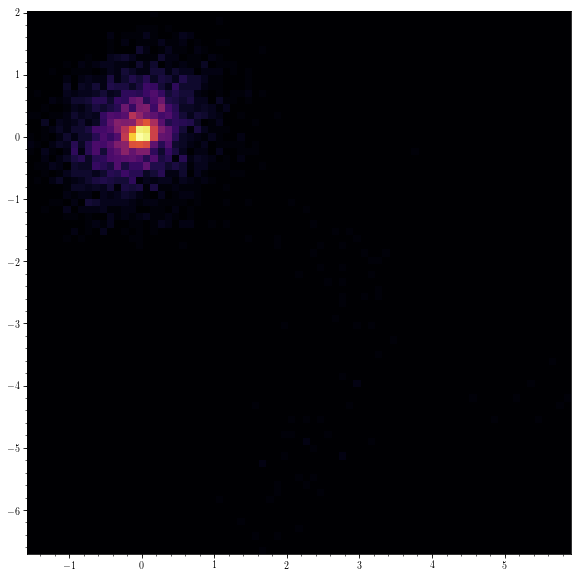

In [81]:
# Wavelet Transform plots for all 4 coefficients
# plots in proper motions

import pywt

pmra_DB_norm_a = (pmra_DB-pmra_DB.mean())#.as_matrix()#/(pmra_DB.mean())
pmdec_DB_norm_a = (pmdec_DB-pmdec_DB.mean())#.as_matrix()#/(pmra_DB.mean())

#GC_pmra=pmra_DB_norm_a
#GC_pmra=append(GC_pmra,GC_pmra.mean())
#GC_pmdec=pmdec_DB_norm_a
#GC_pmdec=append(GC_pmdec,GC_pmdec.mean())
#GC_pmra = np.pad(GC_pmra, (288,), 'mean')
#GC_pmdec = np.pad(GC_pmdec, (288,), 'mean')
#GC_pmradec = {'pmra': GC_pmra, 'pmdec': GC_pmdec}
#GC_pmradec = pd.DataFrame(GC_pmradec, )
#GC_pmradec

#WT2 = pywt.swtn([GC_pmra, GC_pmdec], 'db4', level=1, start_level=0)
#WT2

#df=pd.DataFrame(pmra_DB.mean()).transpose()
#df=pd.concat([df]*992, ignore_index=True)
#df_pmra=df.append(pmra_DB).append(df)

#df=pd.DataFrame(pmdec_DB.mean()).transpose()
#df=pd.concat([df]*992, ignore_index=True)
#df_pmdec=df.append(pmdec_DB).append(df)

#df_pmradec=df_pmra.join(df_pmdec)

#GC_pmra=pmra_DB.as_matrix()
#GC_pmra=append(GC_pmra,GC_pmra.mean())
#GC_pmdec=pmdec_DB.as_matrix()
#GC_pmdec=append(GC_pmdec,GC_pmdec.mean())
#GC_pmra = np.pad(GC_pmra, (3000,), 'mean')
#GC_pmdec = np.pad(GC_pmdec, (992,), 'mean')
#GC_pmradec = {'pmra': GC_pmra, 'pmdec': GC_pmdec}
#GC_pmradec = pd.DataFrame(GC_pmradec)
#GC_pmradec

GC_pmradec=pmra_DB_norm_a.join(pmdec_DB_norm_a)
GC_pmra = pmra_DB_norm_a
GC_pmdec = pmdec_DB_norm_a

GC_pmradec_a = reshape(GC_pmradec.as_matrix(), (220,32))
GC_pmradec_a = pad(GC_pmradec_a, [(4, 0), (0, 0)], 'mean')

WT2D = pywt.swt2(GC_pmradec_a, 'db4', level=5, start_level=0)
WT2D

WT2_aa=WT2[0].get("aa")[:,0]
WT2_aa=WT2_aa[~numpy.isnan(WT2_aa)]
WT2_aa.sort()
#print(WT2_aa)

WT2_ad=WT2[0].get("ad")[:,0]
WT2_ad=WT2_ad[~numpy.isnan(WT2_ad)]
WT2_ad.sort()
#print(WT2_ad)

WT2_da=WT2[0].get("da")[:,0]
WT2_da=WT2_da[~numpy.isnan(WT2_da)]
WT2_da.sort()
#print(WT2_da)

WT2_dd=WT2[0].get("dd")[:,0]
WT2_dd=WT2_dd[~numpy.isnan(WT2_dd)]
WT2_dd.sort()
#print(WT2_dd)

colours = arange(0.1,len(WT2_aa)+1,0.1)
prop_cycle = plt.rcParams['axes.prop_cycle']
colors = prop_cycle.by_key()['color']

fig=figure()
bovy_plot.bovy_print(fig_width=12, fig_height=10, )#axes_labelsize=16, text_fontsize=11, legend_fontsize=12, xtick_labelsize=10, ytick_labelsize=10, xtick_minor_size=2, ytick_minor_size=2, xtick_major_size=4, ytick_major_size=4)

# Proper Motion Space
bovy_plot.scatterplot(GC_pmradec["pmdec"].dropna().as_matrix(), GC_pmradec["pmra"].dropna().as_matrix(), 'w,',
                      cmap='inferno', cntrcolors=colors, levels=WT2D, bins=75, cntrSmooth=True)
cb=plt.colorbar()
plt.xlabel('pmra', fontsize=15)
plt.ylabel('pmdec', fontsize=15)

bovy_plot.scatterplot(GC_pmradec["pmdec"].dropna().as_matrix(), GC_pmradec["pmra"].dropna().as_matrix(), 'w,',
                      cmap='inferno', cntrcolors=['pink'], levels=WT2_ad, bins=75, cntrSmooth=True)
cb=plt.colorbar()
plt.xlabel('pmra', fontsize=15)
plt.ylabel('pmdec', fontsize=15)

bovy_plot.scatterplot(GC_pmradec["pmdec"].dropna().as_matrix(), GC_pmradec["pmra"].dropna().as_matrix(), 'w,',
                      cmap='inferno', cntrcolors=colors, levels=WT2_da, bins=75, cntrSmooth=True)
cb=plt.colorbar()
plt.xlabel('pmra', fontsize=15)
plt.ylabel('pmdec', fontsize=15)

bovy_plot.scatterplot(GC_pmradec["pmdec"].dropna().as_matrix(), GC_pmradec["pmra"].dropna().as_matrix(), 'w,',
                      cmap='inferno', cntrcolors=colors, levels=WT2_dd, bins=75, cntrSmooth=True)

cb=plt.colorbar()
plt.xlabel('pmra', fontsize=15)
plt.ylabel('pmdec', fontsize=15)

#Position Sapce
GC_radec=ra_DB.join(dec_DB)
bovy_plot.scatterplot(GC_radec["dec"].dropna().as_matrix(), GC_radec["ra"].dropna().as_matrix(), 'w,',
                      cmap='inferno', cntrcolors=['pink'], levels=WT2_aa, bins=75, cntrSmooth=True)
cb=plt.colorbar()
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)

bovy_plot.scatterplot(GC_radec["dec"].dropna().as_matrix(), GC_radec["ra"].dropna().as_matrix(), 'w,',
                      cmap='inferno', cntrcolors=['pink'], levels=WT2_ad, bins=75, cntrSmooth=True)
cb=plt.colorbar()
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)

bovy_plot.scatterplot(GC_radec["dec"].dropna().as_matrix(), GC_radec["ra"].dropna().as_matrix(), 'w,',
                      cmap='inferno', cntrcolors=colors, levels=WT2_da, bins=75, cntrSmooth=True)
cb=plt.colorbar()
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)

bovy_plot.scatterplot(GC_radec["dec"].dropna().as_matrix(), GC_radec["ra"].dropna().as_matrix(), 'w,',
                      cmap='inferno', cntrcolors=colors, levels=WT2_dd, bins=75, cntrSmooth=True)

cb=plt.colorbar()
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)

plt.show()

ValueError: cannot copy sequence with size 3520 to array axis with dimension 1

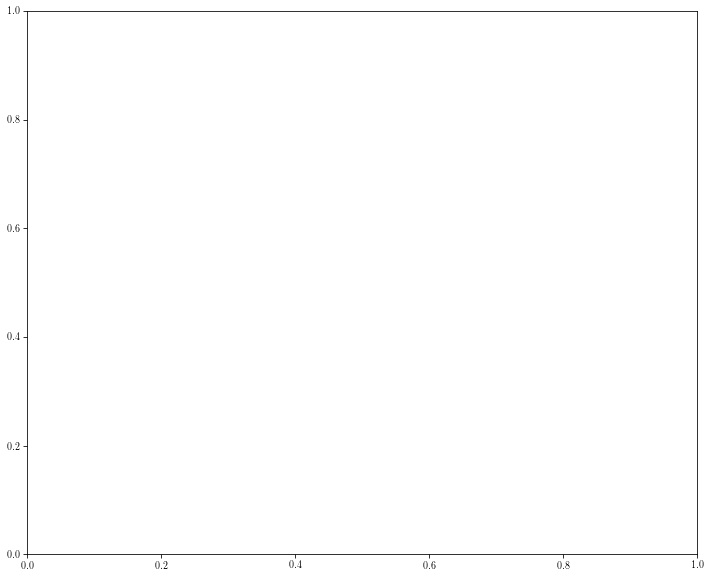

In [52]:
plt.contour([ra_DB, dec_DB,], WT2_aa)

AttributeError: 'numpy.ndarray' object has no attribute 'append'

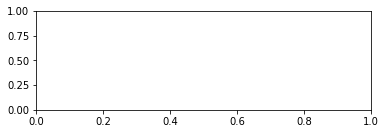

In [14]:
"""
hexbin is an axes method or pyplot function that is essentially a
pcolor of a 2-D histogram with hexagonal cells.
"""

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.mlab as mlab

delta = 0.025
x = y = np.arange(-3.0, 3.0, delta)
X, Y = np.meshgrid(x, y)
Z1 = mlab.bivariate_normal(X, Y, 1.0, 1.0, 0.0, 0.0)
Z2 = mlab.bivariate_normal(X, Y, 1.5, 0.5, 1, 1)
Z = Z2 - Z1  # difference of Gaussians

x = X.ravel()
y = Y.ravel()
z = Z.ravel()

if 1:
    # make some points 20 times more common than others, but same mean
    xcond = (-1 < x) & (x < 1)
    ycond = (-2 < y) & (y < 0)
    cond = xcond & ycond
    xnew = x[cond]
    ynew = y[cond]
    znew = z[cond]
    for i in range(20):
        x = np.hstack((x, xnew))
        y = np.hstack((y, ynew))
        z = np.hstack((z, znew))

xmin = x.min()
xmax = x.max()
ymin = y.min()
ymax = y.max()

gridsize = 30

plt.subplot(211)
plt.hexbin(x=ra_DB2, y=dec_DB2, C=pmra_DB_norm2, gridsize=gridsize, marginals=True, cmap=plt.cm.RdBu,
           vmax=abs(pmra_DB_norm2).max(), vmin=-abs(pmra_DB_norm2).max())
plt.axis([xmin, xmax, ymin, ymax])
cb = plt.colorbar()
cb.set_label('mean value')


plt.subplot(212)
plt.hexbin(x, y, gridsize=gridsize, cmap=plt.cm.Blues_r)
plt.axis([xmin, xmax, ymin, ymax])
cb = plt.colorbar()
cb.set_label('N observations')

plt.show()

In [19]:
#hexbin??
type(pmra_DB_norm2)

list

AttributeError: 'numpy.ndarray' object has no attribute 'append'

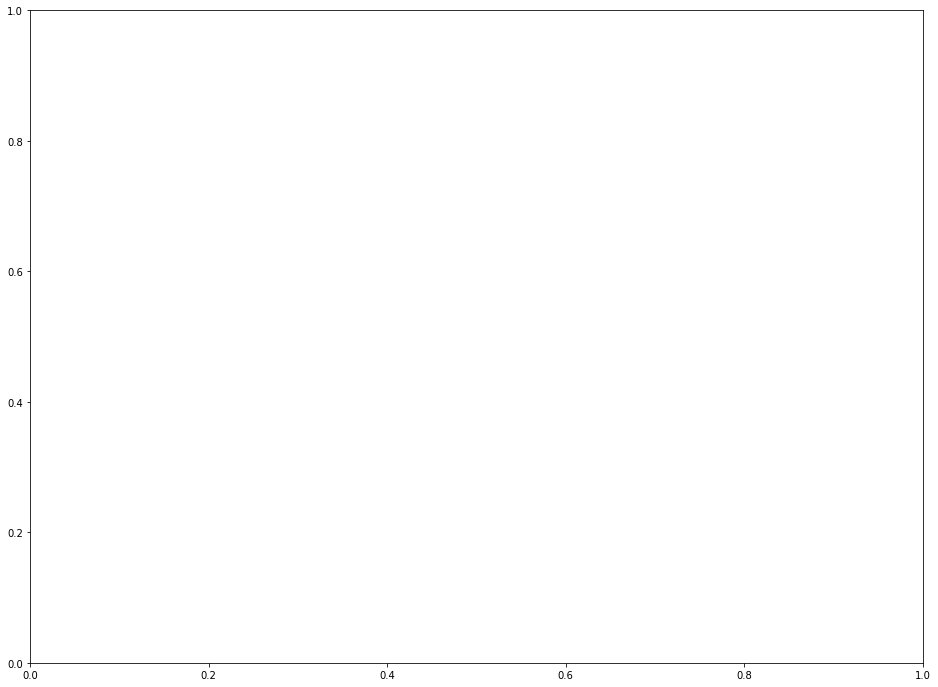

In [18]:
pmra_DB_norm2=pmra_DB_norm.as_matrix()
pmra_DB_norm2=pmra_DB_norm2.tolist()
ra_DB2 = ra_DB.as_matrix()
dec_DB2 = dec_DB.as_matrix()

fig=plt.figure(figsize=(16,12))
ax = plt.gca() 
#print(ra_DB, dec_DB, pmra_DB_norm.as_matrix())
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.hexbin(ra_DB2, dec_DB2,C=pmra_DB_norm2,gridsize=20, cmap='inferno', bins='log')#, vmin=-1, vmax=1)#, alpha=0.2)
#plt.scatter(x=ra_DB, y=dec_DB, c=pmdec_DB_norm, cmap='inferno', marker='.', vmin=-1, vmax=1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60*4, color='b', fill=False, lw=5)
#ax.add_artist(circle)
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=3)
ax.add_artist(circle2)
circle3 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), 5/60, color='pink', fill=False, lw=2)
#ax.add_artist(circle3)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmra}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
#plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_DB, y=dec_DB, c=pmdec_DB_norm, cmap='inferno', marker='.')#, vmin=-1, vmax=1)#, alpha=0.2)
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t/60*4, color='b', fill=False, lw=5)
#ax.add_artist(circle)
circle2 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='k', fill=False, lw=3)
ax.add_artist(circle2)
circle3 = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), 5/60, color='pink', fill=False, lw=2)
#ax.add_artist(circle3)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

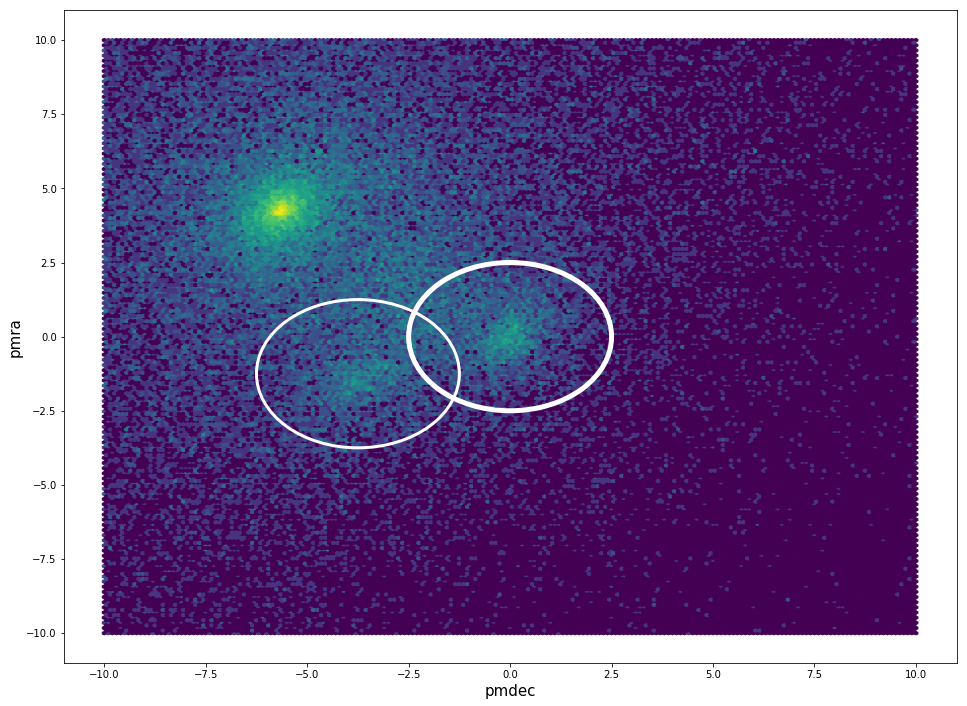

In [42]:
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.hexbin(GlobClust_Log_pmdec_out, GlobClust_Log_pmra_out, extent=[-10,10, -10,10], bins='log',gridsize=200)
circle = plt.Circle((0, 0), 2.5, color='w', fill=False, lw=5)
ax.add_artist(circle)
circle2 = plt.Circle((-3.75, -1.25), 2.5, color='w', fill=False, lw=3)
ax.add_artist(circle2)
#plt.gca().set_ylim([-10, 10])
#plt.gca().set_xlim([-10,10])
plt.xlabel('pmdec', fontsize=15)
plt.ylabel('pmra', fontsize=15)
plt.show()

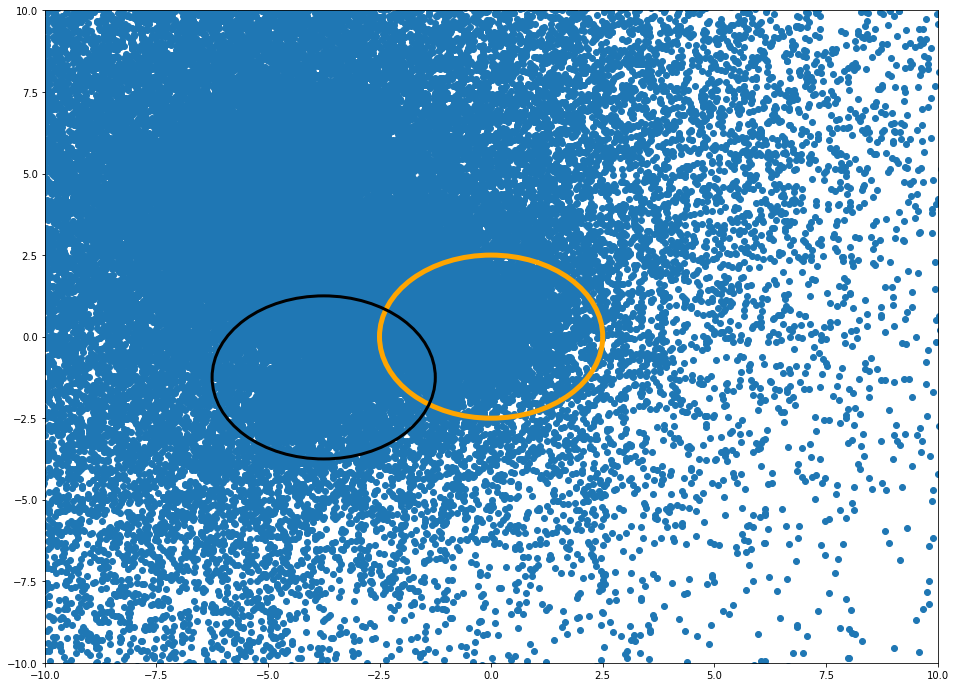

In [58]:
fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.scatter(GlobClust_Log_pmdec_out, GlobClust_Log_pmra_out)#, extent=[-10,10, -10,10], bins='log',gridsize=200)
circle = plt.Circle((0, 0), 2.5, color='orange', fill=False, lw=5)
ax.add_artist(circle)
circle2 = plt.Circle((-3.75, -1.25), 2.5, color='k', fill=False, lw=3)
ax.add_artist(circle2)
plt.gca().set_ylim([-10, 10])
plt.gca().set_xlim([-10,10])
plt.show()

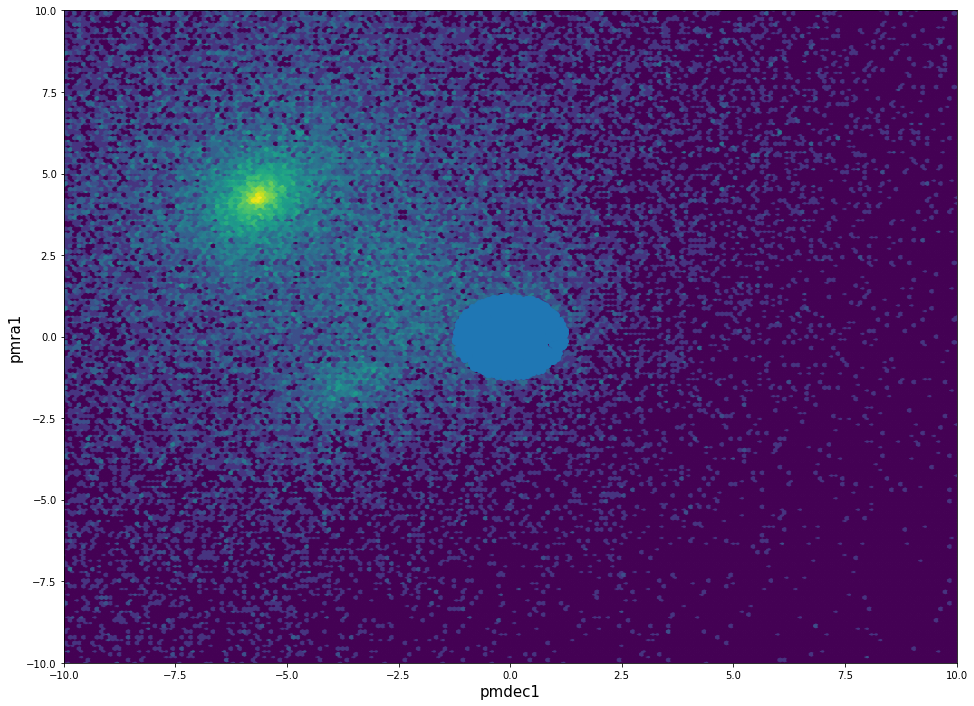

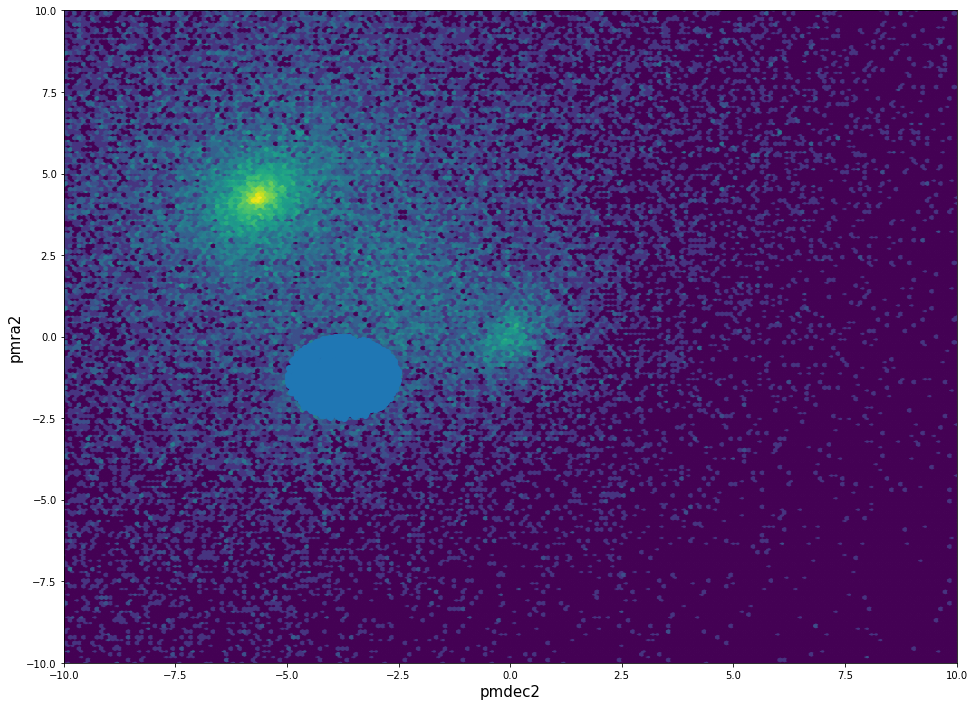

In [67]:
pms_indx_1 = (sqrt((np.fabs(GlobClust_Log_pmra_out)**2+np.fabs(GlobClust_Log_pmdec_out)**2))<1.25)

pms_indx_2 = (sqrt((np.fabs(GlobClust_Log_pmra_out+1.25)**2+np.fabs(GlobClust_Log_pmdec_out+3.75)**2))<1.25)

'''fig=plt.figure(figsize=(16,12))
plt.scatter(GlobClust_Log_pmdec_out, GlobClust_Log_pmra_out)#, bins='log', extent=[-10,10, -10,10], gridsize=200)
plt.scatter(pmra1,pmdec1)#, bins='log', extent=[-10,10, -10,10], gridsize=200)
plt.xlabel('pmra1', fontsize=15)
plt.ylabel('pmdec1', fontsize=15)
plt.gca().set_ylim([-10, 10])
plt.gca().set_xlim([-10,10])
plt.show()
'''
fig=plt.figure(figsize=(16,12))
plt.hexbin(GlobClust_Log_pmdec_out, GlobClust_Log_pmra_out, extent=[-10,10, -10,10], bins='log',gridsize=200)
plt.scatter(GlobClust_Log_pmdec_out[pms_indx_1], GlobClust_Log_pmra_out[pms_indx_1])
plt.xlabel('pmdec1', fontsize=15)
plt.ylabel('pmra1', fontsize=15)
plt.gca().set_ylim([-10, 10])
plt.gca().set_xlim([-10,10])
plt.show()

fig=plt.figure(figsize=(16,12))
plt.hexbin(GlobClust_Log_pmdec_out, GlobClust_Log_pmra_out, extent=[-10,10, -10,10], bins='log',gridsize=200)
plt.scatter(GlobClust_Log_pmdec_out[pms_indx_2], GlobClust_Log_pmra_out[pms_indx_2])
plt.xlabel('pmdec2', fontsize=15)
plt.ylabel('pmra2', fontsize=15)
plt.gca().set_ylim([-10, 10])
plt.gca().set_xlim([-10,10])
plt.show()

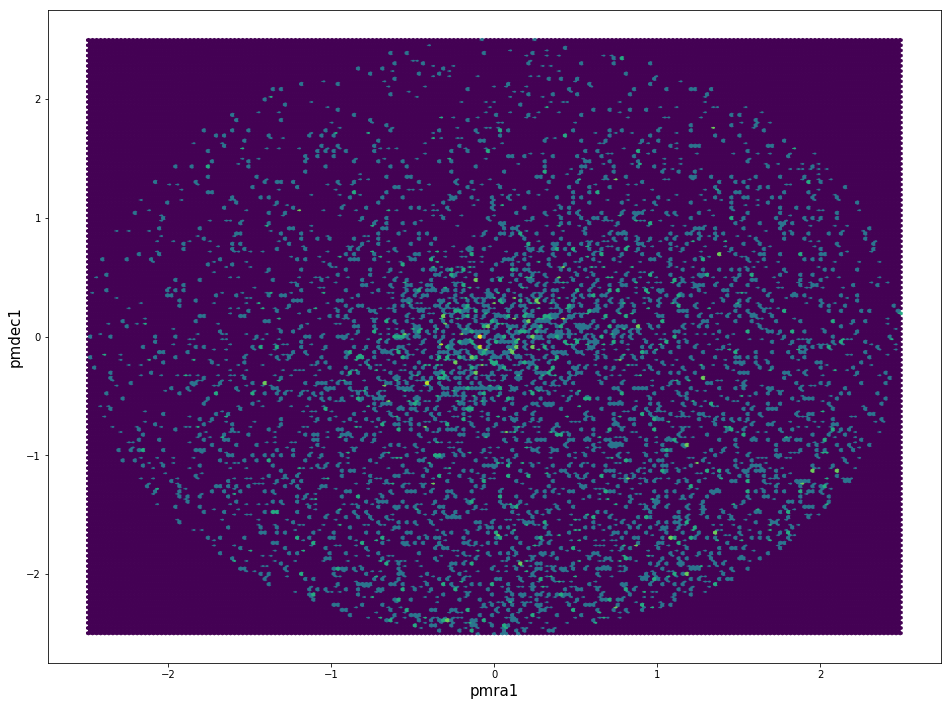

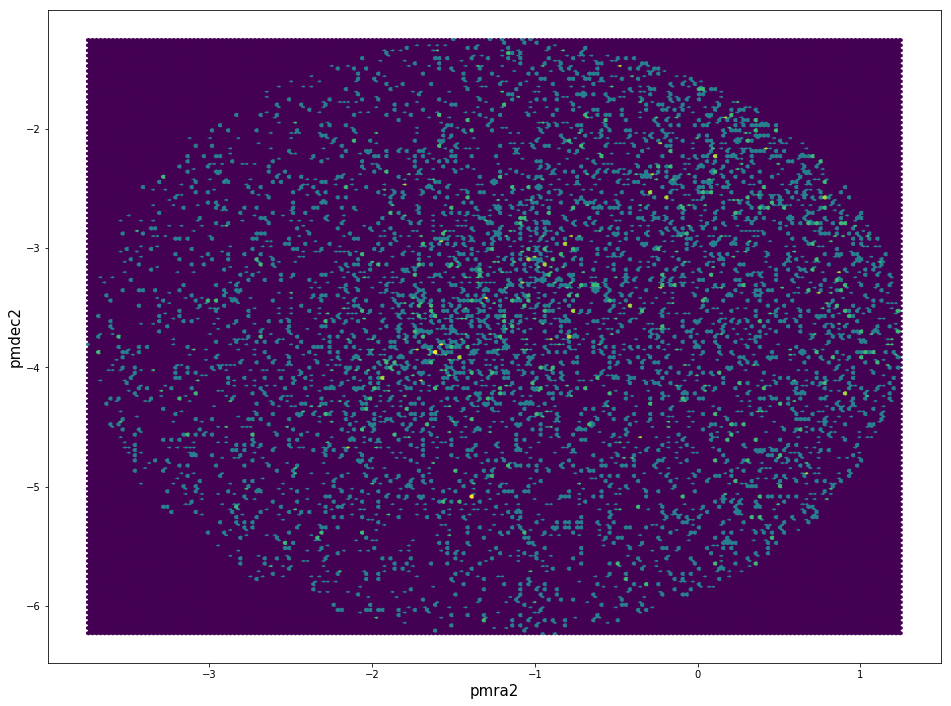

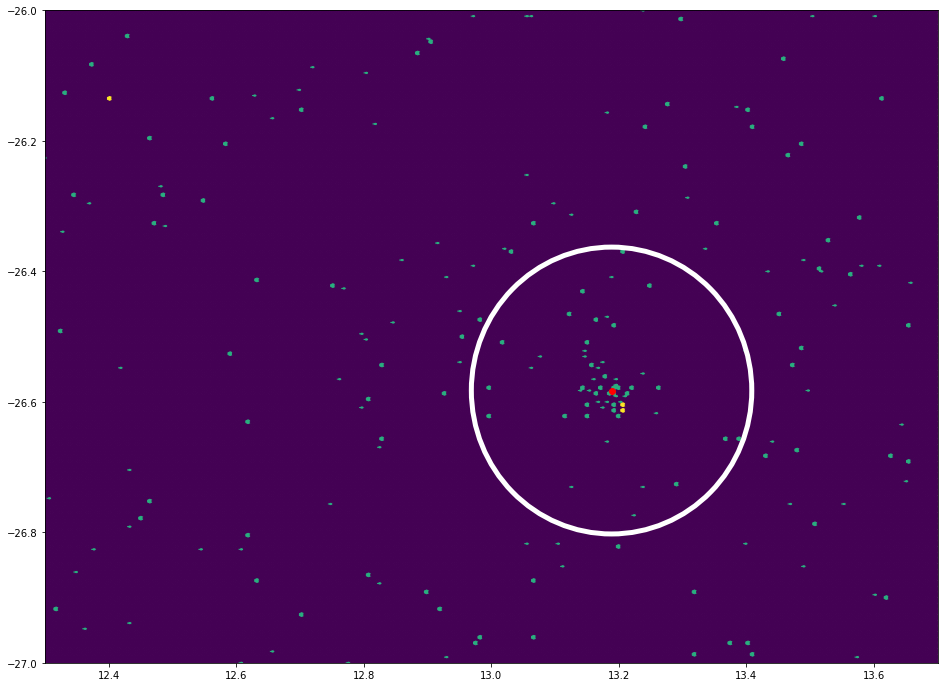

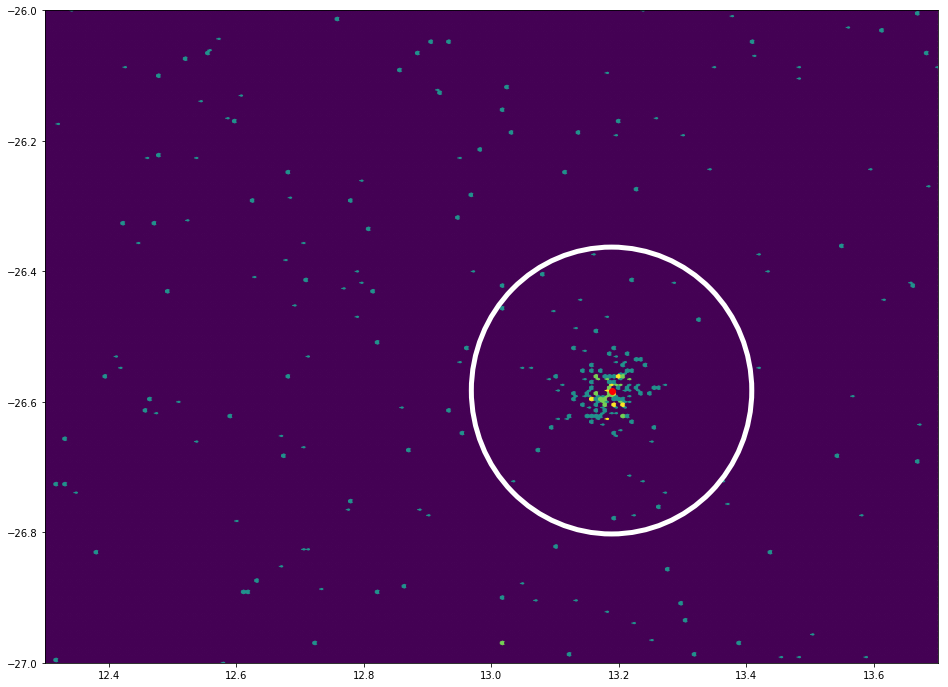

In [43]:
pms_indx_1 = (sqrt((np.fabs(GlobClust_Log_pmra_out)**2+np.fabs(GlobClust_Log_pmdec_out)**2))<2.5)

pms_indx_2 = (sqrt((np.fabs(GlobClust_Log_pmra_out+1.25)**2+np.fabs(GlobClust_Log_pmdec_out+3.75)**2))<2.5)


ra1=GlobClust_Log_ra_out[pms_indx_1]
dec1=GlobClust_Log_dec_out[pms_indx_1]
pmra1=GlobClust_Log_pmra_out[pms_indx_1]
pmdec1=GlobClust_Log_pmdec_out[pms_indx_1]

ra2=GlobClust_Log_ra_out[pms_indx_2]
dec2=GlobClust_Log_dec_out[pms_indx_2]
pmra2=GlobClust_Log_pmra_out[pms_indx_2]
pmdec2=GlobClust_Log_pmdec_out[pms_indx_2]

fig=plt.figure(figsize=(16,12))
plt.hexbin(pmra1,pmdec1, bins='log',gridsize=200)
plt.xlabel('pmra1', fontsize=15)
plt.ylabel('pmdec1', fontsize=15)
#plt.gca().set_ylim([-10, 10])
#plt.gca().set_xlim([10,-10])
plt.show()

fig=plt.figure(figsize=(16,12))
plt.hexbin(pmra2,pmdec2, bins='log',gridsize=200)
plt.xlabel('pmra2', fontsize=15)
plt.ylabel('pmdec2', fontsize=15)
#plt.gca().set_ylim([-10, 10])
#plt.gca().set_xlim([10,-10])
plt.show()

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.hexbin(ra1,dec1, bins='log',gridsize=200, extent=[12.3,13.7, -26,-27])
plt.scatter(coord_ra_dec.ra.deg, coord_ra_dec.dec.deg, c='r')
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60, color='w', fill=False, lw=5)
ax.add_artist(circle)
#plt.gca().set_ylim([-10, 10])
#plt.gca().set_xlim([10,-10])
plt.show()

fig=plt.figure(figsize=(16,12))
ax = plt.gca()
plt.hexbin(ra2,dec2, bins='log',gridsize=200, extent=[12.3,13.7, -26,-27])
plt.scatter(coord_ra_dec.ra.deg, coord_ra_dec.dec.deg, c='r')
circle = plt.Circle((coord_ra_dec.ra.deg, coord_ra_dec.dec.deg), GlobClust_Log_r_t[0]/60 , color='w', fill=False, lw=5)
ax.add_artist(circle)
#plt.gca().set_ylim([-10, 10])
#plt.gca().set_xlim([10,-10])
plt.show()


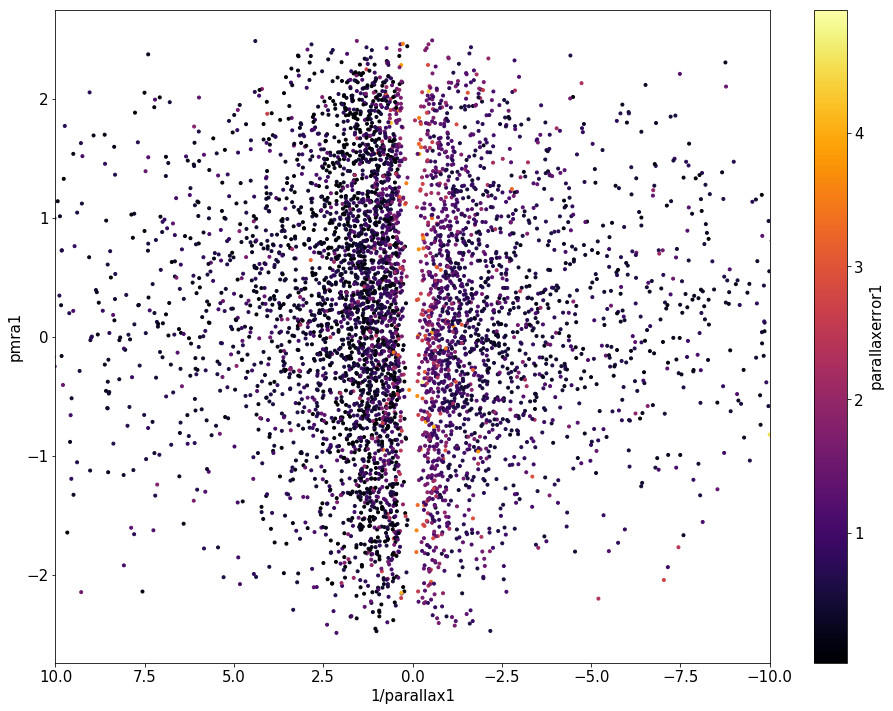

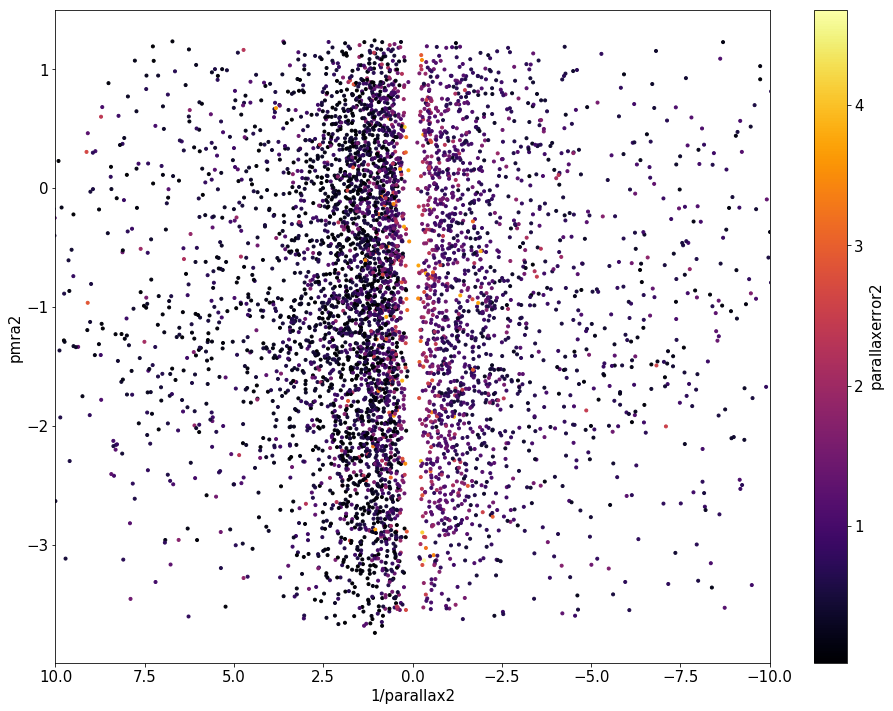

In [44]:
parallax_1 = GlobClust_Log_parallax_out[pms_indx_1]
parallaxerror_1 = GlobClust_Log_parallaxerror_out[pms_indx_1]

parallax_2 = GlobClust_Log_parallax_out[pms_indx_2]
parallaxerror_2 = GlobClust_Log_parallaxerror_out[pms_indx_2]

pm_blobs_pd = pd.DataFrame({'parallax1': parallax_1, 'parallax_error1': parallaxerror_1, 
                            'parallax2': parallax_2, 'parallax_error2': parallaxerror_2})
pm_blobs_pd

plt.figure(figsize(16,12))
plt.scatter(1/parallax_1, pmra1, marker='.', c=parallaxerror_1 , cmap='inferno')
plt.xlabel('1/parallax1', fontsize=15)
plt.ylabel('pmra1', fontsize=15)
plt.gca().tick_params(labelsize=15)
#plt.gca().set_ylim([-10, 10])
plt.gca().set_xlim([10,-10])
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{parallaxerror1}$',fontsize=15)
plt.show()

plt.figure(figsize(16,12))
plt.scatter(1/parallax_2, pmra2, marker='.', c=parallaxerror_2 , cmap='inferno')
plt.xlabel('1/parallax2', fontsize=15)
plt.ylabel('pmra2', fontsize=15)
plt.gca().tick_params(labelsize=15)
#plt.gca().set_ylim([-10, 10])
plt.gca().set_xlim([10,-10])
cb=plt.colorbar()
cb.ax.tick_params(labelsize=15)
cb.set_label(r'$\mathrm{parallaxerror2}$',fontsize=15)
plt.show()

In [66]:
print(M_1[0:3], '\n\n', GlobClust_Log_M[pms_indx_1][parallax_indx_1][0:3], '\n\n', 1/(parallax_1/3600000)[0:3])#1/GlobClust_Log_parallax_out)
#1/parallax_1
print('\n\n',shape(GlobClust_Log_rpbp_1), shape(GlobClust_Log_M_1))

0     -9.922275
41    -7.779620
104   -6.633480
dtype: float64 

 0      2.10315
41     5.04325
104    5.60025
Name: phot_g_mean_mag, dtype: float64 

 0     2.261908e+06
41    3.265607e+06
54   -5.781412e+07
Name: parallax, dtype: float64


 (5823,) (117480,)


/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in log10
  # Remove the CWD from sys.path while we load stuff.

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in log10



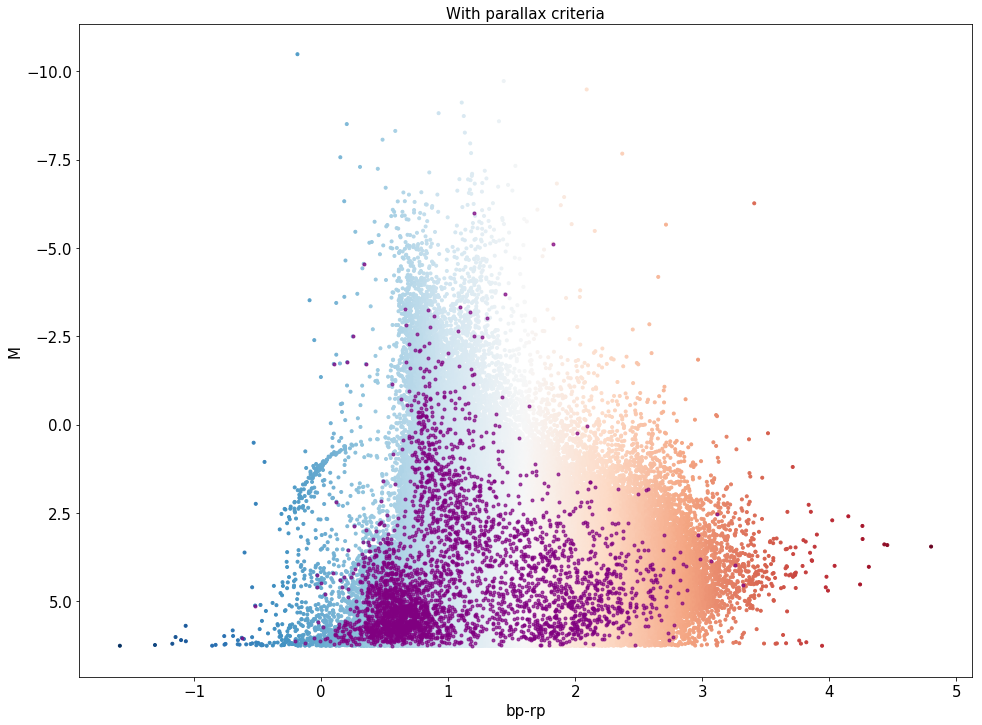

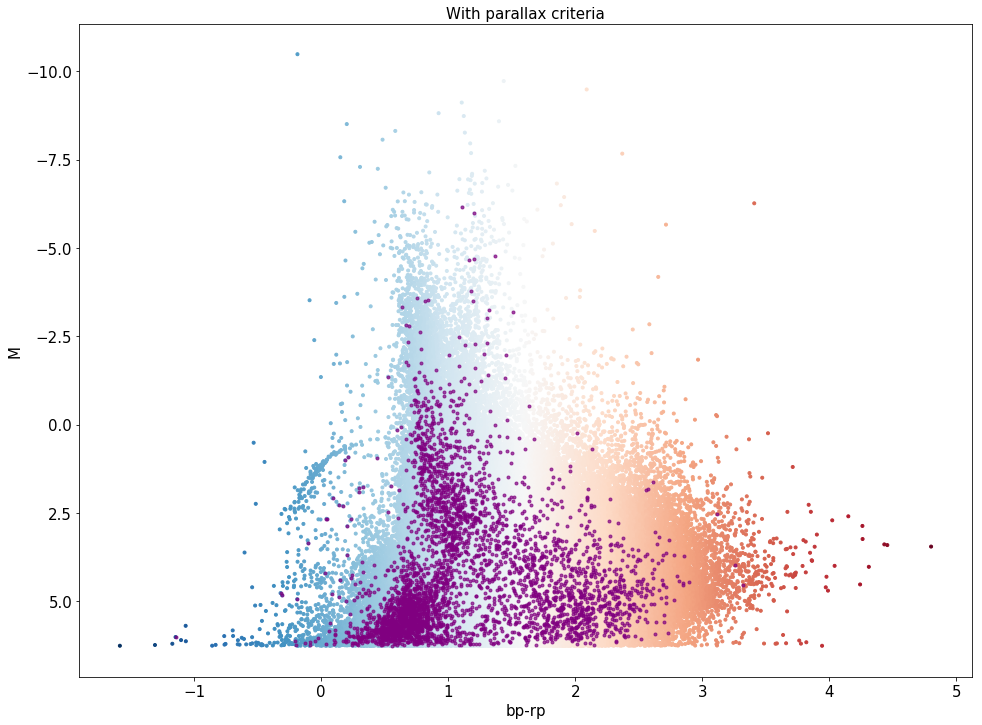

In [73]:
#M=m-5(log(d)-1)
#GlobClust_Log_M = GlobClust_Log_g-5*((np.log10(d_pc)) - 1)
#M_p = GlobClust_Log_g[pms_indx_1]-5*((np.log10(1/parallax_1*3600)) - 1)
#M_2_p = GlobClust_Log_g-5*((np.log10(1/parallax_2)) - 1)

#parallax_indx = (GC_parallaxover>0.20) | ((1/GC_parallax>5.)*(GC_parallaxover<0.20))
parallax_indx_1=(parallax_1>0.)
#parallax_indx2=[not i for i in parallax_indx2]

GlobClust_Log_M_1 = GlobClust_Log_g[pms_indx_1]-5*((log10(1/(parallax_1))) - 1)
#GlobClust_Log_g-5*((np.log10(d_pc)) - 1)

M_1 = GlobClust_Log_M[pms_indx_1][parallax_indx_1]
rpbp_1 = GlobClust_Log_rpbp[pms_indx_1][parallax_indx_1]

#M_2 = GlobClust_Log_M[pms_indx_2][parallax_indx2]
#rpbp_2 = GlobClust_Log_rpbp[pms_indx_2][parallax_indx2]

parallax_indx_2=(parallax_2>0.)

GlobClust_Log_M_2 = GlobClust_Log_g[pms_indx_2]-5*((log10(1/(parallax_2))) - 1)

M_2 = GlobClust_Log_M[pms_indx_2][parallax_indx_2]
rpbp_2 = GlobClust_Log_rpbp[pms_indx_2][parallax_indx_2]



fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r', marker='.')
plt.scatter(x=rpbp_1, y=M_1, c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.title('With parallax criteria', fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().invert_yaxis()
plt.show()

fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r', marker='.')
plt.scatter(x=rpbp_2, y=M_2, c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.title('With parallax criteria', fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().invert_yaxis()
plt.show()


/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in log10



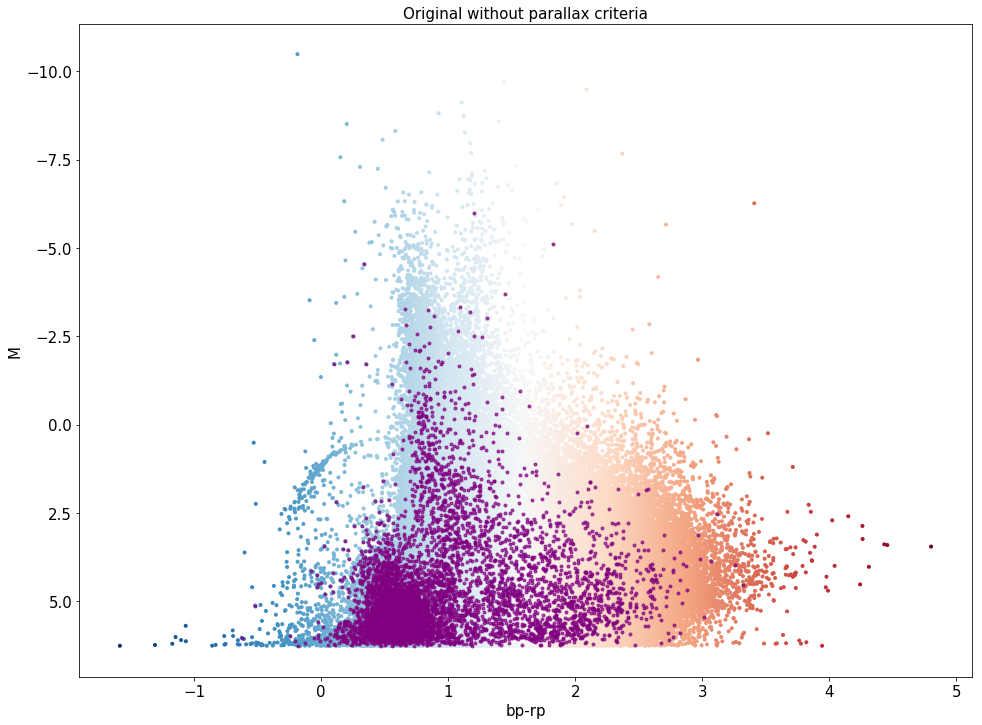

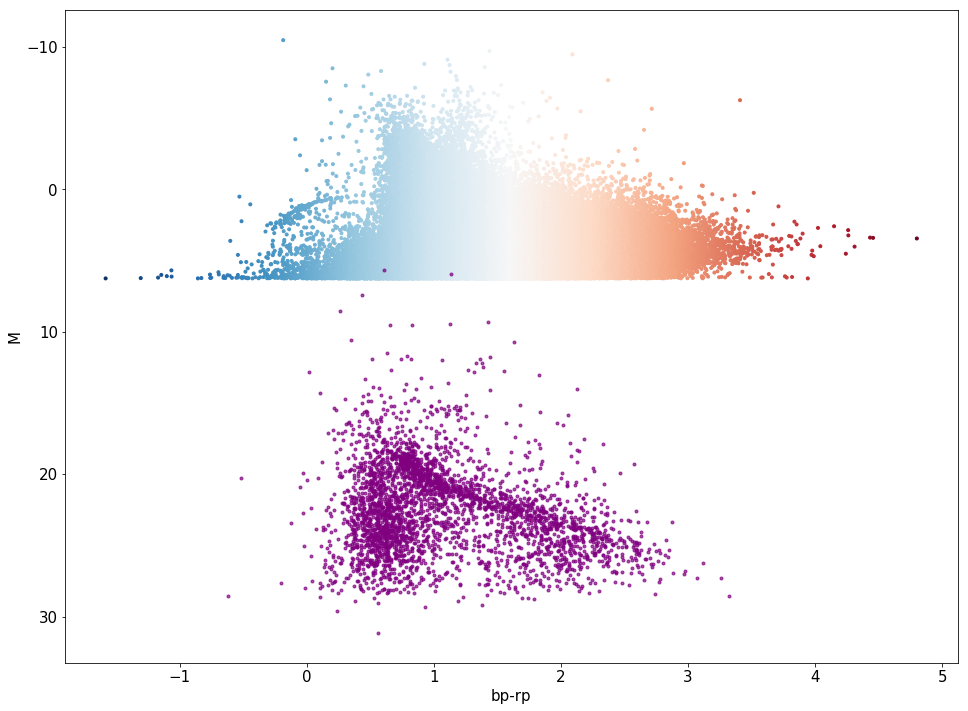

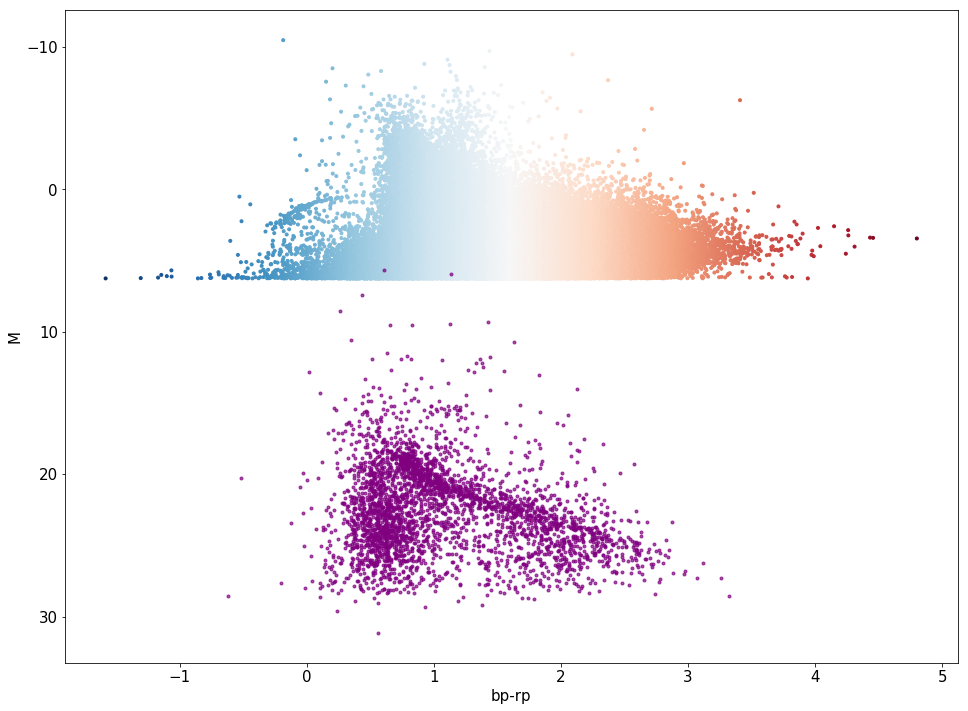

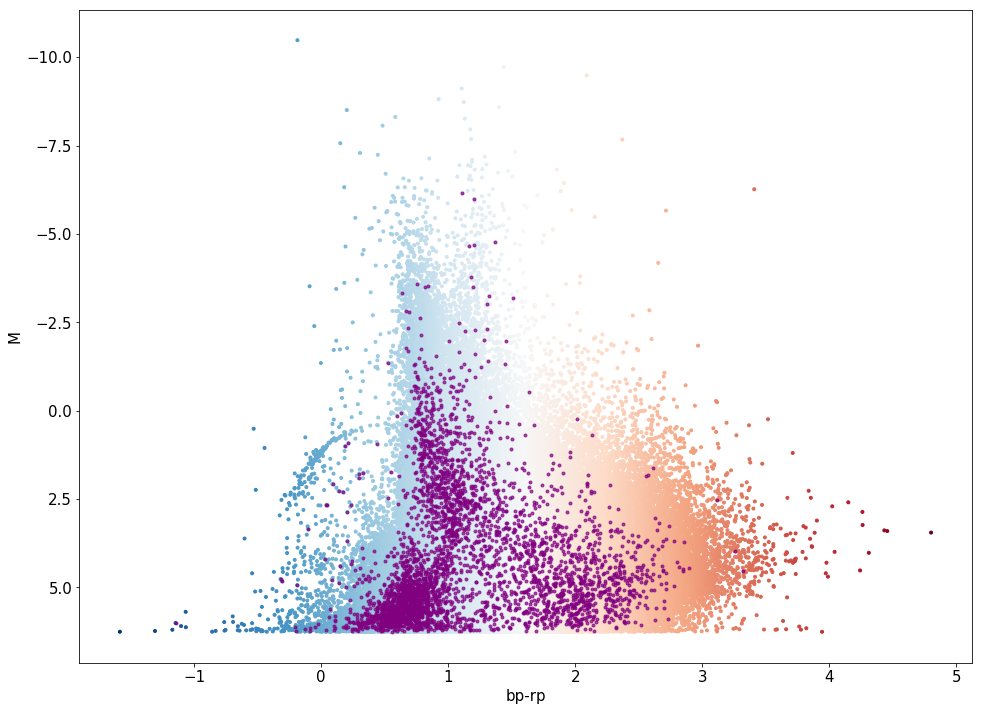

In [74]:
#M=m-5(log(d)-1)
#GlobClust_Log_M = GlobClust_Log_g-5*((np.log10(d_pc)) - 1)
#M_p = GlobClust_Log_g[pms_indx_1]-5*((np.log10(1/parallax_1*3600)) - 1)
#M_2_p = GlobClust_Log_g-5*((np.log10(1/parallax_2)) - 1)

#parallax_indx = (GC_parallaxover>0.20) | ((1/GC_parallax>5.)*(GC_parallaxover<0.20))
parallax_indx_1=(parallax_1>0.)
#parallax_indx2=[not i for i in parallax_indx2]

#GlobClust_Log_M_1 = GlobClust_Log_g[pms_indx_1]-5*((log10(1/(parallax_1))) - 1)
GlobClust_Log_M_1 = GlobClust_Log_g-5*((log10(1/(GlobClust_Log_parallax_out))) - 1)
GlobClust_Log_rpbp_1 = GlobClust_Log_rpbp[pms_indx_1]
#GlobClust_Log_g-5*((np.log10(d_pc)) - 1)

M_1 = GlobClust_Log_M_1[pms_indx_1][parallax_indx_1]
rpbp_1 = GlobClust_Log_rpbp[pms_indx_1][parallax_indx_1]

#M_2 = GlobClust_Log_M[pms_indx_2][parallax_indx2]
#rpbp_2 = GlobClust_Log_rpbp[pms_indx_2][parallax_indx2]

parallax_indx_2=(parallax_2>0.)

GlobClust_Log_M_2 = GlobClust_Log_g[pms_indx_2]-5*((log10(1/(parallax_2))) - 1)

M_2 = GlobClust_Log_M[pms_indx_2][parallax_indx_2]
rpbp_2 = GlobClust_Log_rpbp[pms_indx_2][parallax_indx_2]


fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r', marker='.')
#plt.scatter(x=GlobClust_Log_rpbp_1, y=GlobClust_Log_M_1, c='purple', alpha=0.7, marker='.')
plt.scatter(x=GlobClust_Log_rpbp[pms_indx_1], y=GlobClust_Log_M[pms_indx_1], c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_1, y=M_1, c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
plt.title('Original without parallax criteria', fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().invert_yaxis()
plt.show()

fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r', marker='.')
plt.scatter(x=GlobClust_Log_rpbp_1, y=GlobClust_Log_M_1[pms_indx_1], c='purple', alpha=0.7, marker='.')
#plt.scatter(x=GlobClust_Log_rpbp[pms_indx_1], y=GlobClust_Log_M[pms_indx_1], c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_1, y=M_1, c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().invert_yaxis()
plt.show()

fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r', marker='.')
#plt.scatter(x=GlobClust_Log_rpbp_1, y=GlobClust_Log_M_1, c='purple', alpha=0.7, marker='.')
#plt.scatter(x=GlobClust_Log_rpbp[pms_indx_1], y=GlobClust_Log_M[pms_indx_1], c='purple', alpha=0.7, marker='.')
plt.scatter(x=rpbp_1, y=M_1, c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().invert_yaxis()
plt.show()

fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r', marker='.')
plt.scatter(x=rpbp_2, y=M_2, c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().invert_yaxis()
plt.show()


(5628, 4)
[-1  0  0 ...,  0  0 -1]
(5628,)
Estimated number of Subgroups: 8


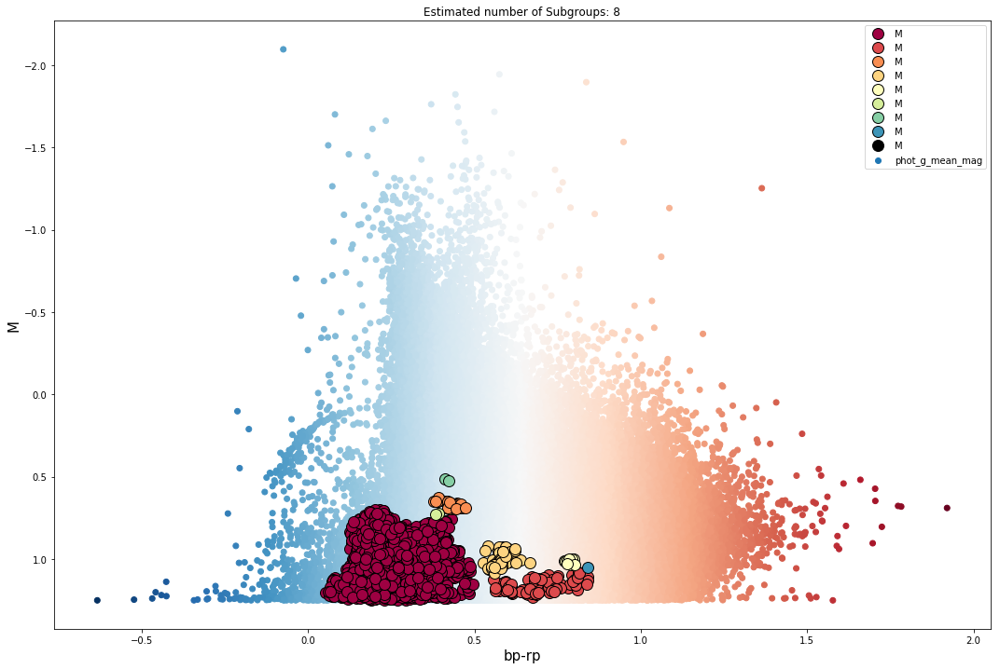

(5766, 4)
[-1  0  0 ...,  0  0  0]
(5766,)
Estimated number of Subgroups: 9


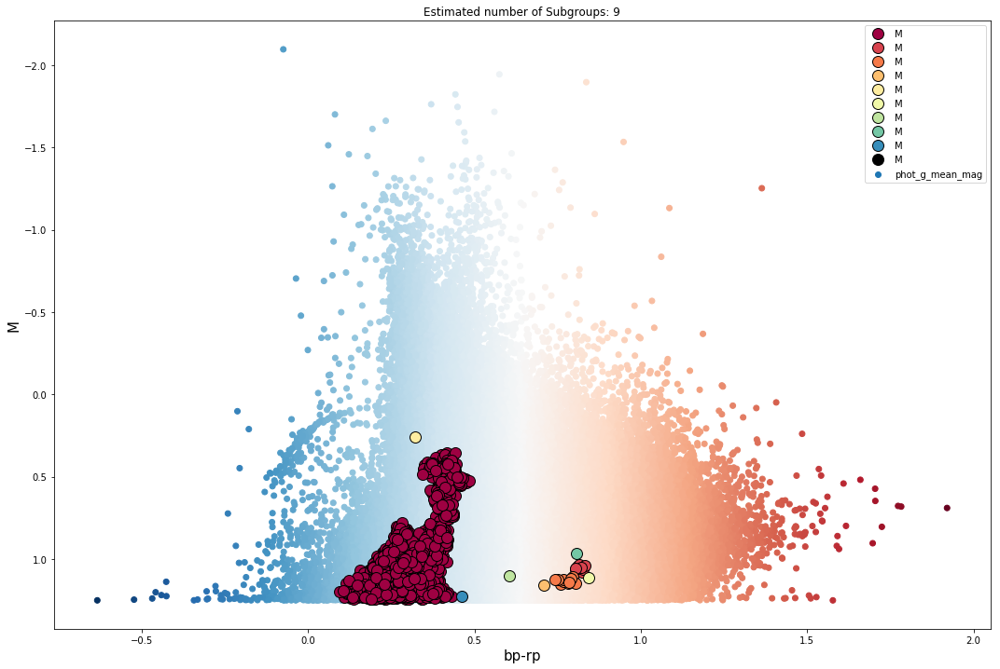

In [12]:
# DBSCAN
DB_Params =[]
DB_Params=np.transpose(DB_Params)

DF={'M': GlobClust_Log_M[pms_indx_1]/5, 'rpbp': GlobClust_Log_rpbp[pms_indx_1]/2.5, 
    'pmra': GlobClust_Log_pmra[pms_indx_1]/100, 'pmdec': GlobClust_Log_pmdec[pms_indx_1]/100}

DB_Params = pd.DataFrame(data=DF)
DB_Params=DB_Params.dropna()

print(shape(DB_Params))

db=sklearn.cluster.DBSCAN(eps=0.035, min_samples=18, metric='euclidean', metric_params=None, algorithm='auto', 
                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

print(db.labels_)
print(shape(db.labels_))

fig=plt.figure(figsize=(18,12))
plt.scatter(GlobClust_Log_rpbp/2.5, GlobClust_Log_M/5, c=GlobClust_Log_rpbp/2.5, cmap='RdBu_r')
#plt.scatter(db,DB_Params)
#plt.show()

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

print('Estimated number of Subgroups: %d' % n_clusters_)

x_param3=[]
y_param3=[]

x_param4=[]
y_param4=[]

# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)
    
    #NOISE
    #xy = DB_Params[class_member_mask & ~core_samples_mask]
    #plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
    #         markeredgecolor='k', markersize=6)
    
    #CLEANED DATA
    xy = DB_Params[class_member_mask & core_samples_mask]
    
    plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=12)
    
    x_param3.append(xy.loc[:, "rpbp"]*2.5)
    y_param3.append(xy.loc[:, "M"]*5)

    #x_param4.append(xy.loc[:, "pmra"]*0.35)
    #y_param4.append(xy.loc[:, "pmdec"]*0.3)
    
    #x_param5.append(xy.loc[:, "ra"]*0.35)
    #y_param5.append(xy.loc[:, "dec"]*0.3)

plt.gca().invert_yaxis()
plt.title('Estimated number of Subgroups: %d' % n_clusters_)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)

plt.legend()
plt.show()
#fig.savefig('GC_DBSCAN'+ GlobClust_Log_ID[0] +'eps0p165-mins10_coreCMD-fullsetiponfullcmd.png')



#######################
#######################
#######################


# DBSCAN
DB_Params =[]
DB_Params=np.transpose(DB_Params)

DF={'M': GlobClust_Log_M[pms_indx_2]/5, 'rpbp': GlobClust_Log_rpbp[pms_indx_2]/2.5, 
    'pmra': GlobClust_Log_pmra[pms_indx_2]/100, 'pmdec': GlobClust_Log_pmdec[pms_indx_2]/100}

DB_Params = pd.DataFrame(data=DF)
DB_Params=DB_Params.dropna()

print(shape(DB_Params))

db=sklearn.cluster.DBSCAN(eps=0.031, min_samples=18, metric='euclidean', metric_params=None, algorithm='auto', 
                      leaf_size=30, p=None, n_jobs=1).fit(DB_Params) #original eps=0.1625

print(db.labels_)
print(shape(db.labels_))

fig=plt.figure(figsize=(18,12))
plt.scatter(GlobClust_Log_rpbp/2.5, GlobClust_Log_M/5, c=GlobClust_Log_rpbp/2.5, cmap='RdBu_r')
#plt.scatter(db,DB_Params)
#plt.show()

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

print('Estimated number of Subgroups: %d' % n_clusters_)

#x_param3=[]
#y_param3=[]

x_param4=[]
y_param4=[]

# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)
    
    #NOISE
    #xy = DB_Params[class_member_mask & ~core_samples_mask]
    #plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
    #         markeredgecolor='k', markersize=6)
    
    #CLEANED DATA
    xy = DB_Params[class_member_mask & core_samples_mask]
    
    plt.plot(xy.loc[:, "rpbp"], xy.loc[:, "M"], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=12)
    
    x_param4.append(xy.loc[:, "rpbp"]*2.5)
    y_param4.append(xy.loc[:, "M"]*5)

    #x_param4.append(xy.loc[:, "pmra"]*0.35)
    #y_param4.append(xy.loc[:, "pmdec"]*0.3)
    
    #x_param5.append(xy.loc[:, "ra"]*0.35)
    #y_param5.append(xy.loc[:, "dec"]*0.3)

plt.gca().invert_yaxis()
plt.title('Estimated number of Subgroups: %d' % n_clusters_)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)

plt.legend()
plt.show()
#fig.savefig('GC_DBSCAN'+ GlobClust_Log_ID[0] +'eps0p165-mins10_coreCMD-fullsetiponfullcmd.png')

(3329, 1)
/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in less

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in greater



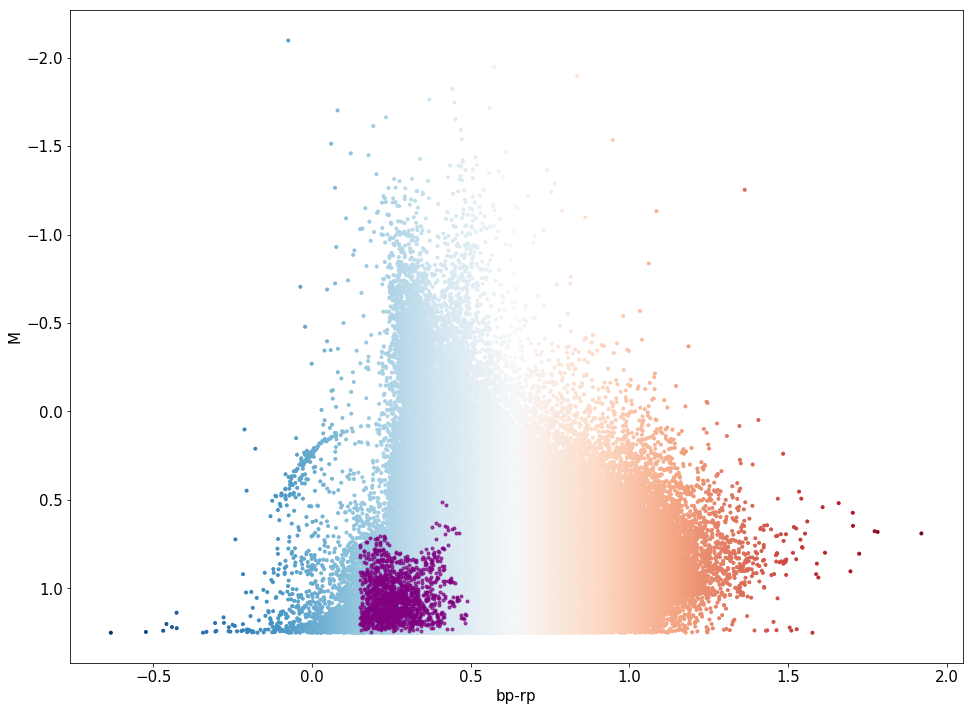

(3329, 1)
/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:67: RuntimeWarning: invalid value encountered in less

/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:67: RuntimeWarning: invalid value encountered in greater



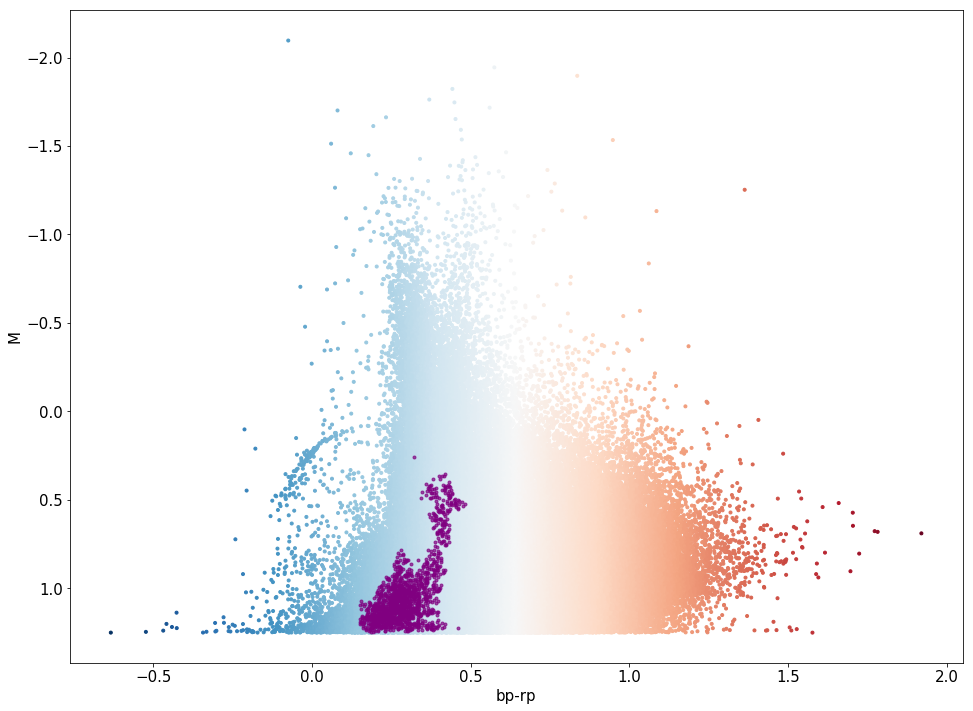

In [13]:
x_out3 = pd.DataFrame(x_param3)#, index=None)#, mangle_dupe_cols=True)
#x_out3.reset_index()
x_out3 = x_out3.transpose() 
x_out3 = x_out3.loc[:,~x_out3.columns.duplicated()]
#x_out3 = x_out3["rpbp"].as_matrix()
x_out3

y_out3 = pd.DataFrame(y_param3)#, index=None)#, mangle_dupe_cols=True)
#y_out3.reset_index()
y_out3 = y_out3.transpose() 
y_out3 = y_out3.loc[:,~y_out3.columns.duplicated()]
#y_out3 = y_out3["M"].as_matrix()
print(shape(y_out3))

#ra_DB = GC_ra.reindex(x_out3.index)
#dec_DB = GC_dec.reindex(y_out3.index)
#pmra_DB = GC_pmra.reindex(x_out3.index)
#pmdec_DB = GC_pmdec.reindex(y_out3.index)
M_1_DB = M_1.reindex(x_out3.index)
rpbp_1_DB = rpbp_1.reindex(x_out3.index)


CMD_indx_DB_1 = (rpbp_1_DB.as_matrix()/2.5 < 0.5) & (rpbp_1_DB.as_matrix()/2.5 > 0.15)


fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp/2.5, y=GlobClust_Log_M/5, c=GlobClust_Log_rpbp/2.5, cmap='RdBu_r', marker='.')
plt.scatter(x=rpbp_1_DB[CMD_indx_DB_1]/2.5, y=M_1_DB[CMD_indx_DB_1]/5, c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().invert_yaxis()
plt.show()


#####################
#####################
#####################

x_out4 = pd.DataFrame(x_param4)#, index=None)#, mangle_dupe_cols=True)
#x_out3.reset_index()
x_out4 = x_out4.transpose() 
x_out4 = x_out4.loc[:,~x_out4.columns.duplicated()]
#x_out3 = x_out3["rpbp"].as_matrix()
x_out4

y_out4 = pd.DataFrame(y_param3)#, index=None)#, mangle_dupe_cols=True)
#y_out3.reset_index()
y_out4 = y_out4.transpose() 
y_out4 = y_out4.loc[:,~y_out4.columns.duplicated()]
#y_out3 = y_out3["M"].as_matrix()
print(shape(y_out4))

#ra_DB = GC_ra.reindex(x_out3.index)
#dec_DB = GC_dec.reindex(y_out3.index)
#pmra_DB = GC_pmra.reindex(x_out3.index)
#pmdec_DB = GC_pmdec.reindex(y_out3.index)
M_2_DB = M_2.reindex(x_out4.index)
rpbp_2_DB = rpbp_2.reindex(x_out4.index)


CMD_indx_DB_2 = (rpbp_2_DB.as_matrix()/2.5 < 0.5) & (rpbp_2_DB.as_matrix()/2.5 > 0.15)


fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp/2.5, y=GlobClust_Log_M/5, c=GlobClust_Log_rpbp/2.5, cmap='RdBu_r', marker='.')
plt.scatter(x=rpbp_2_DB[CMD_indx_DB_2]/2.5, y=M_2_DB[CMD_indx_DB_2]/5, c='purple', alpha=0.7, marker='.')
#plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.gca().invert_yaxis()
plt.show()


In [25]:
sqrt(np.fabs((M_i[0]-M_k[0])**2+(rpbp_i[0]-rpbp_k[0])**2))
#print(M_i,'\n', M_k,'\n\n')
#print(rpbp_i, '\n', rpbp_k)

#GlobClust_Log_M
#M_DB
#rpbp_DB

#sqrt(np.fabs((M_i[0]-M_k[0])**2+(rpbp_i[0]-rpbp_k[0])**2))

2.3673784023683222

In [20]:
# DISTANCE LOOP FROM NEW CMD OF NGC 288 USING r_c AS CONSTRAINT FOR OVERPLOTTED CLUSTER STARS ON CMD (MATCHING)
# NEEDS BE RUN AFTER PREVIOUS CELL!!!
import time

t0 = time.time()
Cluster = np.zeros(len(GlobClust_Log_M), dtype='bool')
M_i = GlobClust_Log_M
M_k = M_DB
rpbp_i = GlobClust_Log_rpbp
rpbp_k = rpbp_DB

M_i = M_i.as_matrix()
M_k = M_k.as_matrix()
rpbp_i = rpbp_i.as_matrix()
rpbp_k = rpbp_k.as_matrix()

#M_k[1]

#sqrt(np.fabs(M_i[1]-M_k[1])**2+(rpbp_i[1]-rpbp_k[1])**2)
#rpbp_i

#dist=[]
#dist=(fabs(rpbp_i[1]-rpbp_k[1])**2)
#dist
#dist = sqrt(np.fabs((M_i[0]-M_k[0])**2+(rpbp_i[0]-rpbp_k[0])**2))

M_final=[]
rpbp_final=[]


for i in range(0,len(M_i)): #,21399):#len(M_i)):
    #Cluster[i]=False
    for k in range(0, len(M_k)): #,3302):#len(M_k)):
        #print([i], [k])
        #print(M_k[k])
        #print(rpbp_k[k])
        #print(M_i[i])
        #print(rpbp_i[i])
        #print(M_i[i][~np.isnan(M_i[i])])
        #print(rpbp_i[i][~np.isnan(rpbp_i[i])])
        #if rpbp_i[i][~np.isnan(rpbp_i[i])] & rpbp_k[k][~np.isnan(rpbp_k[k])]:
        dist = sqrt(np.fabs((M_i[i]-M_k[k])**2+(rpbp_i[i]-rpbp_k[k])**2))
        #print(dist)
        if dist < 0.1:
            Cluster[i]=True
            #Cluster[i]
            #np.append(M_final,M_k[k])
            #np.append(rpbp_final,rpbp_k[k])
            
            M_final.append(M_i[i])
            rpbp_final.append(rpbp_i[i])
            
            continue


t1 = time.time()
total = t1-t0
print(total)
print(Cluster)
print(shape(Cluster))
print(np.sum(Cluster))


KeyboardInterrupt: 

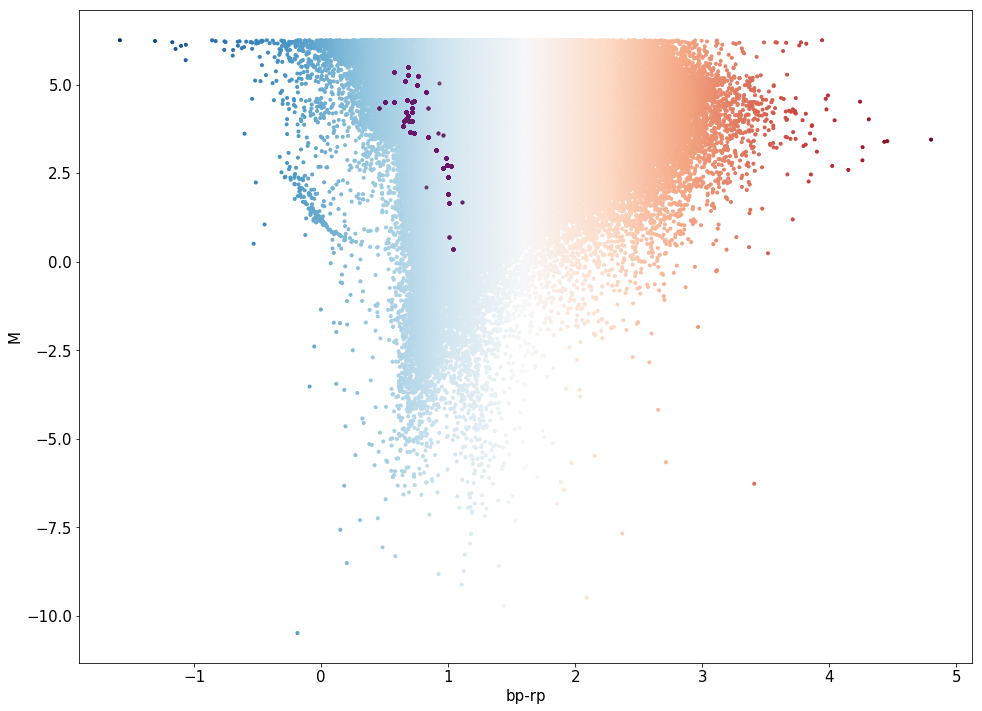

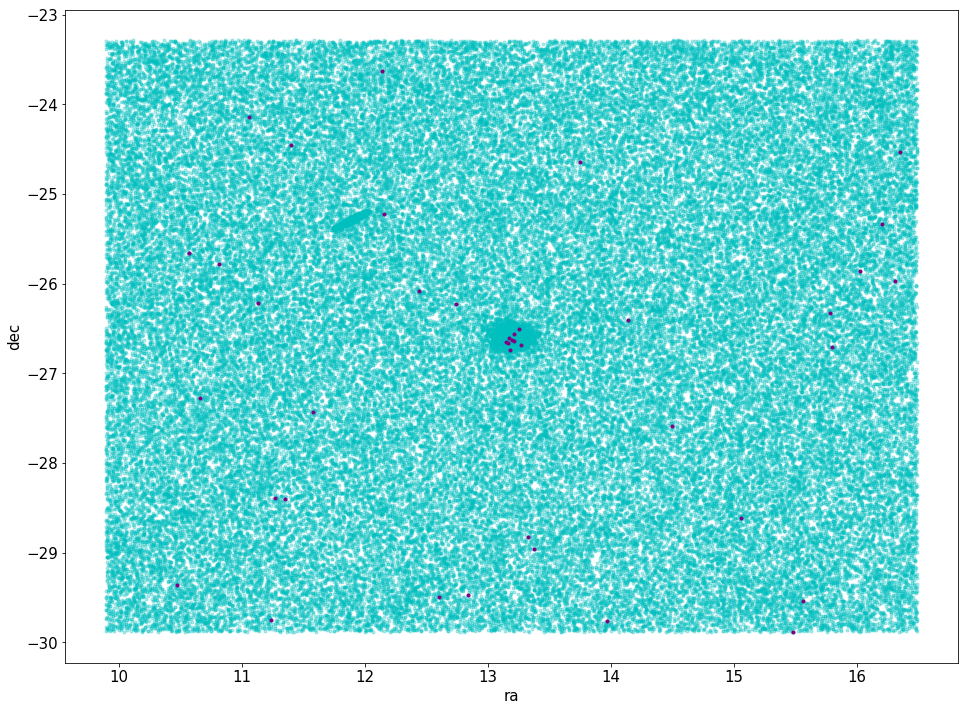

In [28]:
# MUST BE RUN AFTER PREVIOUS CELLS

#Clust_indx = (sqrt(np.fabs((M_i-M_k)**2+(rpbp_i-rpbp_k)**2))<0.1)

rpbp_ic=rpbp_i[Cluster] #np.multiply(rpbp_i,Cluster)
M_ic=M_i[Cluster] #multiply(M_i,Cluster)

#for i in range(0, len(M_ic)):
#    if rpbp_ic[i]!=0. and M_ic[i]!=0.:
#        rpbp_ic[i]=rpbp_ic[i]
#        M_ic[i]=M_ic[i]



fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_rpbp, y=GlobClust_Log_M, c=GlobClust_Log_rpbp, cmap='RdBu_r', marker='.')
plt.scatter(x=rpbp_final, y=M_final, c='purple', alpha=0.7, marker='.')
plt.scatter(x=rpbp_ic, y=M_ic, c='g', alpha=0.2, marker='.')
plt.xlabel('bp-rp', fontsize=15)
plt.ylabel('M', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

#GC_StarsPlot = {'bprp indx': GlobClust_Log_rpbp[indx], 'M indx': GlobClust_Log_M[indx], 'ra': GlobClust_Log_ra_out,\
#                    'dec': GlobClust_Log_dec_out}
#GC_StarscutPlot = pd.DataFrame(data=GC_StarsPlot)
#GC_StarscutPlot.to_csv('out_GCStars_'+ 'NGC 288' +'_cutplot2_r_c.csv', index=True, header=True)

# PLOT RA-DEC FROM MATCHING
# RUN AFTER PREVIOUS CELLS

ra_ic=GlobClust_Log_ra_out[Cluster] #np.multiply(rpbp_i,Cluster)
dec_ic=GlobClust_Log_dec_out[Cluster] #multiply(M_i,Cluster)

fig=plt.figure(figsize=(16,12))
plt.scatter(x=GlobClust_Log_ra_out, y=GlobClust_Log_dec_out, c='c', alpha=0.3, marker='.')
#plt.scatter(x=rpbp_final2, y=M_final2, c='purple', alpha=0.7)
plt.scatter(x=ra_ic, y=dec_ic, c='purple', marker='.')#, alpha=0.2)
plt.xlabel('ra', fontsize=15)
plt.ylabel('dec', fontsize=15)
#plt.gca().invert_yaxis()
#plt.title('CMD of ' + GC_IDs[i], fontsize=15)
#cb=plt.colorbar()
#cb.ax.tick_params(labelsize=15)
#cb.set_label(r'$\mathrm{pmdec}$',fontsize=15)
plt.gca().tick_params(labelsize=15)
plt.show()

